# MBA em Ciência de Dados
### Universidade de São Paulo, São Carlos, Brasil

**TCC Gabriel dos Santos Scatena 2023** 

## Democratizando a concessão de crédito com base em dados do _Open Finance_

### Democratizing credit approval based on Open Finance data


**Área de Concentração:** Ciências de Dados

**Orientador:** Prof. Dr. Júlio Cezar Estrella

### Conteudo 
**Criar um modelo de aprendizado de maquina para risco de crédito**
1.	Coleta de Dados
2.	Limpeza de Dados (Data Cleaning)
3.	 Exploração e Análise de Dados
4.	Pré-processamento de Dados
5.	Depuração de Dados (Data Cleansing) 
6.	Lidando com Classes Desbalanceadas
7.	 Engenharia de Variáveis (ou Engenharia de Características)
8.	Seleção de Variáveis
9.	Seleção de Modelo
10.	Treinamento de Modelo
11.	Avaliação de Modelo
12.	Ajuste de Hiperparâmetros
13.	Interpretação de Modelo 
14.	Implantação de Modelo
15.	Monitoramento e Manutenção de Modelo


### ABSTRACT

SCATENA, GABRIEL DOS SANTOS. **Democratizing credit granting based on Open Finance data.** 2023. 
Monografia (MBA em Ciências de Dados) – Instituto de Ciências
Matemáticas e de Computação, Universidade de São Paulo, São Carlos – SP, 2023.

Credit granting in Brazil presents a significant challenge, especially for self-employed workers
and entrepreneurs with informal and variable incomes. Throughout history, access to credit has
been historically low for this group of professionals compared to other countries. This is largely
due to the fact that financial institutions traditionally use criteria such as stable income history
and cash flow in credit analysis. These criteria end up excluding those with irregular or informal
incomes, making it difficult for them to obtain credit for investments, business expansion, or
even to cope with unforeseen financial challenges. Given this reality, it is essential to find ways
to improve credit analysis and granting for these professionals in order to help them overcome
financial obstacles and drive their economic development. This thesis proposes the development
of a model based on Open Finance data, or Open Finance System, which can assist financial
institutions in making more accurate and fair credit decisions, aiming to improve credit access
and the financial situation of these individuals.

_Keywords: Open Finance, Credit, Machine learning._

### RESUMO

SCATENA, GABRIEL DOS SANTOS. **Democratizando a concessão de crédito com base em dados do Open Finance.** 2023.
Monografia (MBA em Ciências de Dados) – Instituto de Ciências
Matemáticas e de Computação, Universidade de São Paulo, São Carlos – SP, 2023.

A concessão de crédito no Brasil apresenta um desafio significativo, especialmente para...

## Objetivos Específicos

1. Avaliação de um modelo preditivo para risco de crédito com base em dados de Open Finance.

2. Avaliação de vários algoritmos de aprendizado de máquina.

3. Comparação das métricas dos modelos obtidos com o modelo utilizado pela empresa fornecedora dos dados.

4. Um tutorial prático para modelagem de risco de crédito: uma Perspectiva Técnica sem Discussão de Negócios.

*"Construir um modelo de aprendizado de máquina exige equilíbrio entre habilidades de negócios, científicas e técnicas... Pela minha experiência, você precisa dedicar muito tempo à parte de negócios, por exemplo, como definir um objetivo, às vezes não é fácil, como selecionar amostras para obter o melhor desempenho, isso é uma das coisas mais importantes."* - Zheng

### Criando um Modelo de Aprendizado de Máquina para Risco de Crédito

In [1]:
#pip install seaborn pip scikit-learn matplotlib numpy pandas plotly imbalanced-learn lightgbm xgboost catboost 

In [ ]:
# Criando um dataframe artificial para testes
import pandas as pd
import numpy as np

# Number of rows in the DataFrame
num_rows = 1900

# Number of columns in the DataFrame (excluding 'user_id' and 'label')
num_columns = 54

# Number of unique banks
num_banks = 10

nan_percentage = 0.36
zero = .95
one = .05

# Generating random data for the DataFrame
data = {
    'user_id': np.arange(1, num_rows + 1),
    'bank': np.random.randint(1, num_banks + 1, size=num_rows),
}

# Calculate the number of columns with specific values
num_zero_columns = int(num_columns * 0.08)
num_range_columns = int(num_columns * 0.50)
num_remaining_columns = num_columns - (num_zero_columns + num_range_columns)

# Adding the label X0000x columns with continuous data
for i in range(1, num_columns + 1):
    col_name = f'X{i:04}'
    
    if i <= num_zero_columns:  # 8% columns with only 0 values
        data[col_name] = 0
    elif i <= num_zero_columns + num_range_columns:  # First 5% columns
        data[col_name] = np.random.randint(1, 1400001, size=num_rows)
    else:  # Remaining columns
        col_values = np.random.randint(-90000, 35001, size=num_rows)
        col_mean = col_values.mean()
        col_diff = 1 - col_mean
        
        # Introduce NaN values mixed among existing values
        nan_indices = np.random.choice(num_rows, size=int(num_rows * nan_percentage), replace=False)
        col_values = col_values.astype(float)  # Convert to float
        col_values[nan_indices] = np.nan
        
        data[col_name] = col_values + col_diff

# Adding the 'label' column with values 0 or 1
data['label'] = np.random.choice([0, 1], size=num_rows, p=[zero, one])

# Creating the DataFrame
df = pd.DataFrame(data)

# Extracting 'user_id', 'bank', and 'label' columns
user_id_col = df['user_id']
bank_col = df['bank']
label_col = df['label']

# Removing 'user_id', 'bank', and 'label' columns
df = df.drop(columns=['user_id', 'bank', 'label'])

# Shuffle the remaining columns randomly
df = df.sample(frac=1, axis=1)

# Rename the shuffled columns with names X0001 to X0540
new_col_names = ['X{:04}'.format(i) for i in range(1, num_columns + 1)]
df.columns = new_col_names

# Re-insert 'user_id', 'bank', and 'label' columns at their respective positions
df.insert(0, 'user_id', user_id_col)
df.insert(1, 'bank', bank_col)
df.insert(len(df.columns), 'label', label_col)
df = df.astype(float)

# Set display options to format with no decimal places
pd.set_option('display.float_format', '{:.0f}'.format)

# Print the first few rows of the DataFrame
display(df.head())

# Print the summary statistics of the DataFrame
display(df.describe())

In [1]:
notebook_path = 'C:/Temp/Codes/MBA/TCC_MBA_GabrielScatena.ipynb'

In [2]:
# Código para medir o tempo de execução de cada célula # Code to measure the execution time of each cell
import time

def start_timer():
    global start_time
    start_time = time.time()

def end_timer():
    end_time = time.time()
    execution_time = end_time - start_time
    execution_time = round(execution_time,2)
    print(f"Tempo de execução: {execution_time} segundos")

# Chama start_timer() no início de cada célula
start_timer()


# Chama end_timer() no final de cada célula
end_timer()


Tempo de execução: 0.0 segundos


## 0. Imports and Directories

In [3]:
# Importar bibliotecas necessárias para o projeto
start_timer()
import pickle
import re
import os
import pandas as pd
import numpy as np
from numpy import nan
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.offline as pyo
import warnings
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
import plotly.graph_objects as go
from sklearn.ensemble import IsolationForest
from sklearn.svm import OneClassSVM
from sklearn.impute import SimpleImputer


# Configurações de exibição. Aumentar o número máximo de linhas.
pd.set_option('display.max_rows', 600)

# Supressão de Avisos :)
warnings.filterwarnings("ignore")

# Gera o caminho para o usuário local
home_directory = os.path.expanduser('~')
home_directory += '/Klavi/Klavi Directory Cloud - Data_BRAZIL'
home_directory = home_directory.replace('\\', '/')
print(f"Home directory: {home_directory}")
# Home directory: C:\Users\GabrielScatena

# Gera o caminho para o diretório de trabalho
files_directory = 'C:/Temp/Codes/MBA'
end_timer()

Home directory: C:/Users/GabrielScatena/Klavi/Klavi Directory Cloud - Data_BRAZIL
Tempo de execução: 3.65 segundos


## 1.	Coleta de Dados

* Coletar os dados relevantes de várias fontes ou bancos de dados.

A Klavi é uma fintech líder no setor de Open Finance no Brasil, com um lema de "revolucionar o sistema financeiro e capacitar empresas com soluções de Open Finance, possibilitando a inovação de produtos e serviços para seus clientes."
Inicialmente, a Klavi forneceu um banco de dados com mais de cinquenta mil usuários registrados.
Esse banco de dados foi gerado nas fases iniciais da empresa e foi derivado de dados de Open Finance, que foram preprocessados para criar as características utilizadas pela empresa.
No total, existem 540 variáveis rotuladas de K00001 a K00540.

In [11]:
# Carrega o arquivo de dados sem rótulos	
start_timer()
# Devido ao tamanho do arquivo, o mesmo foi dividido em partes para serem carregadas
file_path = rf"{home_directory}\99_Backup_Old\Temp\K360_20230404080101.csv"

chunk_size = 100000
chunks = []

for chunk in pd.read_csv(file_path, chunksize=chunk_size):
    chunks.append(chunk)

base = pd.concat(chunks, ignore_index=True)

display(base.head())
display(base.tail()) 

# Carrega o arquivo de dados com rótulos
labels = pd.read_excel(r"C:\Temp\Codes\y_pred_proba_banc_pan_total.xlsx")
print('\nDados rotulados')
display(labels.head())
end_timer()

,l1_score,l2_score,l3_score,user_id,trace_id,query_date,bank,account,K00001,K00002,...,K00531,K00532,K00533,K00534,K00535,K00536,K00537,K00538,K00539,K00540
0,503.0,703.0,603,W447WaIXvpw5qZB1SwSBo8G68qQHO0TApmQa,388012889408315575-1680572652663,2022-10-30 00:00:00,Caixa,388012889408315575,-999999,-999999,...,-999999,-999999.00,-999999.0,-999999.0,-999999.00,-999999,-999999,-999999,-999999,-999999.00
1,547.0,682.0,614,W4kyVq4XuJI/oZ8x7Vb3pIxZ1T0iwgfNFzfd,5e35ff2760cfaf39b76e9036adfed6407d3d9f126f1fb6...,2022-12-02 00:00:00,Santander,5e35ff2760cfaf39b76e9036adfed6407d3d9f126f1fb6...,18,18,...,-999999,-999999.00,-999999.0,-999999.0,-999999.00,-999999,-999999,-999999,-999999,-999999.00
2,503.0,703.0,603,Woo7WKITvp8+qJyTjX0xqOCMl2x5Ac9ugLHU,402931997-1680572663409,2022-12-02 00:00:00,MercadoPago,402931997,2,2,...,-999999,-999999.00,-999999.0,-999999.0,-999999.00,-999999,-999999,-999999,-999999,-999999.00
3,570.0,712.0,641,W4oyVK8SvJ85qJ8hc8NBfY6nWrcoALZfQJTp,OF3ba40ee5145c91b167c78cb6a2f75a5a732878417369...,2022-11-28 00:00:00,Sicoob,OF3ba40ee5145c91b167c78cb6a2f75a5a732878417369...,11,11,...,3,2581.63,0.0,8701.8,10438.56,0,10,16,2,5219.28
4,571.0,668.0,619,W4oyVK8SvJ85qJ8hc8NBfY6nWrcoALZfQJTp,7bf543c57e1e324ab391a982233b3149b1c76e05071183...,2022-11-28 00:00:00,Santander,7bf543c57e1e324ab391a982233b3149b1c76e05071183...,11,11,...,3,2581.63,0.0,8701.8,10438.56,0,10,16,2,5219.28


,l1_score,l2_score,l3_score,user_id,trace_id,query_date,bank,account,K00001,K00002,...,K00531,K00532,K00533,K00534,K00535,K00536,K00537,K00538,K00539,K00540
604577,514.0,641.0,577,WIgzWagQvZ0zo5nWvOhmopdtD4zFdOA+xMPb,cb16cd854c4ae1d22c1f5f9c6643ac3d33eb4394ebfa4d...,2022-12-14 00:00:00,Santander,cb16cd854c4ae1d22c1f5f9c6643ac3d33eb4394ebfa4d...,12,5,...,3,652.22,0.0,0.0,285.67,0,0,2,1,285.67
604578,525.0,686.0,605,WIgzWagQvZ0zo5nWvOhmopdtD4zFdOA+xMPb,068d013b117e5a139ec850341f3e4559c84f2a4af29791...,2022-12-14 00:00:00,Next,068d013b117e5a139ec850341f3e4559c84f2a4af29791...,12,5,...,3,652.22,0.0,0.0,285.67,0,0,2,1,285.67
604579,518.0,576.0,547,WIgzWagQvZ0zo5nWvOhmopdtD4zFdOA+xMPb,6079a839-48c5-4d98-9a6a-9c6e34736209-3-1680620...,2022-12-14 00:00:00,Nubank,6079a839-48c5-4d98-9a6a-9c6e34736209,12,5,...,3,652.22,0.0,0.0,285.67,0,0,2,1,285.67
604580,499.0,692.0,595,X4s5WaIQtpgzpJ1TOrLe9AZYVGzIOGlyPWz5,fa915d1f82390ddb4db0da928bd5d18b3e5398a89f0b0b...,2022-12-09 00:00:00,Bradesco,fa915d1f82390ddb4db0da928bd5d18b3e5398a89f0b0b...,14,14,...,-999999,0.00,-999999.0,-999999.0,20.00,-999999,-999999,1,1,20.00
604581,503.0,699.0,601,X4s5WaIQtpgzpJ1TOrLe9AZYVGzIOGlyPWz5,36713d9dde89ce8e7ae48186ef03b2602512d771f01855...,2022-12-09 00:00:00,Bradescard,36713d9dde89ce8e7ae48186ef03b2602512d771f01855...,14,14,...,-999999,0.00,-999999.0,-999999.0,20.00,-999999,-999999,1,1,20.00



Dados rotulados


,user_id,label,date,odds,score
0,W4g5Uq0Ztpw6pZpIQS5COAxyVirSKzh5E2Z+,1,20220101,0.049469,554.468368
1,XI84WKIYuZw6oZmG723GdSD2/BXDBbQbRHMZ,0,20220101,0.015022,726.414753
2,U4ozUKIQvZsyo5yKZkOqQr4cvXjr+zDkDg79,0,20220101,0.032161,616.588408
3,WYM6WaoRvZ8zp5sWJ37jQiArrQ7fI6ekgvYp,0,20220101,0.028479,634.130063
4,W405Uq4XuJs+ppoTLIQzU/AMAh0Pm2CZonGM,0,20220101,0.041598,579.466206


Tempo de execução: 25.885830402374268 segundos


In [12]:
# Junção dos dados 
start_timer()   
new_dataset = pd.merge(base, labels, on='user_id')

duplicate_count = new_dataset['user_id'].duplicated().sum()
print('The number of rows and columns is:',new_dataset.shape ,'\nThe number of duplicated values of user_id is',duplicate_count, '.')
display(new_dataset.head())
end_timer() 

The number of rows and columns is: (27188, 552) 
The number of duplicated values of user_id is 4664 .


,l1_score,l2_score,l3_score,user_id,trace_id,query_date,bank,account,K00001,K00002,...,K00535,K00536,K00537,K00538,K00539,K00540,label,date,odds,score
0,481.0,613.0,547,W4s4U64Tv5k6qZFvl9hopJiD/eMwRzhfzgzj,274617943-1680572656066,2022-12-01 00:00:00,MercadoPago,274617943,14,14,...,0.0,-999999,0,0,-999999,0.0,0,20220618,0.011838,760.777437
1,596.0,689.0,642,X4k/UqsXuJIzp597GhwRlfGYV/Tl2LEor+yR,f6f3aa07-c979-3c4e-803e-800671bfdc9f-168057266...,2022-12-12 00:00:00,Iti,f6f3aa07-c979-3c4e-803e-800671bfdc9f,19,19,...,0.0,0,0,0,-999999,0.0,0,20220419,0.020568,681.077800
2,516.0,717.0,616,XIo4VqMZtpg6pZ8jUBLtIAT3+QxAvtJgglyi,480800120-1680572688271,2022-12-03 00:00:00,MercadoPago,480800120,13,13,...,20.0,0,0,1,1,20.0,0,20220328,0.011282,767.713355
3,598.0,703.0,650,W4IyU64TvZkzppDR7Y0/88NNaw+ppq2KBHRe,36859416b1a2c8641c76c31354286369ab32ddbeabfb1e...,2022-12-03 00:00:00,Bradesco,36859416b1a2c8641c76c31354286369ab32ddbeabfb1e...,21,21,...,0.0,0,0,0,-999999,0.0,0,20220122,0.077031,490.576321
4,636.0,703.0,669,WYI8UKoXup8zoZtU7kDu0DFpIQqtDCDXw4Ob,99c3f85f-be56-3d5b-82f0-d5e476585cd2-168057267...,2022-11-25 00:00:00,Itaú,99c3f85f-be56-3d5b-82f0-d5e476585cd2,1,1,...,0.0,0,0,0,-999999,0.0,0,20220412,0.012872,748.694241


Tempo de execução: 0.5981287956237793 segundos


* O número de dados duplicados é devido ao fato que cada 'user_id' pode ter mais de uma conta bancária conectada.

## 2.	Limpeza de Dados (Data Cleaning)
- Remover quaisquer colunas irrelevantes ou desnecessárias que não contribuirão para o desempenho do modelo.
- Verificar inconsistências, outliers e erros nos dados.
- Lidar com pontos de dados ausentes ou incompletos.

In [13]:
# Manter somente usuarios com uma unica conta conectada para evitar ambiguidade dos rotulos
start_timer()
new_dataset_unique = new_dataset[~new_dataset['user_id'].duplicated(keep=False)]
print(' Existem',new_dataset_unique.shape[0], 'user id unicos, somente com uma conta conectada.', '\n\nContagem de valores na coluna label (rótulo)',new_dataset_unique.label.value_counts(), '\nNumero de linhas e colunas na base de dados:',new_dataset_unique.shape)
start_timer()

 Existem 18983 user id unicos, somente com uma conta conectada. 

Contagem de valores na coluna label (rótulo) label
0    17983
1     1000
Name: count, dtype: int64 
Numero de linhas e colunas na base de dados: (18983, 552)


In [17]:
# Salvar arquivo em formato excel antes de realizar a limpeza dos dados
new_dataset_unique.to_excel(f'{files_directory}\MBA001_rawdata.xlsx')

In [129]:
# Usar df.  (To use df instead of new_dataset_unique, atribute it to df)
df = new_dataset_unique.copy()

# Verificar nomes das colunas (Check columns name)
print("Columns before drop:", df.columns.to_list(), '\nThe number of rows and columns was:',df.shape)

# Lista de colunas que não serão utilizadas. Drop columns that will not be used. List of columns to drop:
columns_to_drop = ['l1_score', 'l2_score', 'l3_score', 'trace_id', 'query_date', 'account', 'date', 'odds', 'score']

# Remover colunas que não serão utilizadas. Drop the columns
df.drop(columns=columns_to_drop, inplace=True)
print("\nColumns after drop:", df.columns.to_list(), '\nThe number of rows and columns is:',df.shape)

Columns before drop: ['l1_score', 'l2_score', 'l3_score', 'user_id', 'trace_id', 'query_date', 'bank', 'account', 'K00001', 'K00002', 'K00003', 'K00004', 'K00005', 'K00006', 'K00007', 'K00008', 'K00009', 'K00010', 'K00011', 'K00012', 'K00013', 'K00014', 'K00015', 'K00016', 'K00017', 'K00018', 'K00019', 'K00020', 'K00021', 'K00022', 'K00023', 'K00024', 'K00025', 'K00026', 'K00027', 'K00028', 'K00029', 'K00030', 'K00031', 'K00032', 'K00033', 'K00034', 'K00035', 'K00036', 'K00037', 'K00038', 'K00039', 'K00040', 'K00041', 'K00042', 'K00043', 'K00044', 'K00045', 'K00046', 'K00047', 'K00048', 'K00049', 'K00050', 'K00051', 'K00052', 'K00053', 'K00054', 'K00055', 'K00056', 'K00057', 'K00058', 'K00059', 'K00060', 'K00061', 'K00062', 'K00063', 'K00064', 'K00065', 'K00066', 'K00067', 'K00068', 'K00069', 'K00070', 'K00071', 'K00072', 'K00073', 'K00074', 'K00075', 'K00076', 'K00077', 'K00078', 'K00079', 'K00080', 'K00081', 'K00082', 'K00083', 'K00084', 'K00085', 'K00086', 'K00087', 'K00088', 'K0008

In [130]:
# Verificar 5 linhas do df (Check df)
display(df.head())

# Valores faltantes estão identificados, porem não estão uniforme. Lots of -999999 values, it means 'missing values'. Replace it to nan (not a number)
df.replace([-999999, -999999.0, -999999.00], np.nan, inplace=True)

# df after replace -999999 by nan
display('df após trocar -999999 por NaN:', df.head())

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00008,...,K00532,K00533,K00534,K00535,K00536,K00537,K00538,K00539,K00540,label
0,W4s4U64Tv5k6qZFvl9hopJiD/eMwRzhfzgzj,MercadoPago,14,14,14.0,14.0,0.0,0.0,-999999,-999999,...,3000.00,-999999.0,0.0,0.0,-999999,0,0,-999999,0.0,0
1,X4k/UqsXuJIzp597GhwRlfGYV/Tl2LEor+yR,Iti,19,19,19.0,19.0,0.0,0.0,41,41,...,2964.20,0.0,0.0,0.0,0,0,0,-999999,0.0,0
2,XIo4VqMZtpg6pZ8jUBLtIAT3+QxAvtJgglyi,MercadoPago,13,13,13.0,13.0,0.0,0.0,-999999,-999999,...,1280.73,0.0,0.0,20.0,0,0,1,1,20.0,0
3,W4IyU64TvZkzppDR7Y0/88NNaw+ppq2KBHRe,Bradesco,21,21,21.0,21.0,0.0,0.0,310,310,...,0.00,0.0,0.0,0.0,0,0,0,-999999,0.0,0
4,WYI8UKoXup8zoZtU7kDu0DFpIQqtDCDXw4Ob,Itaú,1,1,1.0,1.0,0.0,0.0,257,257,...,0.00,0.0,0.0,0.0,0,0,0,-999999,0.0,0


'df após trocar -999999 por NaN:'

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00008,...,K00532,K00533,K00534,K00535,K00536,K00537,K00538,K00539,K00540,label
0,W4s4U64Tv5k6qZFvl9hopJiD/eMwRzhfzgzj,MercadoPago,14.0,14.0,14.0,14.0,0.0,0.0,NaN,NaN,...,3000.00,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0
1,X4k/UqsXuJIzp597GhwRlfGYV/Tl2LEor+yR,Iti,19.0,19.0,19.0,19.0,0.0,0.0,41.0,41.0,...,2964.20,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0
2,XIo4VqMZtpg6pZ8jUBLtIAT3+QxAvtJgglyi,MercadoPago,13.0,13.0,13.0,13.0,0.0,0.0,NaN,NaN,...,1280.73,0.0,0.0,20.0,0.0,0.0,1.0,1.0,20.0,0
3,W4IyU64TvZkzppDR7Y0/88NNaw+ppq2KBHRe,Bradesco,21.0,21.0,21.0,21.0,0.0,0.0,310.0,310.0,...,0.00,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0
4,WYI8UKoXup8zoZtU7kDu0DFpIQqtDCDXw4Ob,Itaú,1.0,1.0,1.0,1.0,0.0,0.0,257.0,257.0,...,0.00,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0


In [26]:
# Discretização de 'user_id'. Discretize 'user_id' column and replace it with integer numbers
user_id_mapping = {user_id: i for i, user_id in enumerate(df['user_id'].unique())}
df['user_id'] = df['user_id'].map(user_id_mapping)

# Create a dictionary with user_id and its respective number
# The 'user_id' values are mapped to integer numbers
user_id_dict = {'user_id': list(user_id_mapping.keys()), 'number': list(user_id_mapping.values())}

# Save the dictionary to a text file
file_path = f'{files_directory}/user_id_mapping.txt'
with open(file_path, 'w') as file:
    for key, value in user_id_dict.items():
        file.write(f"{key}: {value}\n")

# Discretização de 'bank'. Discretize 'bank' column and replace it with integer numbers
bank_mapping = {bank: i for i, bank in enumerate(df['bank'].unique())}
df['bank'] = df['bank'].map(bank_mapping)

# Create a dictionary with 'bank' and its respective number
# The 'bank' values are mapped to integer numbers
bank_dict = {'bank': list(bank_mapping.keys()), 'number': list(bank_mapping.values())}

# Save the dictionary to a text file
file_path = f'{files_directory}/bank_mapping.txt'
with open(file_path, 'w') as file:
    for key, value in bank_dict.items():
        file.write(f"{key}: {value}\n")

# Check df
display(df.tail())

display(df.describe())

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00008,...,K00532,K00533,K00534,K00535,K00536,K00537,K00538,K00539,K00540,label
26819,18978,2,13.0,13.0,13.0,13.0,0.0,0.0,95.0,95.0,...,0.00,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0
26820,18979,0,8.0,8.0,8.0,8.0,0.0,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
26821,18980,2,16.0,16.0,16.0,16.0,0.0,0.0,217.0,217.0,...,3199.50,20.0,1090.0,1155.0,1.0,6.0,10.0,3.0,385.0,0
26822,18981,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
26823,18982,0,12.0,12.0,12.0,12.0,0.0,0.0,NaN,NaN,...,3084.14,12.0,32.0,42.0,1.0,2.0,3.0,3.0,14.0,0


,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00008,...,K00532,K00533,K00534,K00535,K00536,K00537,K00538,K00539,K00540,label
count,18983.000000,18983.000000,15525.000000,15525.000000,15525.000000,15525.000000,15525.000000,15525.000000,5989.000000,5989.000000,...,11770.000000,10097.000000,11067.000000,11770.000000,10097.000000,11067.000000,11770.000000,5501.000000,11770.000000,18983.000000
mean,9491.000000,4.392878,10.269050,10.212947,10.240838,10.240837,0.027738,0.004546,124.357322,124.357322,...,3113.269925,105.428755,318.119164,534.524194,0.740517,1.653926,2.517077,1.936739,232.172283,0.052679
std,5480.064416,4.448300,4.743384,4.774049,4.745396,4.745789,0.355435,0.058756,140.191103,140.191103,...,8341.664790,541.256947,1316.867180,2479.869085,1.566985,3.405173,5.240442,0.855993,998.975890,0.223397
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000
25%,4745.500000,0.000000,8.000000,7.000000,8.000000,8.000000,0.000000,0.000000,37.000000,37.000000,...,227.365000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000
50%,9491.000000,3.000000,12.000000,12.000000,12.000000,12.000000,0.000000,0.000000,100.000000,100.000000,...,1161.955000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000
75%,14236.500000,6.000000,13.000000,13.000000,13.000000,13.000000,0.000000,0.000000,178.000000,178.000000,...,3111.315000,41.880000,120.000000,202.862500,1.000000,2.000000,3.000000,3.000000,117.587500,0.000000
max,18982.000000,23.000000,24.000000,22.000000,22.000000,22.000000,9.000000,1.580000,1463.000000,1463.000000,...,307248.870000,23582.060000,34980.590000,140824.220000,33.000000,70.000000,119.000000,3.000000,46941.410000,1.000000


* Dados anônimos, sem informações pessoais oi identificação do banco. Menor consumo de memória e processamento.

In [27]:
# Identifica valor max no df. Find the maximum number in the DataFrame, ignoring NaN ( the ideia is optimize memory usage)
max_value = df.max().max()
print("Maximum value in the DataFrame:", max_value)

# Identifica valor min no df. Find the minimum number in the DataFrame
min_value = df.min().min()
print("Minimum value in the DataFrame:", min_value)

Maximum value in the DataFrame: 1375788.93
Minimum value in the DataFrame: -367104.33


In [28]:
# Memória inicial.  Intial memory usage: was 78.8 MB 
print(df.info())

<class 'pandas.core.frame.DataFrame'>
Index: 18983 entries, 0 to 26823
Columns: 543 entries, user_id to label
dtypes: float64(520), int64(23)
memory usage: 78.8 MB
None


In [29]:
# Para economizar memória, alterar tipo de determinadas variaveis. To save memory use the minimal type needed
numeric_columns = df.select_dtypes(include=[ 'float64'])

# Convert the numeric columns to floatXX or intXX
df[numeric_columns.columns] = numeric_columns.astype('float32')
numeric_columns = df.select_dtypes(include=['int64'])
df[numeric_columns.columns] = numeric_columns.astype('int32')

df = df.round(2)

# Print the data types after conversion
print(df.dtypes.to_dict())

# To optimal results you may specify a type to each column

print(df.info())
# Almost half of the memory usage

{'user_id': dtype('int32'), 'bank': dtype('int32'), 'K00001': dtype('float32'), 'K00002': dtype('float32'), 'K00003': dtype('float32'), 'K00004': dtype('float32'), 'K00005': dtype('float32'), 'K00006': dtype('float32'), 'K00007': dtype('float32'), 'K00008': dtype('float32'), 'K00009': dtype('float32'), 'K00010': dtype('float32'), 'K00011': dtype('float32'), 'K00012': dtype('float32'), 'K00013': dtype('float32'), 'K00014': dtype('float32'), 'K00015': dtype('float32'), 'K00016': dtype('float32'), 'K00017': dtype('float32'), 'K00018': dtype('float32'), 'K00019': dtype('float32'), 'K00020': dtype('float32'), 'K00021': dtype('float32'), 'K00022': dtype('float32'), 'K00023': dtype('float32'), 'K00024': dtype('float32'), 'K00025': dtype('float32'), 'K00026': dtype('int32'), 'K00027': dtype('int32'), 'K00028': dtype('float32'), 'K00029': dtype('float32'), 'K00030': dtype('float32'), 'K00031': dtype('float32'), 'K00032': dtype('float32'), 'K00033': dtype('float32'), 'K00034': dtype('float32'), 

In [30]:
# Salva o arquivo modificado. Save the cleaned dataframe
df.to_excel(f'{files_directory}/MBA001_cleandata.xlsx')

In [14]:
# df = pd.read_excel(f'{files_directory}/MBA001_cleandata.xlsx', index_col=0)

    * Outlier Detection using different statistical or machine learning techniques: 

1. robust_z_score(data):

The Z-score measures how many standard deviations a data point is away from the median of the dataset, making it robust to outliers.
The values returned are the Z-scores for each data point. A higher Z-score indicates a more extreme deviation from the median.

2. detect_outliers_isolation_forest(data):

It fits an Isolation Forest model to the input data and predicts whether each data point is an outlier or not.
The values returned are typically -1 for outliers and 1 for inliers (non-outliers). So, you get a list of -1s and 1s indicating the outlier status of each data point.

3. detect_outliers_one_class_svm(data):

It fits a One-Class SVM model to the input data and predicts whether each data point is an outlier or not.
The values returned are typically -1 for outliers and 1 for inliers. So, like the Isolation Forest, you get a list of -1s and 1s indicating the outlier status of each data point. 

4. detect_outliers_iqr(data):

It calculates the first quartile (Q1) and third quartile (Q3) of the data and defines a range within which data points are considered normal.
Data points falling outside this range are identified as outliers.
The values returned are typically boolean (True or False), where True indicates an outlier and False indicates an inlier.

5. detect_outliers_z_score(data):

It calculates the Z-scores for each data point by standardizing the data (subtracting the mean and dividing by the standard deviation).
Data points with absolute Z-scores greater than a specified threshold are considered outliers.
The values returned are typically boolean (True or False), where True indicates an outlier and False indicates an inlier.

* The first dataframe display the raw results of outlier detection. The second display 1 for outliers and 0 for inliers. The third shows the sum of the five different methods.

In [16]:
from sklearn.ensemble import IsolationForest
from sklearn.svm import OneClassSVM
from sklearn.impute import SimpleImputer

# Identificação de outliers. Outlier detection
# Criação do df outliers_score utilizando 5 metodos distintos. Create the outliers_score DataFrame using 5 different methods
# Apesar desse passo estar sendo realizado agora, idealmente deve ser realizado após a eliminação de variaveis desnecessarias.
# Economizando tempo de processamento. Although this step is being performed now, ideally it should be performed after the elimination of unnecessary variables. Saving processing time.
start_timer()

# Fill missing values with 0
df.fillna(0, inplace=True)

# Specify the range [2:-1] for columns
df_subset = df.iloc[:, 2:-1]
#df_subset = df.iloc[2:-1, :]

# Initialize the results DataFrame
results_df_outliers = pd.DataFrame(index=df_subset.index)

# Define outlier detection functions
def robust_z_score(data):
    median = np.median(data)
    mad = np.median(np.abs(data - median))
    return np.abs(data - median) / mad

def detect_outliers_isolation_forest(data):
    isolation_forest = IsolationForest(contamination=0.10)
    isolation_forest.fit(data)
    return isolation_forest.predict(data)

def detect_outliers_one_class_svm(data):
    one_class_svm = OneClassSVM(nu=0.20)
    one_class_svm.fit(data)
    return one_class_svm.predict(data)

def detect_outliers_iqr(data):
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    iqr = Q3 - Q1
    lower_bound = Q1 - 1.5 * iqr
    upper_bound = Q3 + 1.5 * iqr
    return np.where((data < lower_bound) | (data > upper_bound), True, False)

def detect_outliers_z_score(data):
    z_scores = (data - np.mean(data)) / np.std(data)
    threshold_std = 2  # Adjust threshold as needed
    return np.where(np.abs(z_scores) > threshold_std, True, False)

# Initialize an empty dictionary to store results
results_dict = {}

# Iterate through columns and perform outlier detection methods
for col in df_subset.columns:
    column_data = df_subset[col].values
    
     # Robust Z-Score
    median = np.median(column_data)
    mad = np.median(np.abs(column_data - median))
    
    # Handle division by zero by checking if mad is non-zero
    if mad != 0:
        robust_z_scores = np.abs(column_data - median) / mad
    else:
        robust_z_scores = np.zeros_like(column_data)

    # Isolation Forest
    outliers_if = detect_outliers_isolation_forest(column_data.reshape(-1, 1))
    
    # One-Class SVM
    outliers_svm = detect_outliers_one_class_svm(column_data.reshape(-1, 1))
    
    # Interquartile Range (IQR)
    outliers_iqr = detect_outliers_iqr(column_data)
    
    # Standard Deviation (Z-Score)
    #outliers_std = detect_outliers_z_score(column_data)
    
    # Standard Deviation (Z-Score) method
    std_dev = np.std(column_data)
    if std_dev == 0:
        outliers_std = np.zeros_like(column_data)
    else:
        z_scores = (column_data - np.mean(column_data)) / std_dev

        # Convert the Z-Scores to 1 for outliers, 0 for non-outliers
        threshold_std = 1  # Adjust threshold as needed
        outliers_std = np.where(np.abs(z_scores) > threshold_std, 1, 0)

    # Reshape the outliers_std array to be 1-dimensional
    outliers_std = outliers_std.flatten()


    # Store results in the dictionary
    results_dict[f'{col}_RobustZScore'] = robust_z_scores
    results_dict[f'{col}_IsolationForest'] = 0.5 -(outliers_if/2) # Convert -1 to 1 to 0 to 1
    results_dict[f'{col}_OneClassSVM'] = 0.5 -(outliers_svm/2) # Convert -1 to 1 to 0 to 1
    results_dict[f'{col}_IQR'] = outliers_iqr.astype(int)
    results_dict[f'{col}_ZScore'] = outliers_std.astype(int)

# Create the results DataFrame from the dictionary
results_df_outliers = pd.DataFrame(results_dict)

# Display the results
display(results_df_outliers)

# Define a function to map the outlier status to 1 or 0 based on threshold
def map_outlier_status(column, threshold):
    return column.map(lambda x: 0 if x < threshold else 1)

# Define the threshold for robust_z_score and detect_outliers_z_score
robust_z_score_threshold = 3  # Set the desired threshold
z_score_threshold = 3  # Set the desired threshold

# Apply the mapping function to each relevant column
for col_name in results_df_outliers.columns:
    if 'RobustZScore' in col_name:
        results_df_outliers[col_name] = map_outlier_status(results_df_outliers[col_name], robust_z_score_threshold)
    elif 'IsolationForest' in col_name:
        results_df_outliers[col_name] = map_outlier_status(results_df_outliers[col_name], 1)  
    elif 'OneClassSVM' in col_name:
        results_df_outliers[col_name] = map_outlier_status(results_df_outliers[col_name], 1)  
    elif 'IQR' in col_name:
        results_df_outliers[col_name] = map_outlier_status(results_df_outliers[col_name], 1)  
    elif 'ZScore' in col_name:
        results_df_outliers[col_name] = map_outlier_status(results_df_outliers[col_name], z_score_threshold)

# Print updated results_df
display(results_df_outliers)
# Salva o arquivo results_df_outliers
results_df_outliers.to_excel(f'{files_directory}/MBA001_results_df_outliers.xlsx')

# Initialize a new DataFrame to store the summed outlier scores
outliers_score = pd.DataFrame()

# Sum the outlier scores column-wise for each field in the original DataFrame
for field in df_subset.columns:
    field_scores = results_df_outliers.filter(like=field)
    field_sum = field_scores.sum(axis=1)
    outliers_score[field] = field_sum

# Print 'outliers_score' DataFrame 
display(outliers_score)
# Salva o arquivo results_df_outliers
outliers_score.to_excel(f'{files_directory}/MBA001_outliers_score.xlsx')
end_timer()

,K00001_RobustZScore,K00001_IsolationForest,K00001_OneClassSVM,K00001_IQR,K00001_ZScore,K00002_RobustZScore,K00002_IsolationForest,K00002_OneClassSVM,K00002_IQR,K00002_ZScore,...,K00539_RobustZScore,K00539_IsolationForest,K00539_OneClassSVM,K00539_IQR,K00539_ZScore,K00540_RobustZScore,K00540_IsolationForest,K00540_OneClassSVM,K00540_IQR,K00540_ZScore
0,1.000000,0.0,0.0,0,0,1.000000,0.0,0.0,0,0,...,0.0,0.0,1.0,0,0,0.0,0.0,1.0,0,0
1,2.666667,1.0,1.0,0,1,2.666667,1.0,1.0,0,1,...,0.0,0.0,1.0,0,0,0.0,0.0,1.0,0,0
2,0.666667,0.0,0.0,0,0,0.666667,0.0,0.0,0,0,...,0.0,0.0,0.0,0,0,0.0,0.0,0.0,0,0
3,3.333333,1.0,1.0,0,1,3.333333,1.0,1.0,0,1,...,0.0,0.0,1.0,0,0,0.0,0.0,1.0,0,0
4,3.333333,0.0,0.0,0,1,3.333333,0.0,0.0,0,1,...,0.0,0.0,1.0,0,0,0.0,0.0,1.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,0.666667,0.0,0.0,0,0,0.666667,0.0,0.0,0,0,...,0.0,0.0,1.0,0,0,0.0,0.0,1.0,0,0
18979,1.000000,0.0,1.0,0,0,1.000000,0.0,0.0,0,0,...,0.0,0.0,1.0,0,0,0.0,0.0,1.0,0,0
18980,1.666667,0.0,0.0,0,1,1.666667,0.0,0.0,0,1,...,0.0,1.0,1.0,1,1,0.0,1.0,1.0,1,0
18981,3.666667,0.0,0.0,0,1,3.666667,0.0,1.0,0,1,...,0.0,0.0,1.0,0,0,0.0,0.0,1.0,0,0


,K00001_RobustZScore,K00001_IsolationForest,K00001_OneClassSVM,K00001_IQR,K00001_ZScore,K00002_RobustZScore,K00002_IsolationForest,K00002_OneClassSVM,K00002_IQR,K00002_ZScore,...,K00539_RobustZScore,K00539_IsolationForest,K00539_OneClassSVM,K00539_IQR,K00539_ZScore,K00540_RobustZScore,K00540_IsolationForest,K00540_OneClassSVM,K00540_IQR,K00540_ZScore
0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
1,0,1,1,0,0,0,1,1,0,0,...,0,0,1,0,0,0,0,1,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,1,1,1,0,0,1,1,1,0,0,...,0,0,1,0,0,0,0,1,0,0
4,1,0,0,0,0,1,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
18979,0,0,1,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,1,0,0
18980,0,0,0,0,0,0,0,0,0,0,...,0,1,1,1,0,0,1,1,1,0
18981,1,0,0,0,0,1,0,1,0,0,...,0,0,1,0,0,0,0,1,0,0


,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00008,K00009,K00010,...,K00531,K00532,K00533,K00534,K00535,K00536,K00537,K00538,K00539,K00540
0,0,0,0,0,0,0,1,1,1,1,...,2,1,1,1,1,0,1,1,1,1
1,2,2,2,2,0,0,0,0,0,0,...,1,1,1,1,1,0,1,1,1,1
2,0,0,0,0,0,0,1,1,1,1,...,1,1,1,1,0,0,1,0,0,0
3,3,3,3,3,0,0,3,3,3,3,...,0,0,1,1,1,0,1,1,1,1
4,1,1,1,1,0,0,3,3,3,3,...,0,0,1,1,1,0,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,0,0,0,0,0,0,3,2,3,2,...,0,0,1,1,1,0,1,1,1,1
18979,1,0,1,1,0,0,1,1,1,1,...,0,0,1,1,1,0,1,1,1,1
18980,0,0,0,0,0,0,3,3,3,3,...,1,1,1,3,3,1,3,3,3,3
18981,1,2,1,2,0,0,1,1,1,1,...,0,0,1,1,1,0,1,1,1,1


Tempo de execução: 4748.098927497864 segundos


## 3.	 Exploração e Análise de Dados

In [6]:
df = pd.read_excel(f'{files_directory}/MBA001_cleandata.xlsx', index_col=0)
df

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00008,...,K00532,K00533,K00534,K00535,K00536,K00537,K00538,K00539,K00540,label
0,0,0,14.0,14.0,14.0,14.0,0.0,0.0,NaN,NaN,...,3000.000000,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0
1,1,1,19.0,19.0,19.0,19.0,0.0,0.0,41.0,41.0,...,2964.199951,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0
2,2,0,13.0,13.0,13.0,13.0,0.0,0.0,NaN,NaN,...,1280.729980,0.0,0.0,20.0,0.0,0.0,1.0,1.0,20.0,0
3,3,2,21.0,21.0,21.0,21.0,0.0,0.0,310.0,310.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0
4,4,3,1.0,1.0,1.0,1.0,0.0,0.0,257.0,257.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26819,18978,2,13.0,13.0,13.0,13.0,0.0,0.0,95.0,95.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0
26820,18979,0,8.0,8.0,8.0,8.0,0.0,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
26821,18980,2,16.0,16.0,16.0,16.0,0.0,0.0,217.0,217.0,...,3199.500000,20.0,1090.0,1155.0,1.0,6.0,10.0,3.0,385.0,0
26822,18981,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


In [13]:
# Analise exploratoria inicial. Initial exploratory analysis

# Adiciona a moda de cada variavel ao describe. Add the mode of each variable to the describe
modes = df.mode()
# Percentis com passo de 5% no describe. Percentiles in describe with steps of 5%
describe = round(df.describe(include='all', percentiles=np.arange(0, 1.05, 0.05))).T
describe['mode'] = modes.T[0]
display(describe.head())


,count,mean,std,min,0%,5%,10%,15%,20%,25%,...,65%,70%,75%,80%,85%,90%,95%,100%,max,mode
user_id,18983.0,9491.0,5480.0,0.0,0.0,949.0,1898.0,2847.0,3796.0,4746.0,...,12338.0,13287.0,14236.0,15186.0,16135.0,17084.0,18033.0,18982.0,18982.0,0.0
bank,18983.0,4.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,5.0,5.0,6.0,9.0,10.0,11.0,11.0,23.0,23.0,0.0
K00001,15525.0,10.0,5.0,0.0,0.0,1.0,2.0,4.0,6.0,8.0,...,12.0,13.0,13.0,13.0,14.0,15.0,17.0,24.0,24.0,12.0
K00002,15525.0,10.0,5.0,0.0,0.0,1.0,2.0,4.0,6.0,7.0,...,12.0,13.0,13.0,13.0,14.0,15.0,17.0,22.0,22.0,12.0
K00003,15525.0,10.0,5.0,0.0,0.0,1.0,2.0,4.0,6.0,8.0,...,12.0,13.0,13.0,13.0,14.0,15.0,17.0,22.0,22.0,12.0


In [14]:
describe.columns

Index(['count', 'mean', 'std', 'min', '0%', '5%', '10%', '15%', '20%', '25%',
       '30%', '35%', '40%', '45%', '50%', '55%', '60%', '65%', '70%', '75%',
       '80%', '85%', '90%', '95%', '100%', 'max', 'mode'],
      dtype='object')

In [31]:
# Analise explorátoria abrangente. Comprehensive exploratory analysis

def calculate_woe_iv(data, feature, target):
    """
    Calculate the Weight of Evidence (WOE) and Information Value (IV) for a given feature.
    
    Parameters:
        data (DataFrame): The input DataFrame containing the feature and target columns.
        feature (str): The name of the feature column (continuous variable).
        target (str): The name of the target column (dependent variable).
        
    Returns:
        float: Information Value (IV) for the given feature.
    """
    # Cria uma cópia dos dados de entrada para evitar modificar o DataFrame original
    # Create a copy of the input data to avoid modifying the original DataFrame
    data_copy = data.copy()
    
    # Preenche valores faltantes na coluna feature com zero (não faz sentido pois a informação de valores faltantes seria perdida)
    # Fill missing values in the feature column with zeros
    # data_copy[feature].fillna(0, inplace=True)
    
    # Calcula o número total de instâncias positivas e negativas na variável alvo
    # Calculate the total number of positive and negative instances in the target variable
    total_positives = data_copy[target].sum()
    total_negatives = data_copy[target].count() - total_positives
    
    # Lida com caso especial se não houver instâncias positivas ou negativas
    # Handle special case if there are no positive or negative instances
    if total_positives == 0 or total_negatives == 0:
        raise ValueError("The target variable should have both positive and negative instances.")
    
    # Verifica se existem valores válidos na coluna antes de calcular os quantis
    # Check if there are valid values in the column before calculating quantiles
    if data_copy[feature].notnull().any():
        # Calculate the total number of bins to be used 
        # Use the following to create 20 equal-frequency bins:
        data_copy['bins'] = pd.qcut(data_copy[feature], q=20, duplicates='drop')
        
        # Calcula o número de instâncias positivas e negativas em cada bin
        # Calculate the number of positive and negative instances in each bin
        grouped = data_copy.groupby('bins')
        bin_counts = grouped[target].agg(['sum', 'count'])
        
        # Calcula o WoE para cada bin e lida com o caso em que o WoE é infinito (log(0))
        # Calculate the WoE for each bin and handle the case where WoE is infinite (log(0))
        bin_counts['woe'] = np.log((bin_counts['sum'] / total_positives) / (bin_counts['count'] / total_negatives))
        bin_counts.replace([np.inf, -np.inf], 0, inplace=True)
        
        # Calcula o IV para a variável somando as contribuições de cada bin
        # Calculate the IV for the feature by summing up the contributions from each bin
        iv = ((bin_counts['sum'] / total_positives) - (bin_counts['count'] / total_negatives)) * bin_counts['woe']
        iv = iv.sum()
    else:
        # Se não houver valores válidos na coluna, define IV como 0
        # If there are no valid values in the column, set IV to 0
        iv = 0
    
    return iv

# Calculate IV for each continuous feature in the DataFrame 'df'
iv_values = {}
continuous_features = df.select_dtypes(include=[np.number]).columns.tolist()

for feature in continuous_features:
    iv = calculate_woe_iv(df, feature, 'label')
    iv_values[feature] = iv

# Cria um DataFrame para armazenar as estatísticas de uma analise exploratoria abrangente
# Create a DataFrame to store summary statistics
describe = round(df.describe(include='all', percentiles=np.arange(0, 1.05, 0.05))).T

# Adiciona o valores iguais a zero, número de valores faltantes e % de valores faltantes
# Add Number of number of zeros, Number of missing, and % missing columns
describe['num_zeros'] = (df == 0).sum()
describe['num_NaN'] = df.isnull().sum()
describe['perc_NaN'] = (df.isnull().sum() / len(df)) * 100

# Adiciona a coluna IV ao DataFrame describe
# Add the IV column to the describe DataFrame
describe['IV'] = pd.Series(iv_values)

# Adiciona a coluna Mode ao DataFrame describe
# Add the Mode column to the describe DataFrame
describe['mode'] = df.mode().T[0]

# Reordena as colunas conforme a necessidade
# Reorder the columns as per the requirement
column_order = ['count', 'num_zeros', 'num_NaN', 'perc_NaN',
                'IV', 'mode', 'mean', 'std', 'min', '0%', '5%', '10%', '15%', '20%', '25%',
       '30%', '35%', '40%', '45%', '50%', '55%', '60%', '65%', '70%', '75%',
       '80%', '85%', '90%', '95%', '100%', 'max']
describe = describe[column_order]

# Display the updated describe DataFrame
display(round(describe,2).head(10))

# Salva o arquivo describe em formato excel
describe.to_excel(f'{files_directory}/MBA001_describe.xlsx', index=False)


,count,num_zeros,num_NaN,perc_NaN,IV,mode,mean,std,min,0%,...,60%,65%,70%,75%,80%,85%,90%,95%,100%,max
user_id,18983.0,1,0,0.00,0.02,0.0,9491.0,5480.0,0.0,0.0,...,11389.0,12338.0,13287.0,14236.0,15186.0,16135.0,17084.0,18033.0,18982.0,18982.0
bank,18983.0,4952,0,0.00,0.04,0.0,4.0,4.0,0.0,0.0,...,4.0,5.0,5.0,6.0,9.0,10.0,11.0,11.0,23.0,23.0
K00001,15525.0,685,3458,18.22,0.09,12.0,10.0,5.0,0.0,0.0,...,12.0,12.0,13.0,13.0,13.0,14.0,15.0,17.0,24.0,24.0
K00002,15525.0,719,3458,18.22,0.10,12.0,10.0,5.0,0.0,0.0,...,12.0,12.0,13.0,13.0,13.0,14.0,15.0,17.0,22.0,22.0
K00003,15525.0,685,3458,18.22,0.09,12.0,10.0,5.0,0.0,0.0,...,12.0,12.0,13.0,13.0,13.0,14.0,15.0,17.0,22.0,22.0
K00004,15525.0,685,3458,18.22,0.09,12.0,10.0,5.0,0.0,0.0,...,12.0,12.0,13.0,13.0,13.0,14.0,15.0,17.0,22.0,22.0
K00005,15525.0,15387,3458,18.22,0.00,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0,9.0
K00006,15525.0,15387,3458,18.22,0.00,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0
K00007,5989.0,4,12994,68.45,0.05,39.0,124.0,140.0,0.0,0.0,...,132.0,146.0,162.0,178.0,196.0,219.0,256.0,301.0,1463.0,1463.0
K00008,5989.0,4,12994,68.45,0.05,39.0,124.0,140.0,0.0,0.0,...,132.0,146.0,162.0,178.0,196.0,219.0,256.0,301.0,1463.0,1463.0


| Faixa de IV        | Interpretação                                      |
|-------------------|----------------------------------------------------|
| 0 até 0.02        | Sem poder preditivo                               |
| 0.02 até 0.1      | Poder preditivo fraco                             |
| 0.1 até 0.3       | Poder preditivo moderado                          |
| 0.3 até 0.5       | Poder preditivo forte                              |
| 0.5 e acima       | (Suspeito) Poder preditivo muito forte                       |


| Range of IV       | Interpretation                                    |
|-------------------|----------------------------------------------------|
| 0 to 0.02         | No predictive power                               |
| 0.02 to 0.1       | Weak predictive power                             |
| 0.1 to 0.3        | Moderate predictive power                         |
| 0.3 to 0.5        | Strong predictive power                           |
| 0.5 and above     | (Suspicious) Very strong predictive power                      |


* Os resultados da analise exploratoria abrangente permitem uma melhor compreensão dos dados e das variáveis, bem como a identificação de possíveis problemas e oportunidades para aprimorar o modelo. Nela podemos verificar distribuição dos dados, contagem de valores nulos, contagem de valores zeros, moda, média, mediana, desvio padrão, mínimo, máximo, quartis, por fim, information value (IV) que sugere a importância de cada variável para o modelo.

In [32]:
# Count occurrences of 0 in columns from index 2 to 541
columns_to_count = df.columns[2:542]
count_of_zeros = (df[columns_to_count] == 0).sum()
print('Counts\n', 'Count occurrences of 0 in columns\n',count_of_zeros.to_dict())

# Count occurrences of NaN in columns from index 2 to 541
columns_to_count = df.columns[2:542]
count_of_nans = df[columns_to_count].isna().sum()
print('\nCount occurrences of NaN in columns\n',count_of_nans.to_dict())

# Count occurrences of NaN and zero in columns from index 2 to 541
print('\nCount occurrences of  sum of NaN and zero in columns\n',(count_of_zeros+count_of_nans).to_dict())

Counts
 Count occurrences of 0 in columns
 {'K00001': 685, 'K00002': 719, 'K00003': 685, 'K00004': 685, 'K00005': 15387, 'K00006': 15387, 'K00007': 4, 'K00008': 4, 'K00009': 4, 'K00010': 4, 'K00011': 5989, 'K00012': 5989, 'K00013': 728, 'K00014': 870, 'K00015': 728, 'K00016': 739, 'K00017': 7660, 'K00018': 7660, 'K00019': 5, 'K00020': 5, 'K00021': 5, 'K00022': 5, 'K00023': 8144, 'K00024': 8144, 'K00025': 12488, 'K00026': 2701, 'K00027': 6495, 'K00028': 5666, 'K00029': 102, 'K00030': 362, 'K00031': 485, 'K00032': 358, 'K00033': 361, 'K00034': 4623, 'K00035': 4631, 'K00036': 207, 'K00037': 724, 'K00038': 198, 'K00039': 221, 'K00040': 1228, 'K00041': 1362, 'K00042': 166, 'K00043': 890, 'K00044': 157, 'K00045': 258, 'K00046': 678, 'K00047': 768, 'K00048': 1183, 'K00049': 1439, 'K00050': 1183, 'K00051': 1210, 'K00052': 3909, 'K00053': 3909, 'K00054': 1029, 'K00055': 1836, 'K00056': 1029, 'K00057': 1064, 'K00058': 1918, 'K00059': 1918, 'K00060': 990, 'K00061': 2119, 'K00062': 990, 'K00063': 

In [47]:
# Visualização de contagens de zeros, NaN e soma de ambas as contagens no dataframe
# Visualization of counts of zeros, NaN and sum of both counts in the dataframe

columns_to_count = df.columns[2:542]
column_labels = columns_to_count.tolist()

count_of_zeros = (df[columns_to_count] == 0).sum().astype(int)
count_of_nans = df[columns_to_count].isna().sum().astype(int)
count_of_zeros_and_nans = (count_of_zeros + count_of_nans).astype(int)

# Create the dataframe
data = pd.DataFrame({
    'Columns': column_labels,
    'Count of 0': count_of_zeros,
    'Count of NaN': count_of_nans,
    'Count of 0 + NaN': count_of_zeros_and_nans
})

# Create subplots with three vertical bars
fig = make_subplots(rows=3, cols=1, subplot_titles=('Count of 0', 'Count of NaN', 'Count of 0 + NaN'))

fig.add_trace(go.Bar(
    x=data['Columns'],
    y=data['Count of 0'],
    name='Count of 0',
), row=1, col=1)

fig.add_trace(go.Bar(
    x=data['Columns'],
    y=data['Count of NaN'],
    name='Count of NaN',
), row=2, col=1)

fig.add_trace(go.Bar(
    x=data['Columns'],
    y=data['Count of 0 + NaN'],
    name='Count of 0 + NaN',
), row=3, col=1)

# Set y-axis range to 0 to number of rows in df for each subplot
fig.update_yaxes(range=[0, df.shape[0]], row=1, col=1)
fig.update_yaxes(range=[0, df.shape[0]], row=2, col=1)
fig.update_yaxes(range=[0, df.shape[0]], row=3, col=1)

fig.update_layout(
    title='Counts of 0, NaN, and 0 + NaN occurrences in columns',
    xaxis_title='Columns',
    showlegend=False,
    height=800,  
    width=8000
)

fig.show()
# fig to hmtl
pyo.plot(fig, filename=f'{files_directory}/MBA001_Counts_of_0_NaN_and_0_NaN_occurrences_in_columns.html', auto_open=False)


'C:/Temp/Codes/MBA/MBA001_Counts_of_0_NaN_and_0_NaN_occurrences_in_columns.html'

In [48]:
# Count the columns where 'Count of 0 + NaN' == 18983 (total number of rows)
zero_nan_count_columns = data[data['Count of 0 + NaN'] == 18983].shape[0]
print('Number of columns with 18983 zeros and NaNs: {}'.format(zero_nan_count_columns))

# Count the columns where 'Count of 0' == 18983 (total number of rows)
zero_count_columns = data[data['Count of 0'] == 18983].shape[0]
print('Number of columns with 18983 zeros: {}'.format(zero_count_columns))

# Count the columns where 'Count of NaN' == 18983 (total number of rows)
nan_count_columns = data[data['Count of NaN'] == 18983].shape[0]
print('Number of columns with 18983 NaN: {}'.format(nan_count_columns))

# Create a dictionary with index as keys and 'Count of 0 + NaN' counts as values
result_dict_count_zero_nan = {index: count for index, count in zip(data.index, data['Count of 0 + NaN'])}
result_dict_count_zero = {index: count for index, count in zip(data.index, data['Count of 0'])}
result_dict_count_nan = {index: count for index, count in zip(data.index, data['Count of NaN'])}

def write_dict_to_file(data_dict, filename):
    with open(filename, 'w') as f:
        for key, value in data_dict.items():
            f.write(f"{key}: {value}\n")

# Write dictionaries to files
write_dict_to_file(result_dict_count_zero_nan, 'result_dict_count_zero_nan.txt')
write_dict_to_file(result_dict_count_zero, 'result_dict_count_zero.txt')
write_dict_to_file(result_dict_count_nan, 'result_dict_count_nan.txt')

print('Dictionary of counts of zeros and NaNs:', result_dict_count_zero_nan)

Number of columns with 18983 zeros and NaNs: 41
Number of columns with 18983 zeros: 18
Number of columns with 18983 NaN: 4
Dictionary of counts of zeros and NaNs: {'K00001': 4143, 'K00002': 4177, 'K00003': 4143, 'K00004': 4143, 'K00005': 18845, 'K00006': 18845, 'K00007': 12998, 'K00008': 12998, 'K00009': 12998, 'K00010': 12998, 'K00011': 18983, 'K00012': 18983, 'K00013': 10502, 'K00014': 10644, 'K00015': 10502, 'K00016': 10513, 'K00017': 17434, 'K00018': 17434, 'K00019': 10844, 'K00020': 10844, 'K00021': 10844, 'K00022': 10844, 'K00023': 18983, 'K00024': 18983, 'K00025': 18983, 'K00026': 2701, 'K00027': 6495, 'K00028': 12783, 'K00029': 15114, 'K00030': 13568, 'K00031': 13692, 'K00032': 13562, 'K00033': 13565, 'K00034': 17827, 'K00035': 17835, 'K00036': 12743, 'K00037': 13264, 'K00038': 12733, 'K00039': 12756, 'K00040': 13763, 'K00041': 13897, 'K00042': 12462, 'K00043': 13191, 'K00044': 12451, 'K00045': 12552, 'K00046': 12972, 'K00047': 13062, 'K00048': 15374, 'K00049': 15630, 'K00050':

    - As variáveis com 100% de valores zeros ou 100% NaN, podem ser descartadas. Essas colunas não agregam valor ou informação ao modelo.
    - Para colunas com 18983 zeros e NaNs altos, é necessário investigar para decidir se deve ser descartado.
    
    - The columns with 100% counts of zeros or 100% NaN, could be dropped. Those columns do not add value or information to the model. 
    - For columns with 18983 zeros and NaNs high counts, is necessary to investigate to decide if it should be dropped. 

In [49]:
# Filter columns with more than 99% of zeros and NaNs
zero_nan_count_great99_columns = data[data['Count of 0 + NaN'] > (18983 * 0.99)].shape[0]

# Create a new dictionary with the count
result_dict_count_zero_nan_great99 = {
    'Number of columns with more than 99% of zeros and NaNs': zero_nan_count_great99_columns
}

write_dict_to_file(result_dict_count_zero_nan_great99, 'zero_nan_count_great99.txt')

# Print the number of columns with more than 99% of zeros and NaNs
print('Number of columns with more than 99% of zeros and NaNs: {}'.format(zero_nan_count_great99_columns))

Number of columns with more than 99% of zeros and NaNs: 139


In [50]:

# Separate rows based on the 'label' column value
df_label_1 = df[df['label'] == 1]
df_label_0 = df[df['label'] == 0]

# Calculate the percentage of missing values for each group and describe the statistics
missing_percent_label_1 = (df_label_1.loc[:, 'K00001':'K00540'].isna().sum(axis=1) / 5.40).describe()
missing_percent_label_0 = (df_label_0.loc[:, 'K00001':'K00540'].isna().sum(axis=1) / 5.40).describe()

print("Missing value percentages for 'label' == 1:")
display(round(missing_percent_label_1, 1))

print("\nMissing value percentages for 'label' == 0:")
display(round(missing_percent_label_0, 1))

# Calculate the difference between 'label' == 0 (The Good) and 'label' == 1 (The Bad) by user_id
result = df.groupby('label').apply(lambda group: (group.loc[:, 'K00001':'K00540'].isna().sum(axis=1)).describe().round(1))
diff_df = result.loc[1] - result.loc[0]
diff_df.name = 'Difference (%)'
result = pd.concat([result, diff_df.to_frame().T])

# Remove the 'count' row
result = result.drop(columns='count')

# Create a horizontal box plot using Plotly
fig = px.box(result.T, orientation='h', title='Difference between Classes by user_id in counts of NaN')
fig.show()


Missing value percentages for 'label' == 1:


count    1000.0
mean       51.7
std        34.1
min         3.9
25%        18.9
50%        40.9
75%        93.7
max        96.3
dtype: float64


Missing value percentages for 'label' == 0:


count    17983.0
mean        37.6
std         31.1
min          2.8
25%         16.5
50%         19.6
75%         59.4
max         96.3
dtype: float64

    - É notável que a distribuição de valores em uma classe exibe variações significativas em relação aos valores NaN.
        * MNAR Significa que os dados faltantes estão relacionados sistematicamente aos dados não observados, ou seja, a falta de dados está relacionada a eventos ou fatores que não são medidos, ou seja, erro humano.
        
    - It is noteworthy that the distribution of values in one class exhibits significant variations in relation to NaN values. 
        * Missing not at random (MNAR). Data are missing is systematically related to the unobserved data, that is, the missingness is related to events or factors which are not measured, i.e. Human error.

In [51]:
# Calculate the count of zeros per row
count_of_zeros = (df.loc[:, 'K00001':'K00540'] == 0).sum(axis=1)

# Create a horizontal box plot
fig = go.Figure()

# Add box plot for label == 0
fig.add_trace(go.Box(
    x=count_of_zeros[df['label'] == 0],
    orientation='h',
    name='Count of Zeros (label 0)',
))

# Add box plot for label == 1
fig.add_trace(go.Box(
    x=count_of_zeros[df['label'] == 1],
    orientation='h',
    name='Count of Zeros (label 1)',
))

fig.update_layout(
    title='Count of Zeros per Row by Label',
    xaxis_title='Count of Zeros',
    yaxis_title='Label',
)

fig.show()

    - A distribuição de valores zero exibe variações significativas entre as classes.
    - The distribution of zero values counts in one class exhibits significant variations. 

In [52]:
# Convert the 'bank' values to strings
df['bank'] = df['bank'].astype(str)

# Calculate the count of NaN values for each row
df['count_of_nan'] = df.drop(columns=['bank', 'label']).isna().sum(axis=1)

# Calculate the count of zero values for each row
df['count_of_zero'] = (df.drop(columns=['bank', 'label']) == 0).sum(axis=1)

# Calculate the count of NaN + zero values for each row
df['count_of_nan_zero'] = df['count_of_nan'] + df['count_of_zero']

# Create subplots for each unique 'bank' value
fig = make_subplots(rows=1, cols=len(df['bank'].unique()), subplot_titles=df['bank'].unique())

for i, bank_value in enumerate(df['bank'].unique(), 1):
    filtered_df = df[df['bank'] == bank_value]
   
    fig.add_trace(go.Box(
        x=filtered_df['count_of_nan'],
        y=filtered_df['label'],
        orientation='h', 
        name=f'{bank_value} - Count of NaN',
    ), row=1, col=i)

    fig.add_trace(go.Box(
        x=filtered_df['count_of_zero'],
        y=filtered_df['label'],
        orientation='h', 
        name=f'{bank_value} - Count of Zero',
    ), row=1, col=i)
'''
    fig.add_trace(go.Box(
        x=filtered_df['count_of_nan_zero'],
        y=filtered_df['label'],
        orientation='h',  
        name=f'{bank_value} - Count of NaN + Zero',
    ), row=1, col=i)
'''
# Update layout for the whole figure
fig.update_layout(
    title='Horizontal Box Plots of Count of NaN, Zero, for Each Bank',# and NaN + Zero for Each Bank',
    yaxis_title='Class',
    height=400,  # Adjust the height
    width=6000,  # Adjust the width
)

# Update subplot titles
for i, bank_value in enumerate(df['bank'].unique(), 1):
    fig.update_xaxes(title_text='Count', row=1, col=i)
    fig.update_yaxes(title_text='Class', row=1, col=i)

fig.show()

    - The differences in counts of zeros and NaN values are more evident for some banks, like bank: 0, 7, 12, 13, 14 

In [53]:

# Convert the 'bank' values to strings
df['bank'] = df['bank'].astype(str)

# Filter the DataFrame to only include rows where 'bank' is equal to 1
df_bank_1 = df[df['bank'] == '0']

# Calculate the count of NaN values for each row
df_bank_1['count_of_nan'] = df_bank_1.drop(columns=['bank', 'label']).isna().sum(axis=1)

# Calculate the count of zero values for each row
df_bank_1['count_of_zero'] = (df_bank_1.drop(columns=['bank', 'label']) == 0).sum(axis=1)

# Calculate the count of NaN + zero values for each row
df_bank_1['count_of_nan_zero'] = df_bank_1['count_of_nan'] + df_bank_1['count_of_zero']

# Create subplots for bank 0
fig = make_subplots(rows=1, cols=1)

fig.add_trace(go.Box(
    x=df_bank_1['count_of_nan'],
    y=df_bank_1['label'],
    orientation='h',  # Horizontal box plot
    name='Count of NaN',
))

fig.add_trace(go.Box(
    x=df_bank_1['count_of_zero'],
    y=df_bank_1['label'],
    orientation='h',  # Horizontal box plot
    name='Count of Zero',
))

'''fig.add_trace(go.Box(
    x=df_bank_1['count_of_nan_zero'],
    y=df_bank_1['label'],
    orientation='h',  # Horizontal box plot
    name='Count of NaN + Zero',
))'''

# Update layout for the whole figure
fig.update_layout(
    title='Count of NaN and Zero for Bank 0', #, and NaN + Zero for Bank 1',
    yaxis_title='Class',
)

# Update x-axis titles
fig.update_xaxes(title_text='Count', row=1, col=1)

# Update y-axis titles
fig.update_yaxes(title_text='Class', row=1, col=1)

fig.show()

In [54]:
# Sum of bank users values
bank_counts = df['bank'].value_counts().head(12)
sum_of_bank_users_values = bank_counts.sum()

print('The number of banks is:', df.bank.nunique(),'\nPercentage of coverage if the banks with more than 140 users are keeped:',round(100*sum_of_bank_users_values/df.shape[0],1),'%', '\nThe number of remaining banks is:',bank_counts.nunique())

# List of banks with more than 140 users
print('\nBanks with more than 140 users:', bank_counts.to_dict())

The number of banks is: 24 
Percentage of coverage if the banks with more than 140 users are keeped: 95.6 % 
The number of remaining banks is: 12

Banks with more than 140 users: {'0': 4952, '3': 3279, '4': 2039, '11': 1861, '5': 1594, '2': 1078, '9': 1061, '6': 909, '1': 806, '8': 223, '10': 181, '13': 168}


    - Mantendo apenas os dados correspondentes a 12 bancos específicos, podemos garantir que mais de 95% dos IDs de usuário permaneçam dentro do dataframe. A remoção de dados associados a outros bancos não apenas contribui para a economia de memória e recursos computacionais, mas também aprimora a adequação do conjunto de dados para fins de aprendizado de máquina.
    
    - By retaining only the data corresponding to 12 specific banks, we can ensure that over 95% of user IDs remain within the dataframe. The removal of data associated with other banks not only contributes to memory and computational resource savings but also enhances the suitability of the dataset for machine learning purposes.

In [55]:

# Group the DataFrame by 'bank' and 'label' and calculate the counts
counts_df = df.groupby(['bank', 'label']).size().unstack(fill_value=0)

# Calculate the sum of counts for each 'bank'
counts_df['total_counts'] = counts_df.sum(axis=1)

# Sort the DataFrame by the total counts in descending order
counts_df = counts_df.sort_values(by='total_counts', ascending=False)

# Create a stacked bar graph
fig = go.Figure()

for label in counts_df.columns[:-1]:  # Exclude the last column 'total_counts'
    fig.add_trace(go.Bar(
        x=counts_df.index[0:12],
        y=counts_df[label],
        name=f'Label {label}',
    ))

fig.update_layout(
    title='Bank by Counts of Classes',
    xaxis_title='Bank',
    yaxis_title='Counts',
    barmode='stack',
)

fig.show()


In [56]:
# Group the DataFrame by 'bank' and 'label' and calculate the counts
counts_df = df.groupby(['bank', 'label']).size().unstack(fill_value=0)

counts_df['total_counts'] = counts_df[1] + counts_df[0]

# Calculate the percentage of label '1' over label '0' for each bank
counts_df['percentage_1_over_0'] = round(100*(counts_df[1] /counts_df['total_counts']),1)

#counts_df = counts_df.sort_values(by='percentage_1_over_0', ascending=False)
counts_df = counts_df.sort_values(by='total_counts', ascending=False)

display(counts_df.head(12))

label,0,1,total_counts,percentage_1_over_0
bank,,,,
0,4660,292,4952,5.9
3,3106,173,3279,5.3
4,1951,88,2039,4.3
11,1800,61,1861,3.3
5,1492,102,1594,6.4
2,1031,47,1078,4.4
9,1005,56,1061,5.3
6,850,59,909,6.5
1,749,57,806,7.1


### The graph analysis
Some variables have high NaN, some case more than 95%.
It may be grouped in 4 groups:

* K00088 - K000091 (Personal banking): 92.3   96.1   98.8   99.7   - NaN percentual values (%)
    - AccountType ---         StatsMethod --- StatsPeriod
    - Checking                Other           last_full_month


* K00210 - K00211 and K00218 - K00220 (Pre-approved credit and Financial instability): Almost 100%
    - Checking                Max             full_record_period
    - Checking                Max             full_record_period
    - Checking+CreditCard     Max             last_30_days
    - Checking+CreditCard     Max             last_60_days
    - Checking+CreditCard     Max             last_90_days

* K00296, K00304, K00320, K00336, K00344, K00352, K00360, K00368 (Income): many with almost 100%
    - Checking                Tot             last_90_days


* K00499, K00507, K00515, K00523, K00539 (liabilities): 73,7    97,0    99,8    87,4    71,0    (%)
    - Checking                Tot             last_90_days

### **Description**
#### K00088 - K000091 (Personal banking)
    - Date of payment
    - Date of payment 2, in the case of multiple dates
    - Date of payment 3, in the case of multiple dates
    - Date of payment 4, in the case of multiple dates

#### K00210 - K00211 and K00218 - K00220 (Pre-approved credit and Financial instability)
    - Higher limit .... of in all conected accounts
    - Higher limit of personal loan in all conected accounts
    - 
    -
    -


#### K00296, K00304, K00320, K00336, K00344, K00352, K00360, K00368 (Income)
    - Number of completed months with transactions of salary in last 90 days
    - Number of completed months with transactions of business income in last 90 days
    - Number of completed months with transactions of bonus in last 90 days
    - Number of completed months with transactions of retirement??? in last 90 days
    - Number of completed months with transactions of alamony??? in last 90 days
    - Number of completed months with transactions of governemental supprot aid??? in last 90 days
    - Number of completed months with transactions of other income in last 90 days
    - Number of completed months with transactions of .... investment in last 90 days
    - Number of completed months with transactions of .... investment in last 90 days

#### K00499, K00507, K00515, K00523, K00539 (liabilities)
    - Number of completed months with transactions of credit card in last 90 days
    - Number of completed months with transactions of morgage in last 90 days
    - Number of completed months with transactions of studant loan...in last 90 days
    - Number of completed months with transactions of loan in last 90 days
    - Number of months with rental passive and residential bills in last 60 days


### Considerations
* Considering that the variables of type 'Number of completed months with transactions of...' are quantitative and refer to the previous 90, 60, and 30 variables, it is unacceptable that they have a significantly higher number of NaN values compared to the reference variables. This indicates an error in the data preprocessing provided by the company, and for this reason, these features will be discarded.
K00296, K00304, K00320, K00336, K00344, K00352, K00360, K00368 (Income).
K00499, K00507, K00515, K00523, K00539 (Liabilities).
* Furthermore, the variables K00210, K00211, K00218, K00219, and K00220 have 100% NaN values, which renders them uninformative for the model. Consequently, they will also be removed.
* Finally, the variables from K00088 to K00091 have been considered to add no value to the model; hence, they will be excluded from the analysis.

### Counts of Zeros and NaN
* Columns with 100% zero values: K00185, K00186, K00187, K00188, K00189, K00190, K00197, K00198, K00199, K00200, K00201, K00202, K00203, K00204, K00205, K00206, K00207, K00208.
    - Number of columns with 18983 zeros: 18.

* Columns with 100% NaN values: K00210, K00211, K00336, K00352.
    - Number of columns with 18983 NaN: 4.
    
### Ação / Action
    - As variaveis contento 100% de valores zero e 100% de valores NaN serão descartadas. 
    - Existem 41 colunas que contêm exclusivamente zeros e NaNs. Essas colunas serão mantidas por enquanto.


    - These columns consist entirely of zeros or NaNs, which means they do not provide any variability for modeling purposes. Thus, it is advisable to exclude them from consideration.
    - Currently, there are 41 columns that contain exclusively zeros and NaNs. These columns will be retained for the time being.

In [58]:
# Mover coluna label para o final, manter user_id e bank no inicio
# Move column label to last column, keep user_id and bank at the beggining
df = df[df.columns.difference(['label']).tolist() + ['label']]
df = df[['user_id', 'bank'] + [col for col in df.columns if col not in ['user_id', 'bank']]]

# Muda o tipo da coluna bank para categorica
# Change type of column bank to category
df['bank'] = df['bank'].astype('category')

display(df.head())

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00008,...,K00535,K00536,K00537,K00538,K00539,K00540,count_of_nan,count_of_nan_zero,count_of_zero,label
0,0,0,14.0,14.0,14.0,14.0,0.0,0.0,NaN,NaN,...,0.0,NaN,0.0,0.0,NaN,0.0,129,453,324,0
1,1,1,19.0,19.0,19.0,19.0,0.0,0.0,41.0,41.0,...,0.0,0.0,0.0,0.0,NaN,0.0,25,375,350,0
2,2,0,13.0,13.0,13.0,13.0,0.0,0.0,NaN,NaN,...,20.0,0.0,0.0,1.0,1.0,20.0,91,426,335,0
3,3,2,21.0,21.0,21.0,21.0,0.0,0.0,310.0,310.0,...,0.0,0.0,0.0,0.0,NaN,0.0,180,472,292,0
4,4,3,1.0,1.0,1.0,1.0,0.0,0.0,257.0,257.0,...,0.0,0.0,0.0,0.0,NaN,0.0,95,382,287,0


In [64]:
# Lista de variaveis que serão removidas
# List of K features to be dropped
# All features to be dropped going to be in that cell. 
display("Df inicial", df.shape, df.head())
k_features_to_drop = [
    'K00296', 'K00304', 'K00320', 'K00336', 'K00344', 'K00352', 'K00360', 'K00368', # Provavel MNAR
    'K00499', 'K00507', 'K00515', 'K00523', 'K00539', # Provavel MNAR
    'K00210', 'K00211', 'K00218', 'K00219', 'K00220', # Praticamente NaN. Pre-approved credit and Financial instability
    'K00088', 'K00089', 'K00090', 'K00091', # 
    'K00185', 'K00186', 'K00187', 'K00188', 'K00189', 'K00190', 'K00197', 'K00198', 'K00199', 'K00200', 'K00201', 'K00202', 'K00203', 'K00204', 'K00205', 'K00206', 'K00207', 'K00208', # Only zeros or only NaNs
    'K00011', 'K00012', 'K00023', 'K00024', 'K00025', 'K00330', 'K00331', 'K00332', 'K00333', 'K00334', 'K00335', 'K00337', 'K00346', 'K00347', 'K00348', 'K00349', 'K00350', 'K00351', 'K00353', #Correlation equal NaN
    'K00008', 'K00009', 'K00010', 'K00020', 'K00021', 'K00022' # Equal correlation value
    ]

# Drop the specified K features from the DataFrame
df_droped_001 = df.drop(columns=k_features_to_drop).copy()
display("Df pós drop", df_droped_001.shape, df_droped_001.head(), "Numero de colunas removidas:", len(k_features_to_drop))

# Salva o df após a remoção das colunas
# Save the df after droping the columns
df_droped_001.to_csv(f'{files_directory}/df_droped_001.csv', index=False)

'Df inicial'

(18983, 546)

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00008,...,K00535,K00536,K00537,K00538,K00539,K00540,count_of_nan,count_of_nan_zero,count_of_zero,label
0,0,0,14.0,14.0,14.0,14.0,0.0,0.0,NaN,NaN,...,0.0,NaN,0.0,0.0,NaN,0.0,129,453,324,0
1,1,1,19.0,19.0,19.0,19.0,0.0,0.0,41.0,41.0,...,0.0,0.0,0.0,0.0,NaN,0.0,25,375,350,0
2,2,0,13.0,13.0,13.0,13.0,0.0,0.0,NaN,NaN,...,20.0,0.0,0.0,1.0,1.0,20.0,91,426,335,0
3,3,2,21.0,21.0,21.0,21.0,0.0,0.0,310.0,310.0,...,0.0,0.0,0.0,0.0,NaN,0.0,180,472,292,0
4,4,3,1.0,1.0,1.0,1.0,0.0,0.0,257.0,257.0,...,0.0,0.0,0.0,0.0,NaN,0.0,95,382,287,0


'Df pós drop'

(18983, 481)

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00013,...,K00534,K00535,K00536,K00537,K00538,K00540,count_of_nan,count_of_nan_zero,count_of_zero,label
0,0,0,14.0,14.0,14.0,14.0,0.0,0.0,NaN,0.0,...,0.0,0.0,NaN,0.0,0.0,0.0,129,453,324,0
1,1,1,19.0,19.0,19.0,19.0,0.0,0.0,41.0,14.0,...,0.0,0.0,0.0,0.0,0.0,0.0,25,375,350,0
2,2,0,13.0,13.0,13.0,13.0,0.0,0.0,NaN,5.0,...,0.0,20.0,0.0,0.0,1.0,20.0,91,426,335,0
3,3,2,21.0,21.0,21.0,21.0,0.0,0.0,310.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,180,472,292,0
4,4,3,1.0,1.0,1.0,1.0,0.0,0.0,257.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,95,382,287,0


'Numero de colunas removidas:'

65

    * Algumas variaveis removidas são altamente correlacionadas com outras variaveis. Isso será discutido a seguir. Para facilitar a visualiazação e controle, foram agrupadas nessa célula. 
    * Some features are highly correlated with others.

In [63]:
# Verifica a correlação entre as variaveis e rotulos utilizando 3 metodos distintos 'pearson', 'kendall' e 'spearman'
# Check the correlation with labels using 3 different methods 'pearson', 'kendall' and 'spearman'
correlation_methods = ['pearson', 'kendall', 'spearman']
sum_of_corr = {}
sum_of_corr_abs = {}

for method in correlation_methods:
    # Create a dataFrame containing correlation values with columns as feature names
    correlation_with_label = df_droped_001.drop(columns='user_id').corr(method=method)['label']
    
    # Fill NaN values to avoid errors NaN values are caused by features with 0 variance
    #correlation_with_label = correlation_with_label.fillna(0)
    
    highest_correlations = correlation_with_label.nlargest(50)
    lowest_correlations = correlation_with_label.nsmallest(50)
    
    highest_correlations_df = pd.DataFrame(highest_correlations)
    lowest_correlations_df = pd.DataFrame(lowest_correlations)
    
    # Save the top 50 highest correlations to a text file
    with open(f'{files_directory}/top_50_highest_correlations_{method}.txt', 'w') as f:
        f.write(f"Top 50 highest correlations ({method}):\n")
        f.write(highest_correlations_df.to_string())
    
    # Save the top 50 lowest correlations to a text file
    with open(f'{files_directory}/top_50_lowest_correlations_{method}.txt', 'w') as f:
        f.write(f"Top 50 lowest correlations ({method}):\n")
        f.write(lowest_correlations_df.to_string())
    
    # Print the DataFrames
    #print(f"\nTop 50 highest correlations ({method}):")
    #print(highest_correlations_df)
    
    #print(f"\nTop 50 lowest correlations ({method}):")
    #print(lowest_correlations_df)
    
    # Calculate the sum of correlation values for each feature
    sum_of_corr[method] = correlation_with_label.drop('label').sum()
    # Calculate the sum of absolute correlation values for each feature
    sum_of_corr_abs[method] = correlation_with_label.drop('label').abs().sum()

# Print the sums of correlation values
print("\nSum of correlation values for each feature:")
print(sum_of_corr)

# Print the sums of absolute correlation values
print("\nSum of absolute correlation values for each feature:")
print(sum_of_corr_abs)


Sum of correlation values for each feature:
{'pearson': -3.7681564988963743, 'kendall': -7.932923432420395, 'spearman': -9.192178821040425}

Sum of absolute correlation values for each feature:
{'pearson': 8.544891749416726, 'kendall': 11.173423231243863, 'spearman': 12.712738085766198}


        - The lowest value of sum of **Pearson's** correlation indicates that the label may not have a strong linear correlation with features

* Sum of correlation values for each feature:
1. {'pearson': -3.814018933618482, 'kendall': -8.073666291772568, 'spearman': -9.363610363899483}

* Sum of absolute correlation values for each feature:
1. {'pearson': 8.602427957374346, 'kendall': 11.319881279648547, 'spearman': 12.891169092747404}

In [65]:
# Correlação entre as variaveis
# Correlation of features
start_timer()
for method in correlation_methods:
    print(f"Correlation Method: {method}")
    
    # Calculate the correlation matrix
    correlation_matrix = df_droped_001.drop(columns=['user_id']).corr(method=method)

    # Save the correlation matrix to a DataFrame
    correlation_matrix_df = pd.DataFrame(correlation_matrix)

    # Add a new column for the sum of each row
    correlation_matrix_df['Sum'] = correlation_matrix_df.sum(axis=1)

    # Add a new column for the sum of absolute values of each row
    correlation_matrix_df['Sum_abs'] = correlation_matrix_df.abs().sum(axis=1)
    
    # Print the correlation matrix DataFrame
    #print("Correlation Matrix:")
    display(correlation_matrix_df.head())

    # Save the correlation matrix DataFrame to a CSV file
    correlation_matrix_df.to_csv(f'{files_directory}/correlation_matrix_{method}.csv', index=True)
    end_timer()

Correlation Method: pearson


,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00013,K00014,...,K00536,K00537,K00538,K00540,count_of_nan,count_of_nan_zero,count_of_zero,label,Sum,Sum_abs
bank,1.000000,0.000306,-0.013739,-0.006725,-0.006654,0.093561,0.098165,-0.349894,0.123056,0.097912,...,-0.045770,-0.019802,-0.010929,0.019038,0.136366,0.084881,-0.153446,-0.025069,16.491215,40.968669
K00001,0.000306,1.000000,0.988602,0.997065,0.996989,0.033200,0.001374,0.024237,0.236718,0.229680,...,0.020486,0.059671,0.075644,-0.015687,-0.344764,-0.348567,0.277069,-0.057694,20.514920,44.350152
K00002,-0.013739,0.988602,1.000000,0.997181,0.997095,-0.117459,-0.133339,0.022320,0.228092,0.226284,...,0.016680,0.056504,0.072670,-0.015983,-0.346588,-0.351055,0.278088,-0.058246,19.192749,42.889091
K00003,-0.006725,0.997065,0.997181,1.000000,0.999965,-0.042824,-0.067564,0.023302,0.233297,0.228900,...,0.018513,0.058147,0.074282,-0.015890,-0.346652,-0.350788,0.278370,-0.058126,19.895962,43.625725
K00004,-0.006654,0.996989,0.997095,0.999965,1.000000,-0.042691,-0.068103,0.023302,0.233638,0.229296,...,0.018394,0.058051,0.074189,-0.015911,-0.346620,-0.350722,0.278367,-0.058121,19.890949,43.617091


Correlation Method: kendall


,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00013,K00014,...,K00536,K00537,K00538,K00540,count_of_nan,count_of_nan_zero,count_of_zero,label,Sum,Sum_abs
bank,1.000000,0.015741,0.008667,0.011287,0.011317,0.094475,0.094515,-0.357972,0.088785,0.046519,...,0.012287,0.051247,0.052780,0.104050,0.066009,0.033411,-0.168107,-0.019689,26.756921,68.048190
K00001,0.015741,1.000000,0.988760,0.993006,0.993045,-0.001263,-0.001529,0.147826,0.188408,0.173633,...,0.070153,0.105425,0.125985,0.110310,-0.244324,-0.258224,0.123906,-0.050728,28.188426,60.015640
K00002,0.008667,0.988760,1.000000,0.996139,0.996126,-0.090401,-0.090631,0.145985,0.183760,0.173100,...,0.068412,0.102437,0.122582,0.106690,-0.246793,-0.259606,0.126451,-0.050982,27.549275,59.397995
K00003,0.011287,0.993006,0.996139,1.000000,0.999916,-0.058499,-0.058769,0.146557,0.185520,0.173557,...,0.068922,0.103270,0.123522,0.107637,-0.246372,-0.259432,0.126144,-0.050829,27.754885,59.571441
K00004,0.011317,0.993045,0.996126,0.999916,1.000000,-0.058330,-0.058598,0.146557,0.185598,0.173634,...,0.068867,0.103221,0.123472,0.107592,-0.246367,-0.259413,0.126147,-0.050834,27.752297,59.566785


Correlation Method: spearman


,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00013,K00014,...,K00536,K00537,K00538,K00540,count_of_nan,count_of_nan_zero,count_of_zero,label,Sum,Sum_abs
bank,1.000000,0.023824,0.013890,0.017503,0.017544,0.108101,0.108130,-0.466259,0.110389,0.055778,...,0.010902,0.051133,0.054243,0.104787,0.090837,0.053303,-0.228824,-0.022700,32.565850,83.406895
K00001,0.023824,1.000000,0.991139,0.995799,0.995794,-0.001527,-0.001789,0.201014,0.261068,0.241096,...,0.086221,0.134749,0.164304,0.141749,-0.347728,-0.357697,0.187914,-0.059422,35.150522,75.071861
K00002,0.013890,0.991139,1.000000,0.998883,0.998845,-0.106005,-0.106105,0.198237,0.254915,0.240370,...,0.084085,0.131006,0.159978,0.137037,-0.351544,-0.359849,0.191962,-0.059736,34.423049,74.402290
K00003,0.017503,0.995799,0.998883,1.000000,0.999986,-0.068729,-0.068884,0.199135,0.257284,0.241123,...,0.084692,0.132070,0.161188,0.138341,-0.350911,-0.359614,0.191304,-0.059570,34.666556,74.608073
K00004,0.017544,0.995794,0.998845,0.999986,1.000000,-0.068526,-0.068683,0.199135,0.257405,0.241241,...,0.084624,0.132008,0.161124,0.138277,-0.350892,-0.359584,0.191305,-0.059574,34.662795,74.601148


In [67]:
# Create a dataframe of sum of correlations for each method
df_sum_of_corrs = pd.DataFrame()

for method in correlation_methods:
    # Load the correlation matrix DataFrame from the CSV file
    correlation_matrix_df = pd.read_csv(f'{files_directory}/correlation_matrix_{method}.csv', index_col=0)
    
    # Add columns Sum and Sum_abs to the correlation_matrix_df DataFrame for each method
    df_sum_of_corrs['Sum_' + method] = correlation_matrix_df['Sum'].round(1)
    df_sum_of_corrs['Sum_abs_' + method] = correlation_matrix_df['Sum_abs'].round(1)
    
# Save the df_sum_of_corrs DataFrame to a CSV file
df_sum_of_corrs.to_csv(f'{files_directory}/df_sum_of_corrs.csv', index=True)
display(df_sum_of_corrs.tail())

,Sum_pearson,Sum_abs_pearson,Sum_kendall,Sum_abs_kendall,Sum_spearman,Sum_abs_spearman
K00540,38.2,81.1,70.2,145.0,84.2,174.6
count_of_nan,-32.2,71.5,-51.1,108.4,-69.6,146.4
count_of_nan_zero,-64.5,134.2,-84.3,174.2,-111.9,230.3
count_of_zero,-26.8,65.7,-46.2,103.2,-58.9,132.7
label,-2.8,12.3,-6.9,19.1,-8.2,21.9


### Correlações
1. O coeficiente de correlação de **Pearson** mede a relação linear entre duas variáveis contínuas.
* Varia de -1 a +1, onde -1 indica uma correlação linear negativa perfeita, 1 indica uma correlação linear positiva perfeita e 0 indica nenhuma correlação linear.
* Assume que os dados são distribuídos normalmente e relacionados linearmente.
* Adequado para avaliar relacionamentos lineares entre recursos contínuos e a variável de destino na modelagem de risco de crédito.
* Pode não capturar relacionamentos não lineares, o que pode ser importante na seleção de recursos.

2. A correlação de **Spearman** classifica a relação monotônica entre variáveis.
* Calcula a correlação com base nas classificações dos dados, não nos valores reais.
* Varia de -1 a +1, semelhante a Pearson, mas mede a força e a direção de uma associação monotônica, não necessariamente linear.
* Útil para capturar relacionamentos monotônicos que podem não ser estritamente lineares, o que pode ser relevante na modelagem de risco de crédito.
* Pode ser menos sensível a outliers em comparação com a correlação de Pearson.

3. **Tau de Kendall** é outra medida de correlação baseada em classificação.
* Quantifica a semelhança das ordenações dos pontos de dados entre duas variáveis.
* Como Spearman, avalia a força e a direção de um relacionamento monotônico.
* Particularmente útil ao lidar com dados categóricos ou ordinais, onde a suposição de linearidade pode não ser válida.
* Adequado para capturar relacionamentos entre recursos e variável de destino na modelagem de risco de crédito quando a natureza do relacionamento não é necessariamente linear.

* Na **modelagem de risco de crédito** e **seleção de recursos**, a escolha do método de correlação depende da natureza dos dados e dos relacionamentos entre as variáveis. Por exemplo:
    * Se os relacionamentos forem lineares e distribuídos normalmente, a correlação de Pearson pode ser apropriada.
    * Se os relacionamentos forem monotônicos, mas não necessariamente lineares, Spearman ou correlação de Kendall podem ser melhores escolhas.
    * Ao lidar com tipos de dados mistos (categóricos, ordinais, contínuos), Kendall tau pode ser mais adequado devido à sua natureza não paramétrica.

    - Devido aos tipos de dados mistos, a natureza do relacionamento entre recursos e destino não é necessariamente linear e a distribuição não homogênea, Kendall deve ser mais apropriada para lidar com o conjunto de dados klavi.

### Correlations

1. **Pearson** correlation coefficient measures the linear relationship between two continuous variables.
* It ranges from -1 to +1, where -1 indicates a perfect negative linear correlation, 1 indicates a perfect positive linear correlation, and 0 indicates no linear correlation.
* It assumes that the data is normally distributed and linearly related.
* Suitable for assessing linear relationships between continuous features and the target variable in credit risk modeling.
* May not capture non-linear relationships well, which can be important in feature selection.
Spearman Rank Correlation:

2. **Spearman's** rank correlation assesses the monotonic relationship between variables.
* It computes the correlation based on the ranks of the data rather than the actual values.
* It ranges from -1 to +1, similar to Pearson, but it measures the strength and direction of a monotonic association, not necessarily linear.
* Useful for capturing monotonic relationships that may not be strictly linear, which can be relevant in credit risk modeling.
* Can be less sensitive to outliers compared to Pearson correlation.
Kendall Tau Correlation:

3. **Kendall's** tau is another rank-based correlation measure.
* It quantifies the similarity of the orderings of the data points between two variables.
* Like Spearman, it assesses the strength and direction of a monotonic relationship.
* Particularly useful when dealing with categorical or ordinal data, where the assumption of linearity may not hold.
* Suitable for capturing relationships between features and target variable in credit risk modeling when the nature of the relationship is not necessarily linear.

* In **credit risk modeling** and **feature selection**, the choice of correlation method depends on the nature of the data and the relationships between variables. For example:
    * If the relationships are linear and normally distributed, Pearson correlation might be appropriate.
    * If the relationships are monotonic but not necessarily linear, Spearman or Kendall correlation could be better choices.
    * When dealing with mixed data types (categorical, ordinal, continuous), Kendall tau might be more suitable due to its non-parametric nature.

    - Due to mixed data types, nature of the relationship features target is not necessarily linear and non homogeneous distribution Kendall should be more appropriate to deal with klavi dataset.

In [146]:
# Create a DataFrame to store correlation results
correlation_methods = ['pearson', 'spearman', 'kendall']
correlation_results = pd.DataFrame()

# Iterate over each correlation method
for method in correlation_methods:
    correlation_matrix_label_0 = df_droped_001[df_droped_001['label'] == 0].corr(method=method)
    correlation_matrix_label_1 = df_droped_001[df_droped_001['label'] == 1].corr(method=method)
    
    # Calculate the sum of correlations for each class
    sum_corr_label_0 = correlation_matrix_label_0.sum()
    sum_corr_label_1 = correlation_matrix_label_1.sum()
    
    # Calculate the difference in sum of correlations between classes
    diff_sum_corr = sum_corr_label_0 - sum_corr_label_1
    
    # Create a dictionary for the correlation results
    correlation_result = {
        f'Corr_{method}_label_0': sum_corr_label_0,
        f'Corr_{method}_label_1': sum_corr_label_1,
        f'Diff_Corr_{method}': diff_sum_corr
    }
    
    # Append the dictionary to the correlation_results DataFrame
    correlation_results = pd.concat([correlation_results, pd.DataFrame(correlation_result)], axis=1)

# Save the correlation results DataFrame to a CSV file
correlation_results.to_csv(f'{files_directory}/correlation_results_with_labels_0_1.csv', index=False)

# Display the correlation results DataFrame
display(correlation_results.head())

"\n# Iterate over each correlation method\nfor method in correlation_methods:\n    correlation_matrix_label_0 = df_droped_001[df_droped_001['label'] == 0].corr(method=method)\n    correlation_matrix_label_1 = df_droped_001[df_droped_001['label'] == 1].corr(method=method)\n    \n    # Calculate the sum of correlations for each class\n    sum_corr_label_0 = correlation_matrix_label_0.sum()\n    sum_corr_label_1 = correlation_matrix_label_1.sum()\n    \n    # Calculate the difference in sum of correlations between classes\n    diff_sum_corr = sum_corr_label_0 - sum_corr_label_1\n    \n    # Create a dictionary for the correlation results\n    correlation_result = {\n        f'Corr_{method}_label_0': sum_corr_label_0,\n        f'Corr_{method}_label_1': sum_corr_label_1,\n        f'Diff_Corr_{method}': diff_sum_corr\n    }\n    \n    # Append the dictionary to the correlation_results DataFrame\n    correlation_results = pd.concat([correlation_results, pd.DataFrame(correlation_result)], axis

In [69]:
correlation_results.describe().round(0)

,Corr_pearson_label_0,Corr_pearson_label_1,Diff_Corr_pearson,Corr_spearman_label_0,Corr_spearman_label_1,Diff_Corr_spearman,Corr_kendall_label_0,Corr_kendall_label_1,Diff_Corr_kendall
count,481.0,481.0,481.0,481.0,481.0,481.0,481.0,481.0,481.0
mean,31.0,26.0,6.0,46.0,37.0,9.0,39.0,32.0,7.0
std,23.0,20.0,11.0,31.0,28.0,10.0,24.0,22.0,9.0
min,-65.0,-62.0,-42.0,-112.0,-105.0,-32.0,-84.0,-79.0,-24.0
25%,17.0,13.0,-1.0,23.0,18.0,4.0,21.0,17.0,3.0
50%,26.0,22.0,6.0,42.0,33.0,10.0,36.0,30.0,8.0
75%,42.0,36.0,12.0,67.0,53.0,15.0,56.0,46.0,13.0
max,95.0,87.0,64.0,117.0,105.0,81.0,91.0,82.0,68.0


- A diferença de valores de correlações de cada sugere que as classes podem ser separáveis e o melhor método é kendall (menor desvio padrão e média intermediária). Isso indica que o método é eficaz para seleção de recursos.
- O método da Pearson é o pior (baixa diferença média e alta std)
- A normalização dos valores pode ser recomendada para melhor interpretação

.

- Those difference in values of correlations of each suggest that classes could be separable and the best method is kendall (lowest standard deviation and mid mean ). It indicates that the method is effective for feature selection
- Pearson method is the worse (low mean diff and high std)
- Normalization of values may be reccomended for better interpretation


In [147]:
# Cria mapa de calor com as correlções para cada método
# Create a heatmap of correlations for each method

# Drop bank column 
df_droped_001_filled_0 = df_droped_001.drop(columns=['bank']).copy()
# Fill NaN values with 0. 
df_droped_001_filled_0 = df_droped_001_filled_0.fillna(0) # Isso resulta em uma matriz de correlação diferente da matriz de correlação original

for method in correlation_methods:
    plt.figure(figsize=(150, 140))
    sns.heatmap(df_droped_001_filled_0.corr(method=method), annot=False, cmap='coolwarm', fmt=".2f")
    plt.title(f'Correlation Heatmap ({method.capitalize()})')
    print(f'Correlation Heatmap ({method.capitalize()})')
    # Save the heatmap as a PNG file
    plt.savefig(f'{files_directory}/correlation_matrix_{method}_heatmap.png')
    
    # Show the heatmap
    plt.show()

Correlation Heatmap (Pearson)


Correlation Heatmap (Spearman)


Correlation Heatmap (Kendall)


### Done

**High Correlation and Feature Selection:**
- A high correlation among features could indicate redundancy or multicollinearity. This suggests that some features might be redundant and could potentially be dropped to simplify the model and reduce noise.
  
**Diverse Correlation Values:**
- Different correlation values by method is insightful. It indicates that the relationships between features and the target variable are not purely linear. This highlights the importance of considering different correlation methods to capture both linear and non-linear relationships.

**Information Value (IV):**
- Information Value (IV), is a great addition. IV is a powerful metric in the context of feature selection for classification models. It helps to evaluate the predictive power of features and can guide decisions on whether to keep or drop specific features.

**Specific Example:**
- Features K00338 to K00345 being highly correlated among themselves but having low correlation with other features is an excellent observation. This suggests that they might capture similar information and might not contribute much individually to the model.

*Weight of evidence (WOE) by transforming continuous variables into categorical features. The continuous variable is split into bins and based on their WOE , new variables are created. Also, Information Value (IV) helps to determine which feature is useful in prediction. The information value for the independent variables are indicted below. Variables with IV less than 0.02 will not be included in the model because they have no prediction power.* -Siddiqi(2006)

In [148]:
# WOE: Weight of Evidence (WOE) and Information Value (IV)

def calculate_woe_iv(data, feature, target):
    """
    Calculate the Weight of Evidence (WOE) and Information Value (IV) for a given feature.
    
    Parameters:
        data (DataFrame): The input DataFrame containing the feature and target columns.
        feature (str): The name of the feature column (continuous variable).
        target (str): The name of the target column (dependent variable).
        
    Returns:
        float: Information Value (IV) for the given feature.
    """
    # Create a copy of the input data to avoid modifying the original DataFrame
    data_copy = df_droped_001_filled_0.copy()
    
    # Fill missing values in the feature column with zeros
    #data_copy[feature].fillna(0, inplace=True)
    
    # Calculate the total number of positive and negative instances in the target variable
    total_positives = data_copy[target].sum()
    total_negatives = data_copy[target].count() - total_positives
    
    # Handle special case if there are no positive or negative instances
    if total_positives == 0 or total_negatives == 0:
        raise ValueError("The target variable should have both positive and negative instances.")
    
    # Calculate the total number of bins to be used 
    # Use the following to create 20 equal-frequency bins:
    data_copy['bins'] = pd.qcut(data_copy[feature], q=20, duplicates='drop')
    
    # Calculate the number of positive and negative instances in each bin
    grouped = data_copy.groupby('bins')
    bin_counts = grouped[target].agg(['sum', 'count'])
    
    # Calculate the WoE for each bin and handle the case where WoE is infinite (log(0))
    bin_counts['woe'] = np.log((bin_counts['sum'] / total_positives) / (bin_counts['count'] / total_negatives))
    bin_counts.replace([np.inf, -np.inf], 0, inplace=True)
    
    # Calculate the IV for the feature by summing up the contributions from each bin
    iv = ((bin_counts['sum'] / total_positives) - (bin_counts['count'] / total_negatives)) * bin_counts['woe']
    iv = iv.sum()
    
    return iv


# Calculate IV for each continuous feature in the DataFrame 'df'
iv_values = {}
continuous_features = df_droped_001_filled_0.select_dtypes(include=[np.number]).columns.tolist()

for feature in continuous_features:
    iv = calculate_woe_iv(df_droped_001_filled_0, feature, 'label')
    iv_values[feature] = iv

# Save the IV values to a text file
with open('IV_values.txt', 'w') as file:
    for feature, iv in iv_values.items():
        file.write(f"Information Value (IV) for {feature}: {iv}\n")

# Create the DataFrame df_IV_001
data = {'Feature': list(iv_values.keys()), 'IV': list(iv_values.values())}
df_IV_001 = pd.DataFrame(data)

# Display the DataFrame df_IV_001
print(df_IV_001)


               Feature        IV
0              user_id  0.020526
1               K00001  0.091833
2               K00002  0.090353
3               K00003  0.091075
4               K00004  0.091174
5               K00005  0.003009
6               K00006  0.003009
7               K00007  0.028465
8               K00013  0.057652
9               K00014  0.059134
10              K00015  0.054569
11              K00016  0.051786
12              K00017  0.008913
13              K00018  0.007743
14              K00019  0.046770
15              K00026  0.003090
16              K00027  0.022579
17              K00028  0.006833
18              K00029  0.046416
19              K00030  0.120599
20              K00031  0.117248
21              K00032  0.125969
22              K00033  0.129081
23              K00034  0.027625
24              K00035  0.035197
25              K00036  0.128550
26              K00037  0.115540
27              K00038  0.125732
28              K00039  0.128030
29        

In [149]:
df_IV_001 = df_IV_001.sort_values(by='IV', ascending=False)
display(round(df_IV_001.head(25),2), round(df_IV_001.tail(25),2))
# Save df_IV_001 to a CSV file
df_IV_001.to_csv(f'{files_directory}/df_IV_001.csv', index=False)

,Feature,IV
102,K00117,0.29
267,K00307,0.29
101,K00116,0.27
476,count_of_nan,0.26
141,K00156,0.26
244,K00282,0.26
103,K00118,0.26
140,K00155,0.25
142,K00157,0.24
90,K00105,0.24


,Feature,IV
284,K00325,0.0
285,K00326,0.0
286,K00327,0.0
287,K00328,0.0
288,K00329,0.0
289,K00338,0.0
290,K00339,0.0
291,K00340,0.0
292,K00341,0.0
293,K00342,0.0


     - Os valores de IV foram gerados com o dataframe com valores NaN preenchidos com zero. Assim, é possivel uma posterior comparação entre os valores de IV com e sem os valores NaN.

    - The IV values were generated with the dataframe with NaN values filled with zero. Thus, it is possible a later comparison between the IV values with and without the NaN values.

## 4.	Pré-processamento de Dados

In [83]:
print('Intial:',df.shape, 'Current:', df_droped_001.shape)

Intial: (18983, 546) Current: (18983, 481)


### Pre Processamento de Dados, uma abordagem abrangente

* O pré-processamento de dados é uma etapa essencial na modelagem de risco de crédito. A seleção dos métodos ótimos para essa etapa é de fundamental importancia.
* O objetivo principal aqui é alcançar resultados superiores, minimizando a variância.
* A utilização da técnica GridSearch (como) nesse contexto permite uma exploração sistemática de várias estratégias de imputação, procedimentos de normalização e configurações algorítmicas. Esse processo visa identificar a combinação mais adequada que maximiza o poder preditivo, mantendo a estabilidade em múltiplas métricas.
* A utilização de estratégias como média, mediana, mais frequente e constante para imputação, aliada à escala por MinMaxScaler, facilita a avaliação abrangente do modelo. O processo iterativo, abrangendo vários solvers e estratégias de imputação, é executado sistematicamente para garantir uma avaliação completa dos pipelines propostos.
* A agregação de resultados para acurácia, precisão, recall, pontuação F1, estatística KS, coeficiente Gini e AUC facilita o processo de tomada de decisão na adequação do pipeline de preparação de dados a tarefas específicas de modelagem de risco de crédito.
* O DataFrame resultante encapsula as métricas de desempenho resumidas, oferecendo insights sobre a interação entre técnicas de preparação e configurações algorítmicas.


### GridSearch Approach for Data Preparation Optimization 

* In the quest to enhance the performance of credit risk models, the careful selection of optimal data preparation methods becomes of paramount importance.
* The primary objective here is to achieve superior metric outcomes while minimizing variance. 
* The utilization of the GridSearch (like) technique in this context enables a systematic exploration of various imputation strategies, normalization procedures, and algorithmic configurations. This process aims to identify the most suitable combination that maximizes predictive power while maintaining stability across multiple metrics. Employing strategies such as mean, median, most frequent, and constant for imputation, coupled with scaling through MinMaxScaler, facilitates comprehensive model evaluation. The iterative process, encompassing multiple solvers and imputer strategies, is executed systematically to ensure a thorough assessment of the proposed pipelines. 
* The aggregation of results for accuracy, precision, recall, F1-score, KS statistic, Gini coefficient, and AUC facilitates an informed decision-making process in tailoring the data preparation pipeline to specific credit risk modeling tasks. 
* The ensuing DataFrame encapsulates the summarized performance metrics, offering insights into the interplay between preparation techniques and algorithmic configurations.


In [77]:
df = pd.read_csv(f'{files_directory}/df_droped_001.csv')

# Sampling to reduce the number of rows and run faster
df = df.sample(frac=1, random_state=42)
df.head()

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00013,...,K00534,K00535,K00536,K00537,K00538,K00540,count_of_nan,count_of_nan_zero,count_of_zero,label
15695,15695,3,17.0,17.0,17.0,17.0,0.0,0.0,249.0,5.0,...,0.0,0.0,0.0,0.0,0.0,0.0,23,328,305,0
16205,16205,3,NaN,NaN,NaN,NaN,NaN,NaN,194.0,16.0,...,NaN,NaN,NaN,NaN,NaN,NaN,312,443,131,0
9060,9060,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,519,539,20,0
11597,11597,5,14.0,14.0,14.0,14.0,0.0,0.0,60.0,8.0,...,NaN,NaN,NaN,NaN,NaN,NaN,258,450,192,0
8561,8561,3,8.0,8.0,8.0,8.0,0.0,0.0,1463.0,NaN,...,0.0,0.0,NaN,0.0,0.0,0.0,160,447,287,0


>norm: 0.629 (0.017)
>std: 0.630 (0.015)
>quan: 0.633 (0.021)
>kbins: 0.618 (0.019)
>pca: 0.572 (0.012)
>svd: 0.562 (0.047)
>power: 0.632 (0.019)
>MinMaxpower: 0.616 (0.017)


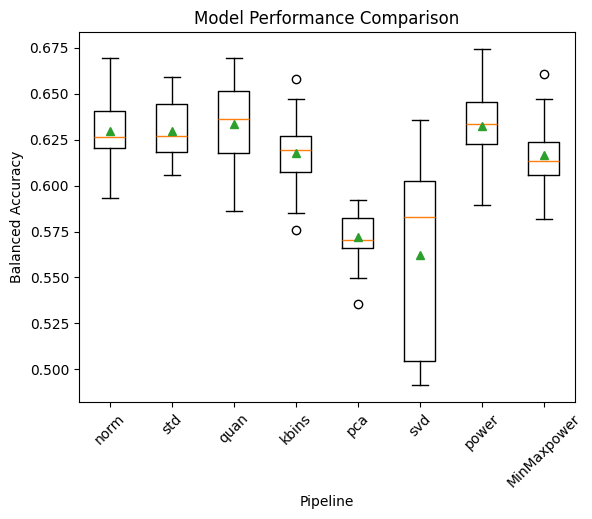

In [20]:
import numpy as np
import pandas as pd
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler, StandardScaler, QuantileTransformer, KBinsDiscretizer, PowerTransformer
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
from sklearn.model_selection import cross_val_score, RepeatedStratifiedKFold
from sklearn.metrics import matthews_corrcoef, cohen_kappa_score, balanced_accuracy_score, precision_recall_curve, roc_curve, class_likelihood_ratios, det_curve, roc_auc_score 
import matplotlib.pyplot as plt

start_timer()

# Define a class to impute missing values with zeros
class ZeroImputer:
    def __init__(self):
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return np.nan_to_num(X)

def get_pipelines(model):
    pipelines = list()

    # Add an imputer to handle missing values
    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', MinMaxScaler()), ('m', model)])
    pipelines.append(('norm', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', StandardScaler()), ('m', model)])
    pipelines.append(('std', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', QuantileTransformer(n_quantiles=100, output_distribution='normal')), ('m', model)])
    pipelines.append(('quan', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', KBinsDiscretizer(n_bins=10, encode='ordinal', strategy='uniform')), ('m', model)])
    pipelines.append(('kbins', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', PCA(n_components=7)), ('m', model)])
    pipelines.append(('pca', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', TruncatedSVD(n_components=7)), ('m', model)])
    pipelines.append(('svd', p))

    # Alto custo computacional, será utilizada separadamente posteriormente
    # p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('r', RFE(estimator=LogisticRegression(solver='liblinear'), n_features_to_select=10)), ('m',model)])
    # pipelines.append(('RFE', p))

    # p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', StandardScaler()), ('r', RFE(estimator=LogisticRegression(solver='liblinear'), n_features_to_select=10)), ('m',model)])
    # pipelines.append(('stdRFE', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('p', PowerTransformer()), ('m',model)])
    pipelines.append(('power', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', MinMaxScaler((1,2))), ('p', PowerTransformer()), ('m',model)])
    pipelines.append(('MinMaxpower', p))

    return pipelines


def evaluate_model(X, y, model):
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    scores = cross_val_score(model, X, y, scoring='balanced_accuracy', cv=cv, n_jobs=-1)
    return scores


# Split the DataFrame into features (X) and target (y)
X = df.iloc[:, :-1]
y = df.iloc[:, -1]

# Convert X and y to numpy arrays
X = np.array(X)
y = np.array(y)

# Define the model
model = LogisticRegression(class_weight='balanced')

# Get the modeling pipelines
pipelines = get_pipelines(model)

# Evaluate each pipeline
results, names = list(), list()
for name, pipeline in pipelines:
    # Evaluate
    scores = evaluate_model(X, y, pipeline)
    
    # Summarize
    print('>%s: %.3f (%.3f)' % (name, np.mean(scores), np.std(scores)))

    # Store
    results.append(scores)
    names.append(name)

# Plot the result
plt.boxplot(results, labels=names, showmeans=True)
plt.title('Model Performance Comparison')
plt.xlabel('Pipeline')
plt.ylabel('Balanced Accuracy')
plt.xticks(rotation=45)
plt.show()

end_timer()

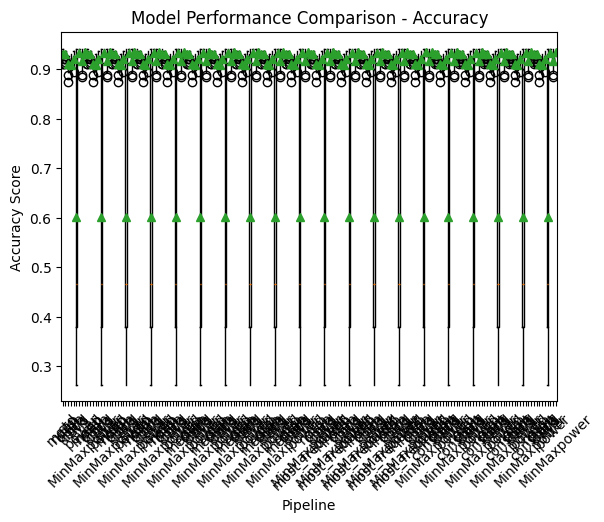

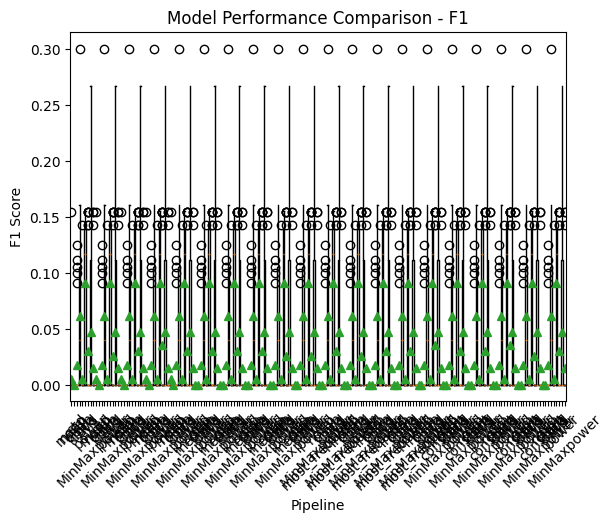

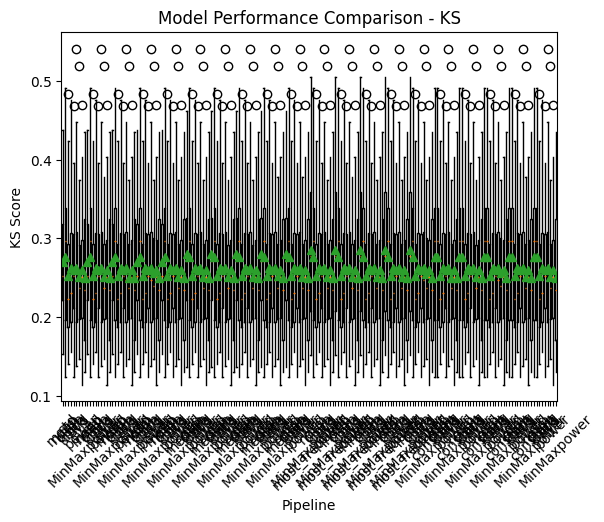

In [45]:
# CORRIGIR 

import numpy as np
import pandas as pd
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler, StandardScaler, QuantileTransformer, KBinsDiscretizer, PowerTransformer
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
from sklearn.model_selection import cross_val_score, RepeatedStratifiedKFold
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve, auc
from scipy.stats import ks_2samp
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=FutureWarning, module="sklearn.linear_model._sag")
warnings.filterwarnings("ignore", category=FutureWarning, message="In version 1.5 onwards, subsample=200_000 will be used by default.*")


class ZeroImputer:
    def __init__(self):
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return np.nan_to_num(X)

def get_pipelines(model, imputation_strategies):
    pipelines = list()

    for strategy in imputation_strategies:
        imputer = SimpleImputer(strategy=strategy)
        pipeline = Pipeline([
            ('imputer', imputer),
            ('s', MinMaxScaler()),
            ('m', model)
        ])
        pipelines.append((strategy, pipeline))
    # Add an imputer to handle missing values
    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', MinMaxScaler()), ('m', model)])
    pipelines.append(('norm', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', StandardScaler()), ('m', model)])
    pipelines.append(('std', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', QuantileTransformer(n_quantiles=100, output_distribution='normal')), ('m', model)])
    pipelines.append(('quan', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', KBinsDiscretizer(n_bins=10, encode='ordinal', strategy='uniform')), ('m', model)])
    pipelines.append(('kbins', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', PCA(n_components=7)), ('m', model)])
    pipelines.append(('pca', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', TruncatedSVD(n_components=7)), ('m', model)])
    pipelines.append(('svd', p))

    # p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('r', RFE(estimator=LogisticRegression(solver='liblinear'), n_features_to_select=10)), ('m',model)])
    # pipelines.append(('RFE', p))

    # p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', StandardScaler()), ('r', RFE(estimator=LogisticRegression(solver='liblinear'), n_features_to_select=10)), ('m',model)])
    # pipelines.append(('stdRFE', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('p', PowerTransformer()), ('m',model)])
    pipelines.append(('power', p))

    p = Pipeline([('imputer', SimpleImputer(strategy='constant', fill_value=0)), ('s', MinMaxScaler((1,2))), ('p', PowerTransformer()), ('m',model)])
    pipelines.append(('MinMaxpower', p))

    return pipelines

# Modify the evaluate_model function to return all metrics
def evaluate_model(X, y, model):
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    acc_scores, prec_scores, rec_scores, f1_scores, ks_scores, gini_scores, auc_scores = [], [], [], [], [], [], []

    for train_idx, test_idx in cv.split(X, y):
        X_train, X_test = X[train_idx], X[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]

        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        acc_scores.append(accuracy_score(y_test, y_pred))
        prec_scores.append(precision_score(y_test, y_pred, zero_division=1.0))  # Set zero_division to 1.0
        rec_scores.append(recall_score(y_test, y_pred))
        f1_scores.append(f1_score(y_test, y_pred))
        
        # Calculate KS statistic and Gini coefficient using the predicted probabilities
        y_prob = model.predict_proba(X_test)[:, 1]
        ks_stat, _ = ks_2samp(y_prob[y_test == 0], y_prob[y_test == 1])
        gini_coeff = 2 * roc_auc_score(y_test, y_prob) - 1

        ks_scores.append(ks_stat)
        gini_scores.append(gini_coeff)
        auc_scores.append(roc_auc_score(y_test, y_prob))

    return {
        'accuracy': acc_scores,
        'precision': prec_scores,
        'recall': rec_scores,
        'f1': f1_scores,
        'ks': ks_scores,
        'gini': gini_scores,
        'auc': auc_scores
    }


# Split the DataFrame into features (X) and target (y)
X = df.iloc[:, :-1]
y = df.iloc[:, -1]

# Convert X and y to numpy arrays
X = np.array(X)
y = np.array(y)
y = y.ravel()


# Define the solvers and imputer strategies to iterate over
solvers = ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
imputer_strategies = ['mean', 'median', 'most_frequent', 'constant']

# Initialize a list to store the results for each solver and strategy
all_results = []
raw_results = []
names = []

# Iterate over each imputation strategy
for imputer_strategy in imputer_strategies:
    pipelines = get_pipelines(LogisticRegression(class_weight='balanced', max_iter=10000), [imputer_strategy])

    # Iterate over each solver and pipeline for the current imputation strategy
    for solver in solvers:
        for pipeline_strategy, pipeline in pipelines:
            # Update the imputer strategy, solver, and pipeline strategy in the result_dict
            result_dict = {
                'Imputer Strategy': imputer_strategy,
                'Solver': solver,
                'Pipeline': pipeline_strategy,
            }

            # Evaluate
            metrics = evaluate_model(X, y, pipeline)

            # Store the results for each pipeline
            result_dict['Accuracy'] = np.mean(metrics['accuracy'])
            result_dict['Precision'] = np.mean(metrics['precision'])
            result_dict['Recall'] = np.mean(metrics['recall'])
            result_dict['F1'] = np.mean(metrics['f1'])
            result_dict['KS Statistic'] = np.mean(metrics['ks'])
            result_dict['Gini Coefficient'] = np.mean(metrics['gini'])
            result_dict['AUC'] = np.mean(metrics['auc'])

            # Store the results for plotting
            all_results.append(result_dict)

            # Store the results for plotting
            raw_results.append(metrics)
            names.append(pipeline_strategy)


# Create a DataFrame with all the results
df_results = pd.DataFrame(all_results)




# Plot the result
plt.boxplot([m['accuracy'] for m in raw_results], labels=names, showmeans=True)
plt.title('Model Performance Comparison - Accuracy')
plt.xlabel('Pipeline')
plt.ylabel('Accuracy Score')
plt.xticks(rotation=45)  # Rotate the labels for better visibility
plt.show()

plt.boxplot([m['f1'] for m in raw_results], labels=names, showmeans=True)
plt.title('Model Performance Comparison - F1')
plt.xlabel('Pipeline')
plt.ylabel('F1 Score')
plt.xticks(rotation=45)  # Rotate the labels for better visibility
plt.show()

plt.boxplot([m['ks'] for m in raw_results], labels=names, showmeans=True)
plt.title('Model Performance Comparison - KS')
plt.xlabel('Pipeline')
plt.ylabel('KS Score')
plt.xticks(rotation=45)  # Rotate the labels for better visibility
plt.show()

In [46]:
df_results.head(15)

,Imputer Strategy,Solver,Pipeline,Accuracy,Precision,Recall,F1,KS Statistic,Gini Coefficient,AUC
0,mean,newton-cg,mean,0.931335,0.600000,0.002778,0.005128,0.269583,0.071454,0.535727
1,mean,newton-cg,norm,0.931160,0.600000,0.000000,0.000000,0.276055,0.113549,0.556775
2,mean,newton-cg,std,0.910081,0.026944,0.013675,0.017743,0.251698,0.120369,0.560184
3,mean,newton-cg,quan,0.907793,0.092103,0.048291,0.061166,0.261790,0.079012,0.539506
4,mean,newton-cg,kbins,0.921145,0.083333,0.002778,0.004762,0.259589,0.088270,0.544135
5,mean,newton-cg,pca,0.601877,0.347858,0.429274,0.090246,0.262850,0.113502,0.556751
6,mean,newton-cg,svd,0.933791,0.700000,0.016239,0.030037,0.250993,0.149492,0.574746
7,mean,newton-cg,power,0.916578,0.097910,0.032051,0.046799,0.259335,0.130656,0.565328
8,mean,newton-cg,MinMaxpower,0.934846,0.933333,0.008120,0.015018,0.249254,0.116394,0.558197
9,mean,lbfgs,mean,0.931335,0.600000,0.002778,0.005128,0.269583,0.071454,0.535727


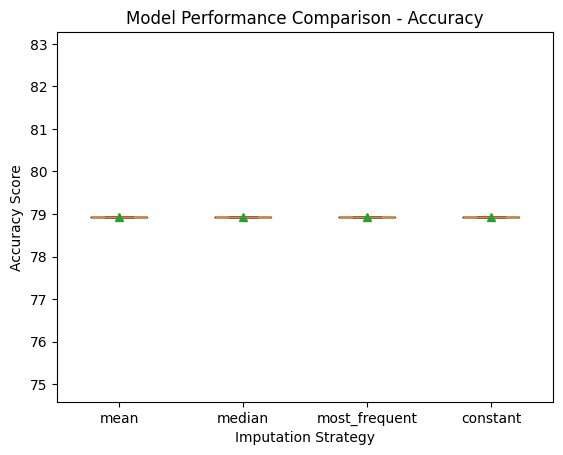

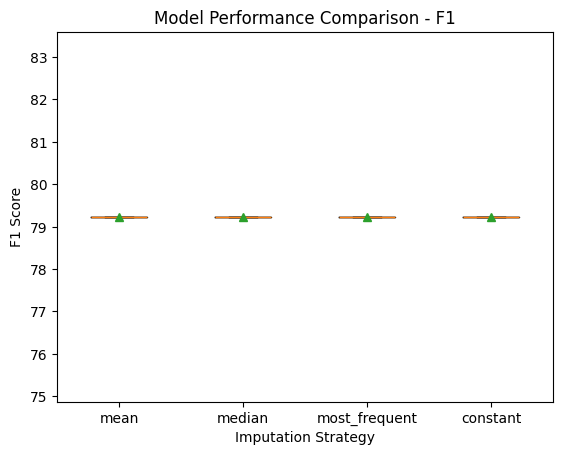

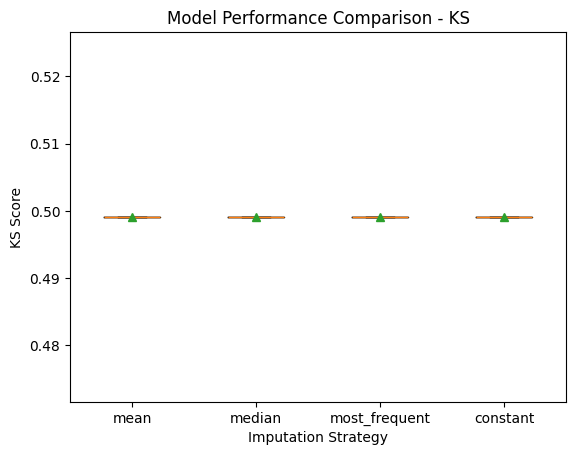

In [40]:
# DATA FAKE to test
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.model_selection import RepeatedStratifiedKFold, cross_val_predict
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from scipy.stats import ks_2samp

# Função para obter pipelines com diferentes estratégias de imputação
def get_pipelines(model, imputation_strategies):
    pipelines = list()

    for strategy in imputation_strategies:
        imputer = SimpleImputer(strategy=strategy)
        pipeline = Pipeline([
            ('imputer', imputer),
            ('s', MinMaxScaler()),
            ('m', model)
        ])
        pipelines.append((strategy, pipeline))

    return pipelines

# Criar um conjunto de dados fictício
#X, y = make_classification(n_samples=2000, n_features=400, n_informative=350, n_redundant=10, random_state=42)

# Definir estratégias de imputação e solvers para iterar
imputer_strategies = ['mean', 'median', 'most_frequent', 'constant']
solvers = ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']

# Inicializar listas para armazenar resultados
all_results = []

# Iterar sobre cada estratégia de imputação
for imputer_strategy in imputer_strategies:
    pipelines = get_pipelines(LogisticRegression(max_iter=10000, solver='liblinear'), [imputer_strategy])

    # Iterar sobre cada solver e pipeline para a estratégia de imputação atual
    for solver in solvers:
        for pipeline_strategy, pipeline in pipelines:
            # Inicializar listas para armazenar resultados para cada fold
            acc_scores, prec_scores, rec_scores, f1_scores, ks_scores, gini_scores, auc_scores = [], [], [], [], [], [], []

            # Realizar a validação cruzada repetida manualmente
            cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
            for train_idx, test_idx in cv.split(X, y):
                X_train, X_test = X[train_idx], X[test_idx]
                y_train, y_test = y[train_idx], y[test_idx]

                # Treinar o modelo
                pipeline.fit(X_train, y_train)

                # Obter as previsões de probabilidade
                y_pred_prob = pipeline.predict_proba(X_test)[:, 1]

                # Calcular métricas usando a função calculate_classification_metrics
                metrics_df_example = calculate_classification_metrics_one_class(y_test, y_pred_prob, target_class=1)

                # Armazenar as métricas para cada fold
                acc_scores.append(metrics_df_example.iloc[0, 1])
                prec_scores.append(metrics_df_example.iloc[0, 2])
                rec_scores.append(metrics_df_example.iloc[0, 3])
                f1_scores.append(metrics_df_example.iloc[0, 4])
                ks_scores.append(metrics_df_example.iloc[0, 5])
                gini_scores.append(metrics_df_example.iloc[0, 6])
                auc_scores.append(metrics_df_example.iloc[0, 7])

            # Calcular as médias das métricas para todos os folds
            result_dict = {
                'Imputer Strategy': imputer_strategy,
                'Solver': solver,
                'Pipeline': pipeline_strategy,
                'Accuracy': np.mean(acc_scores),
                'Precision': np.mean(prec_scores),
                'Recall': np.mean(rec_scores),
                'F1': np.mean(f1_scores),
                'KS Statistic': np.mean(ks_scores),
                'Gini Coefficient': np.mean(gini_scores),
                'AUC': np.mean(auc_scores),
            }

            # Armazenar os resultados para cada pipeline
            all_results.append(result_dict)

# Criar um DataFrame com todos os resultados
df_results = pd.DataFrame(all_results)

# Plotar os resultados
plt.boxplot([df_results[df_results['Pipeline'] == p]['Accuracy'] for p in imputer_strategies], labels=imputer_strategies, showmeans=True)
plt.title('Model Performance Comparison - Accuracy')
plt.xlabel('Imputation Strategy')
plt.ylabel('Accuracy Score')
plt.show()

plt.boxplot([df_results[df_results['Pipeline'] == p]['F1'] for p in imputer_strategies], labels=imputer_strategies, showmeans=True)
plt.title('Model Performance Comparison - F1')
plt.xlabel('Imputation Strategy')
plt.ylabel('F1 Score')
plt.show()

plt.boxplot([df_results[df_results['Pipeline'] == p]['KS Statistic'] for p in imputer_strategies], labels=imputer_strategies, showmeans=True)
plt.title('Model Performance Comparison - KS')
plt.xlabel('Imputation Strategy')
plt.ylabel('KS Score')
plt.show()


## 5.	Depuração de Dados (Data Cleansing) 


Boa parte da depuração dos dados foi realizada em etapas previas, dentre elas: 
•	Eliminação de duplicatas. 
•	Abordagens para lidar com valores faltantes.
•	Tipificação apropriada das variáveis. 
•	Eliminação de erros, por exemplo, o caso de eliminação de variáveis em possível situação de MNAR.
Para evitar redundância na discussão, os tópicos supracitados não serão abordados novamente.

Data cleansing was performed in previous steps, including:
•	Elimination of duplicates.
•	Approaches to deal with missing values.
•	Appropriate typing of variables.
•	Elimination of errors, for example, the case of elimination of variables in a possible situation of MNAR.
To avoid redundancy in the discussion, the aforementioned topics will not be addressed again.

## 6.	Lidando com Classes Desbalanceadas


Técnicas de Reamostragem de Dados: 
1. Superamostragem.
2. Subamostragem.
3. Reamostragem híbrida.

Além disso, é relevante utilizar Ponderação de Classes (Class Weighting) em todos os algoritmos de aprendizado de máquina.


In [48]:
#pip install imbalanced-learn


   ---------------------------------------- 0.0/235.6 kB ? eta -:--:--
   ----- ---------------------------------- 30.7/235.6 kB 1.3 MB/s eta 0:00:01
   ---------- ---------------------------- 61.4/235.6 kB 825.8 kB/s eta 0:00:01
   --------------- ----------------------- 92.2/235.6 kB 871.5 kB/s eta 0:00:01
   ------------------- ------------------ 122.9/235.6 kB 798.9 kB/s eta 0:00:01
   ---------------------------- --------- 174.1/235.6 kB 876.1 kB/s eta 0:00:01
   --------------------------------- ---- 204.8/235.6 kB 888.4 kB/s eta 0:00:01
   -------------------------------------- 235.6/235.6 kB 847.4 kB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [79]:
'''from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import average_precision_score, accuracy_score, f1_score, precision_score, roc_auc_score, balanced_accuracy_score, cohen_kappa_score, matthews_corrcoef, auc, roc_curve, precision_recall_curve
from imblearn.over_sampling import ADASYN, SMOTE
from imblearn.under_sampling import EditedNearestNeighbours, TomekLinks, ClusterCentroids, NearMiss, RepeatedEditedNearestNeighbours
from imblearn.combine import SMOTETomek, SMOTEENN
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load dataset 
# X = df.drop(columns='label')
# y = df['label']
#X = X.fillna(0)


# Split the DataFrame into features (X) and target (y)
X = df.iloc[:, :-1]
y = df.iloc[:, -1]

# Convert X and y to numpy arrays
X = np.array(X)
y = np.array(y)
y = y.ravel()

X = np.nan_to_num(X, nan=0)

# Define a function for evaluating a given model
def evaluate_model(X_train, y_train, X_test, y_test, model, class_weight=None):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_prob = model.predict_proba(X_test)[:, 1]
    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred)
    balanced_f1 = f1_score(y_test, y_pred, average='weighted')
    balanced_accuracy = balanced_accuracy_score(y_test, y_pred)
    kappa = cohen_kappa_score(y_test, y_pred)
    gini = 2 * roc_auc - 1
    mcc = matthews_corrcoef(y_test, y_pred)
    ks_stat, _ = ks_2samp(y_prob[y_test == 0], y_prob[y_test == 1])
    auc_prc = average_precision_score(y_test, y_prob)

    return accuracy, f1, precision, roc_auc, balanced_f1, balanced_accuracy, kappa, gini, mcc, ks_stat, auc_prc

# Split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

results_df = pd.DataFrame()

# Original approach
accuracy, f1, precision, roc_auc, balanced_f1, balanced_accuracy, kappa, gini, mcc, ks_stat, auc_prc = evaluate_model(X_train, y_train, X_test, y_test, LogisticRegression(solver='liblinear', class_weight='balanced', max_iter=500), class_weight='balanced')
print("Original Approach:")
print("Accuracy: %.2f%%" % (accuracy * 100))
print("F1 Score: %.3f" % f1)
print("Precision: %.3f" % precision)
print("ROC AUC: %.3f" % roc_auc)
print("Balanced F1 Score: %.3f" % balanced_f1)
print("Balanced Accuracy: %.3f" % balanced_accuracy)
print("Kappa: %.3f" % kappa)
print("Gini Coefficient: %.3f" % gini)
print("MCC: %.3f" % mcc)
print("KS Statistic: %.3f" % ks_stat)
print("AUC PRC: %.3f" % auc_prc)
print()

# List of combined sampling methods
combined_methods = [
    ADASYN(),
    SMOTETomek(),
    SMOTEENN(),
    SMOTE(sampling_strategy=0.50),  # Specify a custom sampling strategy
    EditedNearestNeighbours(),
    TomekLinks(),
    ClusterCentroids(),
    NearMiss(),
    RepeatedEditedNearestNeighbours()
]

# Dataframe to store the results
results_df = pd.DataFrame(columns=['Resampling Technique', 'Class Weight', 'Accuracy', 'F1 Score', 'Precision', 'ROC AUC', 'Balanced F1', 'Balanced Accuracy', 'Kappa', 'Gini Coefficient', 'MCC', 'KS Statistic', 'AUC PRC', 'Class0 Shape', 'Class1 Shape'])

# Loop through each combined method
for method in combined_methods:
    print(f"Evaluating {method.__class__.__name__}:")

    # Apply the combined sampling method to the training data
    X_resampled, y_resampled = method.fit_resample(X_train, y_train)

    # Evaluate the model using the resampled data without class_weight
    accuracy, f1, precision, roc_auc, balanced_f1, balanced_accuracy, kappa, gini, mcc, ks_stat, auc_prc = evaluate_model(X_resampled, y_resampled, X_test, y_test, LogisticRegression(solver='liblinear', max_iter=800))
    print("Without Class Weight:")
    print("Accuracy: %.2f%%" % (accuracy * 100))
    print("F1 Score: %.3f" % f1)
    print("Precision: %.3f" % precision)
    print("ROC AUC: %.3f" % roc_auc)
    print("Balanced F1 Score: %.3f" % balanced_f1)
    print("Balanced Accuracy: %.3f" % balanced_accuracy)
    print("Kappa: %.3f" % kappa)
    print("Gini Coefficient: %.3f" % gini)
    print("MCC: %.3f" % mcc)
    print("KS Statistic: %.3f" % ks_stat)
    print("AUC PRC: %.3f" % auc_prc)

    # Save the results to the dataframe
    results_df = results_df.append({
        'Resampling Technique': method.__class__.__name__,
        'Class Weight': 'Without Class Weight',
        'Accuracy': accuracy,
        'F1 Score': f1,
        'Precision': precision,
        'ROC AUC': roc_auc,
        'Balanced F1': balanced_f1,
        'Balanced Accuracy': balanced_accuracy,
        'Kappa': kappa,
        'Gini Coefficient': gini,
        'MCC': mcc,
        'KS Statistic': ks_stat,
        'AUC PRC': auc_prc,
        'Class0 Shape': X_resampled[y_resampled == 0].shape,
        'Class1 Shape': X_resampled[y_resampled == 1].shape
    }, ignore_index=True)

    # Evaluate the model using the resampled data with class_weight
    accuracy, f1, precision, roc_auc, balanced_f1, balanced_accuracy, kappa, gini, mcc, ks_stat, auc_prc = evaluate_model(X_resampled, y_resampled, X_test, y_test, LogisticRegression(solver='liblinear', class_weight='balanced', max_iter=800), class_weight='balanced')
    print("With Class Weight:")
    print("Accuracy: %.2f%%" % (accuracy * 100))
    print("F1 Score: %.3f" % f1)
    print("Precision: %.3f" % precision)
    print("ROC AUC: %.3f" % roc_auc)
    print("Balanced F1 Score: %.3f" % balanced_f1)
    print("Balanced Accuracy: %.3f" % balanced_accuracy)
    print("Kappa: %.3f" % kappa)
    print("Gini Coefficient: %.3f" % gini)
    print("MCC: %.3f" % mcc)
    print("KS Statistic: %.3f" % ks_stat)
    print("AUC PRC: %.3f" % auc_prc)

    # Save the results to the dataframe
    results_df = results_df.concat({
        'Resampling Technique': method.__class__.__name__,
        'Class Weight': 'With Class Weight',
        'Accuracy': accuracy,
        'F1 Score': f1,
        'Precision': precision,
        'ROC AUC': roc_auc,
        'Balanced F1': balanced_f1,
        'Balanced Accuracy': balanced_accuracy,
        'Kappa': kappa,
        'Gini Coefficient': gini,
        'MCC': mcc,
        'KS Statistic': ks_stat,
        'AUC PRC': auc_prc,
        'Class0 Shape': X_resampled[y_resampled == 0].shape,
        'Class1 Shape': X_resampled[y_resampled == 1].shape
    }, ignore_index=True)

    print()

# Save the results dataframe to a CSV file
results_df.to_csv(f'{files_directory}/resampling_results.csv', index=False)'''


Original Approach:
Accuracy: 58.41%
F1 Score: 0.133
Precision: 0.075
ROC AUC: 0.594
Balanced F1 Score: 0.695
Balanced Accuracy: 0.594
Kappa: 0.043
Gini Coefficient: 0.188
MCC: 0.085
KS Statistic: 0.215
AUC PRC: 0.081

Evaluating ADASYN:
Without Class Weight:
Accuracy: 60.26%
F1 Score: 0.140
Precision: 0.079
ROC AUC: 0.608
Balanced F1 Score: 0.710
Balanced Accuracy: 0.608
Kappa: 0.052
Gini Coefficient: 0.217
MCC: 0.099
KS Statistic: 0.223
AUC PRC: 0.079


AttributeError: 'DataFrame' object has no attribute 'append'

,Resampling Technique,Class Weight,Accuracy,F1 Score,Precision,ROC AUC,Balanced F1 Score,Balanced Accuracy,Kappa,Gini Coefficient,MCC,KS Statistic,AUC PRC,Sample shape X class0,Sample shape X class1
0,Original,With Class Weight,0.686842,0.131387,0.080357,0.534930,0.764410,0.534930,0.026690,0.069859,0.037987,0.199437,0.082904,"(1419, 480)","(99, 480)"
1,ADASYN,With Class Weight,0.713158,0.141732,0.088235,0.549014,0.782668,0.549014,0.040315,0.098028,0.054842,0.142535,0.070891,"(1419, 480)","(1461, 480)"
2,SMOTETomek,With Class Weight,0.705263,0.125000,0.077670,0.526197,0.776878,0.526197,0.021384,0.052394,0.029222,0.145352,0.071110,"(1379, 480)","(1379, 480)"
3,SMOTEENN,With Class Weight,0.671053,0.125874,0.076271,0.526479,0.753227,0.526479,0.019405,0.052958,0.028374,0.162817,0.075604,"(829, 480)","(1221, 480)"
4,SMOTE,With Class Weight,0.707895,0.125984,0.078431,0.527606,0.778680,0.527606,0.022706,0.055211,0.030888,0.148169,0.074353,"(1419, 480)","(709, 480)"
5,EditedNearestNeighbours,With Class Weight,0.697368,0.135338,0.083333,0.540563,0.771768,0.540563,0.031901,0.081127,0.044591,0.139718,0.069284,"(1168, 480)","(99, 480)"
6,TomekLinks,With Class Weight,0.694737,0.134328,0.082569,0.539155,0.769935,0.539155,0.030570,0.078310,0.042924,0.182535,0.076210,"(1384, 480)","(99, 480)"
7,ClusterCentroids,With Class Weight,0.442105,0.123967,0.069124,0.515493,0.560025,0.515493,0.006781,0.030986,0.015521,0.120563,0.066399,"(99, 480)","(99, 480)"
8,NearMiss,With Class Weight,0.239474,0.132132,0.071429,0.537183,0.310616,0.537183,0.011877,0.074366,0.047046,0.154930,0.071762,"(99, 480)","(99, 480)"
9,RepeatedEditedNearestNeighbours,With Class Weight,0.681579,0.116788,0.071429,0.513521,0.760450,0.513521,0.010331,0.027042,0.014705,0.116056,0.065356,"(1030, 480)","(99, 480)"


In [80]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    accuracy_score,
    f1_score,
    precision_score,
    roc_auc_score,
    balanced_accuracy_score,
    cohen_kappa_score,
    matthews_corrcoef,
    average_precision_score,
)
from imblearn.over_sampling import (
    ADASYN,
    SMOTE,
)
from imblearn.under_sampling import (
    EditedNearestNeighbours,
    TomekLinks,
    ClusterCentroids,
    NearMiss,
    RepeatedEditedNearestNeighbours,
    RandomUnderSampler,
)
from imblearn.combine import SMOTETomek, SMOTEENN

# Utilizar o pacote imblearn para avaliar várias técnicas de reamostragem
# Use imblearn's to evaluate several resampling techniques

# Load dataset 
# X = df.drop(columns='label')
# y = df['label']
#X = X.fillna(0)


# Split the DataFrame into features (X) and target (y)
X = df.iloc[:, :-1]
y = df.iloc[:, -1]

# Convert X and y to numpy arrays
X = np.array(X)
y = np.array(y)
y = y.ravel()

X = np.nan_to_num(X, nan=0)

# Define a function for evaluating a given model
def evaluate_model(X_train, y_train, X_test, y_test, model, class_weight=None):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_prob = model.predict_proba(X_test)[:, 1]

    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred)
    balanced_f1 = f1_score(y_test, y_pred, average='weighted')
    balanced_accuracy = balanced_accuracy_score(y_test, y_pred)
    kappa = cohen_kappa_score(y_test, y_pred)
    gini = 2 * roc_auc_score(y_test, y_pred) - 1
    mcc = matthews_corrcoef(y_test, y_pred)
    ks_stat, _ = ks_2samp(y_prob[y_test == 0], y_prob[y_test == 1])
    auc_prc = average_precision_score(y_test, y_prob)

    return accuracy, f1, precision, roc_auc, balanced_f1, balanced_accuracy, kappa, gini, mcc, ks_stat, auc_prc


# Split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# Initialize an empty list to store the DataFrames
results_dfs = []

# Original approach without class weight
accuracy, f1, precision, roc_auc, balanced_f1, balanced_accuracy, kappa, gini, mcc, ks_stat, auc_prc = evaluate_model(
    X_train, y_train, X_test, y_test, LogisticRegression(solver='liblinear', max_iter=500, class_weight=None),
    class_weight=None
)

# Create a DataFrame for the original approach
results_df = pd.DataFrame({
    'Resampling Technique': ['Original'],
    'Class Weight': ['None'],
    'Accuracy': [accuracy],
    'F1 Score': [f1],
    'Precision': [precision],
    'ROC AUC': [roc_auc],
    'Balanced F1 Score': [balanced_f1],
    'Balanced Accuracy': [balanced_accuracy],
    'Kappa': [kappa],
    'Gini Coefficient': [gini],
    'MCC': [mcc],
    'KS Statistic': [ks_stat],
    'AUC PRC': [auc_prc],
    'Sample shape X class0': [X_train[y_train == 0].shape[0]],
    'Sample shape X class1': [X_train[y_train == 1].shape[0]],
})

# Append the DataFrame to the list
results_dfs.append(results_df)

# Original approach with class weight
accuracy, f1, precision, roc_auc, balanced_f1, balanced_accuracy, kappa, gini, mcc, ks_stat, auc_prc = evaluate_model(
    X_train, y_train, X_test, y_test, LogisticRegression(solver='liblinear', max_iter=500, class_weight='balanced'),
    class_weight='balanced'
)

# Create a DataFrame for the original approach
results_df = pd.DataFrame({
    'Resampling Technique': ['Original'],
    'Class Weight': ['balanced'],
    'Accuracy': [accuracy],
    'F1 Score': [f1],
    'Precision': [precision],
    'ROC AUC': [roc_auc],
    'Balanced F1 Score': [balanced_f1],
    'Balanced Accuracy': [balanced_accuracy],
    'Kappa': [kappa],
    'Gini Coefficient': [gini],
    'MCC': [mcc],
    'KS Statistic': [ks_stat],
    'AUC PRC': [auc_prc],
    'Sample shape X class0': [X_train[y_train == 0].shape[0]],
    'Sample shape X class1': [X_train[y_train == 1].shape[0]],
})

# Append the DataFrame to the list
results_dfs.append(results_df)

# List of combined sampling methods
combined_methods = [
    ADASYN(),
    SMOTETomek(),
    SMOTEENN(),
    SMOTE(sampling_strategy=0.90),
    EditedNearestNeighbours(),
    TomekLinks(),
    ClusterCentroids(),
    NearMiss(),
    RepeatedEditedNearestNeighbours(sampling_strategy='auto'),
    RandomUnderSampler(sampling_strategy='majority'),  # Undersampling majority class
]

# Loop through each combined method
for method in combined_methods:
    # Evaluate with class_weight=None
    print(f"Evaluating {method.__class__.__name__}... Class Weight: None")
    X_resampled, y_resampled = method.fit_resample(X_train, y_train)
    accuracy, f1, precision, roc_auc, balanced_f1, balanced_accuracy, kappa, gini, mcc, ks_stat, auc_prc = evaluate_model(
        X_resampled, y_resampled, X_test, y_test, LogisticRegression(solver='liblinear', max_iter=500, class_weight=None),
        class_weight=None
    )

    results_df = pd.DataFrame({
        'Resampling Technique': [method.__class__.__name__],
        'Class Weight': [None],
        'Accuracy': [accuracy],
        'F1 Score': [f1],
        'Precision': [precision],
        'ROC AUC': [roc_auc],
        'Balanced F1 Score': [balanced_f1],
        'Balanced Accuracy': [balanced_accuracy],
        'Kappa': [kappa],
        'Gini Coefficient': [gini],
        'MCC': [mcc],
        'KS Statistic': [ks_stat],
        'AUC PRC': [auc_prc],
        'Sample shape X class0': [X_resampled[y_resampled == 0].shape[0]],
        'Sample shape X class1': [X_resampled[y_resampled == 1].shape[0]],
    })

    results_dfs.append(results_df)

    # Evaluate with class_weight='balanced'
    print(f"Evaluating {method.__class__.__name__}... Class Weight: balanced")
    X_resampled, y_resampled = method.fit_resample(X_train, y_train)
    accuracy, f1, precision, roc_auc, balanced_f1, balanced_accuracy, kappa, gini, mcc, ks_stat, auc_prc = evaluate_model(
        X_resampled, y_resampled, X_test, y_test, LogisticRegression(solver='liblinear', max_iter=500, class_weight='balanced'),
        class_weight='balanced'
    )

    results_df = pd.DataFrame({
        'Resampling Technique': [method.__class__.__name__],
        'Class Weight': ['balanced'],
        'Accuracy': [accuracy],
        'F1 Score': [f1],
        'Precision': [precision],
        'ROC AUC': [roc_auc],
        'Balanced F1 Score': [balanced_f1],
        'Balanced Accuracy': [balanced_accuracy],
        'Kappa': [kappa],
        'Gini Coefficient': [gini],
        'MCC': [mcc],
        'KS Statistic': [ks_stat],
        'AUC PRC': [auc_prc],
        'Sample shape X class0': [X_resampled[y_resampled == 0].shape[0]],
        'Sample shape X class1': [X_resampled[y_resampled == 1].shape[0]],
    })

    results_dfs.append(results_df)

# Concatenate all DataFrames in the list
final_results_df = pd.concat(results_dfs, ignore_index=True)

# Display the final results DataFrame
display(round(final_results_df,2))

round(final_results_df,2).to_csv(f'{files_directory}/resampling_results.csv', index=False)
end_timer()


Evaluating ADASYN... Class Weight: None
Evaluating ADASYN... Class Weight: balanced
Evaluating SMOTETomek... Class Weight: None
Evaluating SMOTETomek... Class Weight: balanced
Evaluating SMOTEENN... Class Weight: None
Evaluating SMOTEENN... Class Weight: balanced
Evaluating SMOTE... Class Weight: None
Evaluating SMOTE... Class Weight: balanced
Evaluating EditedNearestNeighbours... Class Weight: None
Evaluating EditedNearestNeighbours... Class Weight: balanced
Evaluating TomekLinks... Class Weight: None
Evaluating TomekLinks... Class Weight: balanced
Evaluating ClusterCentroids... Class Weight: None
Evaluating ClusterCentroids... Class Weight: balanced
Evaluating NearMiss... Class Weight: None
Evaluating NearMiss... Class Weight: balanced
Evaluating RepeatedEditedNearestNeighbours... Class Weight: None
Evaluating RepeatedEditedNearestNeighbours... Class Weight: balanced
Evaluating RandomUnderSampler... Class Weight: None
Evaluating RandomUnderSampler... Class Weight: balanced


,Resampling Technique,Class Weight,Accuracy,F1 Score,Precision,ROC AUC,Balanced F1 Score,Balanced Accuracy,Kappa,Gini Coefficient,MCC,KS Statistic,AUC PRC,Sample shape X class0,Sample shape X class1
0,Original,None,0.95,0.01,0.20,0.50,0.92,0.50,0.01,0.00,0.02,0.19,0.08,14386,800
1,Original,balanced,0.58,0.13,0.07,0.59,0.70,0.59,0.04,0.19,0.08,0.22,0.08,14386,800
2,ADASYN,None,0.59,0.14,0.08,0.61,0.70,0.61,0.05,0.23,0.10,0.24,0.08,14386,14184
3,ADASYN,balanced,0.59,0.14,0.08,0.60,0.70,0.60,0.05,0.20,0.09,0.22,0.08,14386,14184
4,SMOTETomek,None,0.60,0.14,0.08,0.61,0.71,0.61,0.05,0.21,0.10,0.24,0.08,14129,14129
5,SMOTETomek,balanced,0.60,0.14,0.08,0.60,0.71,0.60,0.05,0.20,0.09,0.22,0.08,14160,14160
6,SMOTEENN,None,0.48,0.13,0.07,0.59,0.61,0.59,0.03,0.19,0.08,0.22,0.08,9201,12942
7,SMOTEENN,balanced,0.58,0.14,0.08,0.60,0.69,0.60,0.05,0.21,0.09,0.24,0.08,9196,12995
8,SMOTE,None,0.64,0.14,0.08,0.60,0.74,0.60,0.05,0.21,0.10,0.23,0.08,14386,12947
9,SMOTE,balanced,0.59,0.14,0.08,0.60,0.70,0.60,0.05,0.21,0.09,0.23,0.08,14386,12947


In [81]:
round(final_results_df,2).to_csv(f'{files_directory}/resampling_results.csv', index=False)

## 7.	 Engenharia de Variáveis (ou Engenharia de Características)


* Observou-se que o Weight of Evidence (WOE) havia sido foi previamente aplicado. Nesse método, valores contínuos são transformados em categóricos, criando 20 categorias representando percentis de 5% cada. Assim, um novo conjunto de dados foi gerado, tratando todas as variáveis como categóricas. Essa abordagem é relevante, pois NaN, outliers e outros valores que poderiam exigir tratamento prévio são agrupados em uma única categoria, eliminando a necessidade de pré-processamentos adicionais.

In [17]:
# Segmentos das variaveis # Features segments

sector_columns = {
    'Bank account': [f'K{i:05d}' for i in range(1, 27)],
    'Credit Card Account': [f'K{i:05d}' for i in range(27, 84)],
    'Checking account': [f'K{i:05d}' for i in range(84, 209)],
    'Saving account': ['K00209'],
    'Pre approved credit': [f'K{i:05d}' for i in range(210, 212)],
    'Financial Instability': [f'K{i:05d}' for i in range(212, 269)],
    'Assets': [f'K{i:05d}' for i in range(269, 281)],
    'Income': [f'K{i:05d}' for i in range(281, 370)],
    'Expenses': [f'K{i:05d}' for i in range(370, 466)],
    'Insurance': [f'K{i:05d}' for i in range(466, 484)],
    'Liabilities': [f'K{i:05d}' for i in range(484, 541)]
}

# Print the generated lists for each sector
for sector, columns in sector_columns.items():
    print(f"{sector}: {columns}")

Bank account: ['K00001', 'K00002', 'K00003', 'K00004', 'K00005', 'K00006', 'K00007', 'K00008', 'K00009', 'K00010', 'K00011', 'K00012', 'K00013', 'K00014', 'K00015', 'K00016', 'K00017', 'K00018', 'K00019', 'K00020', 'K00021', 'K00022', 'K00023', 'K00024', 'K00025', 'K00026']
Credit Card Account: ['K00027', 'K00028', 'K00029', 'K00030', 'K00031', 'K00032', 'K00033', 'K00034', 'K00035', 'K00036', 'K00037', 'K00038', 'K00039', 'K00040', 'K00041', 'K00042', 'K00043', 'K00044', 'K00045', 'K00046', 'K00047', 'K00048', 'K00049', 'K00050', 'K00051', 'K00052', 'K00053', 'K00054', 'K00055', 'K00056', 'K00057', 'K00058', 'K00059', 'K00060', 'K00061', 'K00062', 'K00063', 'K00064', 'K00065', 'K00066', 'K00067', 'K00068', 'K00069', 'K00070', 'K00071', 'K00072', 'K00073', 'K00074', 'K00075', 'K00076', 'K00077', 'K00078', 'K00079', 'K00080', 'K00081', 'K00082', 'K00083']
Checking account: ['K00084', 'K00085', 'K00086', 'K00087', 'K00088', 'K00089', 'K00090', 'K00091', 'K00092', 'K00093', 'K00094', 'K00

In [19]:
sector_columns_binned = {
    'Bank account': [f'K{i:05d}_binned' for i in range(1, 27)],
    'Credit Card Account': [f'K{i:05d}_binned' for i in range(27, 84)],
    'Checking account': [f'K{i:05d}_binned' for i in range(84, 209)],
    'Saving account': ['K00209_binned'],
    'Pre approved credit': [f'K{i:05d}_binned' for i in range(210, 212)],
    'Financial Instability': [f'K{i:05d}_binned' for i in range(212, 269)],
    'Assets': [f'K{i:05d}_binned' for i in range(269, 281)],
    'Income': [f'K{i:05d}_binned' for i in range(281, 370)],
    'Expenses': [f'K{i:05d}_binned' for i in range(370, 466)],
    'Insurance': [f'K{i:05d}_binned' for i in range(466, 484)],
    'Liabilities': [f'K{i:05d}_binned' for i in range(484, 541)]
}

# Print the generated lists for each sector
for sector, columns in sector_columns_binned.items():
    print(f"{sector}: {columns}")


Bank account: ['K00001_binned', 'K00002_binned', 'K00003_binned', 'K00004_binned', 'K00005_binned', 'K00006_binned', 'K00007_binned', 'K00008_binned', 'K00009_binned', 'K00010_binned', 'K00011_binned', 'K00012_binned', 'K00013_binned', 'K00014_binned', 'K00015_binned', 'K00016_binned', 'K00017_binned', 'K00018_binned', 'K00019_binned', 'K00020_binned', 'K00021_binned', 'K00022_binned', 'K00023_binned', 'K00024_binned', 'K00025_binned', 'K00026_binned']
Credit Card Account: ['K00027_binned', 'K00028_binned', 'K00029_binned', 'K00030_binned', 'K00031_binned', 'K00032_binned', 'K00033_binned', 'K00034_binned', 'K00035_binned', 'K00036_binned', 'K00037_binned', 'K00038_binned', 'K00039_binned', 'K00040_binned', 'K00041_binned', 'K00042_binned', 'K00043_binned', 'K00044_binned', 'K00045_binned', 'K00046_binned', 'K00047_binned', 'K00048_binned', 'K00049_binned', 'K00050_binned', 'K00051_binned', 'K00052_binned', 'K00053_binned', 'K00054_binned', 'K00055_binned', 'K00056_binned', 'K00057_bin

In [64]:
# Carrega o dataframe
df = pd.read_csv(f'{files_directory}/df_droped_001.csv')
df

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00013,...,K00534,K00535,K00536,K00537,K00538,K00540,count_of_nan,count_of_nan_zero,count_of_zero,label
0,0,0,14.0,14.0,14.0,14.0,0.0,0.0,NaN,0.0,...,0.0,0.0,NaN,0.0,0.0,0.0,129,453,324,0
1,1,1,19.0,19.0,19.0,19.0,0.0,0.0,41.0,14.0,...,0.0,0.0,0.0,0.0,0.0,0.0,25,375,350,0
2,2,0,13.0,13.0,13.0,13.0,0.0,0.0,NaN,5.0,...,0.0,20.0,0.0,0.0,1.0,20.0,91,426,335,0
3,3,2,21.0,21.0,21.0,21.0,0.0,0.0,310.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,180,472,292,0
4,4,3,1.0,1.0,1.0,1.0,0.0,0.0,257.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,95,382,287,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,18978,2,13.0,13.0,13.0,13.0,0.0,0.0,95.0,14.0,...,0.0,0.0,0.0,0.0,0.0,0.0,106,368,262,0
18979,18979,0,8.0,8.0,8.0,8.0,0.0,0.0,NaN,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,500,526,26,0
18980,18980,2,16.0,16.0,16.0,16.0,0.0,0.0,217.0,7.0,...,1090.0,1155.0,1.0,6.0,10.0,385.0,21,291,270,0
18981,18981,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,500,530,30,0


In [65]:
# Normalizar as variaveis # Normalize the variables columns[2:481]
from sklearn.preprocessing import MinMaxScaler
df_norm = df.copy()
df_norm.iloc[:, 2:481] = MinMaxScaler().fit_transform(df_norm.iloc[:, 2:481])
#df_norm = df_norm.fillna(-0.05)
df_norm

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00013,...,K00534,K00535,K00536,K00537,K00538,K00540,count_of_nan,count_of_nan_zero,count_of_zero,label
0,0,0,0.583333,0.636364,0.636364,0.636364,0.0,0.0,NaN,0.000000,...,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.225743,0.733945,0.842541,0
1,1,1,0.791667,0.863636,0.863636,0.863636,0.0,0.0,0.028025,0.358974,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.019802,0.495413,0.914365,0
2,2,0,0.541667,0.590909,0.590909,0.590909,0.0,0.0,NaN,0.128205,...,0.000000,0.000142,0.000000,0.000000,0.008403,0.000426,0.150495,0.651376,0.872928,0
3,3,2,0.875000,0.954545,0.954545,0.954545,0.0,0.0,0.211893,NaN,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.326733,0.792049,0.754144,0
4,4,3,0.041667,0.045455,0.045455,0.045455,0.0,0.0,0.175666,NaN,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.158416,0.516820,0.740331,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,18978,2,0.541667,0.590909,0.590909,0.590909,0.0,0.0,0.064935,0.358974,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.180198,0.474006,0.671271,0
18979,18979,0,0.333333,0.363636,0.363636,0.363636,0.0,0.0,NaN,0.128205,...,NaN,NaN,NaN,NaN,NaN,NaN,0.960396,0.957187,0.019337,0
18980,18980,2,0.666667,0.727273,0.727273,0.727273,0.0,0.0,0.148325,0.179487,...,0.031160,0.008202,0.030303,0.085714,0.084034,0.008202,0.011881,0.238532,0.693370,0
18981,18981,0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,NaN,0.051282,...,NaN,NaN,NaN,NaN,NaN,NaN,0.960396,0.969419,0.030387,0


In [88]:
# Cria um novo DataFrame para armazenar os dados agrupados
# Create a new DataFrame to store binned data 
df_bins = df_norm.copy()

start_timer()
# Divide cada coluna em 20 bins e atribui rótulos
# Split features into 20 bins manually and assign labels
num_bins = 20
bin_labels = range(1, num_bins + 1)  # Use 20 labels for 20 bins 

for sector, columns in sector_columns.items():
    valid_columns = [col for col in columns if col in df_bins.columns]
    if valid_columns:
        for col in valid_columns:
            col_values = df_bins[col].to_numpy()
            bins = pd.cut(col_values, bins=num_bins, labels=bin_labels, duplicates='drop')
            df_bins[f"{col}_binned"] = bins
columns_to_drop = df_bins.columns[2:481]
df_bins = df_bins.drop(columns=columns_to_drop)

# Save the resulting DataFrame with binned columns
df_bins.to_csv("binned_data.csv", index=False)
end_timer()    

Tempo de execução: 4.99585223197937 segundos


In [90]:
df_bins['label'] = df['label'].copy()
# For categorical columns, convert NaN to a new category ( NaN as a separate category)
categorical_columns = df_bins.select_dtypes(include='category').columns
# Setitem on a Categorical with a new category (0), set the categories first
for col in categorical_columns:
   df_bins[col] = df_bins[col].cat.add_categories([0])
df_bins[categorical_columns] = df_bins[categorical_columns].fillna(0)
df_bins

,user_id,bank,K00001_binned,K00002_binned,K00003_binned,K00004_binned,K00005_binned,K00006_binned,K00007_binned,K00013_binned,...,K00531_binned,K00532_binned,K00533_binned,K00534_binned,K00535_binned,K00536_binned,K00537_binned,K00538_binned,K00540_binned,label
0,0,0,12,13,13,13,1,1,0,1,...,1,1,0,1,1,0,1,1,1,0
1,1,1,16,18,18,18,1,1,1,8,...,20,1,1,1,1,1,1,1,1,0
2,2,0,11,12,12,12,1,1,0,3,...,20,1,1,1,1,1,1,1,1,0
3,3,2,18,20,20,20,1,1,5,0,...,0,1,1,1,1,1,1,1,1,0
4,4,3,1,1,1,1,1,1,4,0,...,0,1,1,1,1,1,1,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,18978,2,11,12,12,12,1,1,2,8,...,0,1,1,1,1,1,1,1,1,0
18979,18979,0,7,8,8,8,1,1,0,3,...,0,0,0,0,0,0,0,0,0,0
18980,18980,2,14,15,15,15,1,1,3,4,...,20,1,1,1,1,1,2,2,1,0
18981,18981,0,1,1,1,1,1,1,0,2,...,0,0,0,0,0,0,0,0,0,0


<Figure size 1200x800 with 0 Axes>

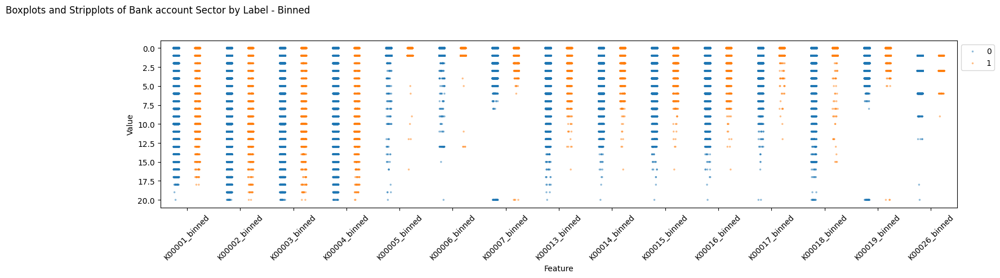

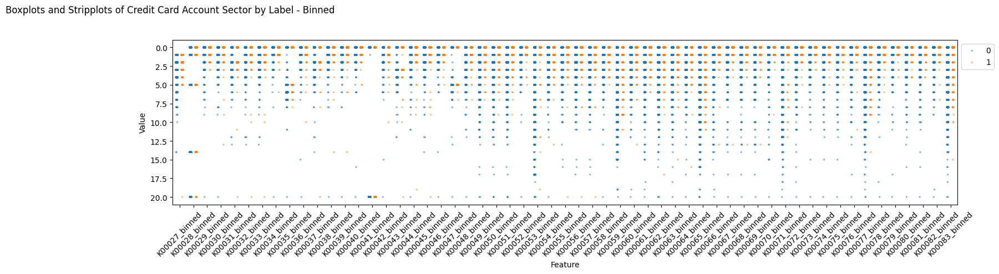

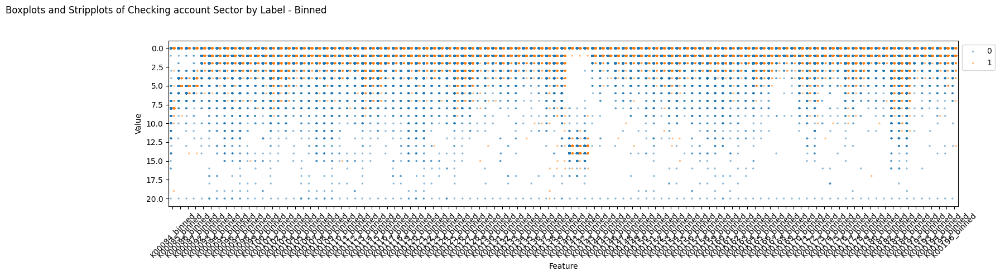

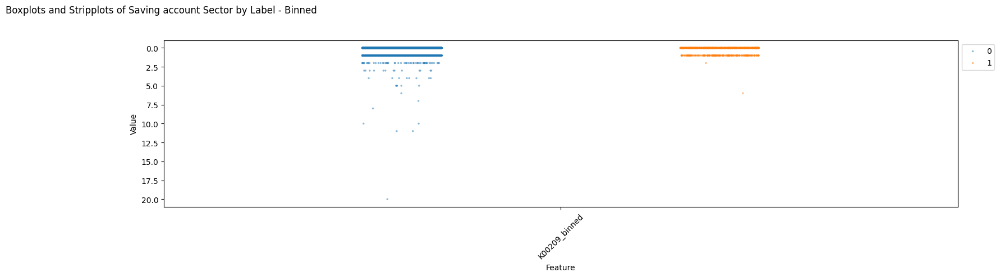

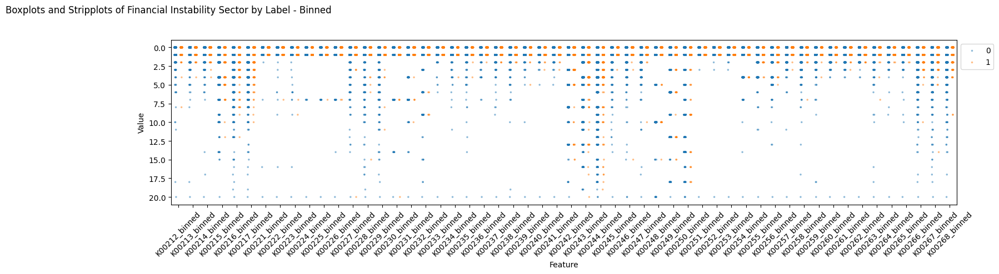

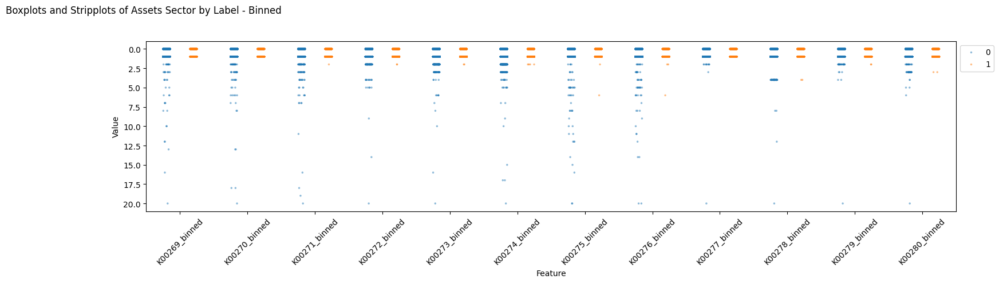

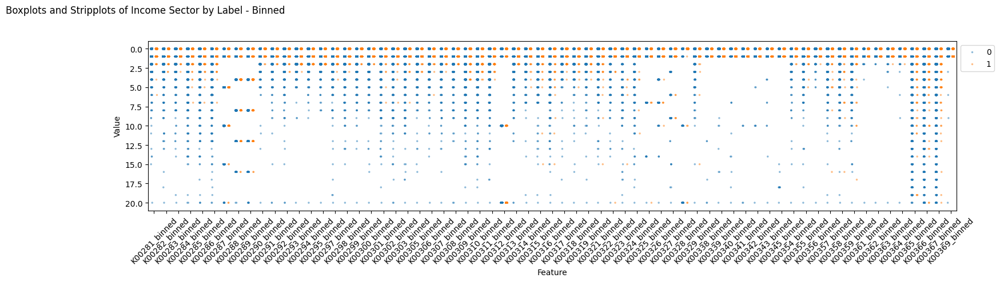

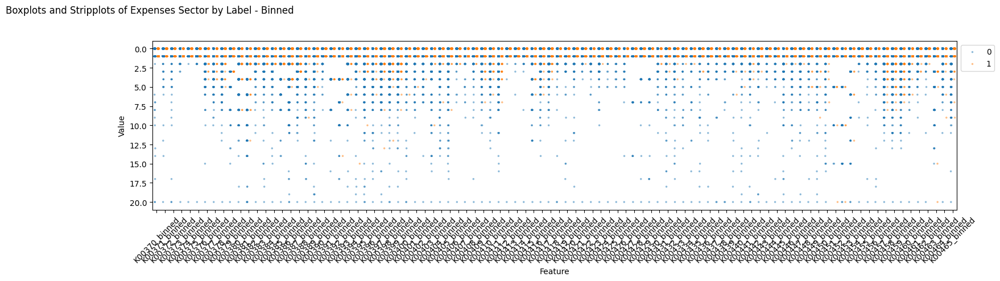

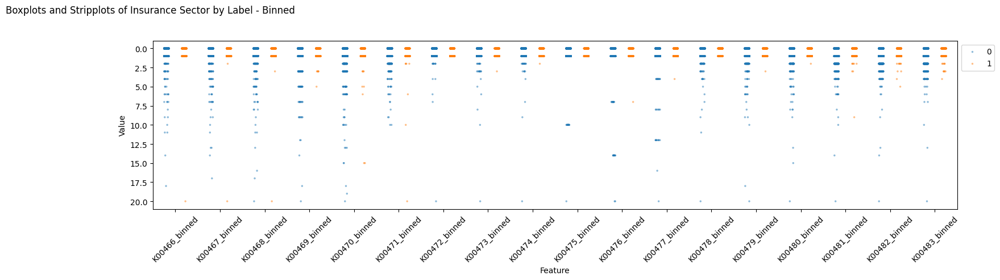

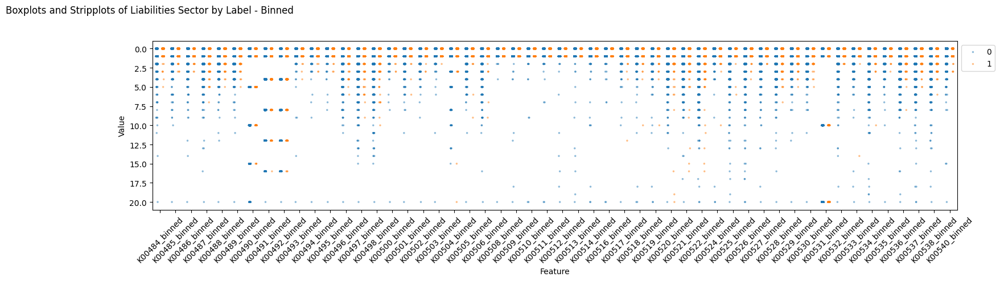

Tempo de execução: 67.21745252609253 segundos


In [92]:
# Plot binned data for each sector

# Create a list of sector names
sectors_binned = list(sector_columns_binned.keys())

start_timer()
# Create a boxplot and stripplot for each sector's columns
plt.figure(figsize=(12, 8))
for sector, columns in sector_columns_binned.items():
    valid_columns_binned = [col for col in columns if col in df_bins.columns]
    if valid_columns_binned:
        plt.figure(figsize=(30, 5))
        data_subset = df_bins[valid_columns_binned].copy()  # Include 'label' column and valid columns
        
        data_subset['label'] = df['label'].copy()
        
        melted_data = data_subset.melt(id_vars=['label'], value_vars=valid_columns_binned, var_name='Feature')
        
        # plt.subplot(1, 2, 1)
        # sns.boxplot(data=melted_data, x='Feature', y='value', hue='label')
        
        plt.subplot(1, 2, 2)
        sns.stripplot(data=melted_data, x='Feature', y='value', hue='label', dodge=True, marker='.', alpha=0.5)
        
        plt.xticks(rotation=45)
        plt.xlabel('Feature')
        plt.ylabel('Value')
        plt.suptitle(f'Boxplots and Stripplots of {sector} Sector by Label - Binned')

        # Set legend location explicitly and make legend box transparent
        legend = plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
        legend.get_frame().set_facecolor('none')

        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()

end_timer()

<Figure size 1200x800 with 0 Axes>

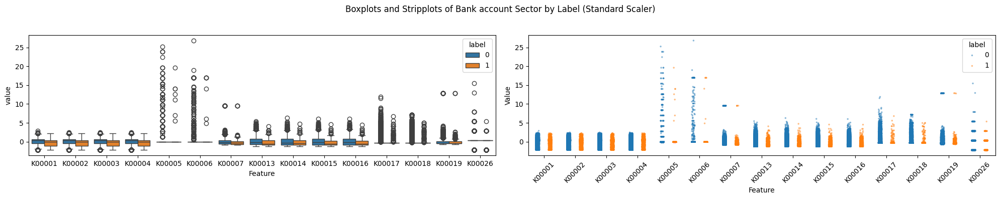

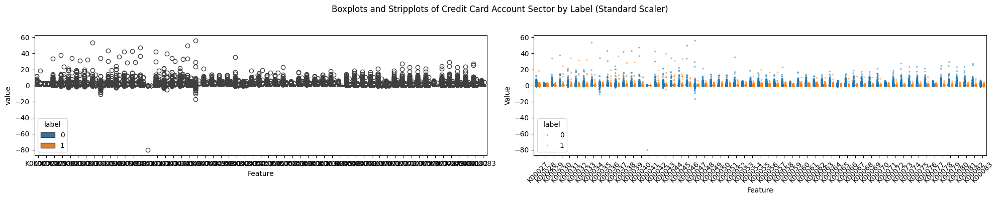

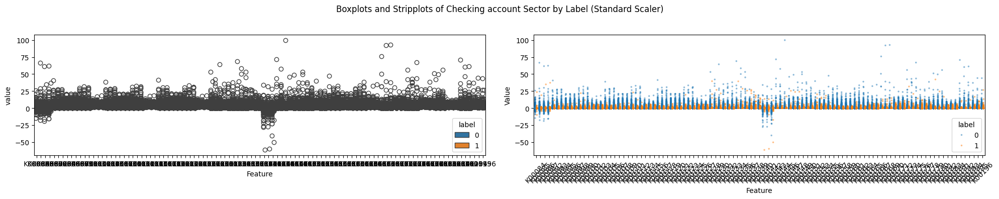

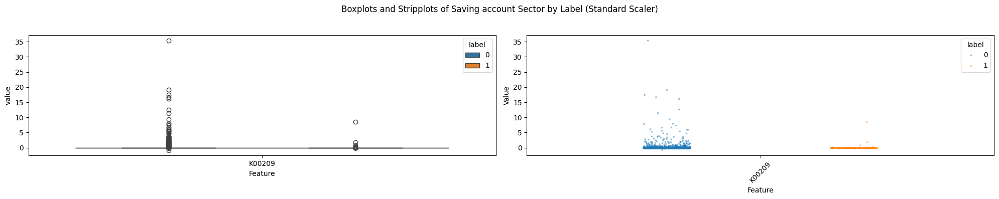

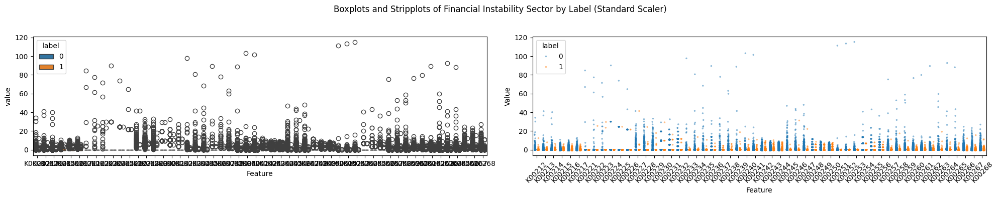

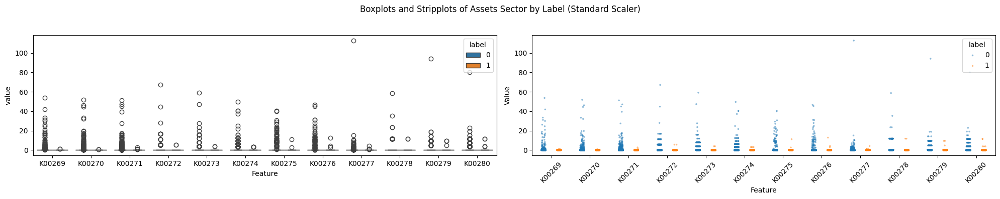

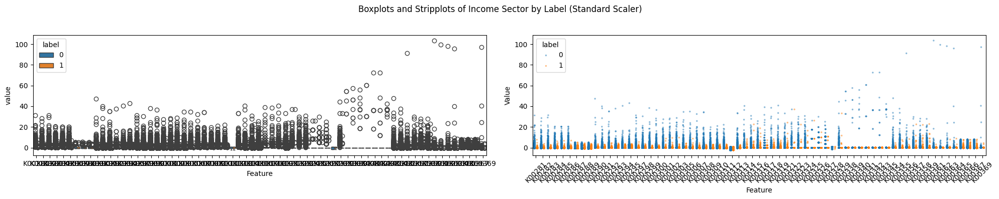

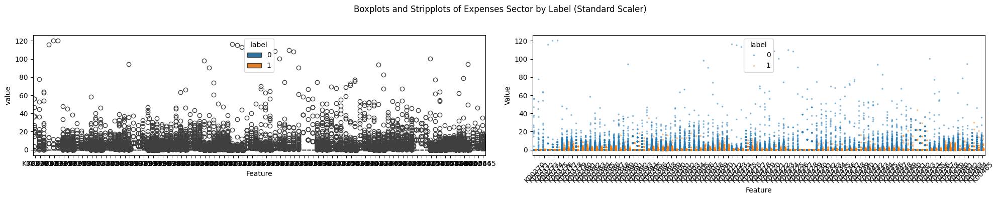

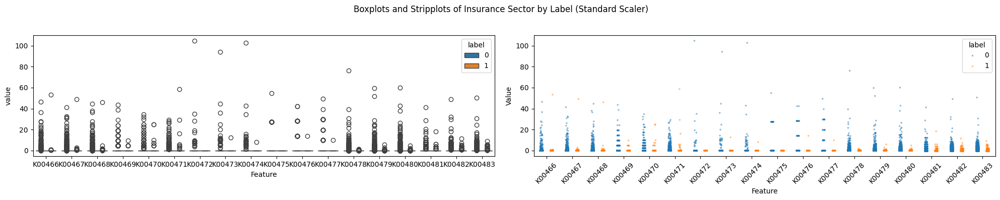

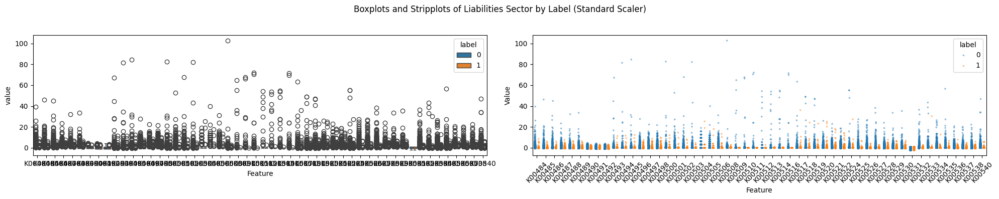

Tempo de execução: 149.65817260742188 segundos


In [93]:
# StandardScaler
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Create a list of sector names
sectors = list(sector_columns.keys())
start_timer()
# Create a boxplot and stripplot for each sector's columns
plt.figure(figsize=(12, 8))
for sector, columns in sector_columns.items():
    valid_columns = [col for col in columns if col in df.columns]
    if valid_columns:
        plt.figure(figsize=(20, 4))
        data_subset = df[['label'] + valid_columns]  # Include 'label' column and valid columns
        
        # Apply StandardScaler scaling
        scaler = StandardScaler()
        data_scaled = scaler.fit_transform(data_subset[valid_columns])
        data_scaled_df = pd.DataFrame(data_scaled, columns=valid_columns)
        data_scaled_df['label'] = data_subset['label']
        
        melted_data = data_scaled_df.melt(id_vars=['label'], value_vars=valid_columns, var_name='Feature')
        
        plt.subplot(1, 2, 1)
        sns.boxplot(data=melted_data, x='Feature', y='value', hue='label')
        
        plt.subplot(1, 2, 2)
        sns.stripplot(data=melted_data, x='Feature', y='value', hue='label', dodge=True, marker='.', alpha=0.5)
        
        plt.xticks(rotation=45)
        plt.xlabel('Feature')
        plt.ylabel('Value')
        plt.suptitle(f'Boxplots and Stripplots of {sector} Sector by Label (Standard Scaler)')
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()
end_timer()

<Figure size 1200x800 with 0 Axes>

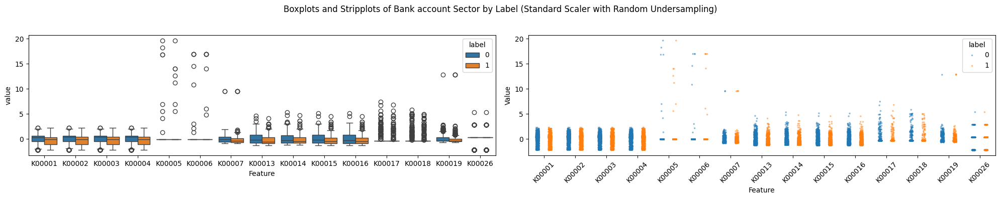

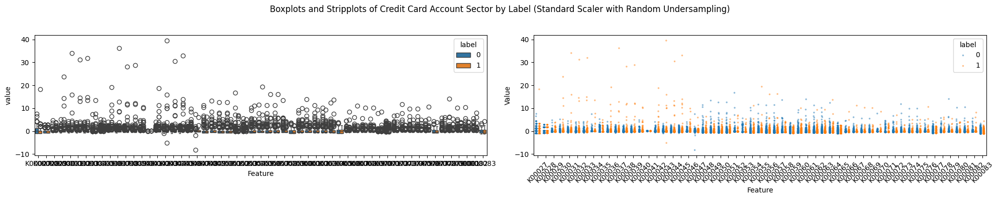

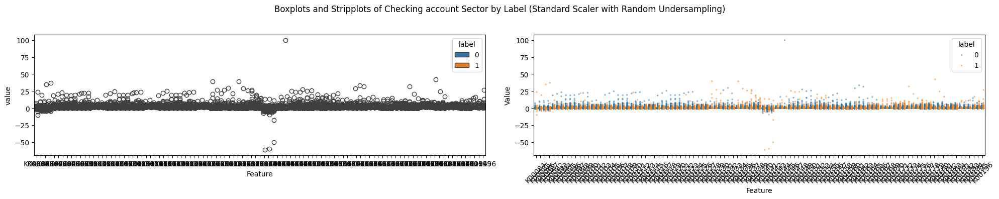

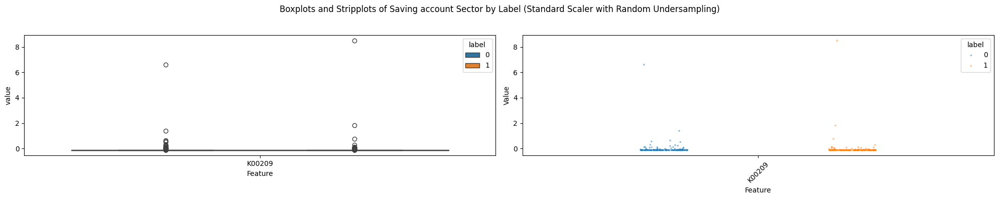

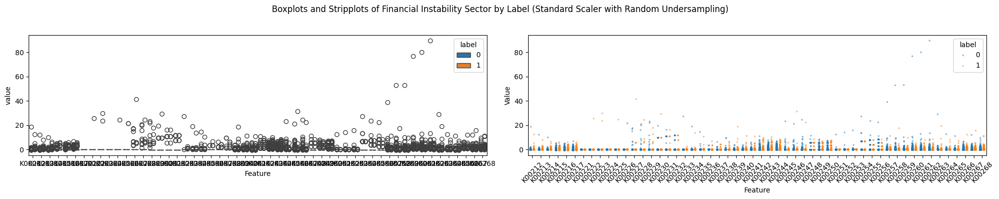

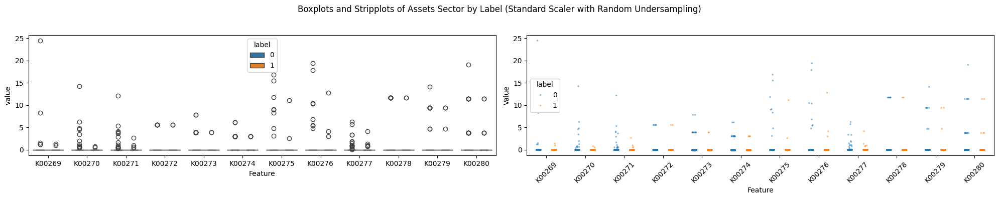

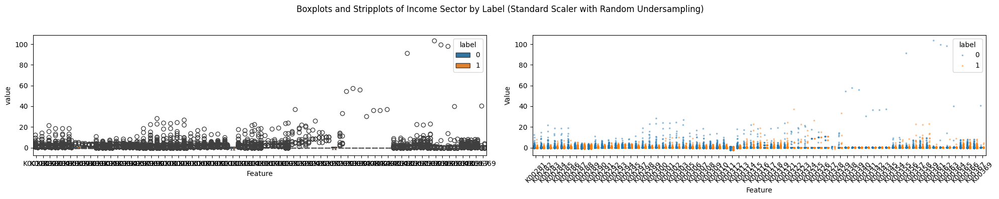

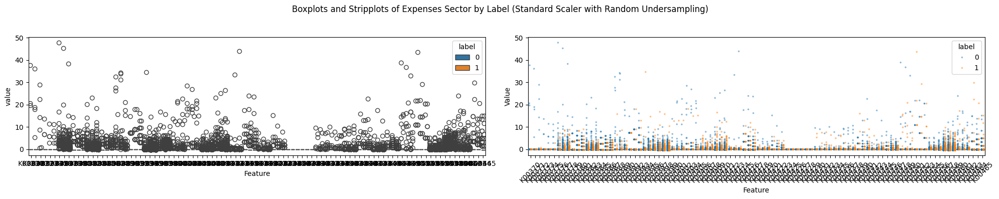

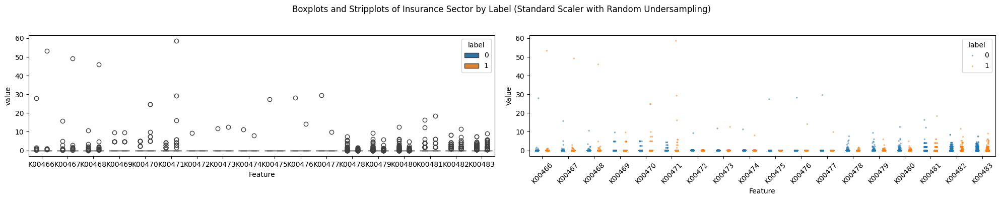

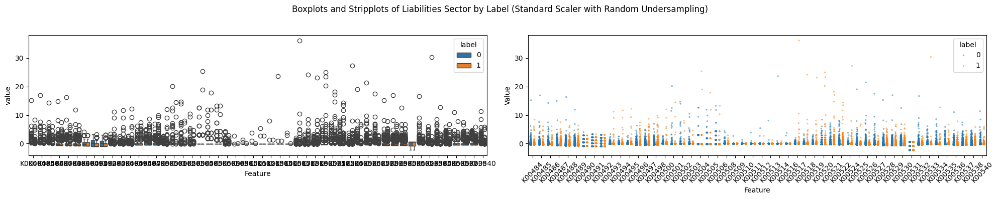

Tempo de execução: 25.509060621261597 segundos


In [94]:
# StandardScaler with RandomUnderSampler
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from imblearn.under_sampling import RandomUnderSampler

# Create a list of sector names
sectors = list(sector_columns.keys())

# Function to perform random undersampling
def perform_random_undersampling(X, y):
    sampler = RandomUnderSampler(sampling_strategy='majority', random_state=42)
    X_resampled, y_resampled = sampler.fit_resample(X, y)
    return X_resampled, y_resampled

start_timer()

# Create a boxplot and stripplot for each sector's columns
plt.figure(figsize=(12, 8))
for sector, columns in sector_columns.items():
    valid_columns = [col for col in columns if col in df.columns]
    if valid_columns:
        plt.figure(figsize=(20, 4))
        data_subset = df[['label'] + valid_columns]  # Include 'label' column and valid columns
        
        # Apply StandardScaler scaling
        scaler = StandardScaler()
        data_scaled = scaler.fit_transform(data_subset[valid_columns])
        data_scaled_df = pd.DataFrame(data_scaled, columns=valid_columns)
        data_scaled_df['label'] = data_subset['label']

        # Perform random undersampling
        X_resampled, y_resampled = perform_random_undersampling(data_scaled_df.drop('label', axis=1), data_scaled_df['label'])

        # Combine the resampled features and labels
        data_subset_resampled = pd.DataFrame(X_resampled, columns=data_scaled_df.drop('label', axis=1).columns)
        data_subset_resampled['label'] = y_resampled
        
        melted_data = data_subset_resampled.melt(id_vars=['label'], value_vars=valid_columns, var_name='Feature')
        
        plt.subplot(1, 2, 1)
        sns.boxplot(data=melted_data, x='Feature', y='value', hue='label')
        
        plt.subplot(1, 2, 2)
        sns.stripplot(data=melted_data, x='Feature', y='value', hue='label', dodge=True, marker='.', alpha=0.5)
        
        plt.xticks(rotation=45)
        plt.xlabel('Feature')
        plt.ylabel('Value')
        plt.suptitle(f'Boxplots and Stripplots of {sector} Sector by Label (Standard Scaler with Random Undersampling)')
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()

end_timer()


<Figure size 1200x800 with 0 Axes>

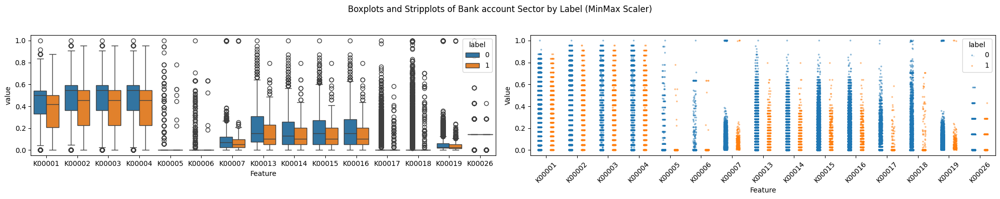

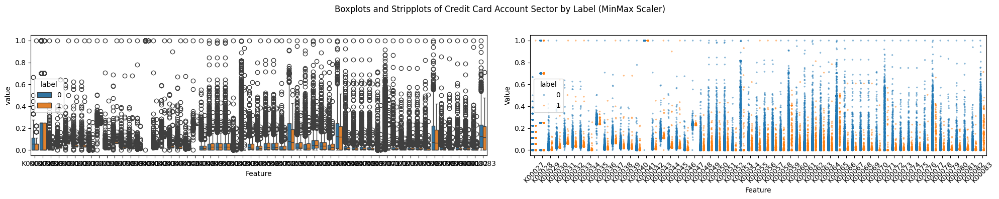

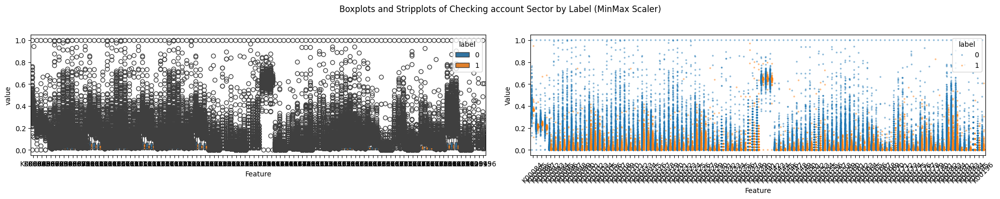

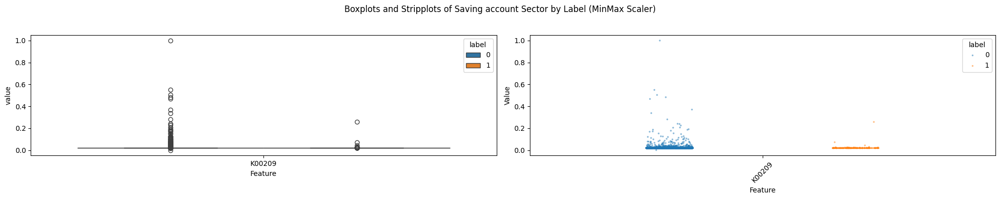

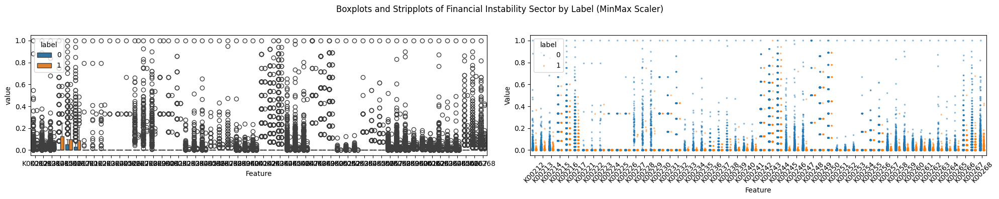

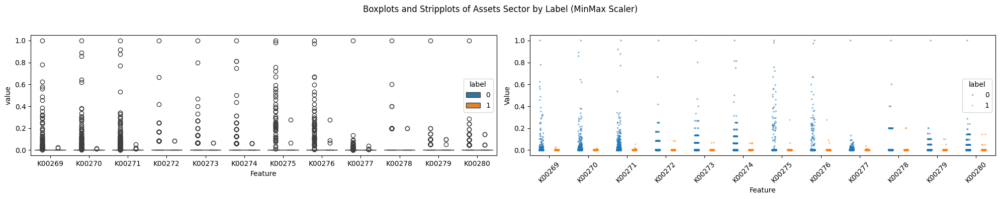

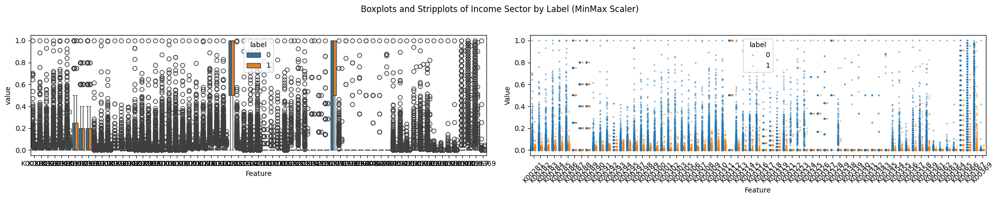

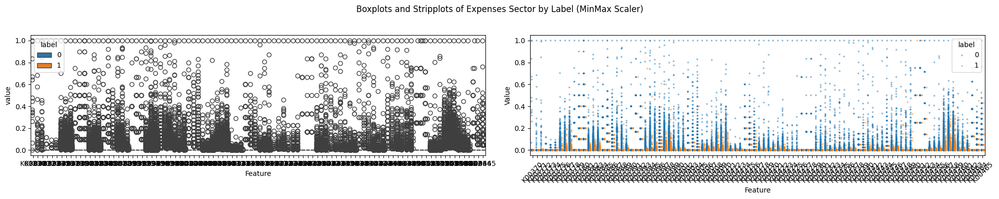

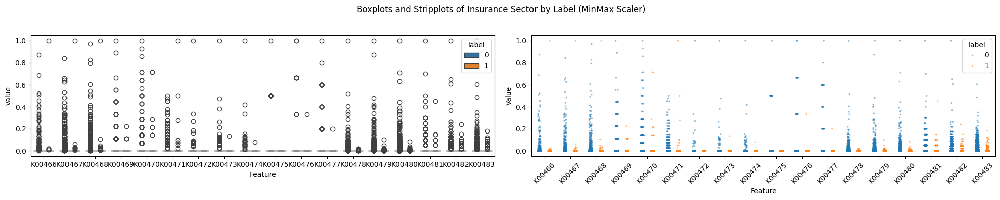

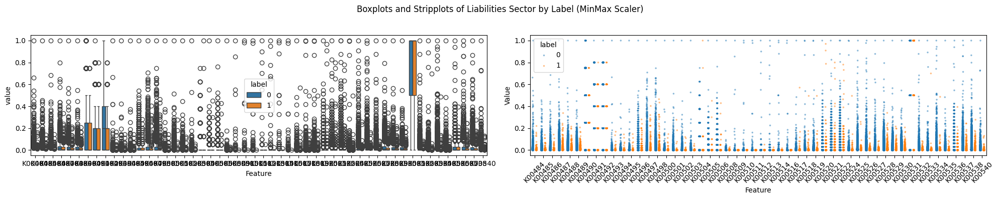

Tempo de execução: 259.9793314933777 segundos


In [95]:
# MinMaxScaler
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

# Create a list of sector names
sectors = list(sector_columns.keys())
start_timer()
# Create a boxplot and stripplot for each sector's columns
plt.figure(figsize=(12, 8))
for sector, columns in sector_columns.items():
    valid_columns = [col for col in columns if col in df.columns]
    if valid_columns:
        plt.figure(figsize=(20, 4))
        data_subset = df[['label'] + valid_columns]  # Include 'label' column and valid columns
        
        # Apply StandardScaler scaling
        scaler = MinMaxScaler()
        data_scaled = scaler.fit_transform(data_subset[valid_columns])
        data_scaled_df = pd.DataFrame(data_scaled, columns=valid_columns)
        data_scaled_df['label'] = data_subset['label']
        
        melted_data = data_scaled_df.melt(id_vars=['label'], value_vars=valid_columns, var_name='Feature')
        
        plt.subplot(1, 2, 1)
        sns.boxplot(data=melted_data, x='Feature', y='value', hue='label')
        
        plt.subplot(1, 2, 2)
        sns.stripplot(data=melted_data, x='Feature', y='value', hue='label', dodge=True, marker='.', alpha=0.5)
        
        plt.xticks(rotation=45)
        plt.xlabel('Feature')
        plt.ylabel('Value')
        plt.suptitle(f'Boxplots and Stripplots of {sector} Sector by Label (MinMax Scaler)')
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()
end_timer()

<Figure size 1200x800 with 0 Axes>

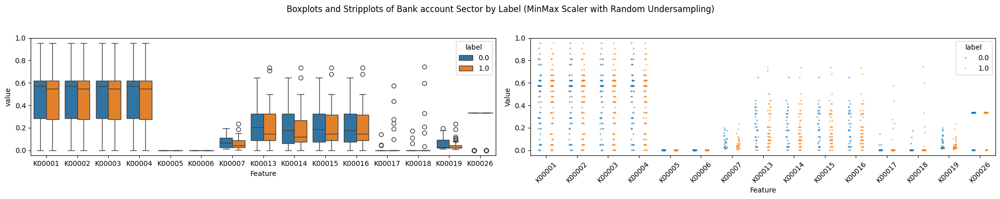

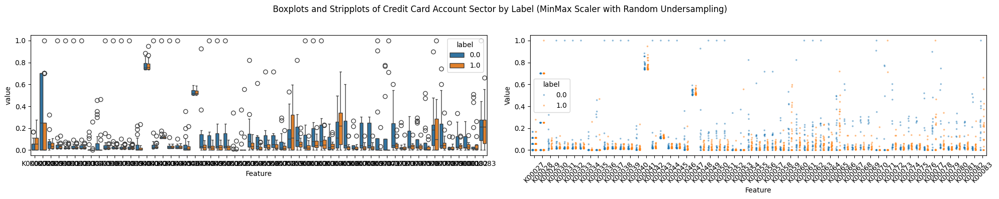

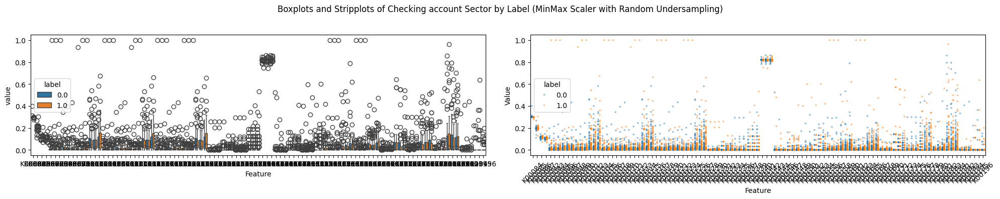

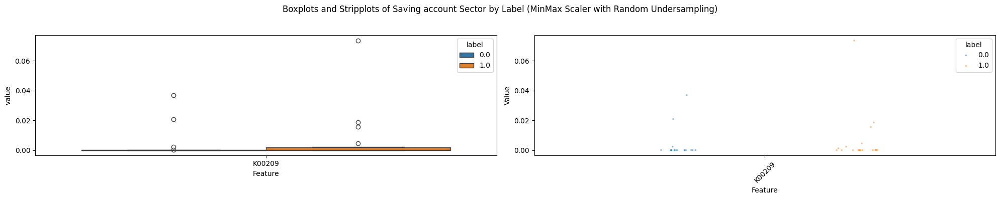

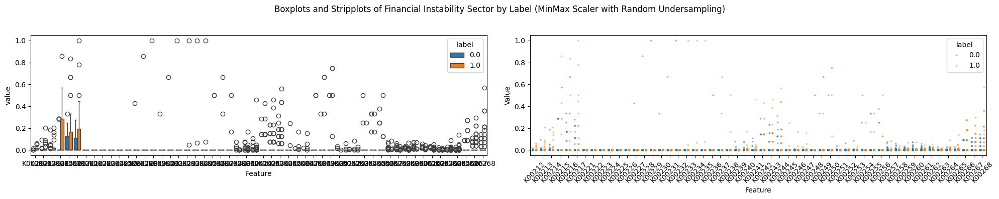

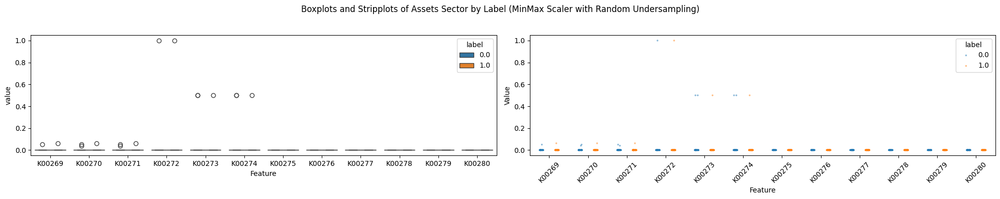

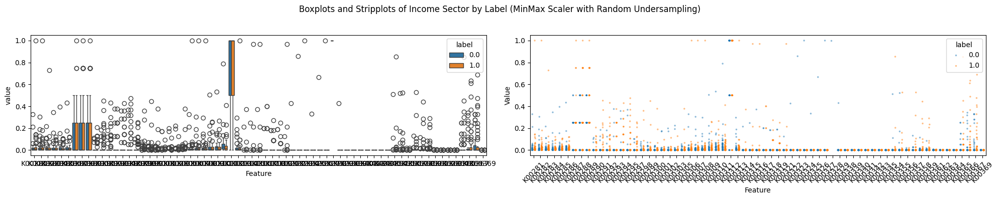

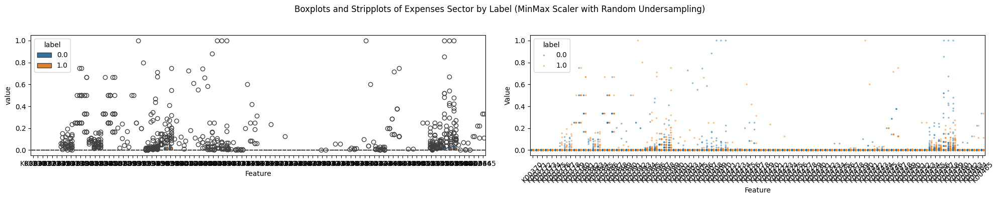

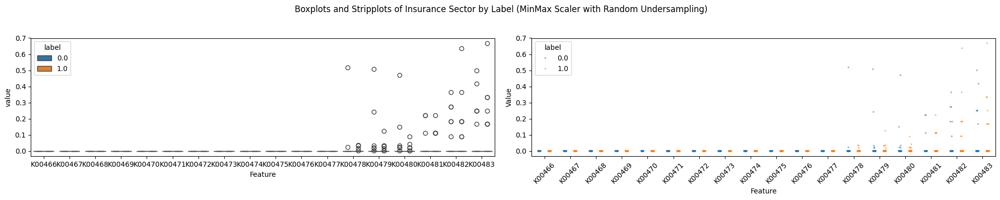

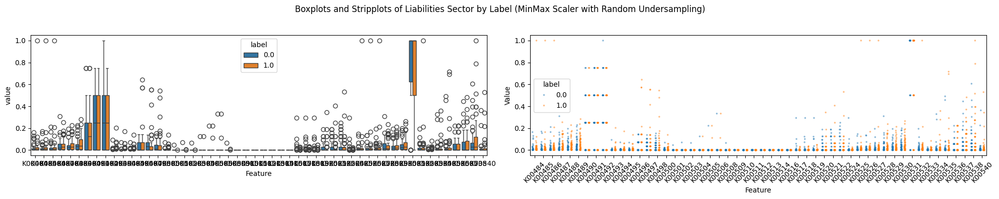

Tempo de execução: 26.05815315246582 segundos


In [96]:
# MinMaxScaler with RandomUnderSampler
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from imblearn.under_sampling import RandomUnderSampler

# Create a list of sector names
sectors = list(sector_columns.keys())

# Function to perform random undersampling
def perform_random_undersampling(X, y):
    sampler = RandomUnderSampler(sampling_strategy='majority', random_state=42)
    X_resampled, y_resampled = sampler.fit_resample(X, y)
    return X_resampled, y_resampled

start_timer()

# Create a boxplot and stripplot for each sector's columns
plt.figure(figsize=(12, 8))
for sector, columns in sector_columns.items():
    valid_columns = [col for col in columns if col in df.columns]
    if valid_columns:
        plt.figure(figsize=(20, 4))
        data_subset = df[['label'] + valid_columns]  # Include 'label' column and valid columns

        # Perform random undersampling
        X_resampled, y_resampled = perform_random_undersampling(data_subset.drop('label', axis=1), data_subset['label'])
        
        # Combine the resampled features and labels
        data_subset_resampled = pd.DataFrame(X_resampled, columns=data_subset.drop('label', axis=1).columns)
        data_subset_resampled['label'] = y_resampled

        # Apply MinMaxScaler scaling
        scaler = MinMaxScaler()
        data_scaled = scaler.fit_transform(data_subset_resampled[valid_columns])
        data_scaled_df = pd.DataFrame(data_scaled, columns=valid_columns)
        data_scaled_df['label'] = data_subset_resampled['label']

        melted_data = data_scaled_df.melt(id_vars=['label'], value_vars=valid_columns, var_name='Feature')

        plt.subplot(1, 2, 1)
        sns.boxplot(data=melted_data, x='Feature', y='value', hue='label')

        plt.subplot(1, 2, 2)
        sns.stripplot(data=melted_data, x='Feature', y='value', hue='label', dodge=True, marker='.', alpha=0.5)

        plt.xticks(rotation=45)
        plt.xlabel('Feature')
        plt.ylabel('Value')
        plt.suptitle(f'Boxplots and Stripplots of {sector} Sector by Label (MinMax Scaler with Random Undersampling)')
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()

end_timer()


<Figure size 1200x800 with 0 Axes>

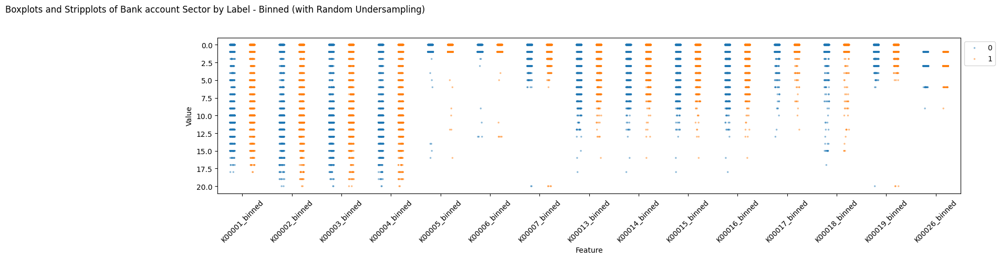

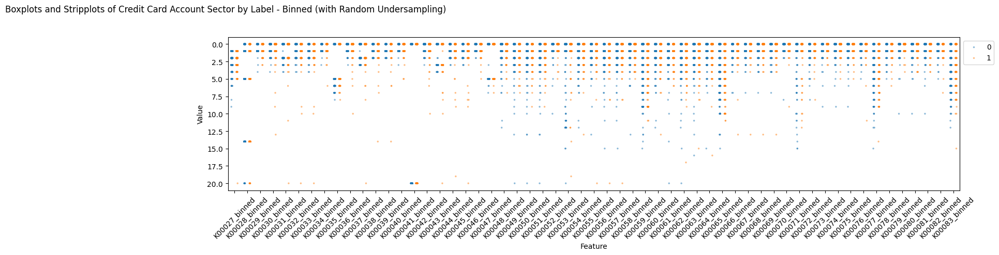

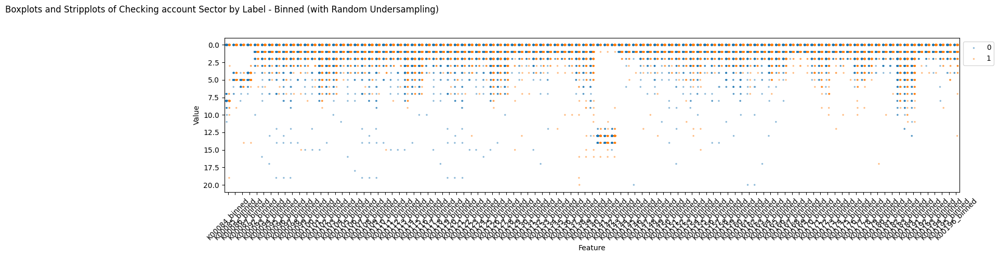

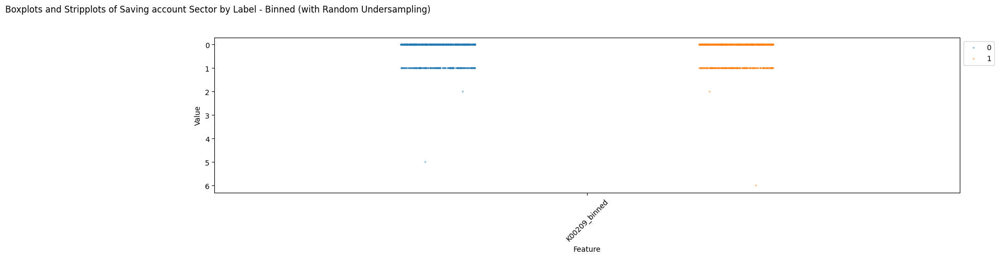

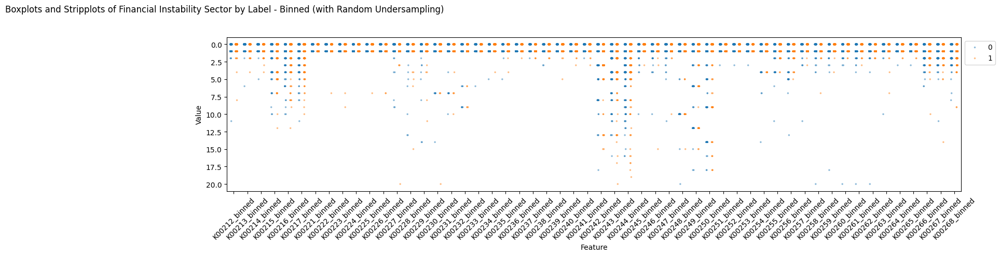

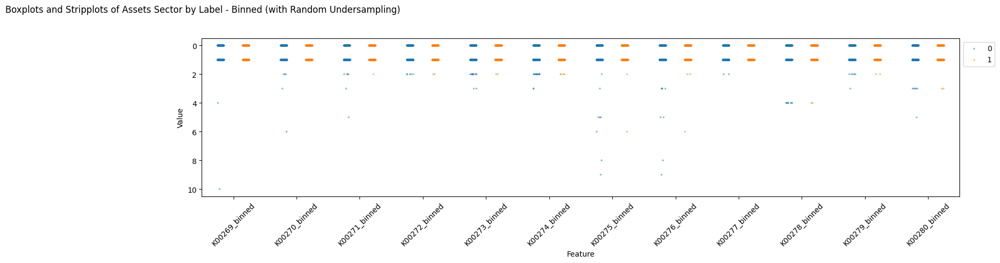

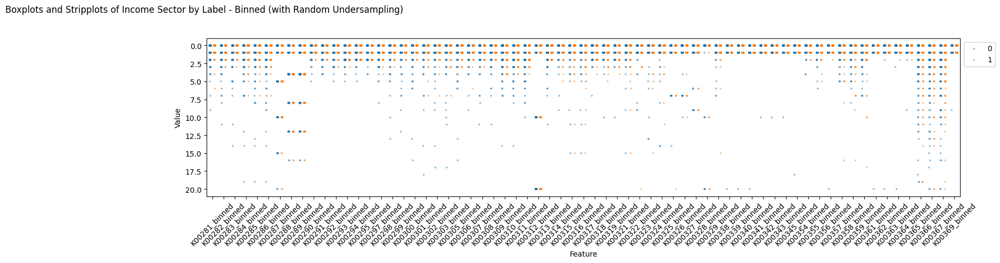

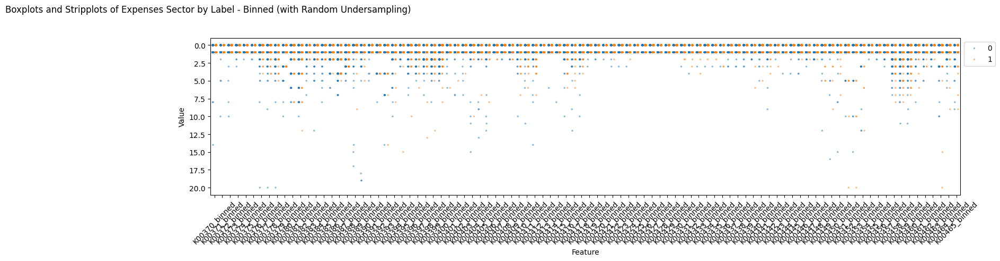

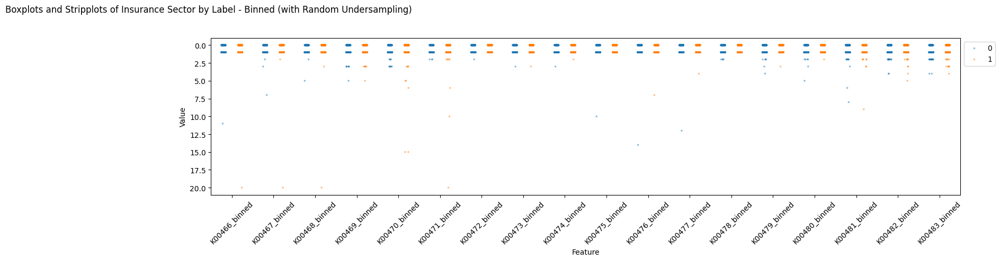

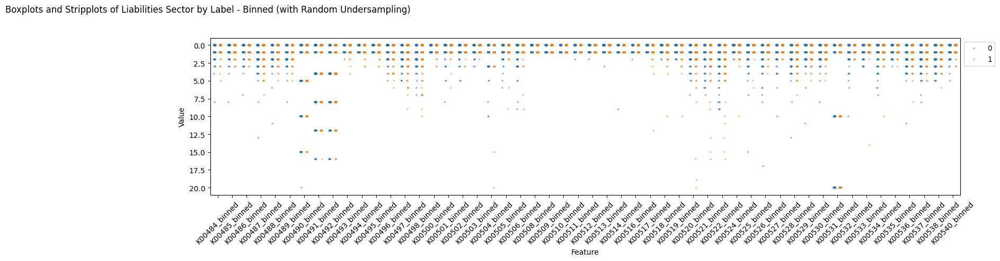

Original Dataset: label
0    17983
1     1000
Name: count, dtype: int64 
 Resampled Dataset: label
0    1000
1    1000
Name: count, dtype: int64
Tempo de execução: 13.493772506713867 segundos


In [97]:
# Data binner with RandomUnderSample of classes
from imblearn.under_sampling import RandomUnderSampler

# Function to perform random undersampling
def perform_random_undersampling(X, y):
    sampler = RandomUnderSampler(sampling_strategy='majority', random_state=42)
    X_resampled, y_resampled = sampler.fit_resample(X, y)
    return X_resampled, y_resampled

start_timer()

# Create a list of sector names
sectors_binned = list(sector_columns_binned.keys())

# Create a boxplot and stripplot for each sector's columns
plt.figure(figsize=(12, 8))
for sector, columns in sector_columns_binned.items():
    valid_columns_binned = [col for col in columns if col in df_bins.columns]
    if valid_columns_binned:
        plt.figure(figsize=(30, 5))
        data_subset = df_bins[valid_columns_binned].copy()  # Include 'label' column and valid columns
        
        data_subset['label'] = df['label'].copy()

        # Perform random undersampling
        X_resampled, y_resampled = perform_random_undersampling(data_subset.drop('label', axis=1), data_subset['label'])

        # Combine the resampled features and labels
        data_subset_resampled = pd.DataFrame(X_resampled, columns=data_subset.drop('label', axis=1).columns)
        data_subset_resampled['label'] = y_resampled

        melted_data = data_subset_resampled.melt(id_vars=['label'], value_vars=valid_columns_binned, var_name='Feature')
        
        plt.subplot(1, 2, 2)
        sns.stripplot(data=melted_data, x='Feature', y='value', hue='label', dodge=True, marker='.', alpha=0.5)
        
        plt.xticks(rotation=45)
        plt.xlabel('Feature')
        plt.ylabel('Value')
        plt.suptitle(f'Boxplots and Stripplots of {sector} Sector by Label - Binned (with Random Undersampling)')

        # Set legend location explicitly and make legend box transparent
        legend = plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
        legend.get_frame().set_facecolor('none')

        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.show()

print("Original Dataset:", df_bins['label'].value_counts(), "\n", "Resampled Dataset:", y_resampled.value_counts())

end_timer()

## 8.	Seleção de Variáveis

In [102]:
df_droped_001 = pd.read_csv(f'{files_directory}/df_droped_001.csv')
df_droped_001

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00013,...,K00534,K00535,K00536,K00537,K00538,K00540,count_of_nan,count_of_nan_zero,count_of_zero,label
0,0,0,14.0,14.0,14.0,14.0,0.0,0.0,NaN,0.0,...,0.0,0.0,NaN,0.0,0.0,0.0,129,453,324,0
1,1,1,19.0,19.0,19.0,19.0,0.0,0.0,41.0,14.0,...,0.0,0.0,0.0,0.0,0.0,0.0,25,375,350,0
2,2,0,13.0,13.0,13.0,13.0,0.0,0.0,NaN,5.0,...,0.0,20.0,0.0,0.0,1.0,20.0,91,426,335,0
3,3,2,21.0,21.0,21.0,21.0,0.0,0.0,310.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,180,472,292,0
4,4,3,1.0,1.0,1.0,1.0,0.0,0.0,257.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,95,382,287,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,18978,2,13.0,13.0,13.0,13.0,0.0,0.0,95.0,14.0,...,0.0,0.0,0.0,0.0,0.0,0.0,106,368,262,0
18979,18979,0,8.0,8.0,8.0,8.0,0.0,0.0,NaN,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,500,526,26,0
18980,18980,2,16.0,16.0,16.0,16.0,0.0,0.0,217.0,7.0,...,1090.0,1155.0,1.0,6.0,10.0,385.0,21,291,270,0
18981,18981,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,500,530,30,0


Pearson: Initially was 481 features, if drop features by correlation, remanin 200 features
Pearson: Columns to drop by : {'K00184', 'K00321', 'K00328', 'K00456', 'K00452', 'K00154', 'K00300', 'K00276', 'K00075', 'K00472', 'K00339', 'K00247', 'K00283', 'K00526', 'K00159', 'K00127', 'K00338', 'K00540', 'K00495', 'K00106', 'K00306', 'K00221', 'K00490', 'K00342', 'K00384', 'K00483', 'K00447', 'K00363', 'K00310', 'K00479', 'K00451', 'K00432', 'K00441', 'K00051', 'K00068', 'K00329', 'K00044', 'K00105', 'K00371', 'K00224', 'K00516', 'K00414', 'K00175', 'K00115', 'K00534', 'K00307', 'K00160', 'K00222', 'K00177', 'K00303', 'K00166', 'K00484', 'K00038', 'K00517', 'K00512', 'K00477', 'K00359', 'K00250', 'K00060', 'K00248', 'K00289', 'K00324', 'K00458', 'K00165', 'K00514', 'K00311', 'K00413', 'K00004', 'K00326', 'K00078', 'K00529', 'K00100', 'K00080', 'K00119', 'K00494', 'K00062', 'K00435', 'K00505', 'K00538', 'K00510', 'K00345', 'K00509', 'K00511', 'K00327', 'K00032', 'K00428', 'K00475', 'K00528'

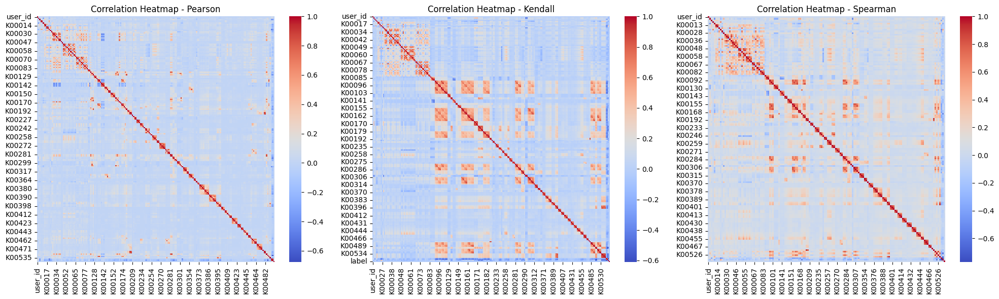

Tempo de execução: 511.1961245536804 segundos


In [104]:
# Correlation Methods Comparison
start_timer()
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Adjust the threshold value as needed
threshold = 0.9

# Define a function to drop highly correlated features based on threshold and NaN values
def drop_highly_correlated_columns(df, threshold=threshold):
    dropped_features_by_method = {method: [] for method in ['pearson', 'kendall', 'spearman']}
    selected_columns_by_method = {method: [] for method in ['pearson', 'kendall', 'spearman']}

    for method in ['pearson', 'kendall', 'spearman']:
        corr_matrix = df.corr(method=method)
        columns = np.full((corr_matrix.shape[0],), True, dtype=bool)
        features_to_drop = []

        for i in range(corr_matrix.shape[0]):
            for j in range(i + 1, corr_matrix.shape[0]):
                if abs(corr_matrix.iloc[i, j]) >= threshold or np.isnan(corr_matrix.iloc[i, j]):
                    if columns[j]:
                        columns[j] = False
                        features_to_drop.append(df.columns[j])

        selected_columns = df.columns[columns]
        selected_columns_by_method[method] = selected_columns
        dropped_features_by_method[method] = features_to_drop

        print(f'{method.capitalize()}:', 'Initially was {} features, if drop features by correlation, remanin {} features'.format(df.shape[1], len(selected_columns)))
        print(f'{method.capitalize()}:', 'Columns to drop by : {}'.format(set(df.columns) - set(selected_columns)), '\n')


    return selected_columns_by_method, dropped_features_by_method

# Drop highly correlated columns
selected_columns_by_method, dropped_features_by_method = drop_highly_correlated_columns(df_droped_001.iloc[:, :])

#print(f'{method}:', 'Initially was {} features, now is {} features'.format(df_droped_001.shape[1], len(selected_columns_by_method['pearson'])))
#print(f'{method}:'Columns to drop by : {}'.format(set(df_droped_001.columns) - set(selected_columns_by_method['pearson'])))

# Print dropped features for each method
for method, dropped_features in dropped_features_by_method.items():
    print(f'\n {len(dropped_features)} Features to drop by {method.capitalize()} correlation method, considering a threshold value of {threshold}: {dropped_features}.')

# Calculate intersection and union of dropped features
intersection = set(dropped_features_by_method['pearson'])
union = set(dropped_features_by_method['pearson'])
for method in ['kendall', 'spearman']:
    intersection &= set(dropped_features_by_method[method])
    union |= set(dropped_features_by_method[method])

print(f'\nIntersection features to drop: {len(intersection)}: {intersection}')
print(f'Union features to drop: {len(union)}: {union}')

# Calculate correlation matrices for different methods
corr_matrix = df.corr(method=method)
plt.figure(figsize=(20, 6))
for idx, method in enumerate(['pearson', 'kendall', 'spearman']):
    np.fill_diagonal(corr_matrix.values, 0)
    plt.subplot(1, 3, idx + 1)  # 1 row, 3 columns, position index
    sns.heatmap(df_droped_001[selected_columns_by_method[method]].corr(method=method),
                annot=False, cmap='coolwarm', fmt=".2f")
    plt.title(f'Correlation Heatmap - {method.capitalize()}')

plt.tight_layout()
plt.show()

end_timer()


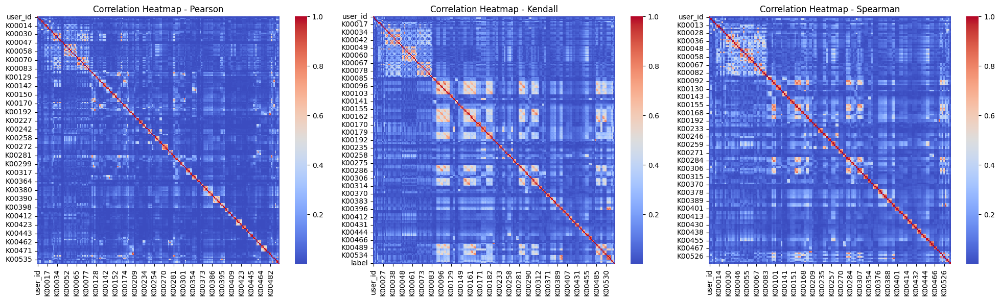

In [105]:
# Calculate correlation matrices for different methods with absolute values
plt.figure(figsize=(20, 6))
for idx, method in enumerate(['pearson', 'kendall', 'spearman']):
    np.fill_diagonal(corr_matrix.values, 0)
    plt.subplot(1, 3, idx + 1)  # 1 row, 3 columns, position index
    sns.heatmap(np.abs(df_droped_001[selected_columns_by_method[method]].corr(method=method)),
                annot=False, cmap='coolwarm', fmt=".2f")
    plt.title(f'Correlation Heatmap - {method.capitalize()}')

plt.tight_layout()
plt.show()



In [106]:
# Create a new DataFrame removing the intersection of features by correlation
df_drop = df_droped_001.loc[:, ~df_droped_001.columns.isin(intersection)]

# Display the updated DataFrame
df_drop

,user_id,bank,K00001,K00005,K00006,K00007,K00013,K00014,K00017,K00018,...,K00529,K00530,K00534,K00535,K00537,K00538,count_of_nan,count_of_nan_zero,count_of_zero,label
0,0,0,14.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,...,1.0,1.0,0.0,0.0,0.0,0.0,129,453,324,0
1,1,1,19.0,0.0,0.0,41.0,14.0,14.0,0.0,0.0,...,50.0,123.0,0.0,0.0,0.0,0.0,25,375,350,0
2,2,0,13.0,0.0,0.0,NaN,5.0,5.0,0.0,0.0,...,13.0,23.0,0.0,20.0,0.0,1.0,91,426,335,0
3,3,2,21.0,0.0,0.0,310.0,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,180,472,292,0
4,4,3,1.0,0.0,0.0,257.0,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,95,382,287,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,18978,2,13.0,0.0,0.0,95.0,14.0,14.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,106,368,262,0
18979,18979,0,8.0,0.0,0.0,NaN,5.0,5.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,500,526,26,0
18980,18980,2,16.0,0.0,0.0,217.0,7.0,7.0,0.0,0.0,...,17.0,27.0,1090.0,1155.0,6.0,10.0,21,291,270,0
18981,18981,0,0.0,0.0,0.0,NaN,2.0,2.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,500,530,30,0


Dropped constant feature labels: []
Total of 130 significant features with p-Value < 0.05: ['count_of_nan', 'count_of_nan_zero', 'K00312', 'count_of_zero', 'K00287', 'K00491', 'K00288', 'K00492', 'K00289', 'K00102', 'K00103', 'K00101', 'K00488', 'K00489', 'K00160', 'K00159', 'K00165', 'K00166', 'K00183', 'K00311', 'K00310', 'K00282', 'K00164', 'K00158', 'K00530', 'K00184', 'K00529', 'K00182', 'K00283', 'K00027', 'K00309', 'K00013', 'K00097', 'K00096', 'K00001', 'K00014', 'K00281', 'K00307', 'K00095', 'K00157', 'K00156', 'K00308', 'K00526', 'K00286', 'K00059', 'K00180', 'K00099', 'K00083', 'K00285', 'K00093', 'K00094', 'K00537', 'K00527', 'K00100', 'K00398', 'K00162', 'K00181', 'K00538', 'K00306', 'K00065', 'K00163', 'K00284', 'K00179', 'K00161', 'K00098', 'K00155', 'K00485', 'K00077', 'K00397', 'K00486', 'K00092', 'K00074', 'K00072', 'K00080', 'K00053', 'K00028', 'K00081', 'K00385', 'K00067', 'K00078', 'K00066', 'K00048', 'K00049', 'K00061', 'K00062', 'K00131', 'K00386', 'K00380', 'K00

,Feature,F-Score,p-Value
287,count_of_nan,164.506769,0.000000
288,count_of_nan_zero,158.560306,0.000000
183,K00312,153.797590,0.000000
289,count_of_zero,135.795018,0.000000
169,K00287,94.272894,0.000000
276,K00491,92.833814,0.000000
170,K00288,89.596179,0.000000
277,K00492,85.854319,0.000000
171,K00289,74.787517,0.000000
71,K00102,53.172934,0.000000


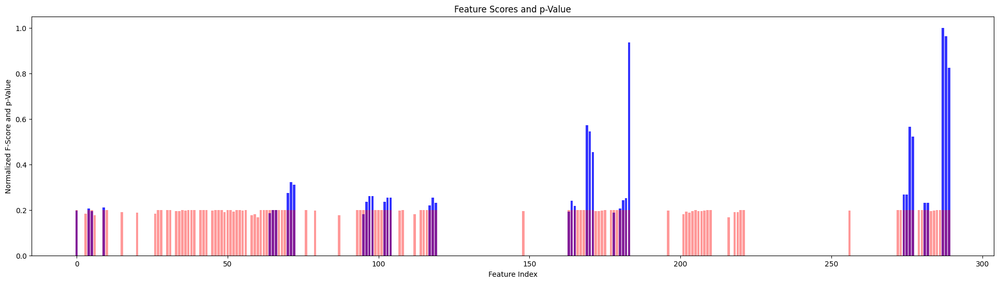

Variaveis em vermelho são significativas com p-value < 0.05 e azul são as variaveis com maior F-Score 
Variaveis com ambas as cores devem ser selecionadas
Features with color red are significant with p-value < 0.05 and blue are the top features with highest F-Score 
Features with both colors should be selected
Tempo de execução: 1.1061046123504639 segundos


In [107]:
###   ANOVA F-Test Feature Selection   ###
start_timer()
from pandas import read_csv
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
from matplotlib import pyplot
import pandas as pd
import numpy as np

X = df_drop.drop(['user_id', 'bank','label'], axis=1).fillna(0)
y = df_drop['label']

# Feature Selection
def select_features(X_train, y_train, X_test):
    # configure to select all features
    fs = SelectKBest(score_func=f_classif, k='all')
    # learn relationship from training data
    fs.fit(X_train, y_train)
    # transform train input data
    X_train_fs = fs.transform(X_train)
    # transform test input data
    X_test_fs = fs.transform(X_test)
    return X_train_fs, X_test_fs, fs

# Split data 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# List of feature indices to drop
#features_to_drop = [28, 32, 34, 55]

# Calculate the variance of each feature
variances = X_train.var()

# Find the indices of constant features (variance = 0)
constant_feature_indices = [idx for idx, var in enumerate(variances) if var == 0]

# Convert indices to column labels
constant_feature_labels = X_train.columns[constant_feature_indices]

# Drop the constant features from X_train and X_test
X_train = X_train.drop(columns=constant_feature_labels)
X_test = X_test.drop(columns=constant_feature_labels)

# Print the dropped feature labels
print("Dropped constant feature labels:", constant_feature_labels.tolist())

# feature selection
X_train_fs, X_test_fs, fs = select_features(X_train, y_train, X_test)
# what are scores for the features

sorted_fscore = fs.scores_.argsort()[::-1] # Sort feature indices by scores

# Create a dictionary to store F-score and p-value information
feature_info = {'Feature': [], 'F-Score': [], 'p-Value': []}

for i in range(len(fs.scores_)):
    feature_info['Feature'].append(X_test.columns[i])
    feature_info['F-Score'].append(fs.scores_[i])  # Keep numeric values for calculations
    feature_info['p-Value'].append(fs.pvalues_[i])  # Keep numeric values for calculations

# Create a DataFrame from the dictionary
feature_df = pd.DataFrame(feature_info)
# Sort the DataFrame by F-Score and p-value
feature_df.sort_values(by=['F-Score'], ascending=False, inplace=True)

# Filter the DataFrame to select rows where p-Value is less than 0.05
significant_features = feature_df[feature_df['p-Value'] < 0.05]

# Store the significant feature names in a list
significant_feature_names = significant_features['Feature'].tolist()

# Print the list of significant feature names
print(f"Total of {len(significant_feature_names)} significant features with p-Value < 0.05:", significant_feature_names)

# Maximum number of features to select
max = 40

# Highlight top features and significant p-values
def highlight_features(val):
    color = 'background-color: blue' if val in feature_df.head(max)['F-Score'].tolist() else ''
    return color

def highlight_p_values(val):
    color = 'background-color: blue' if val < 0.01 else ''
    return color

styled_feature_df = (
    feature_df[0:max].style
    .applymap(highlight_features, subset=['F-Score'])
    .applymap(highlight_p_values, subset=['p-Value'])
)

# Display the styled DataFrame
display(styled_feature_df)

plt.figure(figsize=(24, 6))

# Plot: Choose colors based on the highest 10 F-Score and lowest p-values
colorsf = ['blue' if i in sorted_fscore[:max] else 'white' for i in range(len(fs.scores_))]
pyplot.bar([i for i in range(len(fs.scores_))], fs.scores_/fs.scores_.max() , color=colorsf, alpha=0.8)

p_threshold = 0.05  # Set the p-value threshold

colorsp = ['red' if p < p_threshold else 'white' for p in fs.pvalues_]
pyplot.bar([i for i in range(len(fs.pvalues_))], p_threshold/(fs.pvalues_+0.25),color=colorsp, alpha=0.4)

pyplot.xlabel('Feature Index')
pyplot.ylabel('Normalized F-Score and p-Value')
pyplot.title('Feature Scores and p-Value')
pyplot.show()

print('Variaveis em vermelho são significativas com p-value < 0.05 e azul são as variaveis com maior F-Score','\nVariaveis com ambas as cores devem ser selecionadas')
print('Features with color red are significant with p-value < 0.05 and blue are the top features with highest F-Score','\nFeatures with both colors should be selected')
end_timer()

In [108]:
# Cria o dataframe com as variaveis selecionadas por ANOVA
df_drop_anova = df_drop.loc[:, df_drop.columns.isin(significant_feature_names)]
df_drop_anova

,K00001,K00007,K00013,K00014,K00017,K00027,K00028,K00035,K00041,K00047,...,K00527,K00529,K00530,K00534,K00535,K00537,K00538,count_of_nan,count_of_nan_zero,count_of_zero
0,14.0,NaN,0.0,0.0,0.0,2,0.0,NaN,NaN,NaN,...,3000.000000,1.0,1.0,0.0,0.0,0.0,0.0,129,453,324
1,19.0,41.0,14.0,14.0,0.0,1,7000.0,0.0,0.00,0.24,...,8892.599609,50.0,123.0,0.0,0.0,0.0,0.0,25,375,350
2,13.0,NaN,5.0,5.0,0.0,2,0.0,NaN,NaN,NaN,...,3842.199951,13.0,23.0,0.0,20.0,0.0,1.0,91,426,335
3,21.0,310.0,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,180,472,292
4,1.0,257.0,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,95,382,287
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,13.0,95.0,14.0,14.0,0.0,1,7000.0,0.0,0.09,0.18,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,106,368,262
18979,8.0,NaN,5.0,5.0,0.0,2,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,500,526,26
18980,16.0,217.0,7.0,7.0,0.0,1,NaN,0.0,0.40,0.45,...,9598.500000,17.0,27.0,1090.0,1155.0,6.0,10.0,21,291,270
18981,0.0,NaN,2.0,2.0,0.0,2,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,500,530,30


DataFrame of Feature Mutual Information Scores:


,0,1,2,3,4,5,6,7,8,9,...,280,281,282,283,284,285,286,287,288,289
Feature,K00001,K00005,K00006,K00007,K00013,K00014,K00017,K00018,K00026,K00027,...,K00527,K00529,K00530,K00534,K00535,K00537,K00538,count_of_nan,count_of_nan_zero,count_of_zero
Mutual_Information_Score,0.300,0.000,0.000,0.000,0.400,0.000,0.100,0.100,0.100,0.000,...,0.500,0.300,0.700,0.100,0.000,0.200,0.100,0.700,0.900,0.500


List of 40 Selected Feature Names:
['K00157', 'K00312', 'count_of_nan_zero', 'K00100', 'K00099', 'K00160', 'K00093', 'K00156', 'K00180', 'K00530', 'K00306', 'K00309', 'K00094', 'count_of_nan', 'K00092', 'K00526', 'K00308', 'K00158', 'K00307', 'K00183', 'K00310', 'K00283', 'K00486', 'K00098', 'K00165', 'K00164', 'K00159', 'K00077', 'K00284', 'K00095', 'K00166', 'K00167', 'K00155', 'count_of_zero', 'K00282', 'K00037', 'K00485', 'K00311', 'K00287', 'K00527']


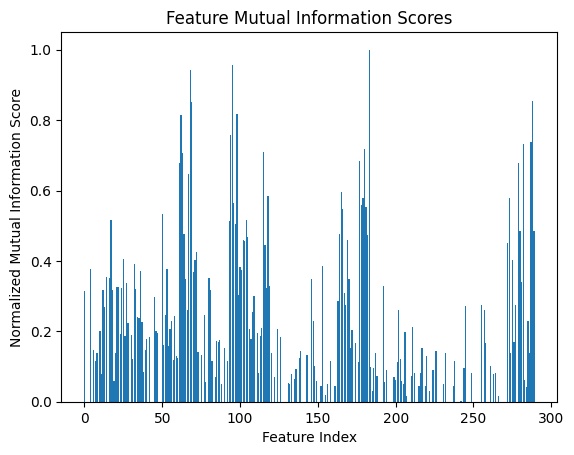

Tempo de execução: 19.445337057113647 segundos


In [110]:
###    Mutual Information feature selection for numerical input data   ###
start_timer()
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_classif
from matplotlib import pyplot

# Feature selection
def select_features(X_train, y_train, X_test):
	# Configure to select all features
	fs = SelectKBest(score_func=mutual_info_classif, k='all')
	# Learn relationship from training data
	fs.fit(X_train, y_train)
	# Transform train input data
	X_train_fs = fs.transform(X_train)
	# Transform test input data
	X_test_fs = fs.transform(X_test)
	return X_train_fs, X_test_fs, fs


# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Feature Selection
X_train_fs, X_test_fs, fs = select_features(X_train, y_train, X_test)

'''
for i in range(len(fs.scores_)):
	print(X_test.columns[i], '- Feature Mutual Information - index %d: %f' % (i, fs.scores_[i]))
# plot the scores
pyplot.bar([i for i in range(len(fs.scores_))], fs.scores_)
pyplot.show()'''

# Create a dictionary to store feature names and their scores
feature_scores_dict_mi = {'Feature': [], 'Mutual_Information_Score': []}

for i in range(len(fs.scores_)):
    feature_scores_dict_mi['Feature'].append(X_test.columns[i])
    feature_scores_dict_mi['Mutual_Information_Score'].append(round(fs.scores_[i], 3))

# Create a DataFrame from the dictionary
feature_scores_df_mi = pd.DataFrame(feature_scores_dict_mi)

# Convert Mutual Information scores column to numeric
feature_scores_df_mi['Mutual_Information_Score'] = feature_scores_df_mi['Mutual_Information_Score'].astype(float)/feature_scores_df_mi['Mutual_Information_Score'].max()

# Format Mutual Information scores column to 3 decimal places
feature_scores_df_mi['Mutual_Information_Score'] = feature_scores_df_mi['Mutual_Information_Score'].apply(lambda x: '{:.3f}'.format(x))

# Print the DataFrame
print("DataFrame of Feature Mutual Information Scores:")
display(feature_scores_df_mi.T)

# Sort the DataFrame by Mutual Information scores in descending order
sorted_feature_scores_df_mi = feature_scores_df_mi.sort_values(by='Mutual_Information_Score', ascending=False)

# Maximum number of features to select
max = 40

# Print the list of selected feature names
selected_features_mi = sorted_feature_scores_df_mi.head(max)['Feature'].tolist()
print(f"List of {len(selected_features_mi)} Selected Feature Names:")
print(selected_features_mi)

# Plot the scores
pyplot.bar([i for i in range(len(fs.scores_))], fs.scores_/fs.scores_.max())
pyplot.xlabel('Feature Index')
pyplot.ylabel('Normalized Mutual Information Score')
pyplot.title('Feature Mutual Information Scores')
pyplot.show()

end_timer()

In [ ]:
# Gerar o dataframe com as variaveis selecionadas por MI
df_drop_anova_mi = df_drop_anova.loc[:, df_drop_anova.columns.isin(selected_features_mi)]
df_drop_anova_mi

,K00092,K00093,K00094,K00099,K00100,K00155,K00156,K00157,K00158,K00159,...,K00312,K00395,K00485,K00486,K00526,K00527,K00530,count_of_nan,count_of_nan_zero,count_of_zero
0,74.199997,3074.199951,3074.199951,3083.070068,3083.070068,0.000000,3000.000000,3000.000000,0.0,1.0,...,1.0,0.000000,3000.000000,3000.000000,3000.000000,3000.000000,1.0,129,453,324
1,3825.590088,10242.940430,20437.449219,10324.440430,20714.269531,3825.340088,10201.349609,20365.519531,20.0,103.0,...,3.0,0.000000,4040.330078,8892.599609,4040.330078,8892.599609,123.0,25,375,350
2,1271.839966,2003.540039,4292.620117,2780.510010,5755.069824,1271.839966,2003.540039,4292.620117,11.0,18.0,...,3.0,0.000000,1777.000000,3862.199951,1777.000000,3842.199951,23.0,91,426,335
3,0.000000,0.000000,0.000000,21770.460938,21770.460938,0.000000,0.000000,0.000000,0.0,0.0,...,NaN,0.000000,20959.980469,20959.980469,0.000000,0.000000,0.0,180,472,292
4,8721.959961,10261.959961,10261.959961,8723.849609,8723.849609,0.010000,40.009998,40.009998,1.0,2.0,...,NaN,0.000000,378.500000,378.500000,0.000000,0.000000,0.0,95,382,287
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26819,1565.000000,1565.000000,1565.000000,4876.439941,4876.439941,1565.000000,1565.000000,1565.000000,2.0,2.0,...,NaN,115.059998,1204.420044,1204.420044,0.000000,0.000000,0.0,106,368,262
26820,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,500,526,26
26821,16270.559570,76942.039062,100723.296875,76431.796875,103675.773438,4197.600098,26182.599609,33165.699219,13.0,26.0,...,3.0,90.000000,8654.040039,13834.540039,4483.000000,9598.500000,27.0,21,291,270
26822,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,500,530,30


In [112]:
# Cria a list com as variaveis selecionadas por ANOVA e MI
# Convert the lists to sets for intersection
significant_features_set = set(significant_feature_names)
selected_features_set = set(selected_features_mi)

# Find the intersection of the two sets
intersection_features = significant_features_set.intersection(selected_features_set)

# Convert the intersection set back to a list
intersection_features_list = list(intersection_features)

# Print the list of intersection features
print("Intersection of Significant Features and Selected Features:")
print(intersection_features_list,'\n Total of Features Selected:', len(intersection_features_list))

Intersection of Significant Features and Selected Features:
['K00527', 'count_of_nan_zero', 'K00485', 'K00283', 'count_of_zero', 'K00526', 'K00159', 'K00183', 'K00306', 'K00287', 'K00099', 'count_of_nan', 'K00310', 'K00282', 'K00098', 'K00094', 'K00308', 'K00077', 'K00156', 'K00158', 'K00093', 'K00095', 'K00530', 'K00160', 'K00307', 'K00166', 'K00164', 'K00180', 'K00092', 'K00155', 'K00165', 'K00311', 'K00486', 'K00312', 'K00100', 'K00284', 'K00157', 'K00309'] 
 Total of Features Selected: 38


In [113]:
# Gerar o dataframe com as variaveis selecionadas por ANOVA e MI
df_drop_anova_mi = df_drop.loc[:, df_drop.columns.isin(intersection_features_list)]
df_drop_anova_mi

,K00077,K00092,K00093,K00094,K00095,K00098,K00099,K00100,K00155,K00156,...,K00311,K00312,K00485,K00486,K00526,K00527,K00530,count_of_nan,count_of_nan_zero,count_of_zero
0,NaN,74.199997,3074.199951,3074.199951,2.0,83.070000,3083.070068,3083.070068,0.000000,3000.000000,...,1.0,1.0,3000.000000,3000.000000,3000.000000,3000.000000,1.0,129,453,324
1,0.00,3825.590088,10242.940430,20437.449219,31.0,3807.000000,10324.440430,20714.269531,3825.340088,10201.349609,...,261.0,3.0,4040.330078,8892.599609,4040.330078,8892.599609,123.0,25,375,350
2,NaN,1271.839966,2003.540039,4292.620117,11.0,1297.760010,2780.510010,5755.069824,1271.839966,2003.540039,...,31.0,3.0,1777.000000,3862.199951,1777.000000,3842.199951,23.0,91,426,335
3,NaN,0.000000,0.000000,0.000000,0.0,21770.460938,21770.460938,21770.460938,0.000000,0.000000,...,NaN,NaN,20959.980469,20959.980469,0.000000,0.000000,0.0,180,472,292
4,NaN,8721.959961,10261.959961,10261.959961,6.0,7180.850098,8723.849609,8723.849609,0.010000,40.009998,...,0.0,NaN,378.500000,378.500000,0.000000,0.000000,0.0,95,382,287
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,0.56,1565.000000,1565.000000,1565.000000,2.0,4876.439941,4876.439941,4876.439941,1565.000000,1565.000000,...,NaN,NaN,1204.420044,1204.420044,0.000000,0.000000,0.0,106,368,262
18979,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,500,526,26
18980,0.00,16270.559570,76942.039062,100723.296875,26.0,20111.189453,76431.796875,103675.773438,4197.600098,26182.599609,...,17.0,3.0,8654.040039,13834.540039,4483.000000,9598.500000,27.0,21,291,270
18981,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,500,530,30


In [115]:
# Adiciona as coluna user_id, bank, label ao dataframe
df_drop_anova_mi_complete = df_drop_anova_mi.copy()
df_drop_anova_mi_complete['user_id'] = df_drop['user_id']
df_drop_anova_mi_complete['bank'] = df_drop['bank']
df_drop_anova_mi_complete['label'] = df_drop['label']

# Crie uma lista com a ordem desejada das colunas
new_order = ['user_id', 'bank'] + [col for col in df_drop_anova_mi_complete.columns if col not in ['user_id', 'bank']]

# Reorganize as colunas de acordo com a nova ordem
df_drop_anova_mi_complete = df_drop_anova_mi_complete[new_order]
df_drop_anova_mi_complete

,user_id,bank,K00077,K00092,K00093,K00094,K00095,K00098,K00099,K00100,...,K00312,K00485,K00486,K00526,K00527,K00530,count_of_nan,count_of_nan_zero,count_of_zero,label
0,0,0,NaN,74.199997,3074.199951,3074.199951,2.0,83.070000,3083.070068,3083.070068,...,1.0,3000.000000,3000.000000,3000.000000,3000.000000,1.0,129,453,324,0
1,1,1,0.00,3825.590088,10242.940430,20437.449219,31.0,3807.000000,10324.440430,20714.269531,...,3.0,4040.330078,8892.599609,4040.330078,8892.599609,123.0,25,375,350,0
2,2,0,NaN,1271.839966,2003.540039,4292.620117,11.0,1297.760010,2780.510010,5755.069824,...,3.0,1777.000000,3862.199951,1777.000000,3842.199951,23.0,91,426,335,0
3,3,2,NaN,0.000000,0.000000,0.000000,0.0,21770.460938,21770.460938,21770.460938,...,NaN,20959.980469,20959.980469,0.000000,0.000000,0.0,180,472,292,0
4,4,3,NaN,8721.959961,10261.959961,10261.959961,6.0,7180.850098,8723.849609,8723.849609,...,NaN,378.500000,378.500000,0.000000,0.000000,0.0,95,382,287,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,18978,2,0.56,1565.000000,1565.000000,1565.000000,2.0,4876.439941,4876.439941,4876.439941,...,NaN,1204.420044,1204.420044,0.000000,0.000000,0.0,106,368,262,0
18979,18979,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,500,526,26,0
18980,18980,2,0.00,16270.559570,76942.039062,100723.296875,26.0,20111.189453,76431.796875,103675.773438,...,3.0,8654.040039,13834.540039,4483.000000,9598.500000,27.0,21,291,270,0
18981,18981,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,500,530,30,0


In [126]:
# Atribuindo valores X e y  (df_drop_anova_mi_complete)
X = df_drop_anova_mi_complete.fillna(0)
X = pd.get_dummies(X, columns=['bank'])
X = X.drop(['user_id'], axis=1)
X = X.drop(['label'], axis=1)
# Display the resulting dataframe X
display(X, y)
y = df_drop_anova_mi_complete['label']

,K00077,K00092,K00093,K00094,K00095,K00098,K00099,K00100,K00155,K00156,...,bank_14,bank_15,bank_16,bank_17,bank_18,bank_19,bank_20,bank_21,bank_22,bank_23
0,0.00,74.199997,3074.199951,3074.199951,2.0,83.070000,3083.070068,3083.070068,0.000000,3000.000000,...,False,False,False,False,False,False,False,False,False,False
1,0.00,3825.590088,10242.940430,20437.449219,31.0,3807.000000,10324.440430,20714.269531,3825.340088,10201.349609,...,False,False,False,False,False,False,False,False,False,False
2,0.00,1271.839966,2003.540039,4292.620117,11.0,1297.760010,2780.510010,5755.069824,1271.839966,2003.540039,...,False,False,False,False,False,False,False,False,False,False
3,0.00,0.000000,0.000000,0.000000,0.0,21770.460938,21770.460938,21770.460938,0.000000,0.000000,...,False,False,False,False,False,False,False,False,False,False
4,0.00,8721.959961,10261.959961,10261.959961,6.0,7180.850098,8723.849609,8723.849609,0.010000,40.009998,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,0.56,1565.000000,1565.000000,1565.000000,2.0,4876.439941,4876.439941,4876.439941,1565.000000,1565.000000,...,False,False,False,False,False,False,False,False,False,False
18979,0.00,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,False,False,False,False,False,False,False,False,False,False
18980,0.00,16270.559570,76942.039062,100723.296875,26.0,20111.189453,76431.796875,103675.773438,4197.600098,26182.599609,...,False,False,False,False,False,False,False,False,False,False
18981,0.00,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,False,False,False,False,False,False,False,False,False,False


0        0
1        0
2        0
3        0
4        0
        ..
18978    0
18979    0
18980    0
18981    0
18982    0
Name: label, Length: 18983, dtype: int64

In [ ]:
#X = np.nan_to_num(X, nan=0)

In [127]:
###   Baseline Model com as variaveis selecionadas   ###
start_timer()
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.metrics import accuracy_score, f1_score, precision_score, roc_auc_score, balanced_accuracy_score
from xgboost import XGBClassifier
from sklearn.tree import DecisionTreeClassifier


# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)


# Fit the model
#model = DecisionTreeClassifier(random_state=42, class_weight='balanced')
#model = SGDClassifier(n_estimators=1000, learning_rate=0.05, n_jobs=16, random_state=42)
#model = XGBClassifier(n_estimators=1000, learning_rate=0.05, n_jobs=16, random_state=42, class_weight='balanced')
#model = RandomForestClassifier(n_estimators=1000 , random_state=42, n_jobs=16, max_depth=None, class_weight='balanced')
model = LogisticRegression(class_weight = 'balanced', max_iter = 20000, n_jobs = 16)
model.fit(X_train, y_train)

# Evaluate the model
yhat = model.predict(X_test)

# Performance Metrics
accuracy = accuracy_score(y_test, yhat)
f1 = f1_score(y_test, yhat)
precision = precision_score(y_test, yhat)
roc_auc = roc_auc_score(y_test, yhat)
balanced_f1 = f1_score(y_test, yhat, average='weighted')
balanced_accuracy = balanced_accuracy_score(y_test, yhat)

print('Accuracy: %.2f%%' % (accuracy * 100))
print('F1 Score: %.3f' % f1)
print('Precision: %.3f' % precision)
print('ROC AUC: %.3f' % roc_auc)
print('Balanced F1 Score: %.3f' % balanced_f1)
print('Balanced Accuracy: %.3f' % balanced_accuracy)

end_timer()

Accuracy: 56.49%
F1 Score: 0.125
Precision: 0.070
ROC AUC: 0.577
Balanced F1 Score: 0.680
Balanced Accuracy: 0.577
Tempo de execução: 13.036937713623047 segundos


In [138]:
df_cleandata = pd.read_excel(f'{files_directory}/MBA001_cleandata.xlsx', index_col=False)
df_cleandata = df_cleandata.drop(['Unnamed: 0'], axis=1)
df_cleandata

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00008,...,K00532,K00533,K00534,K00535,K00536,K00537,K00538,K00539,K00540,label
0,0,0,14.0,14.0,14.0,14.0,0.0,0.0,NaN,NaN,...,3000.000000,NaN,0.0,0.0,NaN,0.0,0.0,NaN,0.0,0
1,1,1,19.0,19.0,19.0,19.0,0.0,0.0,41.0,41.0,...,2964.199951,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0
2,2,0,13.0,13.0,13.0,13.0,0.0,0.0,NaN,NaN,...,1280.729980,0.0,0.0,20.0,0.0,0.0,1.0,1.0,20.0,0
3,3,2,21.0,21.0,21.0,21.0,0.0,0.0,310.0,310.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0
4,4,3,1.0,1.0,1.0,1.0,0.0,0.0,257.0,257.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,18978,2,13.0,13.0,13.0,13.0,0.0,0.0,95.0,95.0,...,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,NaN,0.0,0
18979,18979,0,8.0,8.0,8.0,8.0,0.0,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
18980,18980,2,16.0,16.0,16.0,16.0,0.0,0.0,217.0,217.0,...,3199.500000,20.0,1090.0,1155.0,1.0,6.0,10.0,3.0,385.0,0
18981,18981,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


In [139]:
###   Baseline Model com dataframe df_cleandata   ###
start_timer()
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.metrics import accuracy_score, f1_score, precision_score, roc_auc_score, balanced_accuracy_score
from xgboost import XGBClassifier
from sklearn.tree import DecisionTreeClassifier


# Atribuindo valores X e y
X = df_cleandata.fillna(0)
X = pd.get_dummies(X, columns=['bank'])
X = X.drop(['user_id'], axis=1)
X = X.drop(['label'], axis=1)
# Display the resulting dataframe X
display(X, y)
y = df_cleandata['label']

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)


# Fit the model
#model = DecisionTreeClassifier(random_state=42, class_weight='balanced')
#model = SGDClassifier(n_estimators=1000, learning_rate=0.05, n_jobs=16, random_state=42)
#model = XGBClassifier(n_estimators=1000, learning_rate=0.05, n_jobs=16, random_state=42, class_weight='balanced')
#model = RandomForestClassifier(n_estimators=1000 , random_state=42, n_jobs=16, max_depth=None, class_weight='balanced')
model = LogisticRegression(class_weight = 'balanced', max_iter = 20000, n_jobs = 16)
model.fit(X_train, y_train)

# Evaluate the model
yhat = model.predict(X_test)

# Performance Metrics
accuracy = accuracy_score(y_test, yhat)
f1 = f1_score(y_test, yhat)
precision = precision_score(y_test, yhat)
roc_auc = roc_auc_score(y_test, yhat)
balanced_f1 = f1_score(y_test, yhat, average='weighted')
balanced_accuracy = balanced_accuracy_score(y_test, yhat)

print('Accuracy: %.2f%%' % (accuracy * 100))
print('F1 Score: %.3f' % f1)
print('Precision: %.3f' % precision)
print('ROC AUC: %.3f' % roc_auc)
print('Balanced F1 Score: %.3f' % balanced_f1)
print('Balanced Accuracy: %.3f' % balanced_accuracy)
end_timer()

,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00008,K00009,K00010,...,bank_14,bank_15,bank_16,bank_17,bank_18,bank_19,bank_20,bank_21,bank_22,bank_23
0,14.0,14.0,14.0,14.0,0.0,0.0,0.0,0.0,0.0,0.0,...,False,False,False,False,False,False,False,False,False,False
1,19.0,19.0,19.0,19.0,0.0,0.0,41.0,41.0,41.0,41.0,...,False,False,False,False,False,False,False,False,False,False
2,13.0,13.0,13.0,13.0,0.0,0.0,0.0,0.0,0.0,0.0,...,False,False,False,False,False,False,False,False,False,False
3,21.0,21.0,21.0,21.0,0.0,0.0,310.0,310.0,310.0,310.0,...,False,False,False,False,False,False,False,False,False,False
4,1.0,1.0,1.0,1.0,0.0,0.0,257.0,257.0,257.0,257.0,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,13.0,13.0,13.0,13.0,0.0,0.0,95.0,95.0,95.0,95.0,...,False,False,False,False,False,False,False,False,False,False
18979,8.0,8.0,8.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,...,False,False,False,False,False,False,False,False,False,False
18980,16.0,16.0,16.0,16.0,0.0,0.0,217.0,217.0,217.0,217.0,...,False,False,False,False,False,False,False,False,False,False
18981,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,False,False,False,False,False,False,False,False,False,False


0        0
1        0
2        0
3        0
4        0
        ..
18978    0
18979    0
18980    0
18981    0
18982    0
Name: label, Length: 18983, dtype: int64

Accuracy: 57.99%
F1 Score: 0.141
Precision: 0.079
ROC AUC: 0.615
Balanced F1 Score: 0.691
Balanced Accuracy: 0.615
Tempo de execução: 124.26049423217773 segundos


In [140]:
# Cria função para calcular as metricas de classificação
from sklearn.metrics import confusion_matrix, precision_recall_curve, roc_curve, auc, matthews_corrcoef, cohen_kappa_score, accuracy_score, f1_score, precision_score, recall_score, balanced_accuracy_score

def calculate_classification_metrics(y_true, y_pred_prob):
    # Calculate binary predictions
    y_pred = (y_pred_prob >= 0.5).astype(int)

    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)

    # True Positives, True Negatives, False Positives, False Negatives
    TP, TN, FP, FN = cm.ravel()

    # Sensitivity (True Positive Rate)
    sensitivity = TP / (TP + FN)

    # Specificity (True Negative Rate)
    specificity = TN / (TN + FP)

    # Area Under the ROC Curve (AUC-ROC)
    fpr, tpr, _ = roc_curve(y_true, y_pred_prob)
    auc_roc = auc(fpr, tpr)

    # Area Under the Precision-Recall Curve (AUC-PRC)
    precision, recall, _ = precision_recall_curve(y_true, y_pred_prob)
    auc_prc = auc(recall, precision)

    # Gini Coefficient
    gini = 2 * auc_roc - 1

    # Kolmogorov-Smirnov (KS) statistic
    ks = np.max(tpr - fpr)

    # Matthews Correlation Coefficient (MCC)
    mcc = matthews_corrcoef(y_true, y_pred)

    # Cohen's Kappa
    kappa = cohen_kappa_score(y_true, y_pred)

    # Accuracy
    accuracy = accuracy_score(y_true, y_pred)

    # Balanced Accuracy
    balanced_accuracy = balanced_accuracy_score(y_true, y_pred)

    # F1 Score
    f1 = f1_score(y_true, y_pred)

    # Weighted F1 Score
    f1_weighted = f1_score(y_true, y_pred, average='weighted')

    # Precision
    precision = precision_score(y_true, y_pred)

    # Recall
    recall = recall_score(y_true, y_pred)

    # Create DataFrame
    metrics_df = pd.DataFrame({
        'Class': ['Combined', 'Class 0', 'Class 1'],
        'TP': [TP, cm[0, 0], cm[1, 1]],
        'TN': [TN, cm[1, 1], cm[0, 0]],
        'FP': [FP, cm[0, 1], cm[1, 0]],
        'FN': [FN, cm[1, 0], cm[0, 1]],
        'Sensitivity_TPR': [sensitivity] * 3,
        'Specificity': [specificity] * 3,
        'AUC_ROC': [auc_roc] * 3,
        'AUC_PRC': [auc_prc] * 3,
        'Gini': [gini] * 3,
        'KS': [ks] * 3,
        'MCC': [mcc] * 3,
        'Kappa': [kappa] * 3,
        'Accuracy': [accuracy] * 3,
        'Balanced_Accuracy': [balanced_accuracy] * 3,
        'F1': [f1] * 3,
        'F1_Weighted': [f1_weighted] * 3,
        'Precision': [precision] * 3,
        'Recall': [recall] * 3
    })

    return metrics_df


metrics_df_example = calculate_classification_metrics(y_test, yhat)
display(metrics_df_example)



,Class,TP,TN,FP,FN,Sensitivity_TPR,Specificity,AUC_ROC,AUC_PRC,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
0,Combined,2071,1526,69,131,0.940509,0.95674,0.615379,0.376115,0.230758,0.230758,0.103938,0.051973,0.579932,0.615379,0.141088,0.691383,0.079059,0.655
1,Class 0,2071,131,1526,69,0.940509,0.95674,0.615379,0.376115,0.230758,0.230758,0.103938,0.051973,0.579932,0.615379,0.141088,0.691383,0.079059,0.655
2,Class 1,131,2071,69,1526,0.940509,0.95674,0.615379,0.376115,0.230758,0.230758,0.103938,0.051973,0.579932,0.615379,0.141088,0.691383,0.079059,0.655


In [4]:
#  Cria função para calcular as metricas de classificação #  Only Class 1 metrics

import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, precision_recall_curve, roc_curve, auc, matthews_corrcoef, cohen_kappa_score, accuracy_score, f1_score, precision_score, recall_score, balanced_accuracy_score

def calculate_classification_metrics_one_class(y_true, y_pred_prob, target_class=1):
    # Calculate binary predictions
    y_pred = (y_pred_prob >= 0.5).astype(int)

    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)

    # True Positives, True Negatives, False Positives, False Negatives
    TP, TN, FP, FN = cm.ravel()

    # Sensitivity (True Positive Rate)
    sensitivity = TP / (TP + FN)

    # Specificity (True Negative Rate)
    specificity = TN / (TN + FP)

    # Area Under the ROC Curve (AUC-ROC)
    fpr, tpr, _ = roc_curve(y_true, y_pred_prob)
    auc_roc = auc(fpr, tpr)

    # Area Under the Precision-Recall Curve (AUC-PRC)
    precision, recall, _ = precision_recall_curve(y_true, y_pred_prob)
    auc_prc = auc(recall, precision)

    # Gini Coefficient
    gini = 2 * auc_roc - 1

    # Kolmogorov-Smirnov (KS) statistic
    ks = np.max(tpr - fpr)

    # Matthews Correlation Coefficient (MCC)
    mcc = matthews_corrcoef(y_true, y_pred)

    # Cohen's Kappa
    kappa = cohen_kappa_score(y_true, y_pred)

    # Accuracy
    accuracy = accuracy_score(y_true, y_pred)

    # Balanced Accuracy
    balanced_accuracy = balanced_accuracy_score(y_true, y_pred)

    # F1 Score
    f1 = f1_score(y_true, y_pred)

    # Weighted F1 Score
    f1_weighted = f1_score(y_true, y_pred, average='weighted')

    # Precision
    precision = precision_score(y_true, y_pred)

    # Recall
    recall = recall_score(y_true, y_pred)

    # Create DataFrame
    metrics_df = pd.DataFrame({
        'Class': [f'Class {target_class}'],
        'TP': [TP],
        'TN': [TN],
        'FP': [FP],
        'FN': [FN],
        'Sensitivity_TPR': [sensitivity],
        'Specificity': [specificity],
        'AUC_ROC': [auc_roc],
        'AUC_PRC': [auc_prc],
        'Gini': [gini],
        'KS': [ks],
        'MCC': [mcc],
        'Kappa': [kappa],
        'Accuracy': [accuracy],
        'Balanced_Accuracy': [balanced_accuracy],
        'F1': [f1],
        'F1_Weighted': [f1_weighted],
        'Precision': [precision],
        'Recall': [recall]
    })

    return metrics_df

# Exemplo de uso:
metrics_df_example = calculate_classification_metrics_one_class(y_test, yhat, target_class=1)
display(metrics_df_example)

NameError: name 'y_test' is not defined

* A seleção de variaveis inicial foi realizada com base nos valores de correlação, ANOVA e MI. Apesar das métricas serem similares para um modelo de referencia, houve um ganho no tempo de execução de quase 10 vezes, de 124 segundos para 13 segundos. O que é relevante quando se trata de um modelo de produção, com mais dados disponiveis. 

* Dados Iniciais: Accuracy: 57.99%
F1 Score: 0.141
Precision: 0.079
ROC AUC: 0.615
Balanced F1 Score: 0.691
Balanced Accuracy: 0.615
    * Tempo de execução: 124 segundos

    
* Dados com Variaveis Selecionadas: Accuracy: 56.49%,F1 Score: 0.125,Precision: 0.070, ROC AUC: 0.577, Balanced F1 Score: 0.680, Balanced Accuracy: 0.577
    * Tempo de execução: 13 segundos

Accuracy: 87.25%
F1 Score: 0.171
Precision: 0.130
ROC AUC: 0.579
Balanced F1 Score: 0.891
Balanced Accuracy: 0.579

* DT - All variable - CW
Accuracy: 86.67%
F1 Score: 0.157
Precision: 0.117
ROC AUC: 0.568
Balanced F1 Score: 0.887
Balanced Accuracy: 0.568

* DT - All variable - No CW
Accuracy: 89.70%
F1 Score: 0.097
Precision: 0.090
ROC AUC: 0.523
Balanced F1 Score: 0.901
Balanced Accuracy: 0.523

* DT - 36 - CW 
Accuracy: 83.20%
F1 Score: 0.163
Precision: 0.110
ROC AUC: 0.585
Balanced F1 Score: 0.867
Balanced Accuracy: 0.585

* DT - 36 - No CW
Accuracy: 90.44%
F1 Score: 0.076
Precision: 0.078
ROC AUC: 0.513
Balanced F1 Score: 0.904
Balanced Accuracy: 0.513

* XG - 36 - CW
Accuracy: 94.63%
F1 Score: 0.019
Precision: 0.250
ROC AUC: 0.504
Balanced F1 Score: 0.922
Balanced Accuracy: 0.504

* XG - 36 - No CW
Accuracy: 94.63%
F1 Score: 0.019
Precision: 0.250
ROC AUC: 0.504
Balanced F1 Score: 0.922
Balanced Accuracy: 0.504

* RF - All variable - CW
Accuracy: 90.81%
F1 Score: 0.134
Precision: 0.133
ROC AUC: 0.543
Balanced F1 Score: 0.908
Balanced Accuracy: 0.543

* RF - All variable - No CW
Accuracy: 94.50%
F1 Score: 0.019
Precision: 0.154
ROC AUC: 0.503
Balanced F1 Score: 0.921
Balanced Accuracy: 0.503

* XG - All variable - CW
Accuracy: 94.68%
F1 Score: 0.019
Precision: 0.333
ROC AUC: 0.504
Balanced F1 Score: 0.922
Balanced Accuracy: 0.504

* XG - All variable - No CW
Accuracy: 94.68%
F1 Score: 0.019
Precision: 0.333
ROC AUC: 0.504
Balanced F1 Score: 0.922
Balanced Accuracy: 0.504


In [157]:
df_cleandata[['count_of_nan', 'count_of_nan_zero', 'count_of_zero']] = df_droped_001[['count_of_nan', 'count_of_nan_zero', 'count_of_zero']]


In [158]:
df_cleandata

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00008,...,K00535,K00536,K00537,K00538,K00539,K00540,label,count_of_nan,count_of_nan_zero,count_of_zero
0,0,0,14.0,14.0,14.0,14.0,0.0,0.0,NaN,NaN,...,0.0,NaN,0.0,0.0,NaN,0.0,0,129,453,324
1,1,1,19.0,19.0,19.0,19.0,0.0,0.0,41.0,41.0,...,0.0,0.0,0.0,0.0,NaN,0.0,0,25,375,350
2,2,0,13.0,13.0,13.0,13.0,0.0,0.0,NaN,NaN,...,20.0,0.0,0.0,1.0,1.0,20.0,0,91,426,335
3,3,2,21.0,21.0,21.0,21.0,0.0,0.0,310.0,310.0,...,0.0,0.0,0.0,0.0,NaN,0.0,0,180,472,292
4,4,3,1.0,1.0,1.0,1.0,0.0,0.0,257.0,257.0,...,0.0,0.0,0.0,0.0,NaN,0.0,0,95,382,287
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,18978,2,13.0,13.0,13.0,13.0,0.0,0.0,95.0,95.0,...,0.0,0.0,0.0,0.0,NaN,0.0,0,106,368,262
18979,18979,0,8.0,8.0,8.0,8.0,0.0,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0,500,526,26
18980,18980,2,16.0,16.0,16.0,16.0,0.0,0.0,217.0,217.0,...,1155.0,1.0,6.0,10.0,3.0,385.0,0,21,291,270
18981,18981,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0,500,530,30


In [195]:
print(df_IV_001.loc[df_IV_001['Feature'] != 'label'])

               Feature        IV
102             K00117  0.293708
267             K00307  0.285362
101             K00116  0.265698
476       count_of_nan  0.264868
141             K00156  0.262254
244             K00282  0.259555
103             K00118  0.257652
140             K00155  0.245358
142             K00157  0.244759
90              K00105  0.239790
78              K00093  0.237117
273             K00313  0.236045
243             K00281  0.235114
165             K00180  0.233894
245             K00283  0.233654
268             K00308  0.231528
89              K00104  0.230779
79              K00094  0.230759
77              K00092  0.230129
107             K00122  0.228140
108             K00123  0.226998
85              K00100  0.226909
91              K00106  0.224047
477  count_of_nan_zero  0.223807
166             K00181  0.221063
266             K00306  0.219670
109             K00124  0.218431
84              K00099  0.217680
95              K00110  0.217470
83        

In [199]:
### Bi-directional Elimination
# Add features in order of df_IV_001 values, drop features according to p-values and confidence intervals
import statsmodels.api as sm
import pandas as pd
from sklearn.preprocessing import StandardScaler
import numpy as np
import logging

start_timer()
# Copy the dataset and fill NaN values with 0
data = df_cleandata.copy()
data = data.fillna(0)

# Separate features (X) and target (y)
X = data.drop("label", axis=1)
y = data["label"]

# Create an empty list to store selected features
selected_features = []

# Define o nível de log para ERROR para o módulo statsmodels
logging.getLogger('statsmodels').setLevel(logging.ERROR)

# Create a function to fit the model and check p-values
def fit_and_check_model(X_selected, y):
    scaler = StandardScaler()
    X_selected_scaled = scaler.fit_transform(X_selected)
    X_selected_scaled = sm.add_constant(X_selected_scaled)
    
    model = sm.Logit(y, X_selected_scaled)
    result = model.fit_regularized(alpha=0.6, trim_mode='size', method='l1', max_iter=100000000, disp=False, qc_tol=1e-0)

    return result

# Create a function to check if zero is in [0.025, 0.975] interval

def check_zero_interval(arr):
    quantiles = np.quantile(arr, [0.025, 0.975])
    if quantiles[0] <= 0 <= quantiles[1]:
        if quantiles[0] >= 0 >= quantiles[1]:
            return True
        return False

features = df_IV_001.loc[df_IV_001['Feature'] != 'label']

# Iterate through features in the order of df_IV_001
for feature in features['Feature']:
    # Add the current feature to the selected features list
    selected_features.append(feature)
    
    # Subset X with selected features
    X_selected = X[selected_features]
    
    # Fit and check the model
    result = fit_and_check_model(X_selected, y)
    
    # Check if the optimization converged
    if result.mle_retvals['converged']:
        # Check p-values of existing features and drop if p-value > 0.1
        features_dropped = True
        while features_dropped:
            features_dropped = False
            for idx, pvalue in enumerate(result.pvalues[1:]):  # Exclude the constant term
                if pvalue > 0.1:
                    print(f"Dropping feature due to high p-value: {selected_features[idx]} - p-value: {pvalue}")
                    selected_features.pop(idx)
                    X_selected = X[selected_features]
                    result = fit_and_check_model(X_selected, y)
                    features_dropped = True
                    break
        
        # Check if the new feature's p-value is above 0.05
        if result.pvalues[-1] > 0.05:
            print(f"Dropping newly added feature due to high p-value: {feature} - p-value: {result.pvalues[-1]}")
            selected_features.pop()  # Remove the last added feature
        else:
            # Check if zero is in [0.025, 0.975] interval
            if check_zero_interval(X_selected.iloc[:, -1]):
                print(f"Dropping newly added feature due to zero in interval: {feature}")
                selected_features.pop()  # Remove the last added feature
            else:
                print(result.aic, f"Features added: {selected_features}")
                #print(result.summary())
    else:
        print(f"Features added: {selected_features}")
        print("Model did not converge\n")

# Print the final selected features
print(result.summary())
print("Final selected features:", selected_features)
end_timer()

7677.989321143859 Features added: ['K00117']
7675.682248594794 Features added: ['K00117', 'K00307']
Dropping feature due to high p-value: K00307 - p-value: 0.11323884060670035
7672.796914255221 Features added: ['K00117', 'K00116']
7606.494237142275 Features added: ['K00117', 'K00116', 'count_of_nan']
Dropping feature due to high p-value: K00156 - p-value: 0.7491528054115237
7606.494237142275 Features added: ['K00117', 'K00116', 'count_of_nan']
Dropping feature due to high p-value: K00116 - p-value: 0.11537002762492007
Dropping feature due to high p-value: K00117 - p-value: 0.16084321382181288
7606.8083448375355 Features added: ['count_of_nan', 'K00282']
Dropping feature due to high p-value: K00118 - p-value: 0.21474921412838321
7606.8083448375355 Features added: ['count_of_nan', 'K00282']
Dropping feature due to high p-value: K00155 - p-value: 0.8625678099116458
7606.8083448375355 Features added: ['count_of_nan', 'K00282']
Dropping feature due to high p-value: K00157 - p-value: 0.57891

In [201]:
# Run a logisticregression model with the selected features
start_timer()
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, precision_score, roc_auc_score, balanced_accuracy_score

# Separate features (X) and target (y)
X = data[selected_features]
y = data["label"]

# RandomUnderSampler    
#from imblearn.under_sampling import RandomUnderSampler
#sampler = RandomUnderSampler(sampling_strategy='majority', random_state=42)

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Resample
#X_train, y_train = sampler.fit_resample(X_train, y_train)

model = LogisticRegression(class_weight = 'balanced', max_iter = 20000, n_jobs = 16)
model.fit(X_train, y_train)

# Evaluate the model
yhat = model.predict(X_test)

# Performance Metrics
tpr = recall_score(y_test, yhat)
fpr = 1 - tpr
accuracy = accuracy_score(y_test, yhat)
f1 = f1_score(y_test, yhat)
precision = precision_score(y_test, yhat)
roc_auc = roc_auc_score(y_test, yhat)
balanced_f1 = f1_score(y_test, yhat, average='weighted')
balanced_accuracy = balanced_accuracy_score(y_test, yhat)
ks = np.max(tpr - fpr)

print('Accuracy: %.2f%%' % (accuracy * 100))
print('F1 Score: %.3f' % f1)
print('Precision: %.3f' % precision)
print('ROC AUC: %.3f' % roc_auc)
print('Balanced F1 Score: %.3f' % balanced_f1)
print('Balanced Accuracy: %.3f' % balanced_accuracy)
print('KS: %.3f' % ks)
end_timer()


Accuracy: 55.07%
F1 Score: 0.139
Precision: 0.077
ROC AUC: 0.616
Balanced F1 Score: 0.667
Balanced Accuracy: 0.616
KS: 0.380
Tempo de execução: 7.078934907913208 segundos


Accuracy: 55.07%
F1 Score: 0.139
Precision: 0.077
ROC AUC: 0.616
Balanced F1 Score: 0.667
Balanced Accuracy: 0.616
KS: 0.380
Tempo de execução: 5.4849231243133545 segundos

In [ ]:
### Foward Feature Selection
import statsmodels.api as sm
import pandas as pd

# Copy the dataset and fill NaN values with 0
data = df_droped_001.copy()
data = data.fillna(0)

# Separate features (X) and target (y)
X = data.drop("label", axis=1)
y = data["label"]

# Create an empty list to store selected features
selected_features = []

# Iterate through features in the order of df_IV_001
for feature in df_IV_001['Feature']:
    # Add the current feature to the selected features list
    selected_features.append(feature)
    
    # Subset X with selected features
    X_selected = X[selected_features]
    
    scaler = StandardScaler()
    
    X_selected = scaler.fit_transform(X_selected)
    # Add constant column for intercept in logistic regression
    X_selected = sm.add_constant(X_selected)
    
    # Create and fit the logistic regression model
    model = sm.Logit(y, X_selected)
    result = model.fit_regularized(alpha=.5, trim_mode ='size' , method='l1', max_iter=100000000, disp=False)
    
    # Check if the optimization converged
    if result.mle_retvals['converged']:
        # Print summary of the logistic regression model
        print(result.aic,f"Features added: {selected_features}")
        print(result.summary())
    else:
        print(f"Features added: {selected_features}")
        print("Model did not converge\n")

# Print the final selected features
print("Final selected features:", selected_features)

In [2]:
# Install LightGBM Classifier
%pip install lightgbm

   ---------------------------------------- 0.0/1.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/1.3 MB ? eta -:--:--
   - -------------------------------------- 0.0/1.3 MB 495.5 kB/s eta 0:00:03
   --- ------------------------------------ 0.1/1.3 MB 939.4 kB/s eta 0:00:02
   ----- ---------------------------------- 0.2/1.3 MB 1.1 MB/s eta 0:00:02
   ------ --------------------------------- 0.2/1.3 MB 1.1 MB/s eta 0:00:01
   --------- ------------------------------ 0.3/1.3 MB 1.1 MB/s eta 0:00:01
   ---------- ----------------------------- 0.4/1.3 MB 1.2 MB/s eta 0:00:01
   ------------- -------------------------- 0.4/1.3 MB 1.3 MB/s eta 0:00:01
   --------------- ------------------------ 0.5/1.3 MB 1.3 MB/s eta 0:00:01
   ---------------- ----------------------- 0.6/1.3 MB 1.2 MB/s eta 0:00:01
   ----------------- ---------------------- 0.6/1.3 MB 1.2 MB/s eta 0:00:01
   ------------------- -------------------- 0.7/1.3 MB 1.2 MB/s eta 0:00:01
   -------------------

## 9.	Seleção de Modelo

Com o propósito em aprender (na prática), extrair o máximo de informações dos dados e aplicar o conhecimento adquirido durante o curso, optamos por avaliar diversos algoritmos para selecionar o mais adequado ao problema em questão. Essa abordagem nos possibilita escolher o modelo que melhor se adapta às características específicas do nosso conjunto de dados, visando obter resultados mais otimizados nas métricas. Abaixo estão os algoritmos que foram avaliados:

1.	Logistic Regression
2.	k-Nearest Neighbors (k-NN)
3.	Support Vector Machines (SVM)
4.	Neural Networks
5.	Naive Bayes
6.	Decision Trees
7.	Random Forest
8.	Gradient Boosting Machines (GBM)
9.	XGBoost
10.	LightGBM
11.	CatBoost
12.	HistGradientBoostingClassifier


In [3]:
df_cleandata = pd.read_excel(f'{files_directory}/MBA001_cleandata.xlsx', index_col=False)
df_cleandata = df_cleandata.drop(['Unnamed: 0'], axis=1)
df_cleandata

NameError: name 'pd' is not defined

In [5]:
df_droped_001 = pd.read_csv(f'{files_directory}/df_droped_001.csv', index_col=False)
df_droped_001

,user_id,bank,K00001,K00002,K00003,K00004,K00005,K00006,K00007,K00013,...,K00534,K00535,K00536,K00537,K00538,K00540,count_of_nan,count_of_nan_zero,count_of_zero,label
0,0,0,14.0,14.0,14.0,14.0,0.0,0.0,NaN,0.0,...,0.0,0.0,NaN,0.0,0.0,0.0,129,453,324,0
1,1,1,19.0,19.0,19.0,19.0,0.0,0.0,41.0,14.0,...,0.0,0.0,0.0,0.0,0.0,0.0,25,375,350,0
2,2,0,13.0,13.0,13.0,13.0,0.0,0.0,NaN,5.0,...,0.0,20.0,0.0,0.0,1.0,20.0,91,426,335,0
3,3,2,21.0,21.0,21.0,21.0,0.0,0.0,310.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,180,472,292,0
4,4,3,1.0,1.0,1.0,1.0,0.0,0.0,257.0,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,95,382,287,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18978,18978,2,13.0,13.0,13.0,13.0,0.0,0.0,95.0,14.0,...,0.0,0.0,0.0,0.0,0.0,0.0,106,368,262,0
18979,18979,0,8.0,8.0,8.0,8.0,0.0,0.0,NaN,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,500,526,26,0
18980,18980,2,16.0,16.0,16.0,16.0,0.0,0.0,217.0,7.0,...,1090.0,1155.0,1.0,6.0,10.0,385.0,21,291,270,0
18981,18981,0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,500,530,30,0


In [5]:
df = df_droped_001.copy()
df.columns[479]

'count_of_zero'

In [14]:
import pandas as pd
import numpy as np
from sklearn.model_selection import KFold
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTEENN, SMOTETomek
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve, auc, make_scorer
from sklearn.impute import SimpleImputer
import os

# Define the dataframe 'df', features, and target
# 'label' is the target column
features = df.columns[1:479]
target = df['label']

# Define the hyperparameters for each model
hyperparameters = {
    'Logistic Regression': {'C': [0.1, 1, 10]},
    'k-Nearest Neighbors (k-NN)': {'n_neighbors': [3, 5, 7]},
    'Support Vector Machines (SVM)': {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']},
    'Neural Networks': {'hidden_layer_sizes': [(50,), (100,), (50, 50)]},
    'Naive Bayes': {},
    'Decision Trees': {'max_depth': [None, 10, 20]},
    'Random Forest': {'n_estimators': [50, 100, 200]},
    'Gradient Boosting Machines (GBM)': {'n_estimators': [50, 100, 200]},
    'XGBoost': {'n_estimators': [50, 100, 200]},
    'LightGBM': {'n_estimators': [50, 100, 200]}
}

# Define the imbalanced data handling techniques
sampling_techniques = {
    'Oversampling': RandomOverSampler(),
    'Undersampling': RandomUnderSampler(),
    'Hybrid Sampling (SMOTEENN)': SMOTEENN(),
    'Hybrid Sampling (SMOTETomek)': SMOTETomek()
}

# Define the imputation techniques
imputation_techniques = {
    'Zero Imputation': SimpleImputer(strategy='constant', fill_value=0),
    'Mean Imputation': SimpleImputer(strategy='mean'),
    'Median Imputation': SimpleImputer(strategy='median')
}

# Define a function to calculate KS and Gini
def calculate_ks_gini(y_true, y_prob):
    fpr, tpr, thresholds = roc_curve(y_true, y_prob)
    ks = max(tpr - fpr)
    gini = 2 * auc(fpr, tpr) - 1
    return ks, gini

# Create a list to store the results
results = []

# Define k-fold cross-validation
k_fold = KFold(n_splits=5, shuffle=True, random_state=42)

# Iterate through each model
for model_name, model in [
    ('Logistic Regression', LogisticRegression()),
    ('k-Nearest Neighbors (k-NN)', KNeighborsClassifier()),
    ('Support Vector Machines (SVM)', SVC(probability=True)),
    ('Neural Networks', MLPClassifier()),
    ('Naive Bayes', GaussianNB()),
    ('Decision Trees', DecisionTreeClassifier()),
    ('Random Forest', RandomForestClassifier()),
    ('Gradient Boosting Machines (GBM)', GradientBoostingClassifier()),
    ('XGBoost', XGBClassifier()),
    ('LightGBM', LGBMClassifier())
]:
    # Iterate through each imbalanced data handling technique
    for sampling_name, sampling_technique in sampling_techniques.items():
        # Iterate through each imputation technique
        for imputation_name, imputation_technique in imputation_techniques.items():
            # Create a new dataframe to store the results for this model, technique combination
            df_result = pd.DataFrame(columns=['Algorithm', 'Metrics', 'Hyperparameters', 'Imputation Technique', 'Imbalance Class Technique', 'Model Unique Code'])
            
            # Perform k-fold cross-validation
            for fold, (train_index, test_index) in enumerate(k_fold.split(df[features], target)):
                X_train, X_test = df[features].iloc[train_index], df[features].iloc[test_index]
                y_train, y_test = target.iloc[train_index], target.iloc[test_index]
                
                # Apply imputation technique on the train and test sets
                X_train_imputed = imputation_technique.fit_transform(X_train)
                X_test_imputed = imputation_technique.transform(X_test)
                
                # Apply the imbalanced data handling technique on the train set
                X_train_resampled, y_train_resampled = sampling_technique.fit_resample(X_train_imputed, y_train)
                
                # Train the model on the resampled train set
                model.fit(X_train_resampled, y_train_resampled)
                
                # Make predictions on the test set
                y_pred = model.predict(X_test_imputed)
                y_prob = model.predict_proba(X_test_imputed)[:, 1]
                
                # Calculate the evaluation metrics
                metrics = {
                    'Accuracy': accuracy_score(y_test, y_pred),
                    'Precision': precision_score(y_test, y_pred),
                    'Recall': recall_score(y_test, y_pred),
                    'F1-score': f1_score(y_test, y_pred),
                    'AUC': roc_auc_score(y_test, y_prob)
                }
                
                # Calculate KS and Gini
                ks, gini = calculate_ks_gini(y_test, y_prob)
                metrics['KS'] = ks
                metrics['Gini'] = gini
                
                # Append the results to the dataframe
                df_result = pd.concat([df_result, pd.DataFrame({
                    'Algorithm': model_name,
                    'Metrics': metrics,
                    'Hyperparameters': model.get_params(),
                    'Imputation Technique': imputation_name,
                    'Imbalance Class Technique': sampling_name,
                    'Model Unique Code': f"{model_name}_{sampling_name}_{imputation_name}_fold_{fold}"
                 })], ignore_index=True, axis=0)
            
            # Append the results for this model, technique combination to the overall results list
            results.append(df_result)

# Combine all the results dataframes into one final dataframe
df_results_final = pd.concat(results, ignore_index=True)

# Save each model in a separate file with name corresponding to model unique code
for model_unique_code in df_results_final['Model Unique Code'].unique():
    df_model = df_results_final[df_results_final['Model Unique Code'] == model_unique_code]
    df_model.to_csv(f"{model_unique_code}.csv", index=False)

# Display the final dataframe
print(df_results_final)

[LightGBM] [Info] Number of positive: 14423, number of negative: 14423
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.027280 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 61079
[LightGBM] [Info] Number of data points in the train set: 28846, number of used features: 463
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Number of positive: 14350, number of negative: 14350
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.026250 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 61069
[LightGBM] [Info] Number of data points in the train set: 28700, number of used features: 461
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Number of positive: 14373, number of negative: 14373
[LightGBM] [Info] Auto-choosing col-wise multi-

In [18]:
display(results)

[               Algorithm   Metrics Hyperparameters Imputation Technique  \
 0    Logistic Regression  0.494864             NaN      Zero Imputation   
 1    Logistic Regression  0.086572             NaN      Zero Imputation   
 2    Logistic Regression  0.742616             NaN      Zero Imputation   
 3    Logistic Regression  0.155066             NaN      Zero Imputation   
 4    Logistic Regression  0.623146             NaN      Zero Imputation   
 5    Logistic Regression  0.230842             NaN      Zero Imputation   
 6    Logistic Regression  0.246291             NaN      Zero Imputation   
 7    Logistic Regression       NaN             1.0      Zero Imputation   
 8    Logistic Regression       NaN            None      Zero Imputation   
 9    Logistic Regression       NaN           False      Zero Imputation   
 10   Logistic Regression       NaN            True      Zero Imputation   
 11   Logistic Regression       NaN               1      Zero Imputation   
 12   Logist

In [7]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, precision_recall_curve, roc_curve, auc, matthews_corrcoef, cohen_kappa_score, accuracy_score, f1_score, precision_score, recall_score, balanced_accuracy_score

def calculate_classification_metrics_one_class(y_true, y_pred_prob, target_class=1):
    # Calculate binary predictions
    y_pred = (y_pred_prob >= 0.5).astype(int)

    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)

    # True Positives, True Negatives, False Positives, False Negatives
    TP, TN, FP, FN = cm.ravel()

    # Sensitivity (True Positive Rate)
    sensitivity = TP / (TP + FN)

    # Specificity (True Negative Rate)
    specificity = TN / (TN + FP)

    # Area Under the ROC Curve (AUC-ROC)
    fpr, tpr, _ = roc_curve(y_true, y_pred_prob)
    auc_roc = auc(fpr, tpr)

    # Area Under the Precision-Recall Curve (AUC-PRC)
    precision, recall, _ = precision_recall_curve(y_true, y_pred_prob)
    auc_prc = auc(recall, precision)

    # Gini Coefficient
    gini = 2 * auc_roc - 1

    # Kolmogorov-Smirnov (KS) statistic
    ks = np.max(tpr - fpr)

    # Matthews Correlation Coefficient (MCC)
    mcc = matthews_corrcoef(y_true, y_pred)

    # Cohen's Kappa
    kappa = cohen_kappa_score(y_true, y_pred)

    # Accuracy
    accuracy = accuracy_score(y_true, y_pred)

    # Balanced Accuracy
    balanced_accuracy = balanced_accuracy_score(y_true, y_pred)

    # F1 Score
    f1 = f1_score(y_true, y_pred)

    # Weighted F1 Score
    f1_weighted = f1_score(y_true, y_pred, average='weighted')

    # Precision
    precision = precision_score(y_true, y_pred)

    # Recall
    recall = recall_score(y_true, y_pred)

     # Create DataFrame
    metrics_df = pd.DataFrame({
        'Class': [f'Class {target_class}'],
        'TP': [TP],
        'TN': [TN],
        'FP': [FP],
        'FN': [FN],
        'Sensitivity_TPR': [sensitivity],
        'Specificity': [specificity],
        'AUC_ROC': [auc_roc],
        'AUC_PRC': [auc_prc],
        'Gini': [gini],
        'KS': [ks],
        'MCC': [mcc],
        'Kappa': [kappa],
        'Accuracy': [accuracy],
        'Balanced_Accuracy': [balanced_accuracy],
        'F1': [f1],
        'F1_Weighted': [f1_weighted],
        'Precision': [precision],
        'Recall': [recall]
    })

    # Reset index
    metrics_df = metrics_df.reset_index(drop=True)

    return metrics_df

In [42]:
imputation_technique

In [55]:
import pandas as pd
import numpy as np
from sklearn.model_selection import KFold
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTEENN, SMOTETomek
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve, auc, make_scorer
from sklearn.impute import SimpleImputer
from sklearn.experimental import enable_hist_gradient_boosting  
from sklearn.ensemble import HistGradientBoostingClassifier
#from catboost import CatBoostClassifier

import os
import json 

# Define the dataframe 'df', features, and target
# 'label' is the target column
features = df.columns[1:479]
target = df['label']

# Define the imbalanced data handling techniques
sampling_techniques = {
    'None': None,
    'Oversampling': RandomOverSampler(),
    'Undersampling': RandomUnderSampler(),
}

# Define the imputation techniques
imputation_techniques = {
    'None': None,
    'Zero Imputation': SimpleImputer(strategy='constant', fill_value=0),
    'Mean Imputation': SimpleImputer(strategy='mean'),
    'Median Imputation': SimpleImputer(strategy='median')
}

# Create a list to store the results
results_2 = []

# Define k-fold cross-validation
k_fold = KFold(n_splits=5, shuffle=True, random_state=42)

# Iterate through each model
for model_name, model in [
    # ('Logistic Regression', LogisticRegression()),
     ('k-Nearest Neighbors (k-NN)', KNeighborsClassifier()),
    # ('Support Vector Machines (SVM)', SVC(probability=True)),
    # ('Neural Networks', MLPClassifier()),
    # ('Naive Bayes', GaussianNB()),
    # ('Decision Trees', DecisionTreeClassifier()),
    # ('Random Forest', RandomForestClassifier()),
    # ('Gradient Boosting Machines (GBM)', GradientBoostingClassifier()),
    # ('XGBoost', XGBClassifier()),
    # ('LightGBM', LGBMClassifier()),
    # ('CatBoost', CatBoostClassifier()),
    # ('HistGradientBoostingClassifier', HistGradientBoostingClassifier())
    


]:
    # Modify hyperparameters for the current model to include both 'None' and 'balanced'
    models_to_try_both_hyperparams = ['Logistic Regression', 'Support Vector Machines (SVM)', 'Naive Bayes', 'Decision Trees', 'Random Forest', 'HistGradientBoostingClassifier']
    hyperparameters[model_name] = {'class_weight': [None, 'balanced']} if model_name in models_to_try_both_hyperparams else {}

    # Iterate through each imbalanced data handling technique
    for sampling_name, sampling_technique in sampling_techniques.items():
        # Iterate through each hyperparameter
        for hyperparameter in hyperparameters[model_name].get('class_weight', [None]):
            # Iterate through each imputation technique
            for imputation_name, imputation_technique in imputation_techniques.items():
                # Create a new dataframe to store the results for this model, technique combination
                df_result_2 = pd.DataFrame(columns=['Algorithm', 'Metrics', 'Hyperparameters', 'Imputation Technique', 'Imbalance Class Technique', 'Model Unique Code'])
            

                # Perform k-fold cross-validation
                for fold, (train_index, test_index) in enumerate(k_fold.split(df[features], target)):
                    X_train, X_test = df[features].iloc[train_index], df[features].iloc[test_index]
                    y_train, y_test = target.iloc[train_index], target.iloc[test_index]

                    # Apply imputation technique on the train and test sets, if imputation_name is not None
                    if imputation_name is not None and imputation_technique is not None:
                        print(imputation_name)
                        X_train_imputed = imputation_technique.fit_transform(X_train)
                        X_test_imputed = imputation_technique.transform(X_test)
                    else:
                        print(imputation_name)
                        if model_name in ['Decision Trees', 'Random Forest', 'Gradient Boosting Machines (GBM)', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier']:
                            X_train_imputed, X_test_imputed = X_train, X_test
                        else:
                            break

                    # Apply the imbalanced data handling technique on the train set
                    if sampling_technique is not None:
                        X_train_resampled, y_train_resampled = sampling_technique.fit_resample(X_train_imputed, y_train)
                    else:
                        X_train_resampled, y_train_resampled = X_train_imputed, y_train


                    # Train the model on the resampled train set
                    model.fit(X_train_resampled, y_train_resampled)

                    # Make predictions on the test set
                    y_pred = model.predict(X_test_imputed)
                    y_prob = model.predict_proba(X_test_imputed)[:, 1]

                    # Calculate the evaluation metrics
                    metrics_df = calculate_classification_metrics_one_class(y_test, y_prob)

                    # Set 'Imputation Technique' based on the specified conditions
                    if imputation_name in ['Decision Trees', 'Random Forest', 'Gradient Boosting Machines (GBM)', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier']:
                        imputation_name = 'None'
                    else:
                        imputation_name = imputation_name

                    #imputation_name = None if imputation_name not in ['Decision Trees', 'Random Forest', 'Gradient Boosting Machines (GBM)', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier'] else imputation_name


                    # Create a new DataFrame for each iteration
                    df_result_2 = pd.DataFrame({
                        'Algorithm': model_name,
                        'Hyperparameters': [model.get_params()],
                        'Imputation Technique': imputation_name,
                        'Imbalance Class Technique': sampling_name,
                        'Model Unique Code': f"{model_name}_{sampling_name}_{imputation_name}_fold_{fold}",
                        **metrics_df  # Unpack the metrics_df columns
                    })

                    # Append the result to the list
                    results_2.append(df_result_2)

# Combine all the results DataFrames into one final DataFrame
df_results_final_2 = pd.concat(results_2, ignore_index=True)

# Save each model in a separate file with a name corresponding to the model unique code
for model_unique_code in df_results_final_2['Model Unique Code'].unique():
    df_model = df_results_final_2[df_results_final_2['Model Unique Code'] == model_unique_code]
    df_model.to_csv(f"{model_unique_code}_2.csv", index=False)

# Display the final DataFrame
display(df_results_final_2)



None
Zero Imputation
Zero Imputation
Zero Imputation
Zero Imputation
Zero Imputation
Mean Imputation
Mean Imputation
Mean Imputation
Mean Imputation
Mean Imputation
Median Imputation
Median Imputation
Median Imputation
Median Imputation
Median Imputation
None
Zero Imputation
Zero Imputation
Zero Imputation
Zero Imputation
Zero Imputation
Mean Imputation
Mean Imputation
Mean Imputation
Mean Imputation
Mean Imputation
Median Imputation
Median Imputation
Median Imputation
Median Imputation
Median Imputation
None
Zero Imputation
Zero Imputation
Zero Imputation
Zero Imputation
Zero Imputation
Mean Imputation
Mean Imputation
Mean Imputation
Mean Imputation
Mean Imputation
Median Imputation
Median Imputation
Median Imputation
Median Imputation
Median Imputation


,Algorithm,Hyperparameters,Imputation Technique,Imbalance Class Technique,Model Unique Code,Class,TP,TN,FP,FN,Sensitivity_TPR,Specificity,AUC_ROC,AUC_PRC,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
0,k-Nearest Neighbors (k-NN),"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': N...",Zero Imputation,None,k-Nearest Neighbors (k-NN)_None_Zero Imputation_fold_0,Class 1,3550,10,237,0,1.000000,0.040486,0.561344,0.089385,0.122688,0.117866,-0.013259,-0.005080,0.934949,0.498596,0.000000,0.906062,0.000000,0.000000
1,k-Nearest Neighbors (k-NN),"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': N...",Zero Imputation,None,k-Nearest Neighbors (k-NN)_None_Zero Imputation_fold_1,Class 1,3620,13,163,1,0.999724,0.073864,0.552757,0.066008,0.105515,0.098012,0.008450,0.004472,0.953648,0.501260,0.011236,0.934586,0.071429,0.006098
2,k-Nearest Neighbors (k-NN),"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': N...",Zero Imputation,None,k-Nearest Neighbors (k-NN)_None_Zero Imputation_fold_2,Class 1,3600,10,187,0,1.000000,0.050761,0.540575,0.062454,0.081150,0.077690,-0.011696,-0.005025,0.948117,0.498615,0.000000,0.925430,0.000000,0.000000
3,k-Nearest Neighbors (k-NN),"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': N...",Zero Imputation,None,k-Nearest Neighbors (k-NN)_None_Zero Imputation_fold_3,Class 1,3589,11,194,2,0.999443,0.053659,0.539393,0.069418,0.078787,0.073492,0.027077,0.012798,0.945996,0.503574,0.019139,0.923022,0.153846,0.010204
4,k-Nearest Neighbors (k-NN),"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': N...",Zero Imputation,None,k-Nearest Neighbors (k-NN)_None_Zero Imputation_fold_4,Class 1,3575,5,214,2,0.999441,0.022831,0.574602,0.102078,0.149205,0.142753,0.042455,0.014416,0.942308,0.503931,0.017937,0.916091,0.285714,0.009259
5,k-Nearest Neighbors (k-NN),"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': N...",Mean Imputation,None,k-Nearest Neighbors (k-NN)_None_Mean Imputation_fold_0,Class 1,3549,11,236,1,0.999718,0.044534,0.550183,0.086808,0.100366,0.097887,0.004868,0.002028,0.934949,0.500565,0.008032,0.906554,0.083333,0.004219
6,k-Nearest Neighbors (k-NN),"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': N...",Mean Imputation,None,k-Nearest Neighbors (k-NN)_None_Mean Imputation_fold_1,Class 1,3624,9,163,1,0.999724,0.052326,0.563737,0.070277,0.127473,0.115713,0.014360,0.006562,0.954701,0.501810,0.011494,0.935125,0.100000,0.006098
7,k-Nearest Neighbors (k-NN),"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': N...",Mean Imputation,None,k-Nearest Neighbors (k-NN)_None_Mean Imputation_fold_2,Class 1,3596,14,186,1,0.999722,0.070000,0.561800,0.070924,0.123599,0.118447,0.005069,0.002606,0.947327,0.500735,0.009901,0.925514,0.066667,0.005348
8,k-Nearest Neighbors (k-NN),"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': N...",Mean Imputation,None,k-Nearest Neighbors (k-NN)_None_Mean Imputation_fold_3,Class 1,3580,20,192,4,0.998884,0.094340,0.546001,0.081556,0.092003,0.086752,0.041466,0.025384,0.944152,0.507426,0.036364,0.922972,0.166667,0.020408
9,k-Nearest Neighbors (k-NN),"{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': N...",Mean Imputation,None,k-Nearest Neighbors (k-NN)_None_Mean Imputation_fold_4,Class 1,3566,14,213,3,0.999159,0.061674,0.584009,0.094202,0.168018,0.162270,0.034619,0.017594,0.940200,0.504989,0.025751,0.915472,0.176471,0.013889


In [52]:
model

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [114]:
import pandas as pd
import numpy as np
from sklearn.model_selection import KFold
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB, ComplementNB, MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTEENN, SMOTETomek
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve, auc, make_scorer
from sklearn.impute import SimpleImputer
from sklearn.experimental import enable_hist_gradient_boosting  
from sklearn.ensemble import HistGradientBoostingClassifier
#from catboost import CatBoostClassifier
import os
import json 

# Redefine function without print
def end_timer():
    end_time = time.time()
    execution_time = end_time - start_time
    execution_time = round(execution_time, 2)
    return execution_time

# Define the dataframe 'df', features, and target
# 'label' is the target column
features = df.columns[1:479]
target = df['label']

# Define the imbalanced data handling techniques
sampling_techniques = {
    'None': None,
    'Oversampling': RandomOverSampler(),
    'Undersampling': RandomUnderSampler(),
}

# Define the imputation techniques
imputation_techniques = {
    'None': None,
    'Zero Imputation': SimpleImputer(strategy='constant', fill_value=0),
    'Mean Imputation': SimpleImputer(strategy='mean'),
    'Median Imputation': SimpleImputer(strategy='median')
}

# Create a list to store the results
results_2 = []

# Define k-fold cross-validation
k_fold = KFold(n_splits=5, shuffle=True, random_state=42)

# Iterate through each model
for model_name, model in [
     ('Logistic Regression', LogisticRegression(hyperparameter)),
     ('k-Nearest Neighbors (k-NN)', KNeighborsClassifier()),
    # ('Support Vector Machines (SVM)', SVC(hyperparameters, probability=True)),
     ('Neural Networks', MLPClassifier()),
     ('Naive Bayes',GaussianNB()),
     ('Decision Trees', DecisionTreeClassifier()),
     ('Random Forest', RandomForestClassifier()),
     ('Gradient Boosting Machines (GBM)', GradientBoostingClassifier()),
     ('XGBoost', XGBClassifier()),
     ('LightGBM', LGBMClassifier()),
    # ('CatBoost', CatBoostClassifier()),
     ('HistGradientBoostingClassifier', HistGradientBoostingClassifier())
    


]:
    # Modify hyperparameters for the current model to include both 'None' and 'balanced'
    models_to_try_both_hyperparams = ['Logistic Regression', 'Support Vector Machines (SVM)', 'Decision Trees', 'Random Forest', 'HistGradientBoostingClassifier']
    hyperparameters = {'class_weight': [None, 'balanced']} if model_name in models_to_try_both_hyperparams else {}
    # Iterate through each imbalanced data handling technique
    for sampling_name, sampling_technique in sampling_techniques.items():

        # Iterate through each hyperparameter
        for hyperparameter in hyperparameters.get('class_weight', [None]):
            if model_name in models_to_try_both_hyperparams: 
             # Set hyperparameters for the model
                model.set_params(**{'class_weight': hyperparameter})
            else:
                pass
            # Iterate through each imputation technique
            for imputation_name, imputation_technique in imputation_techniques.items():

                # Create a new dataframe to store the results for this model, technique combination
                df_result_2 = pd.DataFrame(columns=['Algorithm', 'Metrics', 'Hyperparameters', 'Imputation Technique', 'Imbalance Class Technique', 'Model Unique Code', 'Execution Time', 'Shape_X0_0', 'Shape_X0_1', 'Shape_X1_0', 'Shape_X1_1'])
                

                # Perform k-fold cross-validation
                for fold, (train_index, test_index) in enumerate(k_fold.split(df[features], target)):
                    Init_Num_Class_0, Init_Num_Class_1, Res_Num_Class_0, Res_Num_Class_1, X_train_resampled, y_train_resampled, X_train, y_train = 0, 0, 0, 0, 0, 0, 0, 0
                    X_train, X_test = df[features].iloc[train_index], df[features].iloc[test_index]
                    y_train, y_test = target.iloc[train_index], target.iloc[test_index]


                    # Start timer
                    start_timer()

                    # Apply imputation technique on the train and test sets, if imputation_name is not None
                    if imputation_name is not None and imputation_technique is not None:
                        X_train_imputed = imputation_technique.fit_transform(X_train)
                        X_test_imputed = imputation_technique.transform(X_test)
                    else:
                        if model_name in ['Decision Trees', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier']:
                            X_train_imputed, X_test_imputed = X_train, X_test
                        else:
                            break

                    # Apply the imbalanced data handling technique on the train set
                    if sampling_technique is not None:
                        X_train_resampled, y_train_resampled = sampling_technique.fit_resample(X_train_imputed, y_train)
                    else:
                        X_train_resampled, y_train_resampled = X_train_imputed, y_train

                    # Stop timer
                    
                    execution_time = end_timer()

                    # Train the model on the resampled train set
                    model.fit(X_train_resampled, y_train_resampled)

                    # Make predictions on the test set
                    y_pred = model.predict(X_test_imputed)
                    y_prob = model.predict_proba(X_test_imputed)[:, 1]

                    # Calculate the evaluation metrics
                    metrics_df = calculate_classification_metrics_one_class(y_test, y_prob)

                    # Set 'Imputation Technique' based on the specified conditions
                    if imputation_name in ['Decision Trees', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier']:
                        imputation_name = 'None'
                    else:
                        imputation_name = imputation_name

                    # Count samples and features for each label before resampling
                    Init_Num_Class_0 = X_train[y_train == 0].shape[0]  # Number of samples with label 0
                    Init_Num_Class_1 = X_train[y_train == 1].shape[0]  # Number of samples with label 1
                    Res_Num_Class_0 = X_train_resampled[y_train_resampled == 0].shape[0]  # Number of features with label 0 after resampling
                    Res_Num_Class_1 = X_train_resampled[y_train_resampled == 1].shape[0]  # Number of features with label 1 after resampling

                    # Append the result to the list
                    df_result_2 = pd.DataFrame({
                        'Algorithm': model_name,
                        'Hyperparameters': [model.get_params()],
                        'Imputation Technique': imputation_name,
                        'Imbalance Class Technique': sampling_name,
                        'Model Unique Code': f"{model_name}_{sampling_name}_{imputation_name}_{hyperparameter}_fold_{fold}",
                        'Execution Time': execution_time,
                        'Init_Num_Class_0': Init_Num_Class_0,
                        'Init_Num_Class_1': Init_Num_Class_1,
                        'Res_Num_Class_0': Res_Num_Class_0,
                        'Res_Num_Class_1': Res_Num_Class_1,
                        'execution_time_seg': execution_time,
                        **metrics_df  # Unpack the metrics_df columns
                    })

                    # Append the result to the list
                    results_2.append(df_result_2)

# Combine all the results DataFrames into one final DataFrame
df_results_final_2 = pd.concat(results_2, ignore_index=True)

# Save each model in a separate file with a name corresponding to the model unique code
for model_unique_code in df_results_final_2['Model Unique Code'].unique():
    df_model = df_results_final_2[df_results_final_2['Model Unique Code'] == model_unique_code]
    df_model.to_csv(f"{model_unique_code}_2.csv", index=False)

# Display the final DataFrame
display(df_results_final_2)



[LightGBM] [Info] Number of positive: 763, number of negative: 14423
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.028803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 60337
[LightGBM] [Info] Number of data points in the train set: 15186, number of used features: 478
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.050244 -> initscore=-2.939321
[LightGBM] [Info] Start training from score -2.939321
[LightGBM] [Info] Number of positive: 836, number of negative: 14350
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.035796 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 60388
[LightGBM] [Info] Number of data points in the train set: 15186, number of used features: 478
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.055051 -> initscore=-2.842877
[LightGBM] [Info] Start training from score -2.842877
[LightGBM] [

,Algorithm,Hyperparameters,Imputation Technique,Imbalance Class Technique,Model Unique Code,Execution Time,Init_Num_Class_0,Init_Num_Class_1,Res_Num_Class_0,Res_Num_Class_1,execution_time_seg,Class,TP,TN,FP,FN,Sensitivity_TPR,Specificity,AUC_ROC,AUC_PRC,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
0,Logistic Regression,"{'C': 1.0, 'class_weight': None, 'dual': False, 'fit_intercept': True, 'intercept_scaling': 1, '...",Zero Imputation,None,Logistic Regression_None_Zero Imputation_None_fold_0,0.24,14423,763,14423,763,0.24,Class 1,3556,4,236,1,0.999719,0.016667,0.599933,0.083530,0.199866,0.206333,0.020652,0.005700,0.936792,0.501548,0.008264,0.907492,0.200000,0.004219
1,Logistic Regression,"{'C': 1.0, 'class_weight': None, 'dual': False, 'fit_intercept': True, 'intercept_scaling': 1, '...",Zero Imputation,None,Logistic Regression_None_Zero Imputation_None_fold_1,0.31,14350,836,14350,836,0.31,Class 1,3628,5,163,1,0.999724,0.029762,0.563974,0.050731,0.127948,0.174778,0.024164,0.008743,0.955755,0.502361,0.011765,0.935664,0.166667,0.006098
2,Logistic Regression,"{'C': 1.0, 'class_weight': None, 'dual': False, 'fit_intercept': True, 'intercept_scaling': 1, '...",Zero Imputation,None,Logistic Regression_None_Zero Imputation_None_fold_2,0.25,14373,813,14373,813,0.25,Class 1,3605,5,187,0,1.000000,0.026042,0.552269,0.053489,0.104537,0.165550,-0.008265,-0.002572,0.949434,0.499307,0.000000,0.926089,0.000000,0.000000
3,Logistic Regression,"{'C': 1.0, 'class_weight': None, 'dual': False, 'fit_intercept': True, 'intercept_scaling': 1, '...",Zero Imputation,None,Logistic Regression_None_Zero Imputation_None_fold_3,0.24,14383,804,14383,804,0.24,Class 1,3594,6,196,0,1.000000,0.029703,0.549608,0.060222,0.099216,0.173520,-0.009284,-0.003077,0.946786,0.499167,0.000000,0.922444,0.000000,0.000000
4,Logistic Regression,"{'C': 1.0, 'class_weight': None, 'dual': False, 'fit_intercept': True, 'intercept_scaling': 1, '...",Zero Imputation,None,Logistic Regression_None_Zero Imputation_None_fold_4,0.24,14403,784,14403,784,0.24,Class 1,3578,2,214,2,0.999441,0.009259,0.550503,0.070592,0.101006,0.157107,0.062123,0.016146,0.943098,0.504350,0.018182,0.916500,0.500000,0.009259
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': 'balanced', 'early_stopping': 'auto', 'interactio...",Median Imputation,Undersampling,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced_fold_0,0.73,14423,763,763,763,0.73,Class 1,2231,1329,84,153,0.935822,0.940552,0.689108,0.120529,0.378217,0.296507,0.135013,0.078875,0.627864,0.636128,0.178010,0.723195,0.103239,0.645570
716,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': 'balanced', 'early_stopping': 'auto', 'interactio...",Median Imputation,Undersampling,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced_fold_1,0.73,14350,836,836,836,0.73,Class 1,2318,1315,61,103,0.957456,0.955669,0.687482,0.086227,0.374964,0.292018,0.111827,0.057216,0.637609,0.633044,0.130215,0.743442,0.072638,0.628049
717,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': 'balanced', 'early_stopping': 'auto', 'interactio...",Median Imputation,Undersampling,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced_fold_2,0.75,14373,813,813,813,0.75,Class 1,2293,1317,69,118,0.951058,0.950216,0.666724,0.086319,0.333448,0.269436,0.118798,0.063927,0.634975,0.633098,0.145499,0.737263,0.082230,0.631016
718,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': 'balanced', 'early_stopping': 'auto', 'interactio...",Median Imputation,Undersampling,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced_fold_3,0.77,14383,804,804,804,0.77,Class 1,2245,1355,69,127,0.946459,0.951545,0.681509,0.096901,0.363017,0.293169,0.123184,0.066204,0.624868,0.6

In [131]:
# Order df_results_final_2 by 'Execution Time'
df_results_final_2 = df_results_final_2.sort_values(by=['Execution Time'], ascending=False)
display(df_results_final_2)

,Algorithm,Hyperparameters,Imputation Technique,Imbalance Class Technique,Model Unique Code,Execution Time,Init_Num_Class_0,Init_Num_Class_1,Res_Num_Class_0,Res_Num_Class_1,execution_time_seg,Class,TP,TN,FP,FN,Sensitivity_TPR,Specificity,AUC_ROC,AUC_PRC,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
559,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Median Imputation,None,LightGBM_None_Median Imputation_None_fold_4,0.97,14403,784,14403,784,0.97,Class 1,3579,1,215,1,0.999721,0.004630,0.723510,0.136000,0.447020,0.353011,0.043916,0.008139,0.943098,0.502175,0.009174,0.915995,0.500000,0.004630
579,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Median Imputation,Oversampling,LightGBM_Oversampling_Median Imputation_None_fold_4,0.97,14403,784,14403,14403,0.97,Class 1,3075,505,133,83,0.973718,0.791536,0.707663,0.137440,0.415326,0.323081,0.155712,0.134426,0.831928,0.621599,0.206468,0.866205,0.141156,0.384259
578,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Median Imputation,Oversampling,LightGBM_Oversampling_Median Imputation_None_fold_3,0.94,14383,804,14383,14383,0.94,Class 1,3015,585,122,74,0.976044,0.827440,0.690359,0.103601,0.380717,0.298929,0.125638,0.101592,0.813751,0.607526,0.173099,0.857780,0.112291,0.377551
577,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Median Imputation,Oversampling,LightGBM_Oversampling_Median Imputation_None_fold_2,0.94,14373,813,14373,14373,0.94,Class 1,2990,620,107,80,0.973941,0.852820,0.694404,0.102240,0.388807,0.292502,0.142890,0.111302,0.808533,0.628031,0.180383,0.856578,0.114286,0.427807
576,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Median Imputation,Oversampling,LightGBM_Oversampling_Median Imputation_None_fold_1,0.94,14350,836,14350,14350,0.94,Class 1,3073,560,105,59,0.981162,0.842105,0.688934,0.090925,0.377868,0.319675,0.113158,0.088452,0.824862,0.602807,0.150702,0.869898,0.095315,0.359756
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
483,XGBoost,"{'objective': 'binary:logistic', 'base_score': None, 'booster': None, 'callbacks': None, 'colsam...",None,None,XGBoost_None_None_None_fold_3,0.00,14383,804,14383,804,0.00,Class 1,3594,6,193,3,0.999166,0.030151,0.685021,0.120106,0.370041,0.304195,0.062059,0.024847,0.947576,0.506820,0.029268,0.924330,0.333333,0.015306
484,XGBoost,"{'objective': 'binary:logistic', 'base_score': None, 'booster': None, 'callbacks': None, 'colsam...",None,None,XGBoost_None_None_None_fold_4,0.00,14403,784,14403,784,0.00,Class 1,3577,3,214,2,0.999441,0.013825,0.712983,0.129065,0.425966,0.352933,0.053788,0.015565,0.942835,0.504211,0.018100,0.916363,0.400000,0.009259
540,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",None,None,LightGBM_None_None_None_fold_0,0.00,14423,763,14423,763,0.00,Class 1,3557,3,235,2,0.999438,0.012605,0.689955,0.132990,0.379909,0.292415,0.050672,0.013986,0.937319,0.503798,0.016529,0.908262,0.400000,0.008439
542,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",None,None,LightGBM_None_None_None_fold_2,0.00,14373,813,14373,813,0.00,Class 1,3604,6,186,1,0.999723,0.031250,0.703826,0.112467,0.407651,0.314831,0.018591,0.006779,0.949434,0.501843,0.010309,0.926590,0.142857,0.005348


In [143]:
# Sum 'Execution Time' by 'Algorithm' and divide by count of entries of that Algorithm
df_exec_time  = (df_results_final_2.groupby('Algorithm')['Execution Time'].sum() / df_results_final_2.groupby('Algorithm')['Execution Time'].count())*df_results_final_2.groupby('Algorithm')['Execution Time'].count().sum()
df_exec_time = df_exec_time.sort_values(ascending=False)
df_exec_time

Algorithm
Logistic Regression                 342.00
k-Nearest Neighbors (k-NN)          341.76
Naive Bayes                         340.64
Neural Networks                     337.28
Gradient Boosting Machines (GBM)    332.16
Random Forest                       331.76
LightGBM                            301.32
XGBoost                             272.76
Decision Trees                      269.16
HistGradientBoostingClassifier      268.44
Name: Execution Time, dtype: float64

In [141]:
df_results_final_2.groupby('Algorithm')['Execution Time'].count().sum()

720

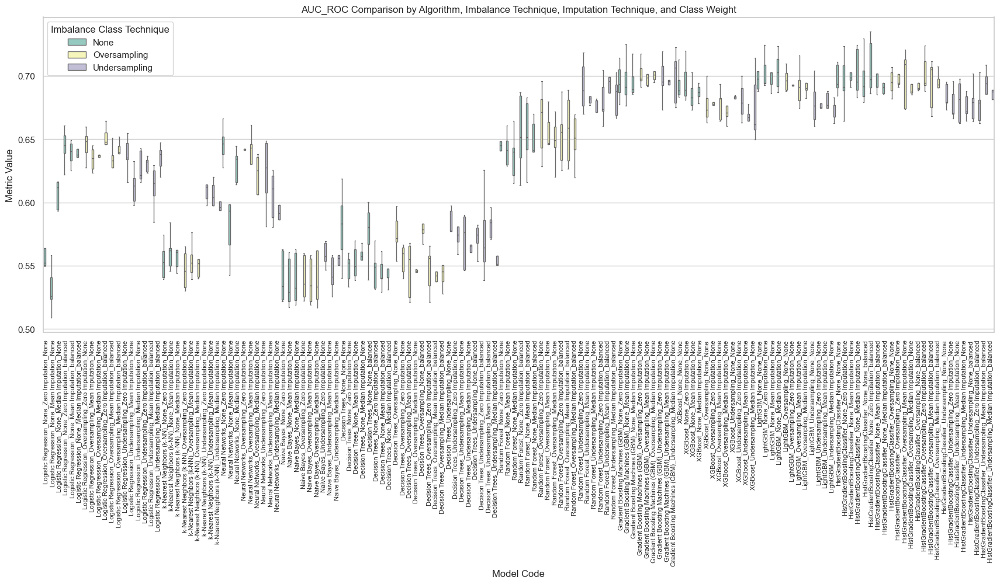

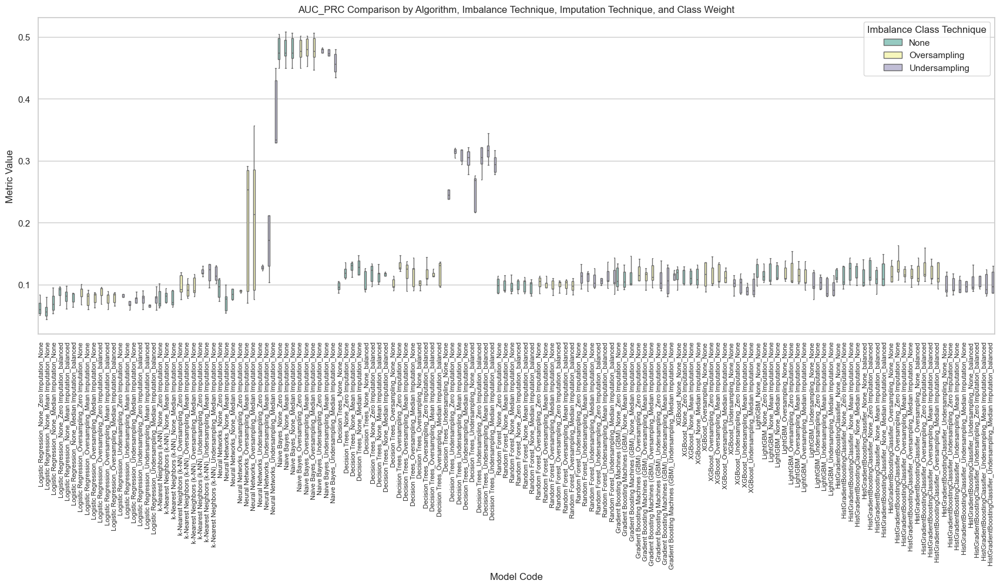

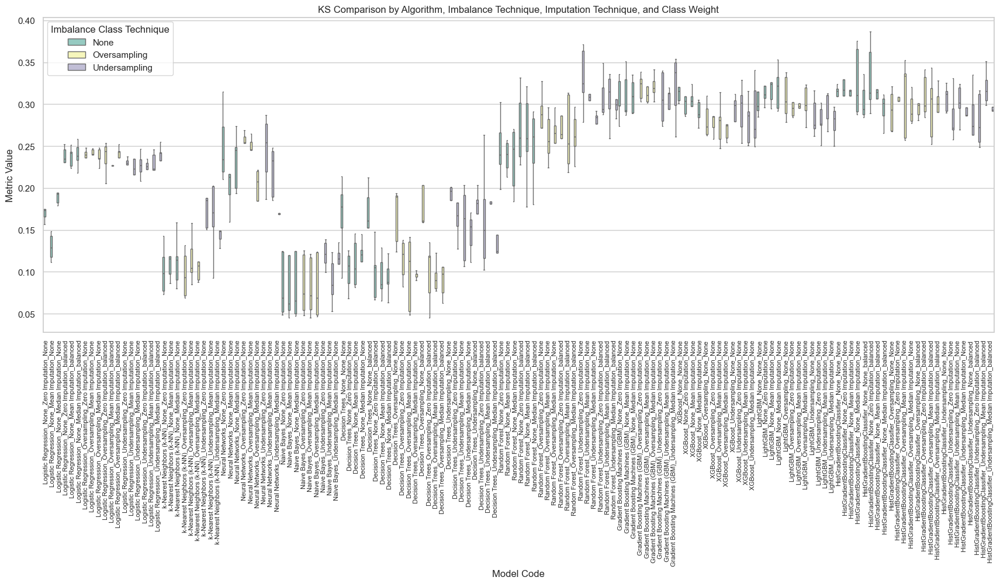

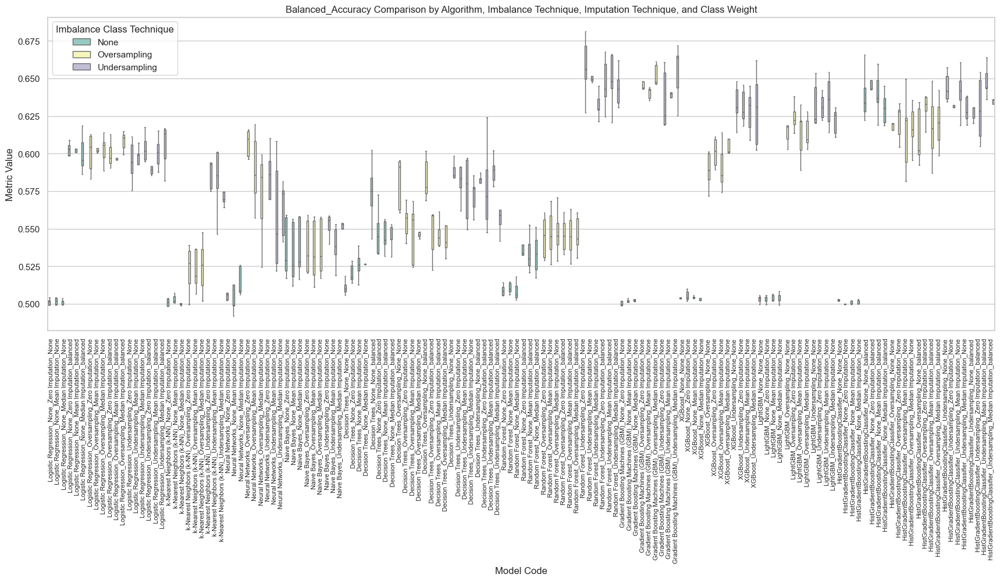

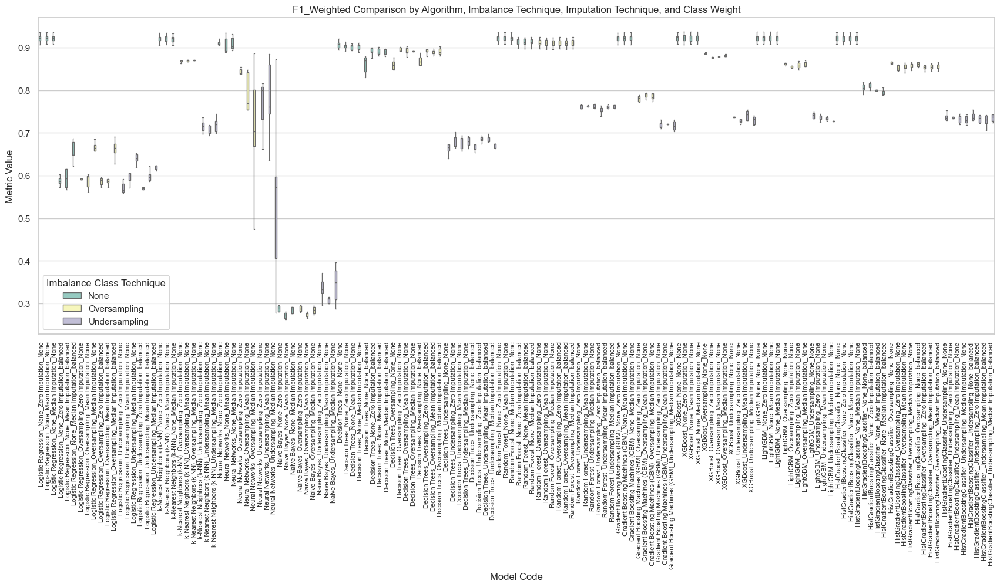

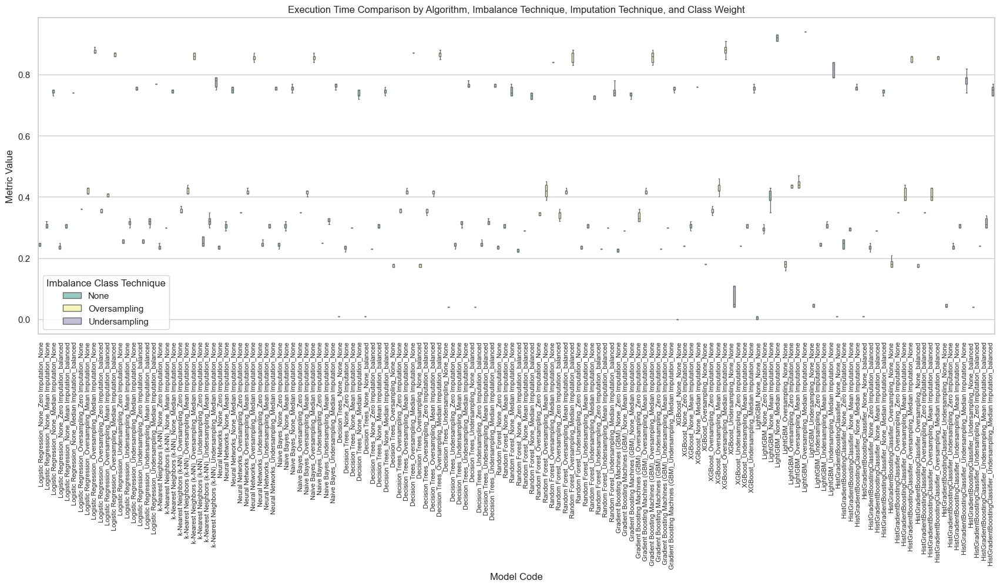

In [123]:
import seaborn as sns
import matplotlib.pyplot as plt

# Extract relevant data for plotting
data_to_plot = df_results_final_2[['Algorithm', 'Imbalance Class Technique', 'Imputation Technique', 'AUC_ROC', 'AUC_PRC', 'Gini', 'KS', 'Balanced_Accuracy', 'F1_Weighted', 'Model Unique Code', 'Execution Time']]

# Extract fold number from 'Model Unique Code'
data_to_plot['Fold'] = data_to_plot['Model Unique Code'].str.extract(r'fold_(\d+)').astype(int)
# Exclude the text _fold_ and the fold number from 'Model Unique Code'
data_to_plot['Model Code'] = data_to_plot['Model Unique Code'].str.extract(r'^(.*?)_fold_\d+').astype(str)

# Melt the dataframe to long format for easier plotting
melted_data = pd.melt(data_to_plot, id_vars=['Model Code', 'Imbalance Class Technique', 'Imputation Technique', 'Model Unique Code', 'Fold'],
                      value_vars=['AUC_ROC', 'AUC_PRC', 'KS', 'Balanced_Accuracy', 'F1_Weighted', 'Execution Time'],
                      var_name='Metrics', value_name='Metric Value')

# Create separate boxplots for each metric
metrics = melted_data['Metrics'].unique()

for metric in metrics:
    plt.figure(figsize=(21, 7))
    sns.set(style='whitegrid')
    sns.boxplot(x='Model Code', y='Metric Value', hue='Imbalance Class Technique',
                data=melted_data[melted_data['Metrics'] == metric], palette='Set3', showfliers=False, dodge=True)
    plt.title(f'{metric} Comparison by Algorithm, Imbalance Technique, Imputation Technique, and Class Weight')
    plt.xlabel('Model Code')
    plt.ylabel('Metric Value')
    plt.xticks(rotation=90, fontsize=8)
    plt.legend(title='Imbalance Class Technique')
    plt.show()

In [130]:
import plotly.express as px

# Create a function to generate boxplots for each metric
def plot_metric_boxplots(data, metric):
    fig = px.box(data, x='Model Code', y='Metric Value', color='Imbalance Class Technique',
                 category_orders={'Imbalance Class Technique': ['None', 'Over-sampling', 'Under-sampling']},
                 points=False,
                 title=f'{metric} Comparison by Algorithm, Imbalance Technique, Imputation Technique, and Class Weight',
                 labels={'Metric Value': metric, 'Model Code': 'Model Code'},
                 width=1200, height=600)

    # Customize the layout

    fig.update_layout(xaxis=dict(tickangle=90, showticklabels=False), legend_title_text='Imbalance Class Technique')
    #fig.update_layout(xaxis=dict(tickangle=90), legend_title_text='Imbalance Class Technique')

    # Show the plot
    fig.show()

# Melt the dataframe to long format for easier plotting
melted_data = pd.melt(data_to_plot, id_vars=['Model Code', 'Imbalance Class Technique', 'Imputation Technique', 'Model Unique Code', 'Fold'],
                      value_vars=['AUC_ROC', 'AUC_PRC', 'KS', 'Balanced_Accuracy', 'F1_Weighted', 'Execution Time'],
                      var_name='Metrics', value_name='Metric Value')


# Create boxplots for each metric
for metric in melted_data['Metrics'].unique():
    # Filter relevant columns for hover_data
    relevant_columns = ['Model Code', 'Imbalance Class Technique', 'Imputation Technique', 'Model Unique Code', 'Fold', 'Metrics', 'Metric Value']
    plot_metric_boxplots(melted_data[melted_data['Metrics'] == metric][relevant_columns], metric)



In [155]:
# List 'Algorithm' with AUC_ROC > 0.65
list_AUC_ROC = df_results_final_2[df_results_final_2['AUC_ROC'] > 0.65]['Algorithm'].unique()
# List 'Algorithm' with KS > 0.3
list_KS = df_results_final_2[df_results_final_2['KS'] > 0.35]['Algorithm'].unique()
# Lis 'Algorithm' with Balanced_Accuracy > 0.60
List_Bal_Acc = df_results_final_2[df_results_final_2['Balanced_Accuracy'] > 0.65]['Algorithm'].unique()
# Get the intersection of the above three lists
list_intersection = (list(set(list_AUC_ROC).intersection(list_KS).intersection(List_Bal_Acc)))
print(list_AUC_ROC, list_KS, List_Bal_Acc, sep='\n')
print(list_intersection)

['LightGBM' 'XGBoost' 'HistGradientBoostingClassifier'
 'Gradient Boosting Machines (GBM)' 'Logistic Regression' 'Random Forest'
 'Neural Networks' 'k-Nearest Neighbors (k-NN)']
['LightGBM' 'Gradient Boosting Machines (GBM)'
 'HistGradientBoostingClassifier' 'Random Forest' 'XGBoost']
['Gradient Boosting Machines (GBM)' 'HistGradientBoostingClassifier'
 'XGBoost' 'Random Forest' 'LightGBM']
['LightGBM', 'XGBoost', 'HistGradientBoostingClassifier', 'Gradient Boosting Machines (GBM)', 'Random Forest']


In [132]:
data_to_plot

,Algorithm,Imbalance Class Technique,Imputation Technique,AUC_ROC,AUC_PRC,Gini,KS,Balanced_Accuracy,F1_Weighted,Model Unique Code,Execution Time,Fold,Model Code
0,Logistic Regression,None,Zero Imputation,0.599933,0.083530,0.199866,0.206333,0.501548,0.907492,Logistic Regression_None_Zero Imputation_None_fold_0,0.24,0,Logistic Regression_None_Zero Imputation_None
1,Logistic Regression,None,Zero Imputation,0.563974,0.050731,0.127948,0.174778,0.502361,0.935664,Logistic Regression_None_Zero Imputation_None_fold_1,0.31,1,Logistic Regression_None_Zero Imputation_None
2,Logistic Regression,None,Zero Imputation,0.552269,0.053489,0.104537,0.165550,0.499307,0.926089,Logistic Regression_None_Zero Imputation_None_fold_2,0.25,2,Logistic Regression_None_Zero Imputation_None
3,Logistic Regression,None,Zero Imputation,0.549608,0.060222,0.099216,0.173520,0.499167,0.922444,Logistic Regression_None_Zero Imputation_None_fold_3,0.24,3,Logistic Regression_None_Zero Imputation_None
4,Logistic Regression,None,Zero Imputation,0.550503,0.070592,0.101006,0.157107,0.504350,0.916500,Logistic Regression_None_Zero Imputation_None_fold_4,0.24,4,Logistic Regression_None_Zero Imputation_None
...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,HistGradientBoostingClassifier,Undersampling,Median Imputation,0.689108,0.120529,0.378217,0.296507,0.636128,0.723195,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced_fold_0,0.73,0,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced
716,HistGradientBoostingClassifier,Undersampling,Median Imputation,0.687482,0.086227,0.374964,0.292018,0.633044,0.743442,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced_fold_1,0.73,1,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced
717,HistGradientBoostingClassifier,Undersampling,Median Imputation,0.666724,0.086319,0.333448,0.269436,0.633098,0.737263,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced_fold_2,0.75,2,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced
718,HistGradientBoostingClassifier,Undersampling,Median Imputation,0.681509,0.096901,0.363017,0.293169,0.635785,0.727830,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced_fold_3,0.77,3,HistGradientBoostingClassifier_Undersampling_Median Imputation_balanced


In [62]:
df_results_final_2.columns

Index(['Algorithm', 'Hyperparameters', 'Imputation Technique',
       'Imbalance Class Technique', 'Model Unique Code', 'Execution Time',
       'Init_Num_Class_0', 'Init_Num_Class_1', 'Res_Num_Class_0',
       'Res_Num_Class_1', 'execution_time', 'Class', 'TP', 'TN', 'FP', 'FN',
       'Sensitivity_TPR', 'Specificity', 'AUC_ROC', 'AUC_PRC', 'Gini', 'KS',
       'MCC', 'Kappa', 'Accuracy', 'Balanced_Accuracy', 'F1', 'F1_Weighted',
       'Precision', 'Recall'],
      dtype='object')

In [59]:
metrics_df

,Class,TP,TN,FP,FN,Sensitivity_TPR,Specificity,AUC_ROC,AUC_PRC,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
0,Class 1,2321,1259,81,135,0.945033,0.939552,0.6749,0.102557,0.349801,0.276397,0.131349,0.076726,0.646997,0.636662,0.167702,0.741382,0.096844,0.625


In [15]:
# Set the display character limit to 100 and max number of columns to 100
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_colwidth', 100)

display(df_results_final_2)

,Algorithm,Hyperparameters,Imputation Technique,Imbalance Class Technique,Model Unique Code,Class,TP,TN,FP,FN,Sensitivity_TPR,Specificity,AUC_ROC,AUC_PRC,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
0,Neural Networks,"{'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'e...",Zero Imputation,Oversampling,Neural Networks_Oversampling_Zero Imputation_fold_0,Class 1,2721,839,136,101,0.964210,0.860513,0.618631,0.111923,0.237261,0.219866,0.106769,0.079889,0.743218,0.595243,0.171623,0.805838,0.107447,0.426160
1,Neural Networks,"{'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'e...",Zero Imputation,Oversampling,Neural Networks_Oversampling_Zero Imputation_fold_1,Class 1,2847,786,97,67,0.977008,0.890147,0.653543,0.083387,0.307085,0.265538,0.093613,0.063939,0.767448,0.596093,0.131760,0.834042,0.078546,0.408537
2,Neural Networks,"{'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'e...",Zero Imputation,Oversampling,Neural Networks_Oversampling_Zero Imputation_fold_2,Class 1,2911,699,105,82,0.972603,0.869403,0.646090,0.094143,0.292180,0.255255,0.131092,0.097716,0.788254,0.622437,0.169421,0.843730,0.104994,0.438503
3,Neural Networks,"{'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'e...",Zero Imputation,Oversampling,Neural Networks_Oversampling_Zero Imputation_fold_3,Class 1,2735,865,100,96,0.966090,0.896373,0.641382,0.101850,0.282764,0.266633,0.126982,0.087695,0.745785,0.624759,0.165946,0.814717,0.099896,0.489796
4,Neural Networks,"{'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'e...",Zero Imputation,Oversampling,Neural Networks_Oversampling_Zero Imputation_fold_4,Class 1,2812,768,125,91,0.968653,0.860022,0.650405,0.108391,0.300811,0.272589,0.114475,0.086204,0.764752,0.603386,0.169302,0.823502,0.105937,0.421296
5,Neural Networks,"{'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'e...",Zero Imputation,Undersampling,Neural Networks_Undersampling_Zero Imputation_fold_0,Class 1,2315,1245,110,127,0.947993,0.918819,0.605889,0.174622,0.211778,0.228541,0.093739,0.057539,0.643139,0.593073,0.157862,0.735168,0.092566,0.535865
6,Neural Networks,"{'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'e...",Zero Imputation,Undersampling,Neural Networks_Undersampling_Zero Imputation_fold_1,Class 1,2164,1469,62,102,0.954987,0.959504,0.588771,0.109206,0.177543,0.221773,0.089819,0.042701,0.596787,0.608801,0.117579,0.711865,0.064927,0.621951
7,Neural Networks,"{'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'e...",Zero Imputation,Undersampling,Neural Networks_Undersampling_Zero Imputation_fold_2,Class 1,2475,1135,124,63,0.975177,0.901509,0.596698,0.142273,0.193396,0.229597,0.010474,0.006313,0.668422,0.511247,0.090975,0.762447,0.052588,0.336898
8,Neural Networks,"{'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'e...",Zero Imputation,Undersampling,Neural Networks_Undersampling_Zero Imputation_fold_3,Class 1,2531,1069,114,82,0.968618,0.903635,0.610656,0.163082,0.221312,0.227211,0.058456,0.036755,0.688356,0.560711,0.121752,0.775003,0.071242,0.418367
9,Neural Networks,"{'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'e...",Zero Imputation,Undersampling,Neural Networks_Undersampling_Zero Imputation_fold_4,Class 1,1747,1833,71,145,0.923362,0.962710,0.560347,0.177950,0.120695,0.195143,0.073864,0.032960,0.498419,0.579643,0.132179,0.617967,0.073306,0.671296


## 10.	Treinamento de Modelo

In [156]:
import pandas as pd
import numpy as np
from sklearn.model_selection import KFold
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, HistGradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve, auc
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.experimental import enable_hist_gradient_boosting
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTEENN, SMOTETomek
import os
import json 
import time

# Redefine function without print
def end_timer():
    end_time = time.time()
    execution_time = end_time - start_time
    execution_time = round(execution_time, 2)
    return execution_time

# Define the dataframe 'df', features, and target
# 'label' is the target column
features = df.columns[1:479]
target = df['label']

# Define the imbalanced data handling techniques
sampling_techniques = {
    'None': None,
    'Oversampling': RandomOverSampler(),
    'Undersampling': RandomUnderSampler(),
}

# Define the imputation techniques
imputation_techniques = {
    'None': None,
    'Zero Imputation': SimpleImputer(strategy='constant', fill_value=0),
}

# Create a list to store the results
results_3 = []

# Define k-fold cross-validation
k_fold = KFold(n_splits=10, shuffle=True, random_state=42)

# Iterate through each model
for model_name, model in [
    ('Random Forest', RandomForestClassifier()),
    ('Gradient Boosting Machines (GBM)', GradientBoostingClassifier()),
    ('XGBoost', XGBClassifier()),
    ('LightGBM', LGBMClassifier()),
    ('HistGradientBoostingClassifier', HistGradientBoostingClassifier())
]:
    # Filter only specified algorithms
    if model_name not in ['LightGBM', 'XGBoost', 'HistGradientBoostingClassifier', 'Gradient Boosting Machines (GBM)', 'Random Forest']:
        continue

    # Define the normalization and scaling techniques
    normalization_scalers = {
        'MinMaxScaler [0, 1]': MinMaxScaler(feature_range=(0, 1)),
        'MinMaxScaler [1, 2]': MinMaxScaler(feature_range=(1, 2)),
        'StandardScaler': StandardScaler(),
        'StandardScaler MinMaxScaler [0, 1]': [StandardScaler(), MinMaxScaler(feature_range=(0, 1))]
    }

    # Iterate through each normalization and scaling technique
    for scaler_name, scaler in normalization_scalers.items():

        # Iterate through each imbalanced data handling technique
        for sampling_name, sampling_technique in sampling_techniques.items():

            # Iterate through each imputation technique
            for imputation_name, imputation_technique in imputation_techniques.items():

                # Create a new dataframe to store the results for this model, technique combination
                df_result_3 = pd.DataFrame(columns=['Algorithm', 'Metrics', 'Hyperparameters', 'Imputation Technique', 'Imbalance Class Technique', 'Model Unique Code', 'Execution Time', 'Shape_X0_0', 'Shape_X0_1', 'Shape_X1_0', 'Shape_X1_1'])

                # Perform k-fold cross-validation
                for fold, (train_index, test_index) in enumerate(k_fold.split(df[features], target)):
                    Init_Num_Class_0, Init_Num_Class_1, Res_Num_Class_0, Res_Num_Class_1, X_train_resampled, y_train_resampled, X_train, y_train = 0, 0, 0, 0, 0, 0, 0, 0
                    X_train, X_test = df[features].iloc[train_index], df[features].iloc[test_index]
                    y_train, y_test = target.iloc[train_index], target.iloc[test_index]

                    # Apply imputation technique on the train and test sets, if imputation_name is not None
                    if imputation_name is not None and imputation_technique is not None:
                        X_train_imputed = imputation_technique.fit_transform(X_train)
                        X_test_imputed = imputation_technique.transform(X_test)
                    else:
                        if model_name in ['Decision Trees', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier']:
                            X_train_imputed, X_test_imputed = X_train, X_test
                        else:
                            break

                    # Apply normalization and scaling technique on the train and test sets
                    if isinstance(scaler, list):
                        # For multiple scalers, apply them sequentially
                        for s in scaler:
                            X_train_imputed = s.fit_transform(X_train_imputed)
                            X_test_imputed = s.transform(X_test_imputed)
                    else:
                        X_train_imputed = scaler.fit_transform(X_train_imputed)
                        X_test_imputed = scaler.transform(X_test_imputed)

                    # Apply the imbalanced data handling technique on the train set
                    if sampling_technique is not None:
                        X_train_resampled, y_train_resampled = sampling_technique.fit_resample(X_train_imputed, y_train)
                    else:
                        X_train_resampled, y_train_resampled = X_train_imputed, y_train

                    # Start timer
                    start_time = time.time()

                    # Train the model on the resampled train set
                    model.fit(X_train_resampled, y_train_resampled)

                    # Stop timer
                    execution_time = end_timer()

                    # Make predictions on the test set
                    y_pred = model.predict(X_test_imputed)
                    y_prob = model.predict_proba(X_test_imputed)[:, 1]

                    # Calculate the evaluation metrics
                    metrics_df = calculate_classification_metrics_one_class(y_test, y_prob)

                    # Set 'Imputation Technique' based on the specified conditions
                    if imputation_name in ['Decision Trees', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier']:
                        imputation_name = 'None'
                    else:
                        imputation_name = imputation_name

                    # Count samples and features for each label before resampling
                    Init_Num_Class_0 = X_train[y_train == 0].shape[0]  # Number of samples with label 0
                    Init_Num_Class_1 = X_train[y_train == 1].shape[0]  # Number of samples with label 1
                    Res_Num_Class_0 = X_train_resampled[y_train_resampled == 0].shape[0]  # Number of features with label 0 after resampling
                    Res_Num_Class_1 = X_train_resampled[y_train_resampled == 1].shape[0]  # Number of features with label 1 after resampling

                    # Append the result to the list
                    df_result_3 = pd.DataFrame({
                        'Algorithm': model_name,
                        'Hyperparameters': [model.get_params()],
                        'Imputation Technique': imputation_name,
                        'Imbalance Class Technique': sampling_name,
                        'Model Unique Code': f"{model_name}_{sampling_name}_{imputation_name}_{scaler_name}_fold_{fold}",
                        'Execution Time': execution_time,
                        'Init_Num_Class_0': Init_Num_Class_0,
                        'Init_Num_Class_1': Init_Num_Class_1,
                        'Res_Num_Class_0': Res_Num_Class_0,
                        'Res_Num_Class_1': Res_Num_Class_1,
                        'execution_time_seg': execution_time,
                        **metrics_df  # Unpack the metrics_df columns
                    })

                    # Append the result to the list
                    results_3.append(df_result_3)

# Combine all the results DataFrames into one final DataFrame
df_results_final_3 = pd.concat(results_3, ignore_index=True)

# Save each model in a separate file with a name corresponding to the model unique code
for model_unique_code in df_results_final_3['Model Unique Code'].unique():
    df_model = df_results_final_3[df_results_final_3['Model Unique Code'] == model_unique_code]
    df_model.to_csv(f"{model_unique_code}_3.csv", index=False)

# Display the final DataFrame
display(df_results_final_3)


[LightGBM] [Info] Number of positive: 876, number of negative: 16208
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.037260 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 61413
[LightGBM] [Info] Number of data points in the train set: 17084, number of used features: 478
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.051276 -> initscore=-2.917894
[LightGBM] [Info] Start training from score -2.917894
[LightGBM] [Info] Number of positive: 887, number of negative: 16197
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.041253 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 61402
[LightGBM] [Info] Number of data points in the train set: 17084, number of used features: 478
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.051920 -> initscore=-2.904736
[LightGBM] [Info] Start training from score -2.904736
[LightGBM] [

,Algorithm,Hyperparameters,Imputation Technique,Imbalance Class Technique,Model Unique Code,Execution Time,Init_Num_Class_0,Init_Num_Class_1,Res_Num_Class_0,Res_Num_Class_1,execution_time_seg,Class,TP,TN,FP,FN,Sensitivity_TPR,Specificity,AUC_ROC,AUC_PRC,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
0,Random Forest,"{'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': No...",Zero Imputation,None,"Random Forest_None_Zero Imputation_MinMaxScaler [0, 1]_fold_0",15.16,16208,876,16208,876,15.16,Class 1,1770,5,122,2,0.998871,0.039370,0.604995,0.112620,0.209991,0.193180,0.054269,0.023722,0.933123,0.506656,0.030534,0.904325,0.285714,0.016129
1,Random Forest,"{'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': No...",Zero Imputation,None,"Random Forest_None_Zero Imputation_MinMaxScaler [0, 1]_fold_1",16.00,16197,887,16197,887,16.00,Class 1,1776,10,110,3,0.998314,0.083333,0.665332,0.119504,0.330664,0.290881,0.060105,0.035780,0.936809,0.510475,0.047619,0.912593,0.230769,0.026549
2,Random Forest,"{'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': No...",Zero Imputation,None,"Random Forest_None_Zero Imputation_MinMaxScaler [0, 1]_fold_2",15.78,16165,919,16165,919,15.78,Class 1,1804,14,78,3,0.998340,0.152174,0.694706,0.089273,0.389412,0.342745,0.062938,0.047124,0.951553,0.514668,0.061224,0.936153,0.176471,0.037037
3,Random Forest,"{'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': No...",Zero Imputation,None,"Random Forest_None_Zero Imputation_MinMaxScaler [0, 1]_fold_3",16.04,16168,917,16168,917,16.04,Class 1,1806,9,83,0,1.000000,0.097826,0.636679,0.080354,0.273358,0.258827,-0.014761,-0.008630,0.951528,0.497521,0.000000,0.932518,0.000000,0.000000
4,Random Forest,"{'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': No...",Zero Imputation,None,"Random Forest_None_Zero Imputation_MinMaxScaler [0, 1]_fold_4",15.51,16181,904,16181,904,15.51,Class 1,1794,8,96,0,1.000000,0.076923,0.657643,0.116523,0.315286,0.282036,-0.015017,-0.007842,0.945205,0.497780,0.000000,0.922676,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
955,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,Undersampling,"HistGradientBoostingClassifier_Undersampling_Zero Imputation_StandardScaler MinMaxScaler [0, 1]_...",6.67,16176,909,909,909,6.67,Class 1,1137,670,33,58,0.951464,0.953058,0.688300,0.096823,0.376600,0.316151,0.117131,0.061655,0.629610,0.633291,0.141636,0.734024,0.079670,0.637363
956,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,Undersampling,"HistGradientBoostingClassifier_Undersampling_Zero Imputation_StandardScaler MinMaxScaler [0, 1]_...",6.63,16181,904,904,904,6.63,Class 1,1137,665,38,58,0.951464,0.945946,0.676846,0.105696,0.353693,0.311217,0.106105,0.057466,0.629610,0.617566,0.141636,0.732385,0.080221,0.604167
957,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,Undersampling,"HistGradientBoostingClassifier_Undersampling_Zero Imputation_StandardScaler MinMaxScaler [0, 1]_...",6.63,16185,900,900,900,6.63,Class 1,1096,702,39,61,0.947277,0.947368,0.663968,0.086106,0.327937,0.258943,0.100046,0.053156,0.609589,0.609783,0.141367,0.715430,0.079948,0.610000
958,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,Undersampling,"HistGradientBoostingClassifier_Undersampling_Zero Imputation_StandardScaler MinMaxScaler [0, 1]_...",6.73,16206,879,879,879,6.

In [160]:
# Order df_results_final_3 by 'Balanced_Accuracy'
display(df_results_final_3.sort_values(by=['Balanced_Accuracy'], ascending=False).head(10))
display(df_results_final_3.sort_values(by=['AUC_ROC'], ascending=False).head(10))
display(df_results_final_3.sort_values(by=['KS'], ascending=False).head(10))

,Algorithm,Hyperparameters,Imputation Technique,Imbalance Class Technique,Model Unique Code,Execution Time,Init_Num_Class_0,Init_Num_Class_1,Res_Num_Class_0,Res_Num_Class_1,execution_time_seg,Class,TP,TN,FP,FN,Sensitivity_TPR,Specificity,AUC_ROC,AUC_PRC,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
81,Random Forest,"{'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': No...",Zero Imputation,Undersampling,Random Forest_Undersampling_Zero Imputation_StandardScaler_fold_1,1.12,16197,887,887,887,1.12,Class 1,1173,613,28,85,0.932432,0.956318,0.747470,0.150728,0.494941,0.421523,0.200674,0.119422,0.662454,0.704494,0.209618,0.751141,0.121777,0.752212
111,Random Forest,"{'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': No...",Zero Imputation,Undersampling,"Random Forest_Undersampling_Zero Imputation_StandardScaler MinMaxScaler [0, 1]_fold_1",1.09,16197,887,887,887,1.09,Class 1,1200,586,30,83,0.935308,0.951299,0.733686,0.138561,0.467372,0.409314,0.201268,0.122985,0.675619,0.703203,0.212276,0.761036,0.124066,0.734513
762,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",None,Undersampling,"HistGradientBoostingClassifier_Undersampling_None_MinMaxScaler [0, 1]_fold_2",6.89,16165,919,919,919,6.89,Class 1,1196,622,21,60,0.952229,0.967341,0.731033,0.125523,0.462067,0.436010,0.167898,0.087710,0.661401,0.699303,0.157274,0.761229,0.087977,0.740741
469,XGBoost,"{'objective': 'binary:logistic', 'base_score': None, 'booster': None, 'callbacks': None, 'colsam...",None,Undersampling,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]_fold_9",1.33,16180,905,905,905,1.33,Class 1,1225,578,27,68,0.947409,0.955372,0.752801,0.124339,0.505602,0.412430,0.181875,0.105469,0.681243,0.697606,0.183536,0.771010,0.105263,0.715789
462,XGBoost,"{'objective': 'binary:logistic', 'base_score': None, 'booster': None, 'callbacks': None, 'colsam...",None,Undersampling,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]_fold_2",1.39,16165,919,919,919,1.39,Class 1,1167,651,20,61,0.950326,0.970194,0.746740,0.110602,0.493481,0.425804,0.164881,0.083660,0.646656,0.697500,0.153846,0.750138,0.085674,0.753086
598,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Zero Imputation,Undersampling,"LightGBM_Undersampling_Zero Imputation_MinMaxScaler [1, 2]_fold_8",0.49,16206,879,879,879,0.49,Class 1,1167,610,32,89,0.929140,0.950156,0.717218,0.128402,0.434435,0.405559,0.198685,0.121602,0.661749,0.696131,0.217073,0.748114,0.127325,0.735537
359,XGBoost,"{'objective': 'binary:logistic', 'base_score': None, 'booster': None, 'callbacks': None, 'colsam...",Zero Imputation,Undersampling,"XGBoost_Undersampling_Zero Imputation_MinMaxScaler [1, 2]_fold_9",0.87,16180,905,905,905,0.87,Class 1,1161,642,24,71,0.942370,0.963964,0.740401,0.102955,0.480801,0.441212,0.176181,0.095876,0.649104,0.695648,0.175743,0.747008,0.099579,0.747368
949,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",None,Undersampling,"HistGradientBoostingClassifier_Undersampling_None_StandardScaler MinMaxScaler [0, 1]_fold_9",7.00,16180,905,905,905,7.00,Class 1,1177,626,25,70,0.943865,0.961598,0.756073,0.149272,0.512146,0.419003,0.176307,0.097496,0.657007,0.694821,0.176991,0.753011,0.100575,0.736842
761,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",None,Undersampling,"HistGradientBoostingClassifier_Undersampling_None_MinMaxScaler [0, 1]_fold_1",7.03,16197,887,887,887,7.03,Class 1,1110,676,27,86,0.928094,0.961593,0.729999,0.124344,0.459999,0.395564,0.184640,0.103676,0.629805,0.691281,0.196571,0.725997,0.112861,0.761062
419,XGBoost,"{'objective': 'binary:logistic', 'base_score': None, 'boos

,Algorithm,Hyperparameters,Imputation Technique,Imbalance Class Technique,Model Unique Code,Execution Time,Init_Num_Class_0,Init_Num_Class_1,Res_Num_Class_0,Res_Num_Class_1,execution_time_seg,Class,TP,TN,FP,FN,Sensitivity_TPR,Specificity,AUC_ROC,AUC_PRC,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
549,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",None,None,"LightGBM_None_None_MinMaxScaler [1, 2]_fold_9",2.03,16180,905,16180,905,2.03,Class 1,1802,1,95,0,1.000000,0.010417,0.770786,0.154870,0.541571,0.437411,-0.005270,-0.001044,0.949420,0.499723,0.000000,0.925300,0.000000,0.000000
859,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,None,HistGradientBoostingClassifier_None_Zero Imputation_StandardScaler_fold_9,2.70,16180,905,16180,905,2.70,Class 1,1803,0,95,0,1.000000,0.000000,0.767262,0.144842,0.534524,0.421269,0.000000,0.000000,0.949947,0.500000,0.000000,0.925563,0.000000,0.000000
739,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,None,"HistGradientBoostingClassifier_None_Zero Imputation_MinMaxScaler [0, 1]_fold_9",3.53,16180,905,16180,905,3.53,Class 1,1803,0,95,0,1.000000,0.000000,0.759383,0.150476,0.518767,0.404711,0.000000,0.000000,0.949947,0.500000,0.000000,0.925563,0.000000,0.000000
949,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",None,Undersampling,"HistGradientBoostingClassifier_Undersampling_None_StandardScaler MinMaxScaler [0, 1]_fold_9",7.00,16180,905,905,905,7.00,Class 1,1177,626,25,70,0.943865,0.961598,0.756073,0.149272,0.512146,0.419003,0.176307,0.097496,0.657007,0.694821,0.176991,0.753011,0.100575,0.736842
902,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",None,None,"HistGradientBoostingClassifier_None_None_StandardScaler MinMaxScaler [0, 1]_fold_2",2.72,16165,919,16165,919,2.72,Class 1,1816,2,81,0,1.000000,0.024096,0.755134,0.117710,0.510268,0.427271,-0.006854,-0.002060,0.956293,0.499450,0.000000,0.935957,0.000000,0.000000
909,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",None,None,"HistGradientBoostingClassifier_None_None_StandardScaler MinMaxScaler [0, 1]_fold_9",2.60,16180,905,16180,905,2.60,Class 1,1803,0,95,0,1.000000,0.000000,0.754663,0.138978,0.509327,0.391435,0.000000,0.000000,0.949947,0.500000,0.000000,0.925563,0.000000,0.000000
559,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Zero Imputation,None,"LightGBM_None_Zero Imputation_MinMaxScaler [1, 2]_fold_9",1.57,16180,905,16180,905,1.57,Class 1,1803,0,95,0,1.000000,0.000000,0.753884,0.144285,0.507768,0.430131,0.000000,0.000000,0.949947,0.500000,0.000000,0.925563,0.000000,0.000000
469,XGBoost,"{'objective': 'binary:logistic', 'base_score': None, 'booster': None, 'callbacks': None, 'colsam...",None,Undersampling,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]_fold_9",1.33,16180,905,905,905,1.33,Class 1,1225,578,27,68,0.947409,0.955372,0.752801,0.124339,0.505602,0.412430,0.181875,0.105469,0.681243,0.697606,0.183536,0.771010,0.105263,0.715789
789,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",None,None,"HistGradientBoostingClassifier_None_None_MinMaxScaler [1, 2]_fold_9",5.60,16180,905,16180,905,5.60,Class 1,1803,0,95,0,1.000000,0.000000,0.752763,0.132218,0.505526,0.404595,0.000000,0.000000,0.949947,0.500000,0.000000,0.925563,0.000000,0.000000
319,XGBoost,"{'objective': 'binary:logistic', 'base_score': None, 'booster': None, 'callbacks': None, 'co

,Algorithm,Hyperparameters,Imputation Technique,Imbalance Class Technique,Model Unique Code,Execution Time,Init_Num_Class_0,Init_Num_Class_1,Res_Num_Class_0,Res_Num_Class_1,execution_time_seg,Class,TP,TN,FP,FN,Sensitivity_TPR,Specificity,AUC_ROC,AUC_PRC,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
359,XGBoost,"{'objective': 'binary:logistic', 'base_score': None, 'booster': None, 'callbacks': None, 'colsam...",Zero Imputation,Undersampling,"XGBoost_Undersampling_Zero Imputation_MinMaxScaler [1, 2]_fold_9",0.87,16180,905,905,905,0.87,Class 1,1161,642,24,71,0.942370,0.963964,0.740401,0.102955,0.480801,0.441212,0.176181,0.095876,0.649104,0.695648,0.175743,0.747008,0.099579,0.747368
549,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",None,None,"LightGBM_None_None_MinMaxScaler [1, 2]_fold_9",2.03,16180,905,16180,905,2.03,Class 1,1802,1,95,0,1.000000,0.010417,0.770786,0.154870,0.541571,0.437411,-0.005270,-0.001044,0.949420,0.499723,0.000000,0.925300,0.000000,0.000000
762,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",None,Undersampling,"HistGradientBoostingClassifier_Undersampling_None_MinMaxScaler [0, 1]_fold_2",6.89,16165,919,919,919,6.89,Class 1,1196,622,21,60,0.952229,0.967341,0.731033,0.125523,0.462067,0.436010,0.167898,0.087710,0.661401,0.699303,0.157274,0.761229,0.087977,0.740741
918,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,None,"HistGradientBoostingClassifier_None_Zero Imputation_StandardScaler MinMaxScaler [0, 1]_fold_8",2.18,16206,879,16206,879,2.18,Class 1,1777,0,121,0,1.000000,0.000000,0.743065,0.163065,0.486129,0.430771,0.000000,0.000000,0.936249,0.500000,0.000000,0.905423,0.000000,0.000000
559,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Zero Imputation,None,"LightGBM_None_Zero Imputation_MinMaxScaler [1, 2]_fold_9",1.57,16180,905,16180,905,1.57,Class 1,1803,0,95,0,1.000000,0.000000,0.753884,0.144285,0.507768,0.430131,0.000000,0.000000,0.949947,0.500000,0.000000,0.925563,0.000000,0.000000
902,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",None,None,"HistGradientBoostingClassifier_None_None_StandardScaler MinMaxScaler [0, 1]_fold_2",2.72,16165,919,16165,919,2.72,Class 1,1816,2,81,0,1.000000,0.024096,0.755134,0.117710,0.510268,0.427271,-0.006854,-0.002060,0.956293,0.499450,0.000000,0.935957,0.000000,0.000000
462,XGBoost,"{'objective': 'binary:logistic', 'base_score': None, 'booster': None, 'callbacks': None, 'colsam...",None,Undersampling,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]_fold_2",1.39,16165,919,919,919,1.39,Class 1,1167,651,20,61,0.950326,0.970194,0.746740,0.110602,0.493481,0.425804,0.164881,0.083660,0.646656,0.697500,0.153846,0.750138,0.085674,0.753086
81,Random Forest,"{'bootstrap': True, 'ccp_alpha': 0.0, 'class_weight': None, 'criterion': 'gini', 'max_depth': No...",Zero Imputation,Undersampling,Random Forest_Undersampling_Zero Imputation_StandardScaler_fold_1,1.12,16197,887,887,887,1.12,Class 1,1173,613,28,85,0.932432,0.956318,0.747470,0.150728,0.494941,0.421523,0.200674,0.119422,0.662454,0.704494,0.209618,0.751141,0.121777,0.752212
859,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,None,HistGradientBoostingClassifier_None_Zero Imputation_StandardScaler_fold_9,2.70,16180,905,16180,905,2.70,Class 1,1803,0,95,0,1.000000,0.000000,0.767262,0.144842,0.534524,0.421269,0.000000,0.000000,0.949947,0.500000,0.000000,0.925563,0.000000,0.000000
949,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interacti

## 11.	Avaliação de Modelo


In [162]:
# Concat df_results_final_2 and df_results_final_3
df_results_final_concat = pd.concat([df_results_final_2, df_results_final_3])
df_results_final_concat

,Algorithm,Hyperparameters,Imputation Technique,Imbalance Class Technique,Model Unique Code,Execution Time,Init_Num_Class_0,Init_Num_Class_1,Res_Num_Class_0,Res_Num_Class_1,execution_time_seg,Class,TP,TN,FP,FN,Sensitivity_TPR,Specificity,AUC_ROC,AUC_PRC,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
559,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Median Imputation,None,LightGBM_None_Median Imputation_None_fold_4,0.97,14403,784,14403,784,0.97,Class 1,3579,1,215,1,0.999721,0.004630,0.723510,0.136000,0.447020,0.353011,0.043916,0.008139,0.943098,0.502175,0.009174,0.915995,0.500000,0.004630
579,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Median Imputation,Oversampling,LightGBM_Oversampling_Median Imputation_None_fold_4,0.97,14403,784,14403,14403,0.97,Class 1,3075,505,133,83,0.973718,0.791536,0.707663,0.137440,0.415326,0.323081,0.155712,0.134426,0.831928,0.621599,0.206468,0.866205,0.141156,0.384259
578,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Median Imputation,Oversampling,LightGBM_Oversampling_Median Imputation_None_fold_3,0.94,14383,804,14383,14383,0.94,Class 1,3015,585,122,74,0.976044,0.827440,0.690359,0.103601,0.380717,0.298929,0.125638,0.101592,0.813751,0.607526,0.173099,0.857780,0.112291,0.377551
577,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Median Imputation,Oversampling,LightGBM_Oversampling_Median Imputation_None_fold_2,0.94,14373,813,14373,14373,0.94,Class 1,2990,620,107,80,0.973941,0.852820,0.694404,0.102240,0.388807,0.292502,0.142890,0.111302,0.808533,0.628031,0.180383,0.856578,0.114286,0.427807
576,LightGBM,"{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'spl...",Median Imputation,Oversampling,LightGBM_Oversampling_Median Imputation_None_fold_1,0.94,14350,836,14350,14350,0.94,Class 1,3073,560,105,59,0.981162,0.842105,0.688934,0.090925,0.377868,0.319675,0.113158,0.088452,0.824862,0.602807,0.150702,0.869898,0.095315,0.359756
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
955,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,Undersampling,"HistGradientBoostingClassifier_Undersampling_Zero Imputation_StandardScaler MinMaxScaler [0, 1]_...",6.67,16176,909,909,909,6.67,Class 1,1137,670,33,58,0.951464,0.953058,0.688300,0.096823,0.376600,0.316151,0.117131,0.061655,0.629610,0.633291,0.141636,0.734024,0.079670,0.637363
956,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,Undersampling,"HistGradientBoostingClassifier_Undersampling_Zero Imputation_StandardScaler MinMaxScaler [0, 1]_...",6.63,16181,904,904,904,6.63,Class 1,1137,665,38,58,0.951464,0.945946,0.676846,0.105696,0.353693,0.311217,0.106105,0.057466,0.629610,0.617566,0.141636,0.732385,0.080221,0.604167
957,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,Undersampling,"HistGradientBoostingClassifier_Undersampling_Zero Imputation_StandardScaler MinMaxScaler [0, 1]_...",6.63,16185,900,900,900,6.63,Class 1,1096,702,39,61,0.947277,0.947368,0.663968,0.086106,0.327937,0.258943,0.100046,0.053156,0.609589,0.609783,0.141367,0.715430,0.079948,0.610000
958,HistGradientBoostingClassifier,"{'categorical_features': None, 'class_weight': None, 'early_stopping': 'auto', 'interaction_cst'...",Zero Imputation,Undersampling,"HistGradientBoostingClassifier_Undersampling_Zero Imputation_StandardScaler MinMaxScaler [0, 1]_...",6.73,16206,879,879,879,6.73,Class 1,1106,671,35,86,0.927852

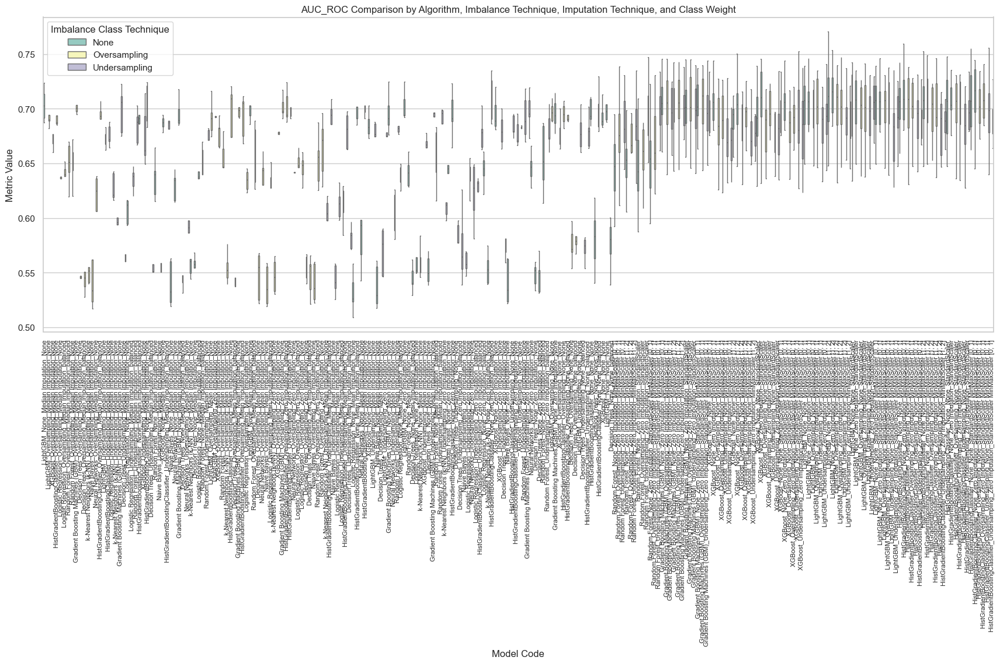

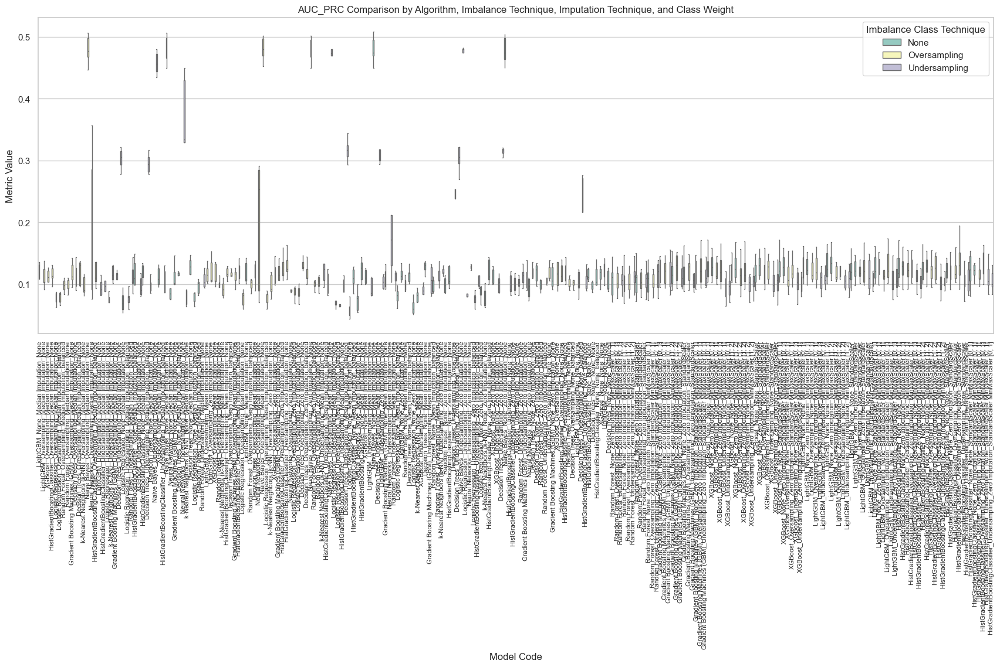

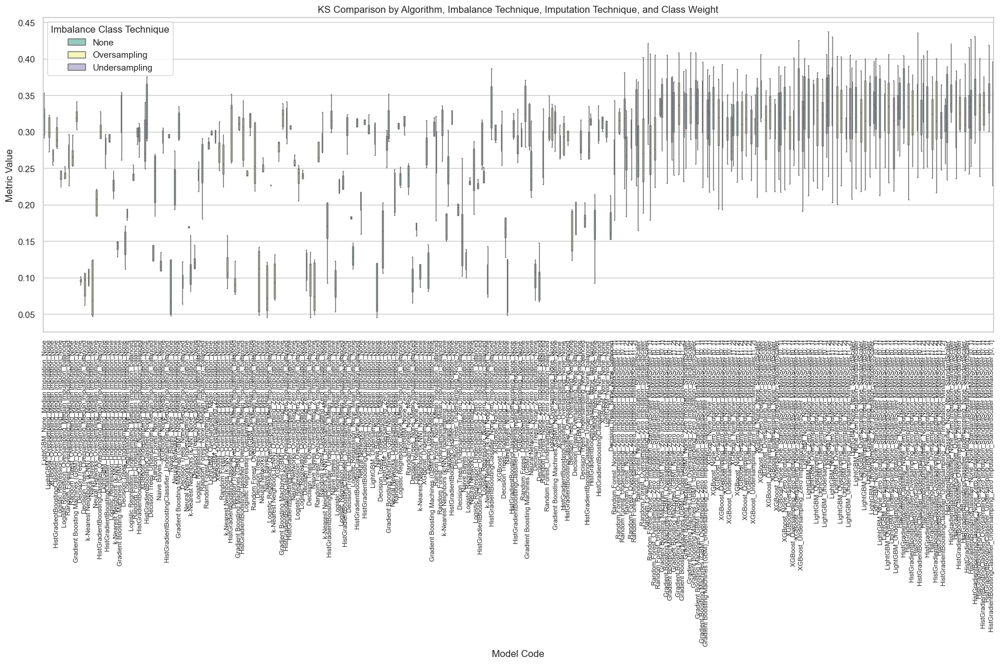

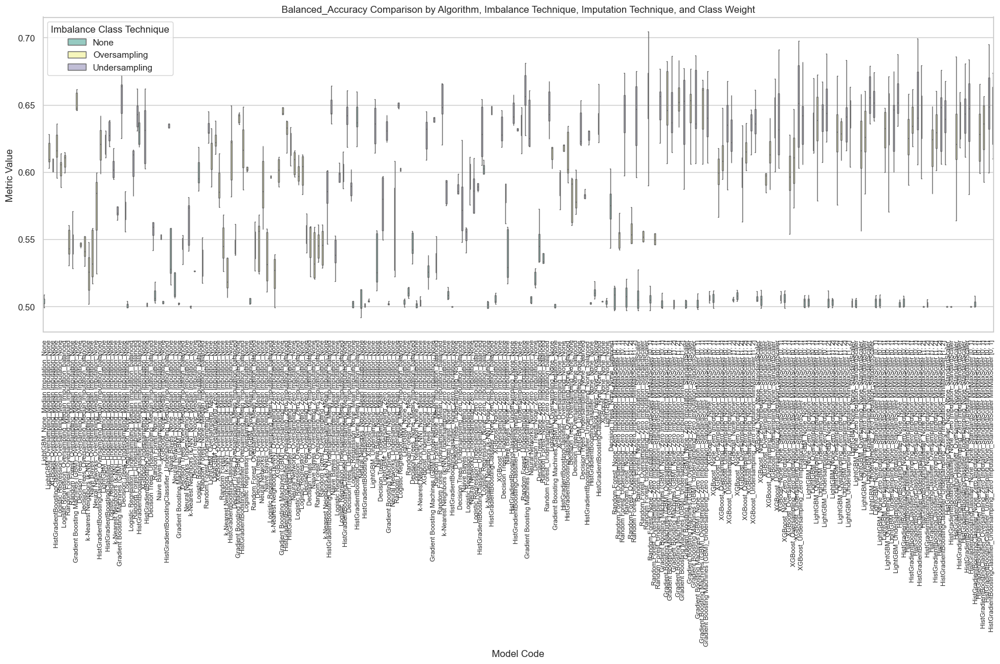

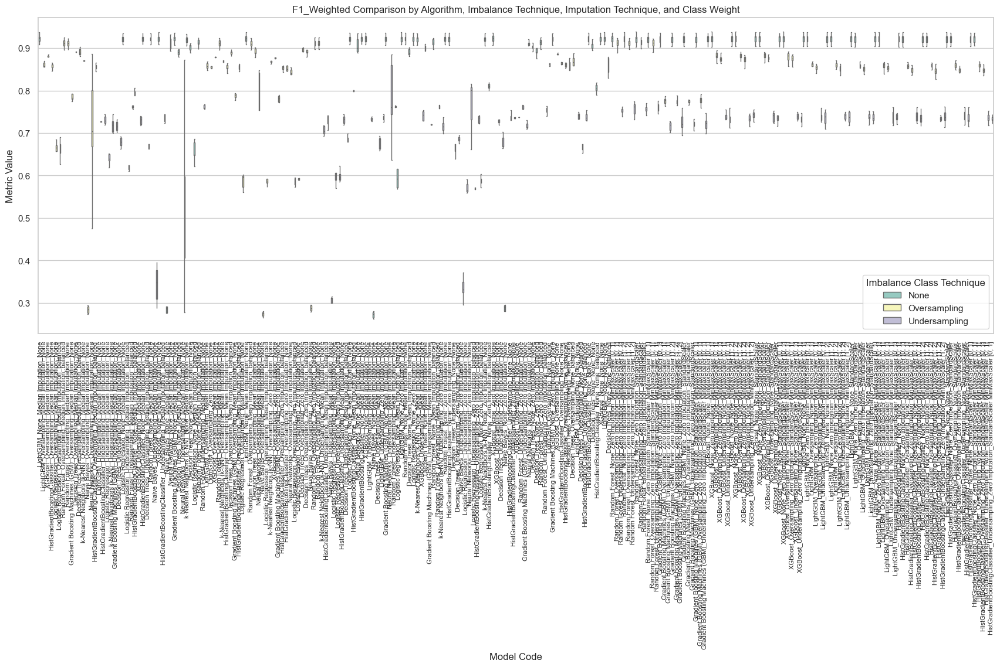

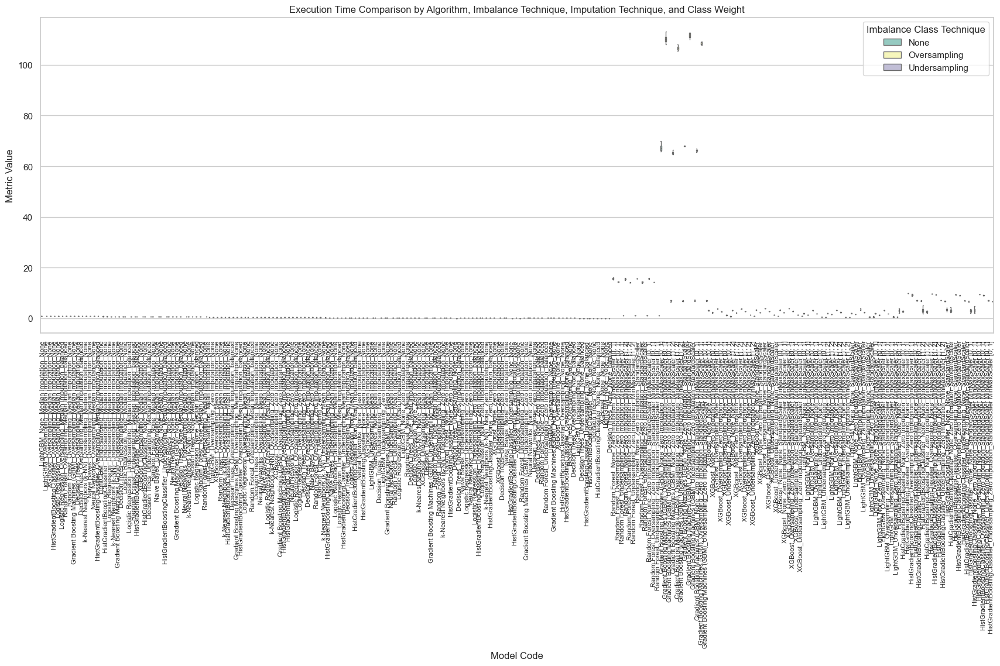

In [163]:
import seaborn as sns
import matplotlib.pyplot as plt

# Extract relevant data for plotting
data_to_plot_concat = df_results_final_concat[['Algorithm', 'Imbalance Class Technique', 'Imputation Technique', 'AUC_ROC', 'AUC_PRC', 'Gini', 'KS', 'Balanced_Accuracy', 'F1_Weighted', 'Model Unique Code', 'Execution Time']]

# Extract fold number from 'Model Unique Code'
data_to_plot_concat['Fold'] = data_to_plot_concat['Model Unique Code'].str.extract(r'fold_(\d+)').astype(int)
# Exclude the text _fold_ and the fold number from 'Model Unique Code'
data_to_plot_concat['Model Code'] = data_to_plot_concat['Model Unique Code'].str.extract(r'^(.*?)_fold_\d+').astype(str)

# Melt the dataframe to long format for easier plotting
melted_data_concat = pd.melt(data_to_plot_concat, id_vars=['Model Code', 'Imbalance Class Technique', 'Imputation Technique', 'Model Unique Code', 'Fold'],
                      value_vars=['AUC_ROC', 'AUC_PRC', 'KS', 'Balanced_Accuracy', 'F1_Weighted', 'Execution Time'],
                      var_name='Metrics', value_name='Metric Value')

# Create separate boxplots for each metric
metrics = melted_data_concat['Metrics'].unique()

for metric in metrics:
    plt.figure(figsize=(21, 7))
    sns.set(style='whitegrid')
    sns.boxplot(x='Model Code', y='Metric Value', hue='Imbalance Class Technique',
                data=melted_data_concat[melted_data_concat['Metrics'] == metric], palette='Set3', showfliers=False, dodge=True)
    plt.title(f'{metric} Comparison by Algorithm, Imbalance Technique, Imputation Technique, and Class Weight')
    plt.xlabel('Model Code')
    plt.ylabel('Metric Value')
    plt.xticks(rotation=90, fontsize=8)
    plt.legend(title='Imbalance Class Technique')
    plt.show()

In [165]:
import plotly.express as px

# Create a function to generate boxplots for each metric
def plot_metric_boxplots(data, metric):
    fig = px.box(data, x='Model Code', y='Metric Value', color='Imbalance Class Technique',
                 category_orders={'Imbalance Class Technique': ['None', 'Over-sampling', 'Under-sampling']},
                 points=False,
                 title=f'{metric} Comparison by Algorithm, Imbalance Technique, Imputation Technique, Class Weight and Normalization',
                 labels={'Metric Value': metric, 'Model Code': 'Model Code'},
                 width=1200, height=600)

    # Customize the layout

    fig.update_layout(xaxis=dict(tickangle=90, showticklabels=False), legend_title_text='Imbalance Class Technique')
    #fig.update_layout(xaxis=dict(tickangle=90), legend_title_text='Imbalance Class Technique')
    
    # Save the HTML file
    fig.write_html(f'MoDelEvaluation_{metric}_boxplot.html')
    # Show the plot
    fig.show()

# Melt the dataframe to long format for easier plotting
melted_data_concat = pd.melt(data_to_plot_concat, id_vars=['Model Code', 'Imbalance Class Technique', 'Imputation Technique', 'Model Unique Code', 'Fold'],
                      value_vars=['AUC_ROC', 'AUC_PRC', 'KS', 'Balanced_Accuracy', 'F1_Weighted', 'Execution Time'],
                      var_name='Metrics', value_name='Metric Value')


# Create boxplots for each metric
for metric in melted_data_concat['Metrics'].unique():
    # Filter relevant columns for hover_data
    relevant_columns = ['Model Code', 'Imbalance Class Technique', 'Imputation Technique', 'Model Unique Code', 'Fold', 'Metrics', 'Metric Value']
    plot_metric_boxplots(melted_data_concat[melted_data_concat['Metrics'] == metric][relevant_columns], metric)

In [167]:
data_to_plot_concat.columns

Index(['Algorithm', 'Imbalance Class Technique', 'Imputation Technique',
       'AUC_ROC', 'AUC_PRC', 'Gini', 'KS', 'Balanced_Accuracy', 'F1_Weighted',
       'Model Unique Code', 'Execution Time', 'Fold', 'Model Code'],
      dtype='object')

In [172]:
# Sort the dataframe based on AUC_ROC, KS, and Balanced Accuracy
sorted_data_concat_AUC = data_to_plot_concat.sort_values(by='AUC_ROC', ascending=False)
sorted_data_concat_KS = data_to_plot_concat.sort_values(by='KS', ascending=False)
sorted_data_concat_BA = data_to_plot_concat.sort_values(by='Balanced_Accuracy', ascending=False)

# Select the top 30 models
top_30_models_AUC = sorted_data_concat_AUC.head(30)
top_30_models_KS = sorted_data_concat_KS.head(30)
top_30_models_BA = sorted_data_concat_BA.head(30)

# Print the list of each metric for the top 30 models
print("Top 30 Models based on AUC_ROC:")
display(top_30_models_AUC[['Model Code', 'AUC_ROC']])

print("\nTop 30 Models based on KS:")
display(top_30_models_KS[['Model Code', 'KS']])

print("\nTop 30 Models based on Balanced Accuracy:")
display(top_30_models_BA[['Model Code', 'Balanced_Accuracy']])

# Find the intersection of Model Codes from the three lists
intersection_model_codes = set(top_30_models_AUC['Model Code']).intersection(top_30_models_KS['Model Code'], top_30_models_BA['Model Code'])

# Print the intersection
print("\nIntersection of Model Codes:")
print(intersection_model_codes)

# Filter the DataFrame based on Model Codes in the intersection
best_10_models = data_to_plot_concat[data_to_plot_concat['Model Code'].isin(intersection_model_codes)]

# Display the filtered DataFrame soted by KS
best_10_models = best_10_models.sort_values(by='KS', ascending=False)
display(best_10_models)



Top 30 Models based on AUC_ROC:


,Model Code,AUC_ROC
549,"LightGBM_None_None_MinMaxScaler [1, 2]",0.770786
859,HistGradientBoostingClassifier_None_Zero Imputation_StandardScaler,0.767262
739,"HistGradientBoostingClassifier_None_Zero Imputation_MinMaxScaler [0, 1]",0.759383
949,"HistGradientBoostingClassifier_Undersampling_None_StandardScaler MinMaxScaler [0, 1]",0.756073
902,"HistGradientBoostingClassifier_None_None_StandardScaler MinMaxScaler [0, 1]",0.755134
909,"HistGradientBoostingClassifier_None_None_StandardScaler MinMaxScaler [0, 1]",0.754663
559,"LightGBM_None_Zero Imputation_MinMaxScaler [1, 2]",0.753884
469,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]",0.752801
789,"HistGradientBoostingClassifier_None_None_MinMaxScaler [1, 2]",0.752763
319,"XGBoost_None_Zero Imputation_MinMaxScaler [1, 2]",0.750398



Top 30 Models based on KS:


,Model Code,KS
359,"XGBoost_Undersampling_Zero Imputation_MinMaxScaler [1, 2]",0.441212
549,"LightGBM_None_None_MinMaxScaler [1, 2]",0.437411
762,"HistGradientBoostingClassifier_Undersampling_None_MinMaxScaler [0, 1]",0.436010
918,"HistGradientBoostingClassifier_None_Zero Imputation_StandardScaler MinMaxScaler [0, 1]",0.430771
559,"LightGBM_None_Zero Imputation_MinMaxScaler [1, 2]",0.430131
902,"HistGradientBoostingClassifier_None_None_StandardScaler MinMaxScaler [0, 1]",0.427271
462,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]",0.425804
81,Random Forest_Undersampling_Zero Imputation_StandardScaler,0.421523
859,HistGradientBoostingClassifier_None_Zero Imputation_StandardScaler,0.421269
949,"HistGradientBoostingClassifier_Undersampling_None_StandardScaler MinMaxScaler [0, 1]",0.419003



Top 30 Models based on Balanced Accuracy:


,Model Code,Balanced_Accuracy
81,Random Forest_Undersampling_Zero Imputation_StandardScaler,0.704494
111,"Random Forest_Undersampling_Zero Imputation_StandardScaler MinMaxScaler [0, 1]",0.703203
762,"HistGradientBoostingClassifier_Undersampling_None_MinMaxScaler [0, 1]",0.699303
469,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]",0.697606
462,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]",0.697500
598,"LightGBM_Undersampling_Zero Imputation_MinMaxScaler [1, 2]",0.696131
359,"XGBoost_Undersampling_Zero Imputation_MinMaxScaler [1, 2]",0.695648
949,"HistGradientBoostingClassifier_Undersampling_None_StandardScaler MinMaxScaler [0, 1]",0.694821
761,"HistGradientBoostingClassifier_Undersampling_None_MinMaxScaler [0, 1]",0.691281
419,XGBoost_Undersampling_Zero Imputation_StandardScaler,0.690951



Intersection of Model Codes:
{'XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]', 'Random Forest_Undersampling_Zero Imputation_StandardScaler', 'Gradient Boosting Machines (GBM)_Oversampling_Zero Imputation_MinMaxScaler [0, 1]', 'Gradient Boosting Machines (GBM)_Oversampling_Zero Imputation_MinMaxScaler [1, 2]', 'HistGradientBoostingClassifier_Undersampling_None_StandardScaler MinMaxScaler [0, 1]'}


,Algorithm,Imbalance Class Technique,Imputation Technique,AUC_ROC,AUC_PRC,Gini,KS,Balanced_Accuracy,F1_Weighted,Model Unique Code,Execution Time,Fold,Model Code
462,XGBoost,Undersampling,None,0.746740,0.110602,0.493481,0.425804,0.697500,0.750138,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]_fold_2",1.39,2,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]"
81,Random Forest,Undersampling,Zero Imputation,0.747470,0.150728,0.494941,0.421523,0.704494,0.751141,Random Forest_Undersampling_Zero Imputation_StandardScaler_fold_1,1.12,1,Random Forest_Undersampling_Zero Imputation_StandardScaler
949,HistGradientBoostingClassifier,Undersampling,None,0.756073,0.149272,0.512146,0.419003,0.694821,0.753011,"HistGradientBoostingClassifier_Undersampling_None_StandardScaler MinMaxScaler [0, 1]_fold_9",7.00,9,"HistGradientBoostingClassifier_Undersampling_None_StandardScaler MinMaxScaler [0, 1]"
82,Random Forest,Undersampling,Zero Imputation,0.725961,0.101703,0.451921,0.417003,0.686010,0.767554,Random Forest_Undersampling_Zero Imputation_StandardScaler_fold_2,1.16,2,Random Forest_Undersampling_Zero Imputation_StandardScaler
469,XGBoost,Undersampling,None,0.752801,0.124339,0.505602,0.412430,0.697606,0.771010,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]_fold_9",1.33,9,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]"
161,Gradient Boosting Machines (GBM),Oversampling,Zero Imputation,0.742927,0.151731,0.485854,0.408457,0.665503,0.777514,"Gradient Boosting Machines (GBM)_Oversampling_Zero Imputation_MinMaxScaler [1, 2]_fold_1",107.21,1,"Gradient Boosting Machines (GBM)_Oversampling_Zero Imputation_MinMaxScaler [1, 2]"
941,HistGradientBoostingClassifier,Undersampling,None,0.732549,0.131021,0.465097,0.407853,0.686071,0.730600,"HistGradientBoostingClassifier_Undersampling_None_StandardScaler MinMaxScaler [0, 1]_fold_1",7.00,1,"HistGradientBoostingClassifier_Undersampling_None_StandardScaler MinMaxScaler [0, 1]"
131,Gradient Boosting Machines (GBM),Oversampling,Zero Imputation,0.739327,0.147206,0.478654,0.405752,0.671328,0.779803,"Gradient Boosting Machines (GBM)_Oversampling_Zero Imputation_MinMaxScaler [0, 1]_fold_1",108.74,1,"Gradient Boosting Machines (GBM)_Oversampling_Zero Imputation_MinMaxScaler [0, 1]"
461,XGBoost,Undersampling,None,0.721705,0.126672,0.443409,0.401381,0.683381,0.738795,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]_fold_1",1.32,1,"XGBoost_Undersampling_None_StandardScaler MinMaxScaler [0, 1]"
139,Gradient Boosting Machines (GBM),Oversampling,Zero Imputation,0.745480,0.131182,0.490960,0.389690,0.682395,0.797704,"Gradient Boosting Machines (GBM)_Oversampling_Zero Imputation_MinMaxScaler [0, 1]_fold_9",116.13,9,"Gradient Boosting Machines (GBM)_Oversampling_Zero Imputation_MinMaxScaler [0, 1]"


In [173]:
data_to_plot_concat['Model Code'].nunique()

240

In [8]:
# Read df_results_final_3 and df_results_final_2
# df_results_final_3 = pd.read_csv('df_results_final_3.csv')
# df_results_final_2 = pd.read_csv('df_results_final_2.csv')

In [10]:
df = df_droped_001

##  12.	Ajuste de Hiperparâmetros


Grid Search Metrics:
     Class  TP  TN  FP  FN  Sensitivity_TPR  Specificity   AUC_ROC   AUC_PRC  \
0  Class 1  37   0   1   0              1.0          0.0  0.702703  0.041667   

       Gini        KS  MCC  Kappa  Accuracy  Balanced_Accuracy   F1  \
0  0.405405  0.702703  0.0    0.0  0.973684                0.5  0.0   

   F1_Weighted  Precision  Recall  
0     0.960702        0.0     0.0  

Random Search Metrics:
     Class  TP  TN  FP  FN  Sensitivity_TPR  Specificity   AUC_ROC  AUC_PRC  \
0  Class 1  36   1   1   0              1.0          0.5  0.756757     0.05   

       Gini        KS       MCC     Kappa  Accuracy  Balanced_Accuracy   F1  \
0  0.513514  0.756757 -0.027027 -0.027027  0.947368           0.486486  0.0   

   F1_Weighted  Precision  Recall  
0     0.947368        0.0     0.0  

Bayesian Search Metrics:
     Class  TP  TN  FP  FN  Sensitivity_TPR  Specificity   AUC_ROC  AUC_PRC  \
0  Class 1  36   1   1   0              1.0          0.5  0.756757     0.05   

    

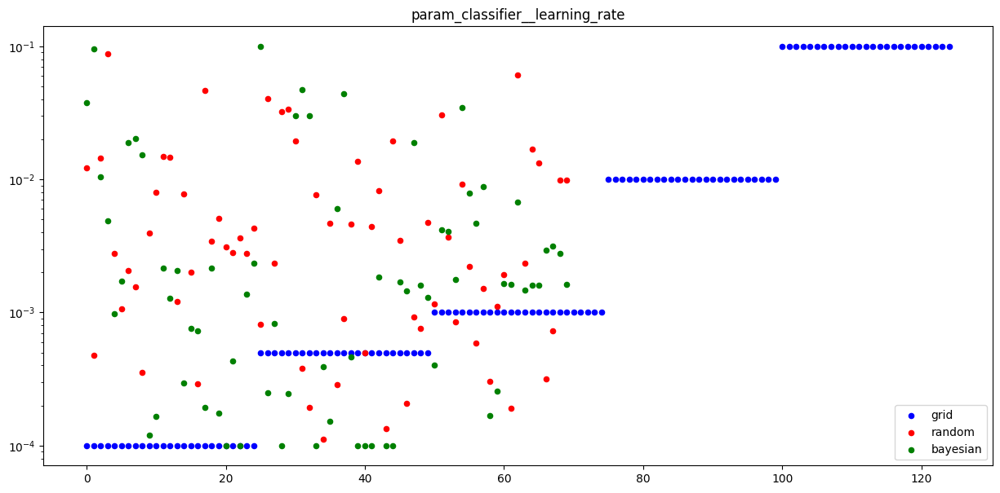

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from scipy.stats import loguniform, randint
from skopt import BayesSearchCV
from sklearn.pipeline import Pipeline
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
from xgboost import XGBClassifier
np.int = int

# Define the dataframe 'df', features, and target
# 'label' is the target column
features =  df.iloc[:, 1:-1]
target = df['label']
# Sample features and target to .01% of the original size
features = features.sample(frac=0.01, random_state=42)
target = target.sample(frac=0.01, random_state=42)


X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

# Create a pipeline with a classifier and two scalers (StandardScaler and MinMaxScaler [0, 1])
pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('minmax_scaler', MinMaxScaler((0, 1))),
    ('classifier', XGBClassifier())
])

# Grid Search
param_grid = {
    "classifier__learning_rate": [0.0001, 0.0005, 0.001, 0.01, 0.1],
    "classifier__n_estimators": [100, 300, 600, 800, 1000],
    "classifier__max_depth": [4, 20, 100, 250, 400]
}

reg_grid = GridSearchCV(pipe,
                        param_grid=param_grid,
                        cv=5,
                        n_jobs=8,
                        scoring='roc_auc'
                        )

model_grid = reg_grid.fit(X_train, y_train)

# Random Search
n_iter = 70

param_rand = {
    "classifier__learning_rate": loguniform(1e-4, 0.1),
    "classifier__n_estimators": randint(100, 1000),
    "classifier__max_depth": randint(4, 400)
}

reg_rand = RandomizedSearchCV(pipe,
                               param_distributions=param_rand,
                               n_iter=n_iter,
                               cv=5,
                               n_jobs=8,
                               scoring='roc_auc',
                               random_state=123)

model_rand = reg_rand.fit(X_train, y_train)

# Bayesian Search
n_iter = 70

param_bay = {
    "classifier__learning_rate": (0.0001, 0.1, "log-uniform"),
    "classifier__n_estimators": (100, 1000),
    "classifier__max_depth": (4, 400)
}

reg_bay = BayesSearchCV(estimator=pipe,
                        search_spaces=param_bay,
                        n_iter=n_iter,
                        cv=5,
                        n_jobs=8,
                        scoring='roc_auc',
                        random_state=123)


model_bay = reg_bay.fit(X_train, y_train)

# Evaluation Metrics
def evaluate_model(model, X_test, y_test):
    y_pred_prob = model.predict_proba(X_test)[:, 1]
    metrics_df = calculate_classification_metrics_one_class(y_test, y_pred_prob)
    return metrics_df

# Evaluate models on the test set
metrics_grid = evaluate_model(model_grid, X_test, y_test)
metrics_rand = evaluate_model(model_rand, X_test, y_test)
metrics_bay = evaluate_model(model_bay, X_test, y_test)

# Print the results
print("Grid Search Metrics:")
print(metrics_grid)

print("\nRandom Search Metrics:")
print(metrics_rand)

print("\nBayesian Search Metrics:")
print(metrics_bay)

# Extract the parameter of interest for comparison
param = 'param_classifier__learning_rate'
grid = model_grid.cv_results_[param]
rand = model_rand.cv_results_[param]
bay = model_bay.cv_results_[param]

# Plot the comparison
fig = plt.figure(figsize=(15, 7))
ax = plt.gca()
ax.scatter(np.arange(len(grid)), grid, c='g', s=20, label='grid');
ax.scatter(np.arange(len(rand)), rand, c='r', s=20, label='random');
ax.scatter(np.arange(len(bay)), bay, c='b', s=20, label='bayesian');
ax.set_yscale('log')

plt.legend()
plt.title(param)
plt.show()


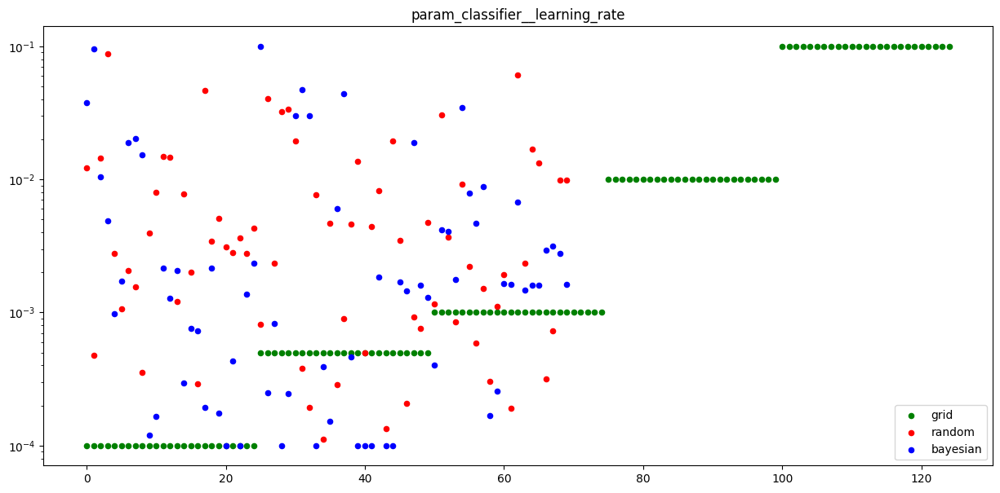

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from scipy.stats import loguniform, randint
from skopt import BayesSearchCV
from sklearn.pipeline import Pipeline
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
from xgboost import XGBClassifier
np.int = int



# Grid Search
param_grid = {
    "classifier__learning_rate": [0.0001, 0.0005, 0.001, 0.01, 0.1],
    "classifier__n_estimators": [100, 300, 600, 800, 1000],
    "classifier__max_depth": [4, 20, 100, 250, 400]
}

reg_grid = GridSearchCV(pipe,
                        param_grid=param_grid,
                        cv=5,
                        n_jobs=8,
                        scoring='roc_auc'
                        )

model_grid = reg_grid.fit(X_train, y_train)

# Random Search
n_iter = 70

param_rand = {
    "classifier__learning_rate": loguniform(1e-4, 0.1),
    "classifier__n_estimators": randint(100, 1000),
    "classifier__max_depth": randint(4, 400)
}

reg_rand = RandomizedSearchCV(pipe,
                               param_distributions=param_rand,
                               n_iter=n_iter,
                               cv=5,
                               n_jobs=8,
                               scoring='roc_auc',
                               random_state=123)

model_rand = reg_rand.fit(X_train, y_train)

# Bayesian Search
n_iter = 70

param_bay = {
    "classifier__learning_rate": (0.0001, 0.1, "log-uniform"),
    "classifier__n_estimators": (100, 1000),
    "classifier__max_depth": (4, 400)
}

reg_bay = BayesSearchCV(estimator=pipe,
                        search_spaces=param_bay,
                        n_iter=n_iter,
                        cv=5,
                        n_jobs=8,
                        scoring='roc_auc',
                        random_state=123)

model_bay = reg_bay.fit(X_train, y_train)

# Extract the parameter of interest for comparison
param = 'param_classifier__learning_rate'
grid = model_grid.cv_results_[param]
rand = model_rand.cv_results_[param]
bay = model_bay.cv_results_[param]

# Plot the comparison
fig = plt.figure(figsize=(15, 7))
ax = plt.gca()
ax.scatter(np.arange(len(grid)), grid, c='g', s=20, label='grid');
ax.scatter(np.arange(len(rand)), rand, c='r', s=20, label='random');
ax.scatter(np.arange(len(bay)), bay, c='b', s=20, label='bayesian');
ax.set_yscale('log')

plt.legend()
plt.title(param)
plt.show()


[I 2024-01-07 20:22:01,493] A new study created in memory with name: no-name-b4d09e12-9b4c-4355-84be-95a9e4a63b55
[I 2024-01-07 20:22:02,190] Trial 0 finished with value: 0.6486486486486487 and parameters: {'learning_rate': 0.025965778968787823, 'n_estimators': 654, 'max_depth': 13}. Best is trial 0 with value: 0.6486486486486487.
[I 2024-01-07 20:22:03,449] Trial 1 finished with value: 0.6486486486486487 and parameters: {'learning_rate': 0.000671343015223328, 'n_estimators': 620, 'max_depth': 246}. Best is trial 0 with value: 0.6486486486486487.
[I 2024-01-07 20:22:05,636] Trial 2 finished with value: 0.7567567567567568 and parameters: {'learning_rate': 0.0003351676721857623, 'n_estimators': 725, 'max_depth': 54}. Best is trial 2 with value: 0.7567567567567568.
[I 2024-01-07 20:22:06,825] Trial 3 finished with value: 0.7567567567567568 and parameters: {'learning_rate': 0.004892589507419087, 'n_estimators': 536, 'max_depth': 207}. Best is trial 2 with value: 0.7567567567567568.
[I 2024

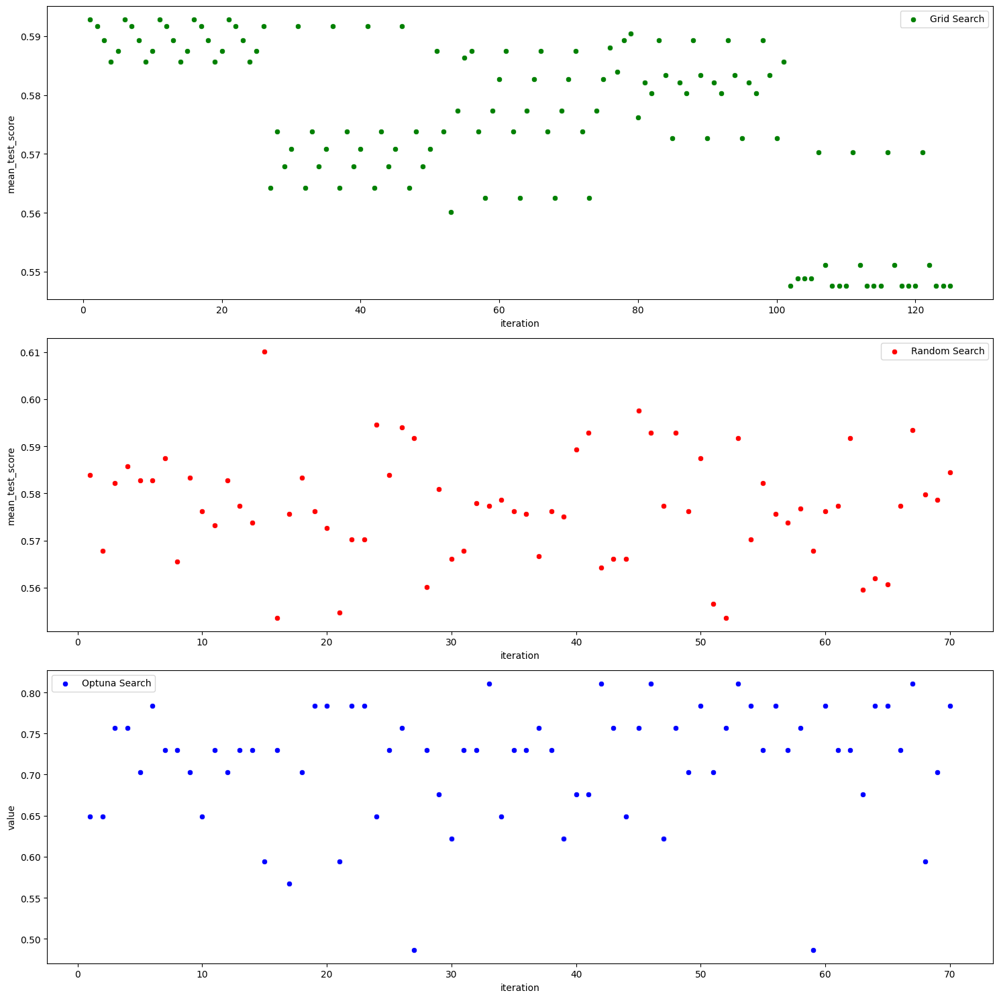

In [68]:
# Using XGBoost. Hyperparameters are tuned using Bayesian Search, grid search, and random search
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, balanced_accuracy_score, roc_curve, auc
from xgboost import XGBClassifier
import optuna

# Define the dataframe 'df', features, and target
# 'label' is the target column
features = df.iloc[:, 1:-1]
target = df['label']
# Sample features and target to .01% of the original size
features = features.sample(frac=0.01, random_state=42)
target = target.sample(frac=0.01, random_state=42)

X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

# Create a pipeline with a classifier and two scalers (StandardScaler and MinMaxScaler [0, 1])
pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('minmax_scaler', MinMaxScaler((0, 1))),
    ('classifier', XGBClassifier())
])

# Grid Search
param_grid = {
    "classifier__learning_rate": [0.0001, 0.0005, 0.001, 0.01, 0.1],
    "classifier__n_estimators": [100, 300, 600, 800, 1000],
    "classifier__max_depth": [4, 20, 100, 250, 400]
}

reg_grid = GridSearchCV(pipe,
                        param_grid=param_grid,
                        cv=5,
                        n_jobs=8,
                        scoring='roc_auc'
                        )

model_grid = reg_grid.fit(X_train, y_train)

# Random Search
n_iter_rand = 70

param_rand = {
    "classifier__learning_rate": np.logspace(-4, -1, num=1000),
    "classifier__n_estimators": np.random.randint(100, 1000, size=n_iter_rand),
    "classifier__max_depth": np.random.randint(4, 400, size=n_iter_rand)
}

reg_rand = RandomizedSearchCV(pipe,
                               param_distributions=param_rand,
                               n_iter=n_iter_rand,
                               cv=5,
                               n_jobs=8,
                               scoring='roc_auc',
                               random_state=123)

model_rand = reg_rand.fit(X_train, y_train)

# Optuna Search
n_iter_optuna = 70

def objective(trial):
    params = {
        "learning_rate": trial.suggest_loguniform("learning_rate", 1e-4, 0.1),
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000),
        "max_depth": trial.suggest_int("max_depth", 4, 400)
    }

    # Set the classifier parameters in the pipeline
    pipe.set_params(classifier__learning_rate=params["learning_rate"],
                   classifier__n_estimators=params["n_estimators"],
                   classifier__max_depth=params["max_depth"])

    # Fit the model and calculate ROC-AUC
    model = pipe.fit(X_train, y_train)
    y_pred_prob = model.predict_proba(X_test)[:, 1]
    roc_auc = roc_auc_score(y_test, y_pred_prob)
    
    return roc_auc

study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=n_iter_optuna)

# Extract results from studies
results_grid = pd.DataFrame(model_grid.cv_results_)
results_grid['iteration'] = range(1, len(results_grid) + 1)  # Add iteration column

results_rand = pd.DataFrame(model_rand.cv_results_)
results_rand['iteration'] = range(1, len(results_rand) + 1)  # Add iteration column

results_optuna = study.trials_dataframe()
results_optuna['iteration'] = range(1, len(results_optuna) + 1) 

# Get the best parameters from each optimization
best_params_grid = model_grid.best_params_
best_params_rand = model_rand.best_params_
best_params_optuna = study.best_params

# Update the pipeline with the best parameters
pipe.set_params(classifier__learning_rate=best_params_optuna["learning_rate"],
                classifier__n_estimators=best_params_optuna["n_estimators"],
                classifier__max_depth=best_params_optuna["max_depth"])

# Fit the final model
final_model_optuna = pipe.fit(X_train, y_train)

# Evaluation Metrics
def evaluate_model(model, X_test, y_test):
    y_pred_prob = model.predict_proba(X_test)[:, 1]
    roc_auc = roc_auc_score(y_test, y_pred_prob)
    balanced_acc = balanced_accuracy_score(y_test, (y_pred_prob >= 0.5).astype(int))
    fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
    ks = np.max(tpr - fpr)
    return roc_auc, balanced_acc, ks

# Evaluate models on the test set
roc_auc_grid, balanced_acc_grid, ks_grid = evaluate_model(model_grid, X_test, y_test)
roc_auc_rand, balanced_acc_rand, ks_rand = evaluate_model(model_rand, X_test, y_test)
roc_auc_optuna, balanced_acc_optuna, ks_optuna = evaluate_model(final_model_optuna, X_test, y_test)


# Scatter plot for Balanced Accuracy
fig, axes = plt.subplots(3, 1, figsize=(15, 15))

# Grid Search
sns.scatterplot(data=results_grid, x='iteration', y='mean_test_score', label='Grid Search', color='green', ax=axes[0])

# Random Search
sns.scatterplot(data=results_rand, x='iteration', y='mean_test_score', label='Random Search', color='red', ax=axes[1])

# Optuna Search
sns.scatterplot(data=results_optuna, x='iteration', y='value', label='Optuna Search', color='blue', ax=axes[2])

plt.tight_layout()
plt.legend()
plt.show()





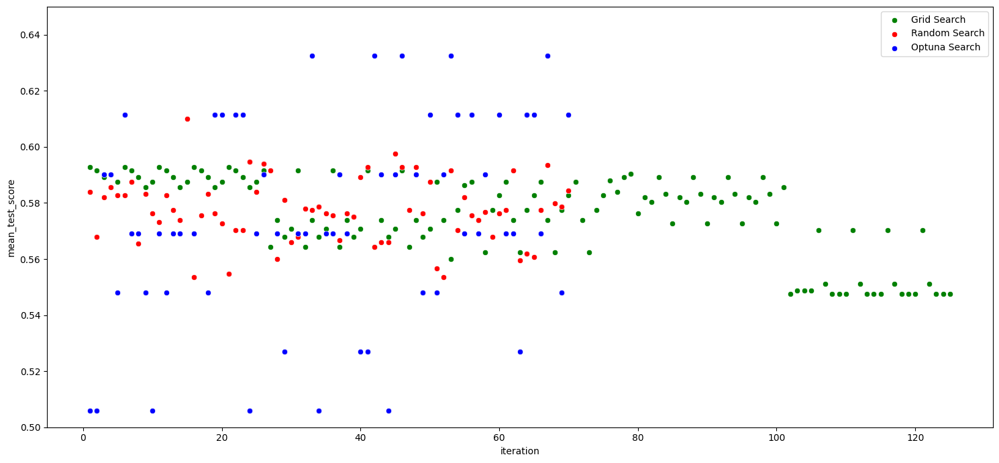

In [76]:
# Plot the comparison using scatter plots
# Determine fig size
fig = plt.figure(figsize=(15, 7))

# Grid Search
sns.scatterplot(data=results_grid, x='iteration', y='mean_test_score', label='Grid Search', color='green')
# Random Search
sns.scatterplot(data=results_rand, x='iteration', y='mean_test_score', label='Random Search', color='red')
# Optuna Search
sns.scatterplot(data=results_optuna, x='iteration', y='value', label='Optuna Search', color='blue')

# Set y scale between 0.5 and 0.7
plt.ylim(0.5, 0.65)

plt.tight_layout()
plt.legend()
plt.show()

In [ ]:
###################### Using XGBoost. Hyperparameters are tuned using Bayesian Search, grid search, and random search
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, balanced_accuracy_score, roc_curve, auc
from xgboost import XGBClassifier
import optuna

# Define the dataframe 'df', features, and target
# 'label' is the target column
features = df.iloc[:, 1:-1]
target = df['label']
# Sample features and target to .01% of the original size
#features = features.sample(frac=1, random_state=42)
#target = target.sample(frac=1, random_state=42)

X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

# Create a pipeline with a classifier and two scalers (StandardScaler and MinMaxScaler [0, 1])
pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('minmax_scaler', MinMaxScaler((0, 1))),
    ('classifier', XGBClassifier())
])

# Grid Search
param_grid = {
    "classifier__learning_rate": [0.0001, 0.0005, 0.001, 0.01, 0.1],
    "classifier__n_estimators": [100, 300, 600, 800, 1000],
    "classifier__max_depth": [4, 20, 100, 250, 400]
}

reg_grid = GridSearchCV(pipe,
                        param_grid=param_grid,
                        cv=5,
                        n_jobs=8,
                        scoring='roc_auc'
                        )

model_grid = reg_grid.fit(X_train, y_train)

# Random Search
n_iter_rand = 70

param_rand = {
    "classifier__learning_rate": np.logspace(-4, -1, num=1000),
    "classifier__n_estimators": np.random.randint(100, 1000, size=n_iter_rand),
    "classifier__max_depth": np.random.randint(4, 400, size=n_iter_rand)
}

reg_rand = RandomizedSearchCV(pipe,
                               param_distributions=param_rand,
                               n_iter=n_iter_rand,
                               cv=5,
                               n_jobs=8,
                               scoring='roc_auc',
                               random_state=123)

model_rand = reg_rand.fit(X_train, y_train)

# Optuna Search
n_iter_optuna = 70

def objective(trial):
    params = {
        "learning_rate": trial.suggest_loguniform("learning_rate", 1e-4, 0.1),
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000),
        "max_depth": trial.suggest_int("max_depth", 4, 400)
    }

    # Set the classifier parameters in the pipeline
    pipe.set_params(classifier__learning_rate=params["learning_rate"],
                   classifier__n_estimators=params["n_estimators"],
                   classifier__max_depth=params["max_depth"])

    # Fit the model and calculate ROC-AUC
    model = pipe.fit(X_train, y_train)
    y_pred_prob = model.predict_proba(X_test)[:, 1]
    roc_auc = roc_auc_score(y_test, y_pred_prob)
    
    return roc_auc

study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=n_iter_optuna)

# Extract results from studies
results_grid = pd.DataFrame(model_grid.cv_results_)
results_grid['iteration'] = range(1, len(results_grid) + 1)  # Add iteration column

results_rand = pd.DataFrame(model_rand.cv_results_)
results_rand['iteration'] = range(1, len(results_rand) + 1)  # Add iteration column

results_optuna = study.trials_dataframe()
results_optuna['iteration'] = range(1, len(results_optuna) + 1) 

# Get the best parameters from each optimization
best_params_grid = model_grid.best_params_
best_params_rand = model_rand.best_params_
best_params_optuna = study.best_params

# Update the pipeline with the best parameters
pipe.set_params(classifier__learning_rate=best_params_optuna["learning_rate"],
                classifier__n_estimators=best_params_optuna["n_estimators"],
                classifier__max_depth=best_params_optuna["max_depth"])

# Fit the final model
final_model_optuna = pipe.fit(X_train, y_train)

# Evaluation Metrics
def evaluate_model(model, X_test, y_test):
    y_pred_prob = model.predict_proba(X_test)[:, 1]
    roc_auc = roc_auc_score(y_test, y_pred_prob)
    balanced_acc = balanced_accuracy_score(y_test, (y_pred_prob >= 0.5).astype(int))
    fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
    ks = np.max(tpr - fpr)
    return roc_auc, balanced_acc, ks

# Evaluate models on the test set
roc_auc_grid, balanced_acc_grid, ks_grid = evaluate_model(model_grid, X_test, y_test)
roc_auc_rand, balanced_acc_rand, ks_rand = evaluate_model(model_rand, X_test, y_test)
roc_auc_optuna, balanced_acc_optuna, ks_optuna = evaluate_model(final_model_optuna, X_test, y_test)


# Scatter plot for Balanced Accuracy
fig, axes = plt.subplots(3, 1, figsize=(15, 15))

# Grid Search
sns.scatterplot(data=results_grid, x='iteration', y='mean_test_score', label='Grid Search', color='green', ax=axes[0])

# Random Search
sns.scatterplot(data=results_rand, x='iteration', y='mean_test_score', label='Random Search', color='red', ax=axes[1])

# Optuna Search
sns.scatterplot(data=results_optuna, x='iteration', y='value', label='Optuna Search', color='blue', ax=axes[2])

plt.tight_layout()
plt.legend()
plt.show()


In [56]:
# Check the scoring metric used in Grid Search
print("Grid Search Scoring Metric:", reg_grid.scoring)

# Check the scoring metric used in Random Search
print("Random Search Scoring Metric:", reg_rand.scoring)

# Check the scoring metric used in Bayesian Search
print("Bayesian Search Scoring Metric:", reg_bay.scoring)


Grid Search Scoring Metric: roc_auc
Random Search Scoring Metric: roc_auc
Bayesian Search Scoring Metric: roc_auc


In [60]:
# For Grid Search
best_params_grid = model_grid.best_params_
print("Grid Search Best Hyperparameters:", best_params_grid)

# For Random Search
best_params_rand = model_rand.best_params_
print("Random Search Best Hyperparameters:", best_params_rand)

# For Optuna Search
best_params_optuna = study.best_params
print("Optuna Search Best Hyperparameters:", best_params_optuna)


Grid Search Best Hyperparameters: {'classifier__learning_rate': 0.0001, 'classifier__max_depth': 4, 'classifier__n_estimators': 100}
Random Search Best Hyperparameters: {'classifier__n_estimators': 868, 'classifier__max_depth': 326, 'classifier__learning_rate': 0.0016451905877536625}
Optuna Search Best Hyperparameters: {'learning_rate': 0.03764400391884294, 'n_estimators': 223, 'max_depth': 131}


In [65]:
study.trials_dataframe().head(20)

,number,value,datetime_start,datetime_complete,duration,params_learning_rate,params_max_depth,params_n_estimators,state
0,0,0.729730,2024-01-07 20:02:46.799686,2024-01-07 20:02:47.861923,0 days 00:00:01.062237,0.000315,5,535,COMPLETE
1,1,0.729730,2024-01-07 20:02:47.863924,2024-01-07 20:02:49.378263,0 days 00:00:01.514339,0.000198,70,516,COMPLETE
2,2,0.756757,2024-01-07 20:02:49.379263,2024-01-07 20:02:50.126430,0 days 00:00:00.747167,0.006110,125,243,COMPLETE
3,3,0.729730,2024-01-07 20:02:50.127430,2024-01-07 20:02:51.185667,0 days 00:00:01.058237,0.014404,115,901,COMPLETE
4,4,0.540541,2024-01-07 20:02:51.186667,2024-01-07 20:02:52.376935,0 days 00:00:01.190268,0.044723,46,926,COMPLETE
5,5,0.756757,2024-01-07 20:02:52.377935,2024-01-07 20:02:53.842262,0 days 00:00:01.464327,0.002101,73,681,COMPLETE
6,6,0.756757,2024-01-07 20:02:53.844263,2024-01-07 20:02:54.989519,0 days 00:00:01.145256,0.014741,81,688,COMPLETE
7,7,0.648649,2024-01-07 20:02:54.990520,2024-01-07 20:02:55.486631,0 days 00:00:00.496111,0.002174,6,232,COMPLETE
8,8,0.621622,2024-01-07 20:02:55.487631,2024-01-07 20:02:55.808703,0 days 00:00:00.321072,0.069402,69,302,COMPLETE
9,9,0.729730,2024-01-07 20:02:55.809703,2024-01-07 20:02:56.549870,0 days 00:00:00.740167,0.000399,204,367,COMPLETE


## 13.	Interpretação de Modelo

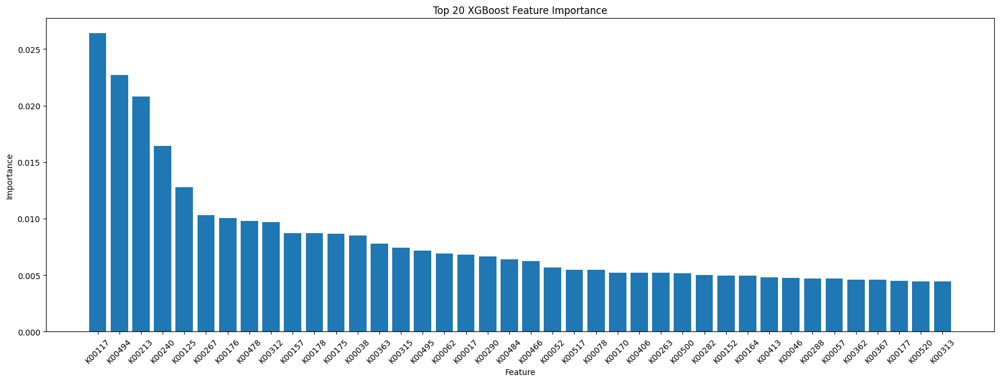

In [22]:
# Get feature importances
importances = model.feature_importances_

# Get feature names
feature_names = X_train.columns

# Sort feature importances in descending order
indices = importances.argsort()[::-1]

# Plot the feature importances
# Plot the top 20 feature importances
top_n = 40

plt.figure(figsize=(21, 7))
plt.bar(range(top_n), importances[indices][:top_n])
plt.xticks(range(top_n), feature_names[indices][:top_n], rotation=45)
plt.xlabel('Feature')
plt.ylabel('Importance')
plt.title('Top 20 XGBoost Feature Importance')
plt.show()


## 14.  Implantação de Modelo

**Configuração do Ambiente de Produção**
Para configurar o ambiente de produção de forma eficiente, adotamos práticas específicas para garantir a estabilidade e o desempenho do modelo. Utilizamos a ferramenta pip freeze para gerar um arquivo requirements.txt, contendo as versões exatas das bibliotecas utilizadas durante o desenvolvimento. Isso previne possíveis erros e conflitos de versões, assegurando a consistência do ambiente. Além disso, optamos por armazenar o modelo em um arquivo do tipo pickle para facilitar a carga e descarga, proporcionando maior agilidade na integração do modelo no ambiente de produção. A utilização de containers, como Docker, é recomendada para garantir a robustez e reprodutibilidade do ambiente em diferentes configurações, facilitando a escalabilidade e a manutenção.

**Integração com Sistemas Existentes**
Na integração do modelo com sistemas existentes, adotamos uma abordagem prática para garantir uma implementação eficaz. Desenvolvemos interfaces customizadas para facilitar a comunicação entre o modelo e outros componentes do sistema, garantindo uma integração suave. 
Para facilitar a manutenção, utilizamos logs detalhados para monitorar a entrada e saída do modelo, permitindo uma rápida identificação de eventuais problemas. Essa abordagem prática visa minimizar os impactos operacionais e otimizar a contribuição do modelo no contexto mais amplo do ambiente de produção. 
Optamos por integrar o aplicativo Streamlit com o pipeline de produção. Essa integração visa assegurar que os dados do usuário sejam processados de maneira eficiente e que as previsões sejam geradas em tempo real. O uso do Streamlit proporciona uma interface amigável e interativa para os usuários, tornando a experiência mais acessível e facilitando o acesso às funcionalidades do modelo.
Essa abordagem de integração permite uma transição suave do modelo do ambiente de desenvolvimento para um ambiente de produção, garantindo que o modelo treinado seja facilmente acessível e capaz de fornecer previsões em tempo real conforme necessário.


In [ ]:
Configuração do Ambiente de Produção
Para configurar o ambiente de produção de forma eficiente, adotamos práticas específicas para garantir a estabilidade e o desempenho do modelo. Utilizamos a ferramenta pip freeze para gerar um arquivo requirements.txt, contendo as versões exatas das bibliotecas utilizadas durante o desenvolvimento. Isso previne possíveis erros e conflitos de versões, assegurando a consistência do ambiente. Além disso, optamos por armazenar o modelo em um arquivo do tipo pickle para facilitar a carga e descarga, proporcionando maior agilidade na integração do modelo no ambiente de produção. A utilização de containers, como Docker, é recomendada para garantir a robustez e reprodutibilidade do ambiente em diferentes configurações, facilitando a escalabilidade e a manutenção.

Integração com Sistemas Existentes:
Na integração do modelo com sistemas existentes, adotamos uma abordagem prática para garantir uma implementação eficaz. Desenvolvemos interfaces customizadas para facilitar a comunicação entre o modelo e outros componentes do sistema, garantindo uma integração suave. 
Para facilitar a manutenção, utilizamos logs detalhados para monitorar a entrada e saída do modelo, permitindo uma rápida identificação de eventuais problemas. Essa abordagem prática visa minimizar os impactos operacionais e otimizar a contribuição do modelo no contexto mais amplo do ambiente de produção. 
Optamos por integrar o aplicativo Streamlit com o pipeline de produção. Essa integração visa assegurar que os dados do usuário sejam processados de maneira eficiente e que as previsões sejam geradas em tempo real. O uso do Streamlit proporciona uma interface amigável e interativa para os usuários, tornando a experiência mais acessível e facilitando o acesso às funcionalidades do modelo.
Essa abordagem de integração permite uma transição suave do modelo do ambiente de desenvolvimento para um ambiente de produção, garantindo que o modelo treinado seja facilmente acessível e capaz de fornecer previsões em tempo real conforme necessário.


## 15.	Monitoramento e Manutenção de Modelo

* A manutenção e monitoramento contínuo do modelo são aspectos críticos para garantir sua eficácia ao longo do tempo. Mesmo que o modelo ainda não tenha sido oficialmente implantado em produção, é fundamental antecipar práticas que garantam a robustez e relevância contínua. Aqui estão algumas sugestões teóricas para proceder:
1. Verificação de Data Drift.
2. Suposições e Mudanças de Comportamento.
3. Manutenção Proativa.
4. Documentação e Comunicação.
5. Estabilidade em função do tempo. (Importante e prático)

* Continuous model maintenance and monitoring are critical aspects to ensure its effectiveness over time. Even though the model has not yet been officially deployed in production, it is essential to anticipate practices that guarantee robustness and continuous relevance. Here are some theoretical suggestions to proceed:
1. Data Drift Verification.
2. Assumptions and Behavior Changes.
3. Proactive Maintenance.
4. Documentation and Communication.
5. Stability over time. (Important and practical)



## Considerações Finais
Finalmente, é relevante ressaltar que o processo de modelagem é intrinsecamente complexo e não segue uma sequência rígida de etapas. Em vez disso, envolve a formulação e teste contínuo de hipóteses, ajustes e refinamentos iterativos. Esse ciclo de melhoria contínua é uma parte essencial do acompanhamento do modelo ao longo de sua vida útil, visando garantir não apenas a confiabilidade, mas também a otimização contínua dos resultados enquanto o modelo está em produção. A flexibilidade para se adaptar a novos dados, condições de mercado e requisitos de negócios é fundamental para a eficácia a longo prazo do modelo de risco de crédito.    

In [ ]:
!jupyter nbconvert --to html --template=classic TCC_MBA_GabrielScatena.ipynb

Traceback (most recent call last):
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "C:\Users\GabrielScatena\AppData\Local\Programs\Python\Python312\Scripts\jupyter-nbconvert.EXE\__main__.py", line 4, in <module>
  File "c:\Users\GabrielScatena\AppData\Local\Programs\Python\Python312\Lib\site-packages\nbconvert\nbconvertapp.py", line 187, in <module>
    class NbConvertApp(JupyterApp):
  File "c:\Users\GabrielScatena\AppData\Local\Programs\Python\Python312\Lib\site-packages\nbconvert\nbconvertapp.py", line 246, in NbConvertApp
    Options include {get_export_names()}.
                     ^^^^^^^^^^^^^^^^^^
  File "c:\Users\GabrielScatena\AppData\Local\Programs\Python\Python312\Lib\site-packages\nbconvert\exporters\base.py", line 151, in get_export_names
    e = get_exporter(exporter_name)(config=config)
        ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\GabrielScatena\AppData\Local\Programs\Python\Python312\Lib\site-pack

In [5]:
df = pd.read_csv(r'C:\Temp\Codes\df_droped_001.csv')

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import KFold
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTEENN, SMOTETomek
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve, auc, make_scorer
from sklearn.impute import SimpleImputer
from sklearn.experimental import enable_hist_gradient_boosting  
from sklearn.ensemble import HistGradientBoostingClassifier
#from catboost import CatBoostClassifier

import os
import json 

# Define the dataframe 'df', features, and target
# 'label' is the target column
features = df.columns[1:479]
target = df['label']

# Define the hyperparameters for each model
hyperparameters = {
    'Logistic Regression': {'C': [0.1, 1, 10]},
    'k-Nearest Neighbors (k-NN)': {'n_neighbors': [3, 5, 7]},
    'Support Vector Machines (SVM)': {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']},
    'Neural Networks': {'hidden_layer_sizes': [(50,), (100,), (50, 50)]},
    'Naive Bayes': {},
    'Decision Trees': {'max_depth': [None, 10, 20]},
    'Random Forest': {'n_estimators': [50, 100, 200]},
    'Gradient Boosting Machines (GBM)': {'n_estimators': [50, 100, 200]},
    'XGBoost': {'class_weight=': [None, 'balanced'], 'n_estimators': [50, 100, 200]},
    'LightGBM': {'n_estimators': [50, 100, 200]},
    'CatBoost': {'iterations': [50, 100, 200], 'learning_rate': [0.01, 0.1, 0.2]},
    'HistGradientBoostingClassifier': {'class_weight=': ['balanced', [None]], 'max_iter': [50, 100, 200], 'learning_rate': [0.01, 0.1, 0.2]}
}

# Define the imbalanced data handling techniques
sampling_techniques = {
    'None': None,
    'Oversampling': RandomOverSampler(),
    'Undersampling': RandomUnderSampler(),
    #'Hybrid Sampling (SMOTEENN)': SMOTEENN(), #Does not accept NaN values
    #'Hybrid Sampling (SMOTETomek)': SMOTETomek()
}

# Define the imputation techniques
imputation_techniques = {
    #'XGBoost': None,
    'None': None,
    'Zero Imputation': SimpleImputer(strategy='constant', fill_value=0),
    #'Mean Imputation': SimpleImputer(strategy='mean'),
    #'Median Imputation': SimpleImputer(strategy='median')
}

# Define a function to calculate KS and Gini
# def calculate_ks_gini(y_true, y_prob):
#     fpr, tpr, thresholds = roc_curve(y_true, y_prob)
#     ks = np.max(tpr - fpr)
#     gini = 2 * auc(fpr, tpr) - 1
#     return ks, gini

# Create a list to store the results
results_2 = []

# Define k-fold cross-validation
k_fold = KFold(n_splits=5, shuffle=True, random_state=42)

# Iterate through each model
for model_name, model in [
    # ('Logistic Regression', LogisticRegression()),
     ('k-Nearest Neighbors (k-NN)', KNeighborsClassifier()),
    # ('Support Vector Machines (SVM)', SVC(probability=True)),
    # ('Neural Networks', MLPClassifier()),
    # ('Naive Bayes', GaussianNB()),
    # ('Decision Trees', DecisionTreeClassifier()),
    # ('Random Forest', RandomForestClassifier()),
    # ('Gradient Boosting Machines (GBM)', GradientBoostingClassifier()),
     ('XGBoost', XGBClassifier()),
    # ('LightGBM', LGBMClassifier()),
    # ('CatBoost', CatBoostClassifier()),
    # ('HistGradientBoostingClassifier', HistGradientBoostingClassifier())
    


]:
    # Iterate through each imbalanced data handling technique
    for sampling_name, sampling_technique in sampling_techniques.items():
        # Iterate through each imputation technique
        for imputation_name, imputation_technique in imputation_techniques.items():
            # Create a new dataframe to store the results for this model, technique combination
            df_result_2 = pd.DataFrame(columns=['Algorithm', 'Metrics', 'Hyperparameters', 'Imputation Technique', 'Imbalance Class Technique', 'Model Unique Code'])
        

            # Perform k-fold cross-validation
            for fold, (train_index, test_index) in enumerate(k_fold.split(df[features], target)):
                X_train, X_test = df[features].iloc[train_index], df[features].iloc[test_index]
                y_train, y_test = target.iloc[train_index], target.iloc[test_index]

                # Apply imputation technique on the train and test sets, if imputation_name is not None
                if imputation_name is not None and imputation_technique is not None:
                    print(imputation_name)
                    X_train_imputed = imputation_technique.fit_transform(X_train)
                    X_test_imputed = imputation_technique.transform(X_test)
                else:
                    print(imputation_name)
                    if model_name in ['Decision Trees', 'Random Forest', 'Gradient Boosting Machines (GBM)', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier']:
                        X_train_imputed, X_test_imputed = X_train, X_test
                    else:
                        break

                # Apply the imbalanced data handling technique on the train set
                if sampling_technique is not None:
                    X_train_resampled, y_train_resampled = sampling_technique.fit_resample(X_train_imputed, y_train)
                else:
                    X_train_resampled, y_train_resampled = X_train_imputed, y_train


                # Train the model on the resampled train set
                model.fit(X_train_resampled, y_train_resampled)

                # Make predictions on the test set
                y_pred = model.predict(X_test_imputed)
                y_prob = model.predict_proba(X_test_imputed)[:, 1]

                # Calculate the evaluation metrics
                metrics_df = calculate_classification_metrics_one_class(y_test, y_prob)

                # Set 'Imputation Technique' based on the specified conditions
                if imputation_name in ['Decision Trees', 'Random Forest', 'Gradient Boosting Machines (GBM)', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier']:
                    imputation_name = 'None'
                else:
                    imputation_name = imputation_name

                #imputation_name = None if imputation_name not in ['Decision Trees', 'Random Forest', 'Gradient Boosting Machines (GBM)', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier'] else imputation_name


                # Create a new DataFrame for each iteration
                df_result_2 = pd.DataFrame({
                    'Algorithm': model_name,
                    'Hyperparameters': [model.get_params()],
                    'Imputation Technique': imputation_name,
                    'Imbalance Class Technique': sampling_name,
                    'Model Unique Code': f"{model_name}_{sampling_name}_{imputation_name}_fold_{fold}",
                    **metrics_df  # Unpack the metrics_df columns
                })

                # Append the result to the list
                results_2.append(df_result_2)

# Combine all the results DataFrames into one final DataFrame
df_results_final_2 = pd.concat(results_2, ignore_index=True)

# Save each model in a separate file with a name corresponding to the model unique code
for model_unique_code in df_results_final_2['Model Unique Code'].unique():
    df_model = df_results_final_2[df_results_final_2['Model Unique Code'] == model_unique_code]
    df_model.to_csv(f"{model_unique_code}_2.csv", index=False)

# Display the final DataFrame
display(df_results_final_2)

c:\Users\GabrielScatena\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\experimental\enable_hist_gradient_boosting.py:15: UserWarning: Since version 1.0, it is not needed to import enable_hist_gradient_boosting anymore. HistGradientBoostingClassifier and HistGradientBoostingRegressor are now stable and can be normally imported from sklearn.ensemble.
  warnings.warn(


NameError: name 'df' is not defined

In [1]:
pip install shap

  Using cached slicer-0.0.7-py3-none-any.whl (14 kB)
   ---------------------------------------- 0.0/448.0 kB ? eta -:--:--
   --------------------- ------------------ 235.5/448.0 kB 7.3 MB/s eta 0:00:01
   ------------------------------------- -- 419.8/448.0 kB 5.3 MB/s eta 0:00:01
   ---------------------------------------- 448.0/448.0 kB 4.0 MB/s eta 0:00:00
   ---------------------------------------- 0.0/2.6 MB ? eta -:--:--
   --- ------------------------------------ 0.2/2.6 MB 4.6 MB/s eta 0:00:01
   ------ --------------------------------- 0.5/2.6 MB 4.7 MB/s eta 0:00:01
   --------- ------------------------------ 0.6/2.6 MB 4.4 MB/s eta 0:00:01
   ------------ --------------------------- 0.8/2.6 MB 4.7 MB/s eta 0:00:01
   ---------------- ----------------------- 1.0/2.6 MB 4.7 MB/s eta 0:00:01
   ------------------- -------------------- 1.3/2.6 MB 4.5 MB/s eta 0:00:01
   ---------------------- ----------------- 1.5/2.6 MB 4.5 MB/s eta 0:00:01
   -------------------------- -----


[notice] A new release of pip is available: 23.3 -> 23.3.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import shap

In [8]:
import pandas as pd
import numpy as np
from sklearn.model_selection import KFold
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.combine import SMOTEENN, SMOTETomek
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve, auc, make_scorer
from sklearn.impute import SimpleImputer
from sklearn.experimental import enable_hist_gradient_boosting  
from sklearn.ensemble import HistGradientBoostingClassifier
#from catboost import CatBoostClassifier

import os
import json 

# Define the dataframe 'df', features, and target
# 'label' is the target column
features = df.columns[1:479]
target = df['label']

# Define the hyperparameters for each model
hyperparameters = {
    'XGBoost': { 'learning_rate': 0.03764400391884294, 'n_estimators': 223, 'max_depth': 131},

}

# Define the imbalanced data handling techniques
sampling_techniques = {
#    'None': None,
#     'Oversampling': RandomOverSampler(),
     'Undersampling': RandomUnderSampler(),
#     #'Hybrid Sampling (SMOTEENN)': SMOTEENN(), #Does not accept NaN values
#     #'Hybrid Sampling (SMOTETomek)': SMOTETomek()
 }

# Define the imputation techniques
imputation_techniques = {
    #'XGBoost': None,
    'None': None,
    # 'Zero Imputation': SimpleImputer(strategy='constant', fill_value=0),
    #'Mean Imputation': SimpleImputer(strategy='mean'),
    #'Median Imputation': SimpleImputer(strategy='median')
}

# Define a function to calculate KS and Gini
# def calculate_ks_gini(y_true, y_prob):
#     fpr, tpr, thresholds = roc_curve(y_true, y_prob)
#     ks = np.max(tpr - fpr)
#     gini = 2 * auc(fpr, tpr) - 1
#     return ks, gini

# Create a list to store the results
results_2 = []

# Define k-fold cross-validation
k_fold = KFold(n_splits=5, shuffle=True, random_state=42)

# Iterate through each model
for model_name, model in [

     ('XGBoost', XGBClassifier()),

    
]:
    # Iterate through each imbalanced data handling technique
    for sampling_name, sampling_technique in sampling_techniques.items():
        # Iterate through each imputation technique
        for imputation_name, imputation_technique in imputation_techniques.items():
            # Create a new dataframe to store the results for this model, technique combination
            df_result_2 = pd.DataFrame(columns=['Algorithm', 'Metrics', 'Hyperparameters', 'Imputation Technique', 'Imbalance Class Technique', 'Model Unique Code'])
        

            # Perform k-fold cross-validation
            for fold, (train_index, test_index) in enumerate(k_fold.split(df[features], target)):
                X_train, X_test = df[features].iloc[train_index], df[features].iloc[test_index]
                y_train, y_test = target.iloc[train_index], target.iloc[test_index]

                # Apply imputation technique on the train and test sets, if imputation_name is not None
                if imputation_name is not None and imputation_technique is not None:
                    print(imputation_name)
                    X_train_imputed = imputation_technique.fit_transform(X_train)
                    X_test_imputed = imputation_technique.transform(X_test)
                else:
                    print(imputation_name)
                    if model_name in ['Decision Trees', 'Random Forest', 'Gradient Boosting Machines (GBM)', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier']:
                        X_train_imputed, X_test_imputed = X_train, X_test
                    else:
                        break

                # Apply the imbalanced data handling technique on the train set
                if sampling_technique is not None:
                    X_train_resampled, y_train_resampled = sampling_technique.fit_resample(X_train_imputed, y_train)
                else:
                    X_train_resampled, y_train_resampled = X_train_imputed, y_train


                # Train the model on the resampled train set
                model.fit(X_train_resampled, y_train_resampled)

                # Make predictions on the test set
                y_pred = model.predict(X_test_imputed)
                y_prob = model.predict_proba(X_test_imputed)[:, 1]

                # Calculate the evaluation metrics
                metrics_df = calculate_classification_metrics_one_class(y_test, y_prob)

                # Set 'Imputation Technique' based on the specified conditions
                if imputation_name in ['Decision Trees', 'Random Forest', 'Gradient Boosting Machines (GBM)', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier']:
                    imputation_name = 'None'
                else:
                    imputation_name = imputation_name

                #imputation_name = None if imputation_name not in ['Decision Trees', 'Random Forest', 'Gradient Boosting Machines (GBM)', 'XGBoost', 'LightGBM', 'HistGradientBoostingClassifier'] else imputation_name


                # Create a new DataFrame for each iteration
                df_result_2 = pd.DataFrame({
                    'Algorithm': model_name,
                    'Hyperparameters': [model.get_params()],
                    'Imputation Technique': imputation_name,
                    'Imbalance Class Technique': sampling_name,
                    'Model Unique Code': f"{model_name}_{sampling_name}_{imputation_name}_fold_{fold}",
                    **metrics_df  # Unpack the metrics_df columns
                })

                # Append the result to the list
                results_2.append(df_result_2)

# Combine all the results DataFrames into one final DataFrame
df_results_final_2 = pd.concat(results_2, ignore_index=True)

# Save each model in a separate file with a name corresponding to the model unique code
for model_unique_code in df_results_final_2['Model Unique Code'].unique():
    df_model = df_results_final_2[df_results_final_2['Model Unique Code'] == model_unique_code]
    df_model.to_csv(f"{model_unique_code}_2f.csv", index=False)

# Display the final DataFrame
display(df_results_final_2)

None
None
None
None
None


,Algorithm,Hyperparameters,Imputation Technique,Imbalance Class Technique,Model Unique Code,Class,TP,TN,FP,FN,...,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
0,XGBoost,"{'objective': 'binary:logistic', 'base_score':...",None,Undersampling,XGBoost_Undersampling_None_fold_0,Class 1,2304,1256,84,153,...,0.362777,0.303769,0.146602,0.088502,0.647090,0.646380,0.185905,0.737962,0.108588,0.645570
1,XGBoost,"{'objective': 'binary:logistic', 'base_score':...",None,Undersampling,XGBoost_Undersampling_None_fold_1,Class 1,2348,1285,62,102,...,0.350935,0.296427,0.113252,0.058822,0.645246,0.634125,0.131528,0.749214,0.073540,0.621951
2,XGBoost,"{'objective': 'binary:logistic', 'base_score':...",None,Undersampling,XGBoost_Undersampling_None_fold_2,Class 1,2334,1276,72,115,...,0.328299,0.278624,0.117450,0.064531,0.644983,0.630755,0.145754,0.744895,0.082674,0.614973
3,XGBoost,"{'objective': 'binary:logistic', 'base_score':...",None,Undersampling,XGBoost_Undersampling_None_fold_3,Class 1,2270,1330,82,114,...,0.274684,0.220975,0.096716,0.052910,0.628030,0.606094,0.139024,0.730563,0.078947,0.581633
4,XGBoost,"{'objective': 'binary:logistic', 'base_score':...",None,Undersampling,XGBoost_Undersampling_None_fold_4,Class 1,2316,1264,74,142,...,0.394415,0.309958,0.145992,0.084810,0.647524,0.652167,0.175092,0.741693,0.100996,0.657407


In [10]:
df_results_final_2['AUC_ROC']

0    0.681388
1    0.675467
2    0.664150
3    0.637342
4    0.697207
Name: AUC_ROC, dtype: float64

In [12]:
import pandas as pd
import numpy as np
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import roc_curve, auc


# Define the dataframe 'df', features, and target
features = df.columns[1:479]
target = df['label']

# Define the hyperparameters for each model
hyperparameters = {
    'XGBoost': {'learning_rate': 0.03764400391884294, 'n_estimators': 223, 'max_depth': 131},
}

# Define the imbalanced data handling techniques
sampling_techniques = {
    'Undersampling': RandomUnderSampler(),
}

# Define the imputation techniques
imputation_techniques = {
    'None': None,
}

# Create a list to store the results
results_2 = []

# Define k-fold cross-validation
k_fold = KFold(n_splits=5, shuffle=True, random_state=42)

# Iterate through each model
for model_name, model in [('XGBoost', XGBClassifier(**hyperparameters['XGBoost']))]:

    # Iterate through each imbalanced data handling technique
    for sampling_name, sampling_technique in sampling_techniques.items():
        # Iterate through each imputation technique
        for imputation_name, imputation_technique in imputation_techniques.items():
            # Create a new dataframe to store the results for this model, technique combination
            df_result_2 = pd.DataFrame(columns=['Algorithm', 'Metrics', 'Hyperparameters', 'Imputation Technique', 'Imbalance Class Technique', 'Model Unique Code'])

            # Perform k-fold cross-validation
            for fold, (train_index, test_index) in enumerate(k_fold.split(df[features], target)):
                X_train, X_test = df[features].iloc[train_index], df[features].iloc[test_index]
                y_train, y_test = target.iloc[train_index], target.iloc[test_index]

                # Apply Standard Scaler followed by MinMaxScaler[0,1]
                scaler = StandardScaler()
                X_train_scaled = scaler.fit_transform(X_train)
                X_test_scaled = scaler.transform(X_test)

                minmax_scaler = MinMaxScaler(feature_range=(0, 1))
                X_train_scaled_minmax = minmax_scaler.fit_transform(X_train_scaled)
                X_test_scaled_minmax = minmax_scaler.transform(X_test_scaled)

                # Apply the imbalanced data handling technique on the train set
                if sampling_technique is not None:
                    X_train_resampled, y_train_resampled = sampling_technique.fit_resample(X_train_scaled_minmax, y_train)
                else:
                    X_train_resampled, y_train_resampled = X_train_scaled_minmax, y_train

                # Train the model on the resampled train set
                model.fit(X_train_resampled, y_train_resampled)

                # Make predictions on the test set
                y_prob = model.predict_proba(X_test_scaled_minmax)[:, 1]

                # Calculate the evaluation metrics
                metrics_df = calculate_classification_metrics_one_class(y_test, y_prob)

                # Create a new DataFrame for each iteration
                df_result_2 = pd.DataFrame({
                    'Algorithm': model_name,
                    'Hyperparameters': [model.get_params()],
                    'Imputation Technique': imputation_name,
                    'Imbalance Class Technique': sampling_name,
                    'Model Unique Code': f"{model_name}_{sampling_name}_{imputation_name}_fold_{fold}",
                    **metrics_df  # Unpack the metrics_df columns
                })

                # Append the result to the list
                results_2.append(df_result_2)

# Combine all the results DataFrames into one final DataFrame
df_results_final_2 = pd.concat(results_2, ignore_index=True)

# Save each model in a separate file with a name corresponding to the model unique code
for model_unique_code in df_results_final_2['Model Unique Code'].unique():
    df_model = df_results_final_2[df_results_final_2['Model Unique Code'] == model_unique_code]
    df_model.to_csv(f"{model_unique_code}_2ff.csv", index=False)

# Display the final DataFrame
display(df_results_final_2)


,Algorithm,Hyperparameters,Imputation Technique,Imbalance Class Technique,Model Unique Code,Class,TP,TN,FP,FN,...,Gini,KS,MCC,Kappa,Accuracy,Balanced_Accuracy,F1,F1_Weighted,Precision,Recall
0,XGBoost,"{'objective': 'binary:logistic', 'base_score':...",None,Undersampling,XGBoost_Undersampling_None_fold_0,Class 1,2316,1244,96,141,...,0.363806,0.277477,0.123377,0.075290,0.647090,0.622749,0.173859,0.738059,0.101805,0.594937
1,XGBoost,"{'objective': 'binary:logistic', 'base_score':...",None,Undersampling,XGBoost_Undersampling_None_fold_1,Class 1,2406,1227,67,97,...,0.354367,0.264055,0.108234,0.057969,0.659205,0.626863,0.130376,0.759670,0.073263,0.591463
2,XGBoost,"{'objective': 'binary:logistic', 'base_score':...",None,Undersampling,XGBoost_Undersampling_None_fold_2,Class 1,2374,1236,74,113,...,0.360102,0.290816,0.118411,0.066370,0.654991,0.630948,0.147135,0.752404,0.083766,0.604278
3,XGBoost,"{'objective': 'binary:logistic', 'base_score':...",None,Undersampling,XGBoost_Undersampling_None_fold_3,Class 1,2375,1225,86,110,...,0.313333,0.241961,0.102393,0.058960,0.654636,0.610473,0.143697,0.750654,0.082397,0.561224
4,XGBoost,"{'objective': 'binary:logistic', 'base_score':...",None,Undersampling,XGBoost_Undersampling_None_fold_4,Class 1,2406,1174,85,131,...,0.382259,0.301273,0.135855,0.082686,0.668335,0.639274,0.172255,0.757321,0.100383,0.606481


In [13]:
df_results_final_2['AUC_ROC']

0    0.681903
1    0.677183
2    0.680051
3    0.656667
4    0.691129
Name: AUC_ROC, dtype: float64

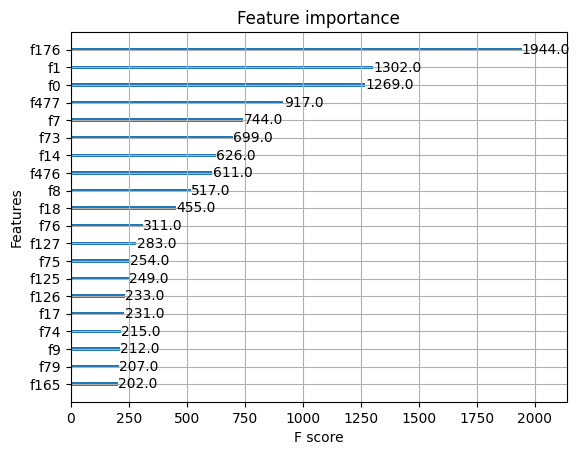

In [23]:
import xgboost as xgb
import matplotlib.pyplot as plt



# Plot feature importance
xgb.plot_importance(model, max_num_features=20)  # Adjust max_num_features as needed
plt.show()

In [25]:
%pip install Boruta

Note: you may need to restart the kernel to use updated packages.


In [ ]:
from boruta import BorutaPy
from sklearn.model_selection import train_test_split 
from sklearn.metrics import mean_squared_error

np.int = int 
np.float = float
np.bool = bool

X = df.iloc[:, 1:-1]
y = df['label']

X = X.fillna(0)

# Define algo
rf = XGBClassifier()

# Define Boruta feature selection method
feat_selector = BorutaPy(rf, n_estimators='auto',verbose=2, random_state=1)

X_numpy = X.values
y = y.ravel()
# Find all relevant features
feat_selector.fit(X_numpy, y)

# Check selected features
selected_features = feat_selector.support_

# Check ranking of features
feature_ranking = feat_selector.ranking_

# Call transform() on X to filter it down to selected features
X_filtered = feat_selector.transform(X_numpy)

# Print selected features
print("Selected Features:")
for i, selected in enumerate(selected_features):
    if selected:
        print(f'Feature {i + 1}')

# Print feature ranking
print("\nFeature Ranking:")
for i, rank in enumerate(feature_ranking):
    print(f'Feature {i + 1}: Rank {rank}')

selected_features_indices = np.where(feat_selector.support_)[0]
# Print selected features
print("\n   >Selected Features:")
for feature_idx in selected_features_indices:
    print(f'Feature {feature_idx + 1}')

feature_names = X.columns.tolist()

print("\n   >Selected Features:")

for feature_idx in selected_features_indices:
    print(f'{feature_names[feature_idx]}')

# Define the model (e.g., RandomForestRegressor)
model = XGBClassifier(random_state=0)

# Train the model using selected features
model.fit(X_filtered, y)

# Predict the target variable using the selected features
y_pred = model.predict(X_filtered)

# Calculate MSE
mse = mean_squared_error(y, y_pred)

# Display MSE
print(f'Mean Squared Error (MSE): {mse}')

selected_feature_names = [feature_names[idx] for idx in selected_features_indices]
print(selected_feature_names)

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	479
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	479
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	479
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	479
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	479
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	479
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	479
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	0
Tentative: 	33
Rejected: 	446
Iteration: 	9 / 100
Confirmed: 	0
Tentative: 	33
Rejected: 	446
Iteration: 	10 / 100
Confirmed: 	0
Tentative: 	33
Rejected: 	446
Iteration: 	11 / 100
Confirmed: 	0
Tentative: 	33
Rejected: 	446
Iteration: 	12 / 100
Confirmed: 	0
Tentative: 	16
Rejected: 	463
Iteration: 	13 / 100
Confirmed: 	0
Tentative: 	16
Rejected: 	463
Iteration: 	14 / 100
Confirmed: 	0
Tentative: 	16
Rejected: 	463
Iteration: 	15 / 100
Confirmed: 	0
Tentative: 	16
Rejected: 	463
Iteration: 	16 / 100
Confirmed: 	0
Tentat

AttributeError: module 'numpy' has no attribute 'bool'.
`np.bool` was a deprecated alias for the builtin `bool`. To avoid this error in existing code, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
The aliases was originally deprecated in NumPy 1.20; for more details and guidance see the original release note at:
    https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations